In [1]:
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
from matplotlib import gridspec
import matplotlib.dates as mdates

import json
import tkp.db
import tkp.config
import logging
import csv
import time
import sys

import itertools
import pylab
import numpy as np
import pandas as pd
import scipy as sp
import healpy as hp
import datetime
import os
import glob
from astropy import units as u
from astropy.coordinates import SkyCoord, match_coordinates_sky
from astropy.io import fits
from astropy.wcs import WCS


import numbers
import math
import scipy
from scipy.stats import norm
from scipy.stats import sem
from scipy import linspace
from scipy import pi,sqrt,exp
from scipy.special import erf
from scipy.optimize import curve_fit
from scipy import asarray as ar,exp
from scipy import interpolate, signal


import pymc3 as pm
from scipy.stats import norm

from scipy import linspace
from scipy import pi,sqrt,exp
from scipy.special import erf

from matplotlib.ticker import NullFormatter
from matplotlib.font_manager import FontProperties

plt.rcParams['font.size']=16
plt.rcParams['axes.labelsize']='large'
plt.rcParams['axes.titlesize']='large'
pylab.rcParams['legend.loc'] = 'best'
matplotlib.rcParams['text.usetex'] = False

%matplotlib inline

logging.basicConfig(level=logging.INFO)

import warnings
warnings.filterwarnings('ignore')

RuntimeError: module compiled against API version 0xc but this version of numpy is 0xa

/afhome/kuiack/newtrap/local/lib/python2.7/site-packages/pyfits/__init__.py:22: PyFITSDeprecationWarning: PyFITS is deprecated, please use astropy.io.fits
  PyFITSDeprecationWarning)  # noqa
WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [89]:
#matplotlib.rcParams['text.usetex'] = False

In [90]:
def nsf(num, n=1):
    """n-Significant Figures"""
    numstr = ("{0:.%ie}" % (n-1)).format(num)
    return float(numstr)

def num_err(num, err, n=1):
    '''Return number rounded based on error'''
    return np.around(num,int(-(np.floor(np.log10(nsf(err,n=n)))))), nsf(err,n=n)

def clip(data, sigma=3):
    """Remove all values above a threshold from the array.
    Uses iterative clipping at sigma value until nothing more is getting clipped.
    Args:
        data: a numpy array
    """
    data = data[np.isfinite(data)]
    raveled = data.ravel()
    median = np.median(raveled)
    std = np.nanstd(raveled)
    newdata = raveled[np.abs(raveled-median) <= sigma*std]
    if len(newdata) and len(newdata) != len(raveled):
        return clip(newdata, sigma)
    else:
        return newdata


In [91]:
def pdf(x):
    return 1/sqrt(2*pi) * exp(-x**2/2)

def cdf(x):
    return (1 + erf(x/sqrt(2))) / 2

def skewnorm(x,e=0,w=1,a=0):
    t = (x-e) / w
    return 2 / w * pdf(t) * cdf(a*t)


def delta(shape):
    return (shape/pm.math.sqrt(1.0+shape**2.))


def muz(shape):
    return pm.math.sqrt(2./np.pi)*delta(shape) 

def skewness(shape):
    return (4.- np.pi)/2. * ((delta(shape)*pm.math.sqrt(2./np.pi))**3.)/(1.0-(2.0*delta(shape)**2.)/np.pi)**(3./2.)

def sigmaz(shape):
    return np.sqrt(1.-muz(shape)**2.)


def skew_mode(shape):
    return pm.math.sqrt(2.0/np.pi)*delta(shape) - \
        skewness(shape) * pm.math.sqrt(1.0 - (pm.math.sqrt(2.0/np.pi)*delta(shape))**2 )/2.0 - \
        (pm.math.sgn(shape) / 2.0) *( pm.math.exp (-(2.0*np.pi)/pm.math.abs_(shape)))


def sk_mode(loc,scale,shape):
    return loc + skew_mode(shape) * scale

def fit_lightcurve(y, draws=500,chains=4, njobs=4):
    with pm.Model() as model:

        (mu, sigma) = norm.fit(y)

        loc = pm.Normal("loc",mu, 20)
        scale = pm.HalfNormal("scale", sigma)
        skew = pm.Normal("skew", 0, 5)
        mode = pm.Deterministic("mode",sk_mode(loc,scale,skew))
        _y = pm.SkewNormal("y_dist",mu=loc, sd=scale,alpha=skew, observed=y)
        trace = pm.sample(draws=draws, chains=chains, njobs=njobs)
    mode = pm.summary(trace)[pm.summary(trace).index == "mode"]["mean"].values[0]
    mode_err = pm.summary(trace)[pm.summary(trace).index == "mode"]["sd"].values[0]
        
    return mode, mode_err

In [92]:
def dump_trans(dbname, dataset_id, engine, host, port, user, pword):
    tkp.db.Database(
        database=dbname, user=user, password=pword,
        engine=engine, host=host, port=port
    )

    # find all the new, candidate transient, sources detected by the pipeline
    transients_query = """
    SELECT  tr.runcat
           ,tr.newsource_type
           ,im.rms_min
           ,im.rms_max
           ,im.detection_thresh
           ,ex.f_int
    FROM newsource tr
         ,image im
         ,extractedsource ex
    WHERE tr.previous_limits_image = im.id
      AND tr.trigger_xtrsrc = ex.id
    """
    
    cursor = tkp.db.execute(transients_query, (dataset_id,))
    transients = tkp.db.generic.get_db_rows_as_dicts(cursor)
    print "Found", len(transients), "new sources"
    return transients

def dump_sources(dbname, dataset_id, engine, host, port, user, pword):
    tkp.db.Database(
        database=dbname, user=user, password=pword,
        engine=engine, host=host, port=port
    )
    # extract the properties and variability parameters for all the running catalogue sources in the dataset
    sources_query = """\
    SELECT  im.taustart_ts
            ,im.tau_time
            ,ex.f_int
            ,ex.f_int_err
            ,ex.f_peak
            ,ex.f_peak_err
            ,ax.xtrsrc
            ,ex.extract_type
            ,ex.det_sigma
            ,ax.runcat as runcatid
            ,ex.ra
            ,ex.decl
            ,ex.ra_err
            ,ex.decl_err
            ,im.band
            ,im.rms_min
            ,im.rms_max
            ,ax.v_int
            ,ax.eta_int
            ,ax.f_datapoints
            ,im.freq_eff
            ,im.url
    FROM extractedsource ex
         ,assocxtrsource ax
         ,image im
         ,runningcatalog rc
    WHERE ax.runcat = rc.id
      AND ax.xtrsrc = ex.id
      and ex.image = im.id
      AND rc.dataset = %s
      and ex.extract_type = 2
      ORDER BY rc.id
    """
    cursor = tkp.db.execute(sources_query, (dataset_id,))
    sources = tkp.db.generic.get_db_rows_as_dicts(cursor)

    print "Found", len(sources), "source datapoints"

    return sources 

In [93]:
def distSquared(p0, p1):
    distance  = np.sqrt((p0[0] - p1[0,:])**2 + (p0[1] - p1[1,:])**2)
    if np.min(distance) < 3.0:
        return np.where(distance == np.min(distance))[0]
    else:
        return None
    
def pol2cart(rho, phi):
    x = rho * np.cos(phi)
    y = rho * np.sin(phi)
    return(x, y)

In [94]:
def retrieve_source(full_data, run_id):
    source_df = full_data[(full_data.runcatid == run_id)]
    
#     source_df = source_df.groupby('taustart_ts', as_index=False)
    source_df.set_index(source_df.taustart_ts, inplace=True)
    return source_df.sort_index()


def plot_lightcurve(full_data, run_id, ion_sub=False, roll_len = 1*60, roll_type = 'triang', stdout=True):

    source_df = full_data[(full_data.runcatid == run_id)]
    if stdout:
        print source_df.wm_ra.iloc[0], source_df.wm_decl.iloc[0]

    pd.to_datetime(source_df.taustart_ts)
    source_df = source_df.groupby('taustart_ts', as_index=False).mean()
    source_df.set_index(source_df.taustart_ts, inplace=True)

    if ion_sub:
        rolling = source_df.f_int.rolling(roll_len, win_type=roll_type)
        source_df.f_int = source_df.f_int-rolling.mean()


    plt.rcParams['font.size']=16
    plt.rcParams['axes.labelsize']='large'
    plt.rcParams['axes.titlesize']='large'
    pylab.rcParams['legend.loc'] = 'best'

    ylim = [np.nanmean(source_df.f_int)-6.0*np.nanstd(source_df.f_int),
            np.nanmean(source_df.f_int)+10.0*np.nanstd(source_df.f_int)]



    myFmt = mdates.DateFormatter('%H:%M')
    source_df["taustart_ts"] = pd.to_datetime(source_df["taustart_ts"])
    obs_dates = np.unique([100*x.month+x.day for x in source_df["taustart_ts"]])

    n_hours = np.array([]) 
    for i in obs_dates:
        index = (100*pd.DatetimeIndex(source_df["taustart_ts"]).month+pd.DatetimeIndex(source_df["taustart_ts"]).day == i)# & (source_df.extract_type == 0)
        n_hours = np.append(n_hours, len(np.unique(pd.DatetimeIndex(source_df["taustart_ts"][index]).hour)))
    hour_ratio = [i/n_hours.sum() for i in n_hours ]
    gs_ratio = np.append((hour_ratio)/min(hour_ratio),1)

    gs = gridspec.GridSpec(1, len(obs_dates)+1, width_ratios=gs_ratio) 

    figcount = 0
    figure = plt.figure(figsize=(4*len(obs_dates),6))

    for i in obs_dates:
        index = (100*pd.DatetimeIndex(source_df["taustart_ts"]).month+pd.DatetimeIndex(source_df["taustart_ts"]).day == i)# & (source_df.extract_type == 0)
        ax = plt.subplot(gs[figcount])
        ax.locator_params(nticks=6)
        ax.errorbar(source_df["taustart_ts"].values[index],
                    source_df["f_int"].values[index],
                    yerr=source_df["f_int_err"].values[index],
                    fmt=".",c="#1f77b4",ecolor="#ff7f0e")

        if figcount > 0:
            ax.set_yticks([])
        if figcount ==0:
            plt.ylabel("Flux [Jy]")
            ax.yaxis.set_ticks_position('left')
        if stdout:
            print source_df["taustart_ts"].values[index][0]
        plt.annotate("{}-{}".format(pd.DatetimeIndex(source_df["taustart_ts"].values[index]).day[0],
                                    pd.DatetimeIndex(source_df["taustart_ts"].values[index]).month[0]),
                                    xy=(0.95,0.95), xycoords='axes fraction',
                                    horizontalalignment='right', verticalalignment='top',fontsize=16)

        plt.xticks(rotation=90)
        ax.set_ylim(ylim)
        ax.xaxis.set_major_formatter(myFmt)
        figcount+=1

    hist_index = np.isfinite(source_df["f_int"]) #& (source_df.extract_type == 0)
    plt.subplot(gs[figcount])
    (mu, sigma) = norm.fit(source_df["f_int"].iloc[hist_index].values)
    n, bins, patches   =  plt.hist(source_df["f_int"].values[hist_index],
                                   bins=100,normed=1, orientation='horizontal',facecolor="#1f77b4")
    y = mlab.normpdf( bins, mu, sigma)
    if stdout:
        print "Gaus fit: mu {}, sigma {}".format(round(mu,3),round(sigma,3))
    
    l = plt.plot(y,bins,'r--', linewidth=2)
    # plt.title("Source: N = {}".format(len(source_df["f_int"].values[np.isfinite(source_df["f_int"])])))
    plt.annotate("Total N:\n{}".format(len(source_df["f_int"].values[hist_index])),
                                xy=(0.95,0.95), xycoords='axes fraction',
                                horizontalalignment='right', verticalalignment='top',fontsize=16)
    # plt.ylabel("Normalized N")
    plt.yticks([])
    plt.ylim(ylim)
    plt.xticks(rotation=90)

    plt.subplots_adjust(wspace=0.1, hspace=0)
    return figure
#     plt.show()
# fig.text(0.5, 0.04, 'date', ha='center')
# plt.tight_layout()
# print(source_df["wm_ra"].values[0],source_df["wm_decl"].values[1])
# plt.savefig("{}_multiday_lightcurve.png".format(key))



In [95]:
engine = 'postgresql'
host = 'ads001'
port = 5432
user = 'mkuiack'
password = 'Morecomplicatedpass1234'
# database = 'raw_16SB'
# database = 'flux_16SB'
# database = 'fluxcal_db'

# databases = ['higher_201702250130','lower_201702250130']
query_loglevel = logging.WARNING  # Set to INFO to see queries, otherwise WARNING

## Load single database 

#### Sources


In [9]:
## AARTFAAC survey databases:

# survey_stats = pd.DataFrame(
#     [
#     ["_201608311510", 1, 9229,  200, 53], # 9718 MB 
#     ["_201609051647", 1, 10726, 597, 17], # 11 GB 
#     ["_201609070340", 1, 17933, 76,  6],  # 14 GB 
#     ["_201611120632", 1, 28203, 310,  39],# 22 GB  
#     ["_201611132000", 1, 5078, 302,  15], # 4155 MB 
#     ["_201611140501", 1, 13977, 370,  16],# 6170 MB 
#     ["_201702241630", 1, 6488,  43,  2],  # 1734 MB 
#     ["_201702250130", 2, 13073, 68,  1],  # 8713 MB 
#     ["_201702250800", 1, 21426, 0,  0],   # 23 GB 
#     ["_201702251405", 1, 14860, 901,  47],  # 12 GB  , delete 2018 data 
#     ["_201702260116", 1, 10669, 0,  0], # 6463 MB  264.31s
#     ["_201702260800", 1, 21434, 239, 11], # 19 GB  
#     ["_201702261405", 1, 18436, 621,  35], # 9641 MB   491. s
#     ["_201702270350", 1, 4400,  67,  2],   # 975 MB 
#     ["_201702280900", 1, 3512,  23,  0],   # 782 MB
#     ["_201809230412", 1, 17147,  676,  47],   # 12 GB
#     ["_201809280900", 1, 0,  0,  0]   # 35 GB
# #     ["_201809281701", 1, 0,  0,  0],   # 
# #     ["_201809290600", 1, 0,  0,  0]   # 
#     ],
#     columns=["obs","dataset","timestamp","candidate","pass"])

In [2]:
survey_stats = pd.read_csv("/home/kuiack/survey_stats.csv")


In [3]:
survey_stats

,obs,dataset,timestamp,candidate,pass
0,_201608311510,1,9227,351,8
1,_201609051647,1,10726,597,11
2,_201609070340,1,21352,364,22
3,_201611120632,1,28203,686,43
4,_201611132000,1,10316,302,14
5,_201611140501,1,13977,370,19
6,_201702241630,1,6489,151,6
7,_201702250130,2,13071,913,44
8,_201702250800,1,21426,1345,70
9,_201702251405,1,14860,900,51


In [4]:
# Accumulated survey stats

print survey_stats.timestamp.sum(), "images,", round((survey_stats.timestamp.sum())/ 60/60.,2), "hours"
print survey_stats["pass"].sum(), "candidates"

760898 images, 211.35 hours
1331 candidates


In [ ]:
_201609051647,_201809221701,_201809281701, _201809280900,_201611120632

In [19]:
# db._configured = False
del session

NameError: name 'session' is not defined

In [99]:
# db._configured = False
# del data
t1 = time.time()
# scintillation strip _201702250130
#  _201809290600   "_201611140501"
# AS_20160905_1SB
# PSR_0905+08

#  "PSR_20181101_flux" 
#  "AS_20160905_1SB-flux"

dbname = "PSR_20181101_flux"
dataset = 1 #survey_stats[survey_stats.obs == dbname].dataset.values[0]


print "database name: ",  dbname
logging.getLogger('sqlalchemy.engine').setLevel(query_loglevel)

db = tkp.db.Database(engine=engine, host=host, port=port,
                     user=user, password=password, database=dbname)

db.connect()
session = db.Session()
sources = dump_sources(dbname,dataset, engine, host, port, user, password)
print len(sources)
data = pd.DataFrame(sources)

del sources

data.taustart_ts = pd.to_datetime(data.taustart_ts)



# Remove bad source fits 
data = data.drop(data.index[np.abs(data.f_int) > 10e6])
# No observations are greater than 24 hours 
data = data[data.taustart_ts.diff() < datetime.timedelta(seconds=24*3600)]


try:
    data["round_times"] = [datetime.datetime.strptime(os.path.basename(x)[:19], 
                                                      "%Y-%m-%dT%H:%M:%S") for x in data.url.values]
except ValueError:
    data["round_times"] = [datetime.datetime.strptime(os.path.basename(x)[:14], 
                                                      "%Y%m%d%H%M%S") for x in data.url.values]

# survey_stats.set_value(survey_stats.obs == dbname,"timestamp", len(np.unique(data.round_times))
# survey_stats.to_csv("survey_stats.csv", index=False)

db._configured = False
del db, session

print time.time() - t1, "seconds."

INFO:tkp.db.database:Database config: postgresql://mkuiack@ads001:5432/PSR_20181101_flux
INFO:tkp.db.database:connecting to database...


database name:  PSR_20181101_flux
Found 225371 source datapoints
225371
33.3317739964 seconds.


In [ ]:
try:
    data["round_times"] = [datetime.datetime.strptime(os.path.basename(x)[:19], 
                                                      "%Y-%m-%dT%H:%M:%S") for x in data.url.values]
except ValueError:
    data["round_times"] = [datetime.datetime.strptime(os.path.basename(x)[:14], 
                                                      "%Y%m%d%H%M%S") for x in data.url.values]


#### Transients 

In [23]:
t1 = time.time()
dbname = "_201702241630"

print "database name: ",  dbname
logging.getLogger('sqlalchemy.engine').setLevel(query_loglevel)

db = tkp.db.Database(engine=engine, host=host, port=port,
                     user=user, password=password, database=dbname)

db.connect()
session = db.Session()
transients = dump_trans(dbname,1, engine, host, port, user, password)
print len(transients)
trans_data = pd.DataFrame(transients)

del transients

# trans_data.taustart_ts = pd.to_datetime(trans_data.taustart_ts)

# bool_index = [x.year == 2018 for x in trans_data.taustart_ts]
# trans_data = data.drop(data.index[bool_index])
# trans_data = data.drop(data.index[np.abs(data.f_int) > 10e6])
# trans_data = data.drop(data.index[(data.set_index("taustart_ts").index.month != 2) & \
#                            (data.set_index("taustart_ts").index.hour == 14)])

# del bool_index

db._configured = False
del db, session

print time.time() - t1, "seconds."

INFO:tkp.db.database:Database config: postgresql://mkuiack@ads001:5432/_201702241630
INFO:tkp.db.database:connecting to database...


database name:  _201702241630
Found 505 new sources
505
0.725264072418 seconds.


## Load multiple databases.

In [15]:
# db._configured = False
# del data
data = pd.DataFrame([])

for dbname in databases:
    print "database name: ",  dbname

    logging.getLogger('sqlalchemy.engine').setLevel(query_loglevel)
    
    db = tkp.db.Database(engine=engine, host=host, port=port,
                         user=user, password=password, database=dbname)
    db.connect()
    session = db.Session()

    sources = dump_sources(dbname,1, engine, host, port, user, password)

    if len(data) == 0:
        data = pd.DataFrame(sources)
        del sources
        data.taustart_ts = pd.to_datetime(data.taustart_ts)
        data.band = np.ones(len(data.band), dtype=int)

    else:
        new_data = pd.DataFrame(sources)
        del sources

        new_data.taustart_ts = pd.to_datetime(new_data.taustart_ts)
        new_data.runcatid += data.runcatid.iloc[-1]
        new_data.band = (data.band.iloc[-1]+1)*np.ones(len(new_data.band), dtype=int)

        data = pd.concat([data,new_data], ignore_index=True)
        del new_data
        
    db._configured = False
    del db, session

NameError: name 'databases' is not defined

#### Save all data

In [100]:
# /home/kuiack/TR_20160905_flux.csv


all_data_name = "/home/kuiack/PSR_0950+08GP_flux.csv"
data.to_csv(all_data_name, index=True)

#### Load all data

In [11]:
# /home/kuiack/TR_20160905_flux.csv

all_data_name = "/home/kuiack/PSR_0950+08GP.csv"
data = pd.read_csv(all_data_name, infer_datetime_format=True)
data.taustart_ts = pd.to_datetime(data.taustart_ts)
dbname = "PSR"

In [13]:
data.taustart_ts = pd.to_datetime(data.taustart_ts)

## Clean Catalogue

In [12]:
data = data.rename(columns={'runcat': 'runcatid'})

In [10]:
def roundSeconds(dateTimeObject):
    newDateTime = dateTimeObject

    if newDateTime.microsecond >= 500000:
        newDateTime = newDateTime + datetime.timedelta(seconds=1)

    return newDateTime.replace(microsecond=0)


times = [roundSeconds(i) for i in data.taustart_ts]

In [11]:
data["round_times"] = times

In [12]:
(np.max(np.unique(times))- np.min(np.unique(times))).seconds



28726

In [14]:
# Detection in both subbands, simultaneously, in > N_detections timesteps. 

N_detections = 0 


# multi_detections = [] 
reduced = pd.DataFrame([])


t1 = time.time()
for _id in np.unique(data.runcatid):
    if len(data[(data.runcatid == _id) & \
                (data.band == 23) & \
                (data.extract_type == 0)].set_index("round_times").index.\
           intersection(data[(data.runcatid == _id) & \
                             (data.band == 24) & \
                             (data.extract_type == 0)].set_index("round_times").index )) > N_detections \
    and (np.max(data[(data.runcatid == _id )].det_sigma) > 8 ):

        if len(reduced) == 0:
            reduced = pd.DataFrame(data[(data.runcatid == _id)])
        else:
            reduced = pd.concat([reduced,data[(data.runcatid == _id)]])

print time.time() - t1

292.698022127


In [28]:
# Detection in both subbands, simultaneously, in > N_detections timesteps. 

N_detections = 0 


# multi_detections = [] 
reduced = pd.DataFrame([])


t1 = time.time()
for _id in np.unique(data.runcatid):
    if len(data[(data.runcatid == _id) & \
                (data.band == 23) & \
                (data.extract_type == 0)].set_index("round_times").index.\
           intersection(data[(data.runcatid == _id) & \
                             (data.band == 24) & \
                             (data.extract_type == 0)].set_index("round_times").index )) > N_detections \
    and (np.max(data[(data.runcatid == _id )].det_sigma) > 8 ):

        if len(reduced) == 0:
            reduced = pd.DataFrame(data[(data.runcatid == _id)])
        else:
            reduced = pd.concat([reduced,data[(data.runcatid == _id)]])

print time.time() - t1

109.239413023


In [12]:
# base = reduced.groupby("runcatid").mean()
base = reduced.groupby("runcatid").max()
base["taustart_ts"] = reduced.groupby("runcatid").first().taustart_ts



# base = data.groupby("runcatid").median()
# base["taustart_ts"] = data.groupby("runcatid").first().taustart_ts


NameError: name 'reduced' is not defined

In [15]:
r_data = data.groupby("runcatid").median()
r_data["taustart_ts"] = data.groupby("runcatid").first().taustart_ts
r_data["timestep"] = [x.timestamp() for x in r_data.taustart_ts]

In [14]:
base = data.groupby("runcatid").median()
# base["taustart_ts"] = data.groupby("runcatid").first().taustart_ts
base["f_datapoints"] = data.groupby("runcatid").last().f_datapoints
# base["timestep"] = [x.timestamp() for x in base.taustart_ts]

In [ ]:
## Match catalogues

In [16]:
vlssr = pd.read_csv("/home/kuiack/VLSSr_gt_5.csv", comment="#")
tgss = pd.read_csv("/home/kuiack/TGSSADR1_7sigma_catalog.tsv", delimiter="\t")
aart = pd.read_csv("/home/kuiack/AARTFAAC_catalogue.csv")
ateam = {"ra":np.array([82.88,299.43,350.28,187.07]),
         "decl":np.array([21.98,40.59,58.54,12.66])}


In [19]:
aart_coord = SkyCoord(aart.ra.values*u.deg, aart.decl.values*u.deg, frame='fk5')
ateam_coord = SkyCoord(ateam["ra"]*u.deg, ateam["decl"]*u.deg, frame='fk5')

filtered = pd.DataFrame([], columns=base.keys())
AART_catsource = pd.DataFrame([], columns=base.keys())


for i in base.index:
    try:
        c1 = SkyCoord(base.loc[i].ra*u.deg, base.loc[i].decl*u.deg, frame='fk5')

        c2 = SkyCoord(base.drop(index=i).ra.values*u.deg, 
                  base.drop(index=i).decl.values*u.deg, frame='fk5')
    except IndexError:
        print i

    if np.min(c1.separation(ateam_coord).deg) < 10:
        continue 

    elif np.min(c1.separation(aart_coord).deg) < 3 and base.loc[i].f_datapoints.astype(float) > 10:
        if len(AART_catsource) == 0:
            AART_catsource = pd.DataFrame(base.loc[i]).T
        else:
            AART_catsource = pd.concat([AART_catsource, pd.DataFrame(base.loc[i]).T])

    elif np.logical_or(((c1.separation(c2).deg) > 5),
                       (np.abs(base.loc[i].timestep - base.drop(index=i).timestep) > 1000)).all():
        if len(filtered) == 0:
            filtered = pd.DataFrame(base.loc[i]).T
        else:
            filtered = pd.concat([filtered, pd.DataFrame(base.loc[i]).T])



In [14]:
aart_coord = SkyCoord(aart.ra.values*u.deg, aart.decl.values*u.deg, frame='fk5')
ateam_coord = SkyCoord(ateam["ra"]*u.deg, ateam["decl"]*u.deg, frame='fk5')
AART_catsource = pd.DataFrame([], columns=base.keys())
t1 = time.time()
for i in base[base.f_datapoints > 1000].index:
    try:
        c1 = SkyCoord(base.loc[i].ra*u.deg, base.loc[i].decl*u.deg, frame='fk5')
        c2 = SkyCoord(base.drop(index=i).ra.values*u.deg, 
                  base.drop(index=i).decl.values*u.deg, frame='fk5')
    except IndexError:
        print i


    if np.min(c1.separation(aart_coord).deg) < 1:
        if len(AART_catsource) == 0:
            AART_catsource = pd.DataFrame(base.loc[i]).T
        else:
            AART_catsource = pd.concat([AART_catsource, pd.DataFrame(base.loc[i]).T])
print time.time() - t1 

6.38103508949


In [20]:
mode_lo, mode_lo_err = fit_lightcurve(clip(data[(data.band == 23) &\
                                                (data.runcatid == 3) & \
                                                (data.extract_type == 0)].f_int.values), draws=100, njobs=12)
mode_hi, mode_hi_err = fit_lightcurve(clip(data[(data.band == 24) & \
                                                (data.runcatid == 3) & \
                                                (data.extract_type == 0)].f_int.values), draws=100, njobs=12)

Only 100 samples in chain.
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 12 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 12 jobs)
NUTS: [skew, scale, loc]
INFO:pymc3:NUTS: [skew, scale, loc]
100%|██████████| 600/600 [00:50<00:00, 12.83it/s]
The gelman-rubin statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
INFO:pymc3:The gelman-rubin statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The number of effective samples is smaller than 25% for some parameters.
INFO:pymc3:The number of effective samples is smaller than 25% for some parameters.
Only 100 samples in chain.
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+ad

In [24]:
np.unique(data.freq_eff)

array([58300781.25, 61816406.25])

(array([ 2.,  0.,  3.,  1.,  1.,  1.,  2.,  3.,  2.,  7., 12., 13.,  6.,
         9., 15.,  8., 15., 21., 31., 25., 25., 22., 35., 38., 25., 36.,
        42., 48., 36., 43., 43., 49., 49., 37., 44., 52., 47., 59., 46.,
        56., 48., 45., 35., 42., 28., 37., 31., 38., 50., 34., 37., 32.,
        38., 34., 33., 29., 23., 28., 38., 18., 28., 20., 15., 30., 21.,
        23., 23., 18., 17., 21., 13., 12., 15., 21., 25., 12.,  9., 14.,
        11., 10., 16.,  7.,  6., 10.,  6.,  5., 10., 11.,  2.,  3.,  4.,
         7.,  9.,  3., 10.,  3.,  7.,  4.,  3.,  5.]),
 array([ 66.21017002,  66.74910741,  67.28804481,  67.8269822 ,
         68.36591959,  68.90485698,  69.44379438,  69.98273177,
         70.52166916,  71.06060656,  71.59954395,  72.13848134,
         72.67741873,  73.21635613,  73.75529352,  74.29423091,
         74.83316831,  75.3721057 ,  75.91104309,  76.44998048,
         76.98891788,  77.52785527,  78.06679266,  78.60573006,
         79.14466745,  79.68360484,  80.22254223, 

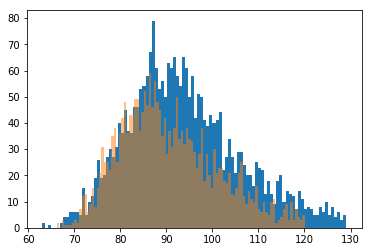

In [30]:
# data = data.drop(data.index[np.abs(data.f_int) > 10e4])

plt.figure()
plt.hist(clip(data[(data.band == 24) & (data.runcatid == 40) & (data.extract_type == 0) ].f_int.values),bins=100)
plt.hist(clip(data[(data.band == 23) & (data.runcatid == 40) & (data.extract_type == 0) ].f_int.values),bins=100, alpha =0.5)

# plt.plot([mode_lo,mode_lo],[0,200])
# plt.plot([mode_hi,mode_hi],[0,200])

In [55]:
# output = []

for _ID in AART_catsource.index:
    if (data[(data.band == 24) & (data.runcatid == _ID)].f_int.values == np.nan).any():
        print _ID, (data[(data.band == 24) & (data.runcatid == _ID)].f_int.values == np.nan).any()
    
# t1 = time.time()
# mode_lo,mode_lo_err  = fit_lightcurve(data[(data.band == 23) & (data.runcatid == _ID)].f_int.values, draws=100)
# t1 = time.time()
# print mode_lo,mode_lo_err, t1-time.time()
# mode_lo,mode_lo_err  = fit_lightcurve(data[(data.band == 23) & (data.runcatid == _ID)].f_int.values, draws=250)
# print mode_lo,mode_lo_err, t1-time.time()
# t1 = time.time()
# mode_lo,mode_lo_err  = fit_lightcurve(data[(data.band == 23) & (data.runcatid == _ID)].f_int.values, draws=500)
# print mode_lo,mode_lo_err, t1-time.time()

# mode_hi,mode_hi_err = fit_lightcurve(data[(data.band == 24) & (data.runcatid == _ID)].f_int.values)

# N = len(data[(data.band == 24) & (data.runcatid == _ID)].f_int.values)
# ra = np.nanmean(data[(data.band == 24) & (data.runcatid == _ID)].ra.values)
# decl = np.nanmean(data[(data.band == 24) & (data.runcatid == _ID)].decl.values)
# output.append([ra,decl,mode_lo,mode_lo_err,mode_hi,mode_lo,N])

203


<IPython.core.display.Javascript object>


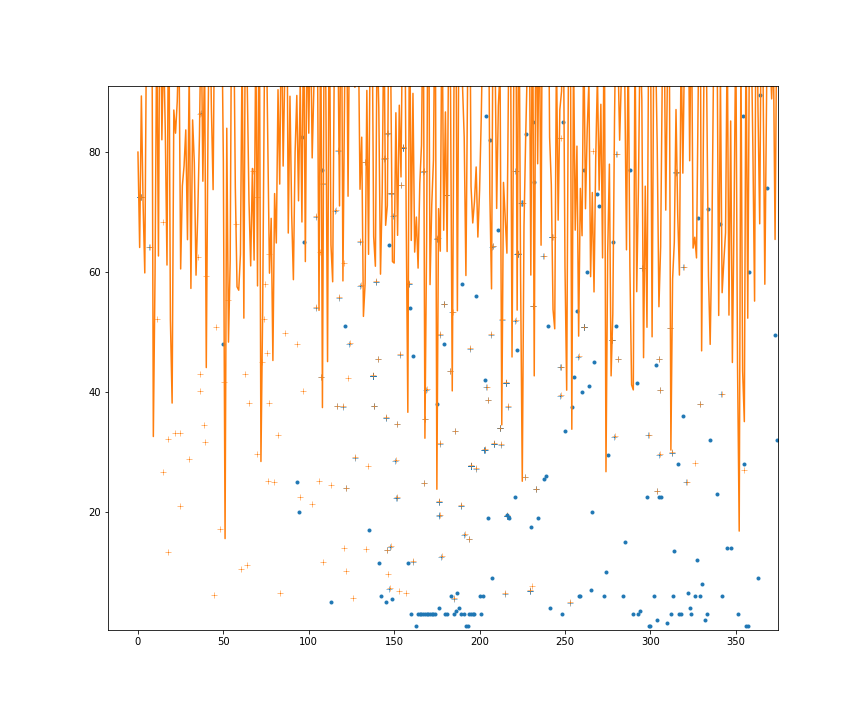

In [25]:
print len(AART_catsource)
%matplotlib notebook

plt.figure(figsize=(12,10))
plt.scatter(AART_catsource.ra,AART_catsource.decl,marker="+",lw=0.5)
plt.scatter(aart.ra,aart.decl,marker="+",lw=0.5)
plt.show()

51


<IPython.core.display.Javascript object>


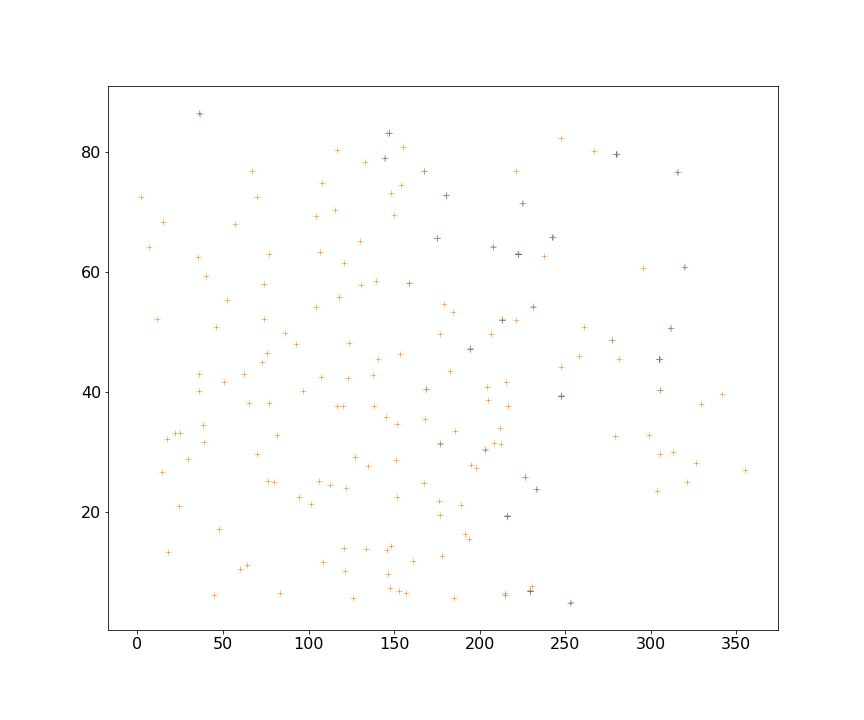

In [59]:
print len(AART_catsource)
%matplotlib notebook

plt.figure(figsize=(12,10))
plt.scatter(AART_catsource.ra,AART_catsource.decl,marker="+",lw=0.5)
plt.scatter(aart.ra,aart.decl,marker="+",lw=0.5)
plt.show()

### Measure AARTFAAC source flux ratio

In [52]:
AART_flux_ratio = []

for _ID in AART_catsource.index:


    mode_lo = fit_lightcurve(data[(data.band == 23) & (data.runcatid == _ID)].f_int.values)
    mode_hi = fit_lightcurve(data[(data.band == 24) & (data.runcatid == _ID)].f_int.values)
    N = len(data[(data.band == 24) & (data.runcatid == _ID)].f_int.values)
    ra = np.nanmean(data[(data.band == 24) & (data.runcatid == _ID)].ra.values)
    decl = np.nanmean(data[(data.band == 24) & (data.runcatid == _ID)].decl.values)
    
    
    AART_flux_ratio.append([ra,decl,mode_lo,mode_hi,N])
    

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [skew, scale, loc]
INFO:pymc3:NUTS: [skew, scale, loc]
100%|██████████| 1000/1000 [00:18<00:00, 55.19it/s]
The acceptance probability does not match the target. It is 0.8919774052492465, but should be close to 0.8. Try to increase the number of tuning steps.
The gelman-rubin statistic is larger than 1.4 for some parameters. The sampler did not converge.
ERROR:pymc3:The gelman-rubin statistic is larger than 1.4 for some parameters. The sampler did not converge.
The estimated number of effective samples is smaller than 200 for some parameters.
ERROR:pymc3:The estimated number of effective samples is smaller than 200 for some parameters.
Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initial

KeyboardInterrupt: 

In [53]:
print AART_flux_ratio

[[304.8527322215269, 45.53644355108024, 96.90345848413439, 83.59117988352865, 6958]]


In [181]:
for _ID in filtered.index:
    source_df = retrieve_source(data, _ID)
    source_df.to_csv("/home/kuiack/CandidatePandas/"+str(_ID)+"-source_df.csv", index=False)

<IPython.core.display.Javascript object>


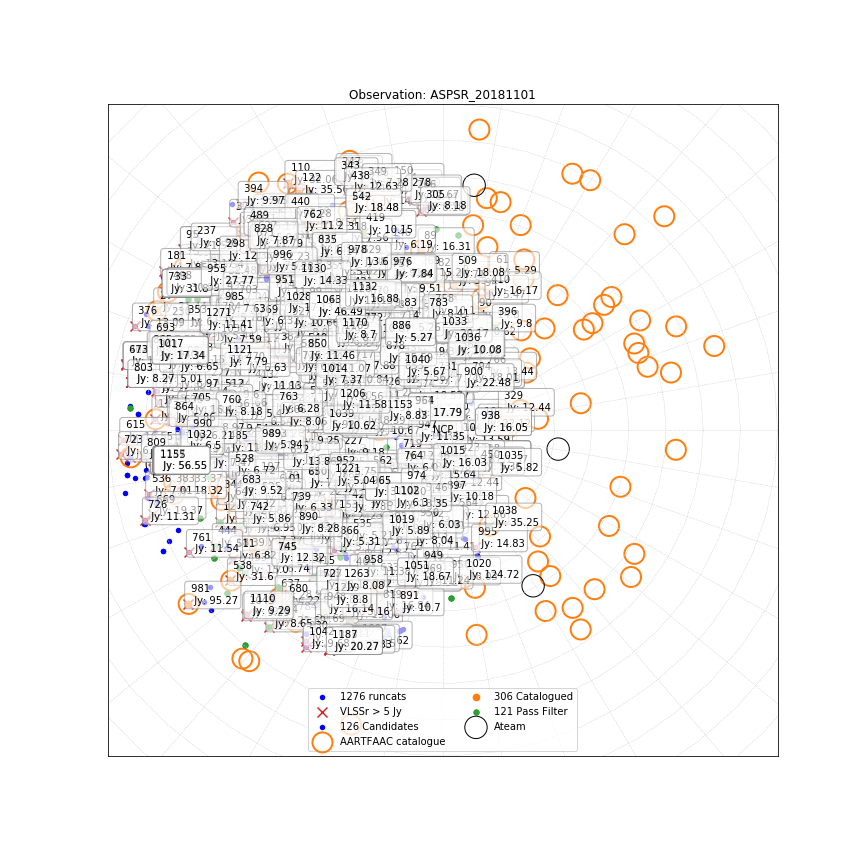

In [25]:
vlssr_thresh= 5
# dbname ="tr_20181101"
%matplotlib notebook

plt.figure(figsize=(12,12))
plt.title("Observation: AS"+dbname)

plt.scatter(pol2cart(np.abs(90-r_data.decl),np.deg2rad(r_data.ra.astype("float")))[0],
            pol2cart(np.abs(90-r_data.decl),np.deg2rad(r_data.ra.astype("float")))[1],
            lw =0,s=30,c="blue",label="{} runcats".format(len(r_data)))

vlssr_c = SkyCoord(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values*u.deg,
              vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values*u.deg, frame='fk5')


vlssr_assoc_x = []
vlssr_assoc_y = []


bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.6)




for i in range(len(r_data)):
    allfilter_c = SkyCoord(r_data.iloc[i].ra*u.deg, 
                           r_data.iloc[i].decl*u.deg, frame='fk5')

    if np.min(allfilter_c.separation(vlssr_c).deg) < 0.5:
        vlssr_assoc_x.append(pol2cart(np.abs(90-r_data.iloc[i]["decl"]),np.deg2rad(r_data.iloc[i]["ra"].astype("float")))[0])
        vlssr_assoc_y.append(pol2cart(np.abs(90-r_data.iloc[i]["decl"]),np.deg2rad(r_data.iloc[i]["ra"].astype("float")))[1])


        plt.annotate(s=" "+str(r_data.index.values[i])+"\n  Jy: "+str(round(vlssr.iloc[np.argmin(allfilter_c.separation(vlssr_c).deg)].Sp,2)),
                     xy=(pol2cart(np.abs(90-r_data["decl"].values[i]),np.deg2rad(r_data["ra"].astype("float").values[i]))[0],
                         pol2cart(np.abs(90-r_data["decl"].values[i]),np.deg2rad(r_data["ra"].astype("float").values[i]))[1]),
                     xycoords="data", bbox=bbox_props)
        continue

    
plt.scatter(vlssr_assoc_x,vlssr_assoc_y,
     marker="x",s=100,c="C3", label="VLSSr > {} Jy".format(vlssr_thresh) )    






for i in np.arange(-40,80,10):
    plt.plot(pol2cart(np.abs(90-i*np.ones(50)),np.deg2rad(np.linspace(0,360,50)))[0],
             pol2cart(np.abs(90-i*np.ones(50)),np.deg2rad(np.linspace(0,360,50)))[1],"--",lw=0.5,c="lightgrey")
    
for i in np.arange(0,360,10):
    plt.plot(pol2cart(np.abs(90-np.linspace(-40,90,50)),np.deg2rad(i*np.ones(50)))[0],
             pol2cart(np.abs(90-np.linspace(-40,90,50)),np.deg2rad(i*np.ones(50)))[1],"--",lw=0.5,c="lightgrey") 


plt.scatter(pol2cart(np.abs(90-base[base.det_sigma >= 8].decl),np.deg2rad(base[base.det_sigma >= 8].ra.astype("float")))[0],
            pol2cart(np.abs(90-base[base.det_sigma >= 8].decl),np.deg2rad(base[base.det_sigma >= 8].ra.astype("float")))[1],
            lw =0,s=30,c="blue",label="{} Candidates".format(len(base[base.det_sigma >= 8])))



# plt.scatter(pol2cart(np.abs(90-base.decl),np.deg2rad(base.ra.astype("float")))[0],
#             pol2cart(np.abs(90-base.decl),np.deg2rad(base.ra.astype("float")))[1],
#             lw =0,s=30,c="blue",label="{} Candidates".format(len(base)))



plt.scatter(pol2cart(np.abs(90-aart["decl"]),np.deg2rad(aart["ra"]))[0],
            pol2cart(np.abs(90-aart["decl"]),np.deg2rad(aart["ra"]))[1],
            lw =2,s=400,marker="o",edgecolor="C1", facecolor="none",label="AARTFAAC catalogue")


plt.scatter(pol2cart(np.abs(90-AART_catsource.decl),np.deg2rad(AART_catsource.ra.astype("float")))[0],
            pol2cart(np.abs(90-AART_catsource.decl),np.deg2rad(AART_catsource.ra.astype("float")))[1],
            lw =0,s=60,facecolor="C1",label="{} Catalogued".format(len(AART_catsource)))

# for i in range(len(AART_catsource)):

#     plt.annotate(s=" "+str(AART_catsource.index.values[i]),
#                      xy=(pol2cart(np.abs(90-AART_catsource["decl"].values[i]),np.deg2rad(AART_catsource["ra"].astype("float").values[i]))[0],
#                          pol2cart(np.abs(90-AART_catsource["decl"].values[i]),np.deg2rad(AART_catsource["ra"].astype("float").values[i]))[1]),
#                      xycoords="data", bbox=bbox_props)


plt.scatter(pol2cart(np.abs(90-filtered["decl"]),np.deg2rad(filtered["ra"].astype("float")))[0],
            pol2cart(np.abs(90-filtered["decl"]),np.deg2rad(filtered["ra"].astype("float")))[1],
             s=30,c="C2",label="{} Pass Filter".format(len(filtered)))

plt.scatter(pol2cart(np.abs(90-ateam["decl"]),np.deg2rad(ateam["ra"]))[0],
            pol2cart(np.abs(90-ateam["decl"]),np.deg2rad(ateam["ra"]))[1],
            edgecolor="black", facecolor="none",s=500, label="Ateam")




# plt.scatter(pol2cart(np.abs(90-vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000),
#                      np.deg2rad(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000))[0],
#             pol2cart(np.abs(90-vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000),
#                      np.deg2rad(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000))[1],
#             edgecolor="black", facecolor="none",s=50, label="VLSSr")


bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.6)


vlssr_c = SkyCoord(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values*u.deg,
              vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values*u.deg, frame='fk5')


# vlssr_assoc_x = [] 
# vlssr_assoc_y = [] 

# for i in range(len(filtered)):
    
#     filter_c = SkyCoord(filtered.iloc[i].ra*u.deg, filtered.iloc[i].decl*u.deg, frame='fk5')

#     if np.min(filter_c.separation(vlssr_c).deg) < 0.5:
#         vlssr_assoc_x.append(pol2cart(np.abs(90-filtered.iloc[i]["decl"]),np.deg2rad(filtered.iloc[i]["ra"].astype("float")))[0])
#         vlssr_assoc_y.append(pol2cart(np.abs(90-filtered.iloc[i]["decl"]),np.deg2rad(filtered.iloc[i]["ra"].astype("float")))[1])

# # #         plt.scatter(pol2cart(np.abs(90-_filtered.iloc[i]["decl"]),np.deg2rad(_filtered.iloc[i]["ra"].astype("float")))[0],
# # #             pol2cart(np.abs(90-_filtered.iloc[i]["decl"]),np.deg2rad(_filtered.iloc[i]["ra"].astype("float")))[1],
# # #              marker="x",s=100,c="C3", label="VLSSr association")
# #         continue 

#     plt.annotate(s=" "+str(filtered.index.values[i]),
#                  xy=(pol2cart(np.abs(90-filtered["decl"].values[i]),np.deg2rad(filtered["ra"].astype("float").values[i]))[0],
#                      pol2cart(np.abs(90-filtered["decl"].values[i]),np.deg2rad(filtered["ra"].astype("float").values[i]))[1]),
#                  xycoords="data", bbox=bbox_props)
    
# plt.scatter(vlssr_assoc_x,vlssr_assoc_y,
#      marker="x",s=100,c="C3", label="VLSSr > {} Jy".format(vlssr_thresh) )    
    

# for i in range(len(base)):
#     plt.annotate(s=" "+str(base.index.values[i]),
#                  xy=(pol2cart(np.abs(90-base["decl"].values[i]),np.deg2rad(base["ra"].astype("float").values[i]))[0],
#                      pol2cart(np.abs(90-base["decl"].values[i]),np.deg2rad(base["ra"].astype("float").values[i]))[1]),
#                  xycoords="data", bbox=bbox_props)
# #     pass_list.append(_filtered.index.values[i])

plt.annotate(s="NCP",
             xy=(0,0),horizontalalignment='center', verticalalignment='center',
             xycoords="data")


# plt.scatter(pol2cart(np.abs(90-26.5),np.deg2rad(273.1))[0],
#             pol2cart(np.abs(90-26.5),np.deg2rad(273.1))[1],
#             edgecolor="black", facecolor="none",s=500, label="Ateam")


plt.xlim([-90,90])
plt.ylim([-90,90])
plt.legend(loc="lower center", ncol=2)
plt.xticks([])
plt.yticks([])
plt.show()


<IPython.core.display.Javascript object>


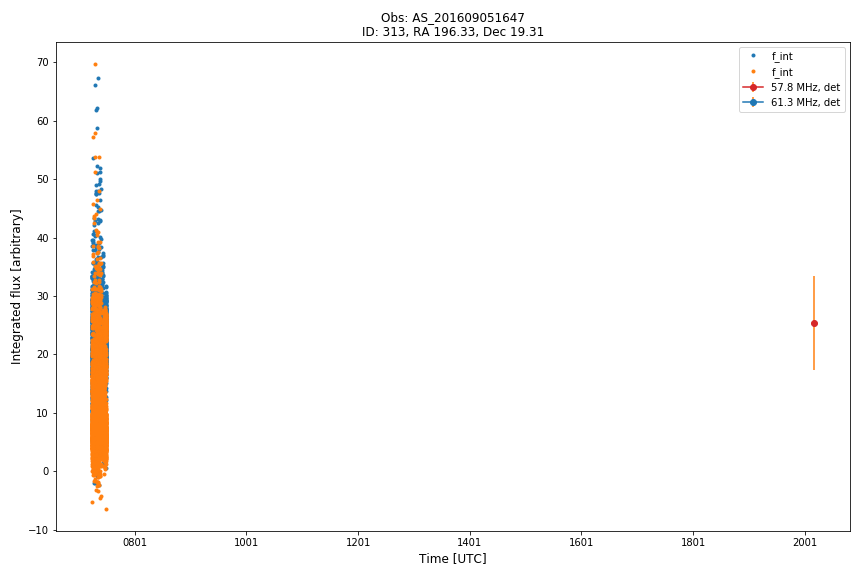

In [31]:
plt.figure(figsize=(12,8))
plt.plot(data[(data.runcatid == 17) & (data.band == 23)].f_int, ".")
plt.plot(data[(data.runcatid == 17) & (data.band == 24)].f_int, ".")
plt.show()

In [19]:
IDS = np.unique(data[data.extract_type == 2].runcatid)
IDS

array([62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74])

<IPython.core.display.Javascript object>


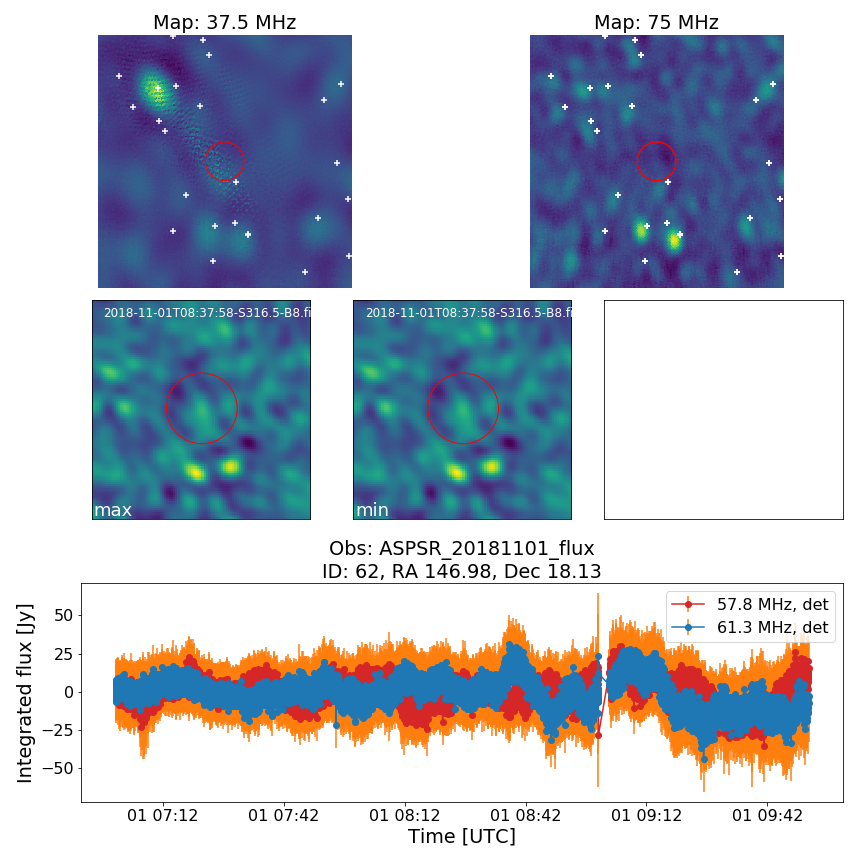

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


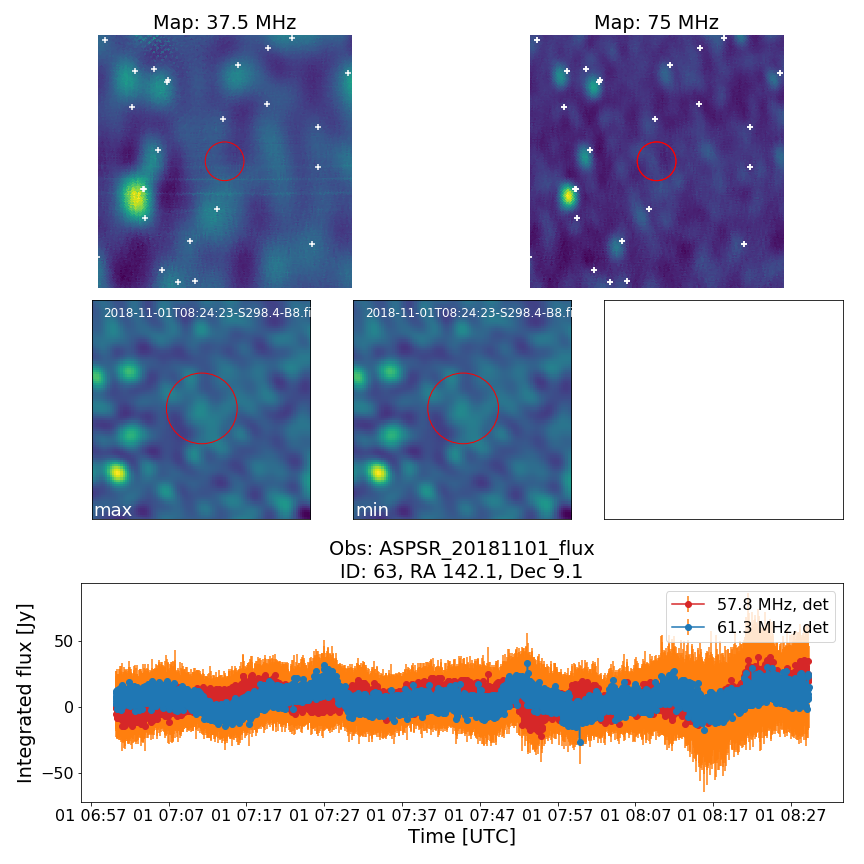

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


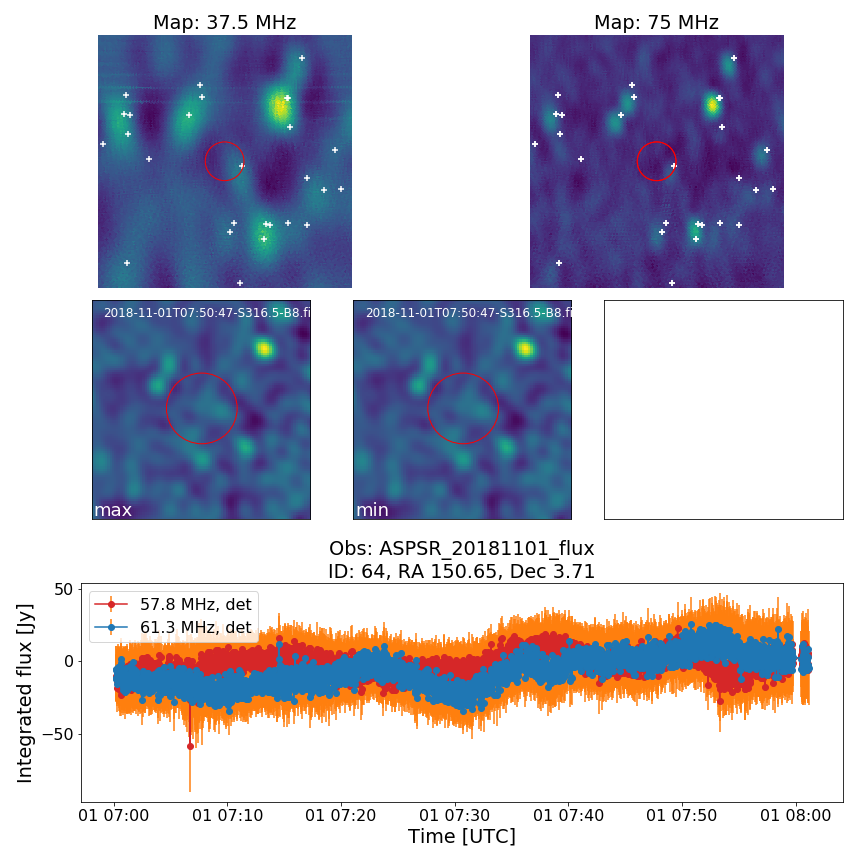

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


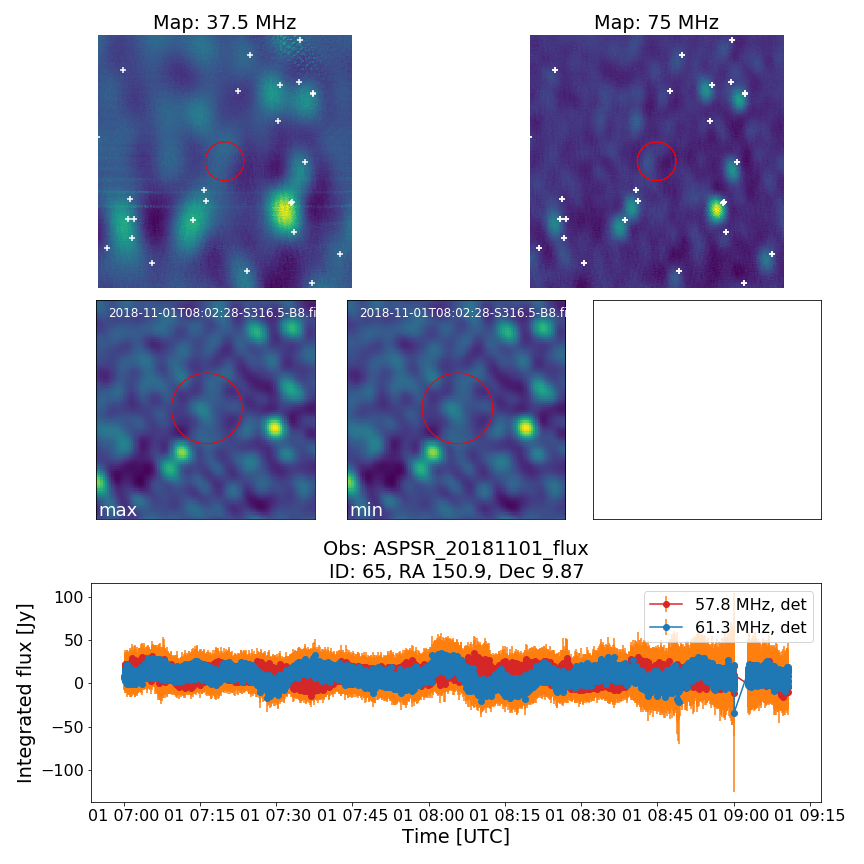

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


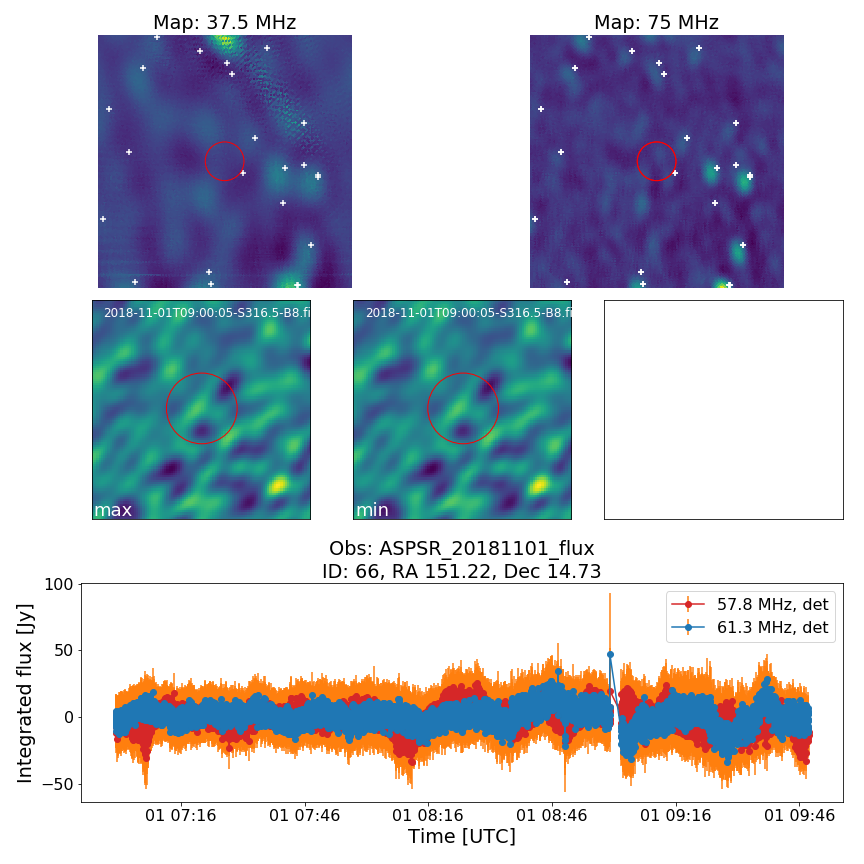

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


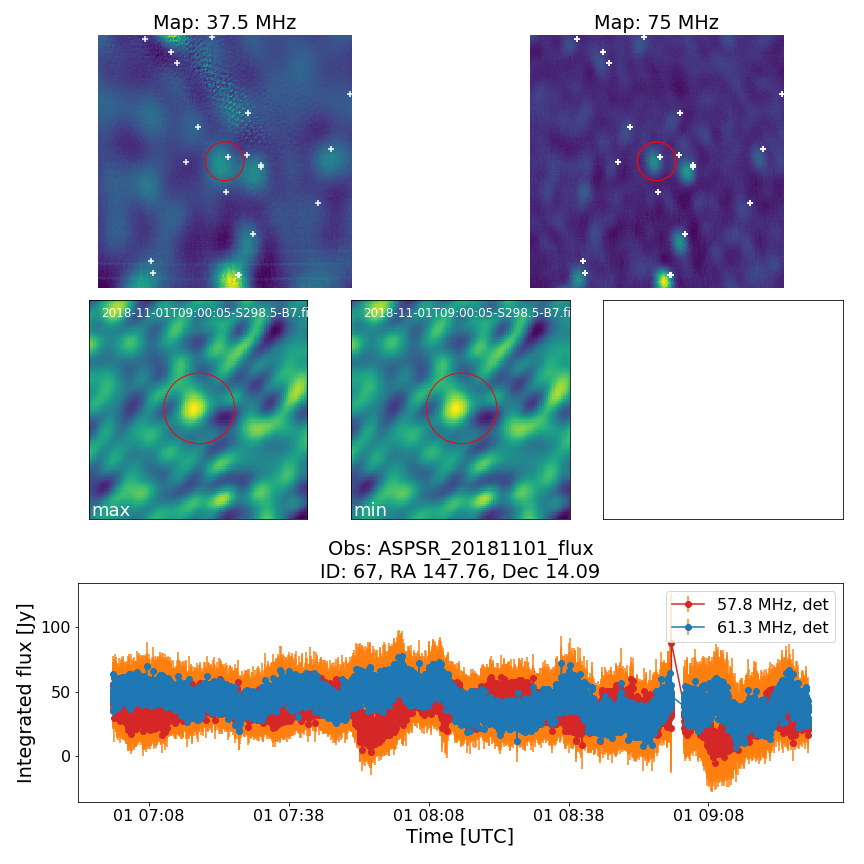

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


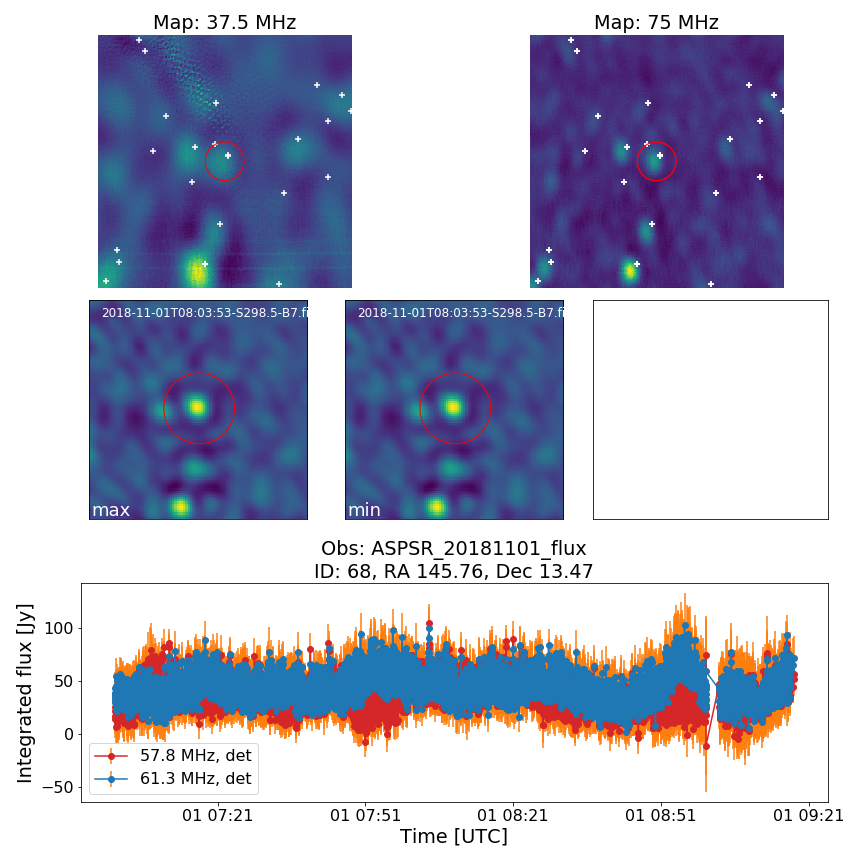

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


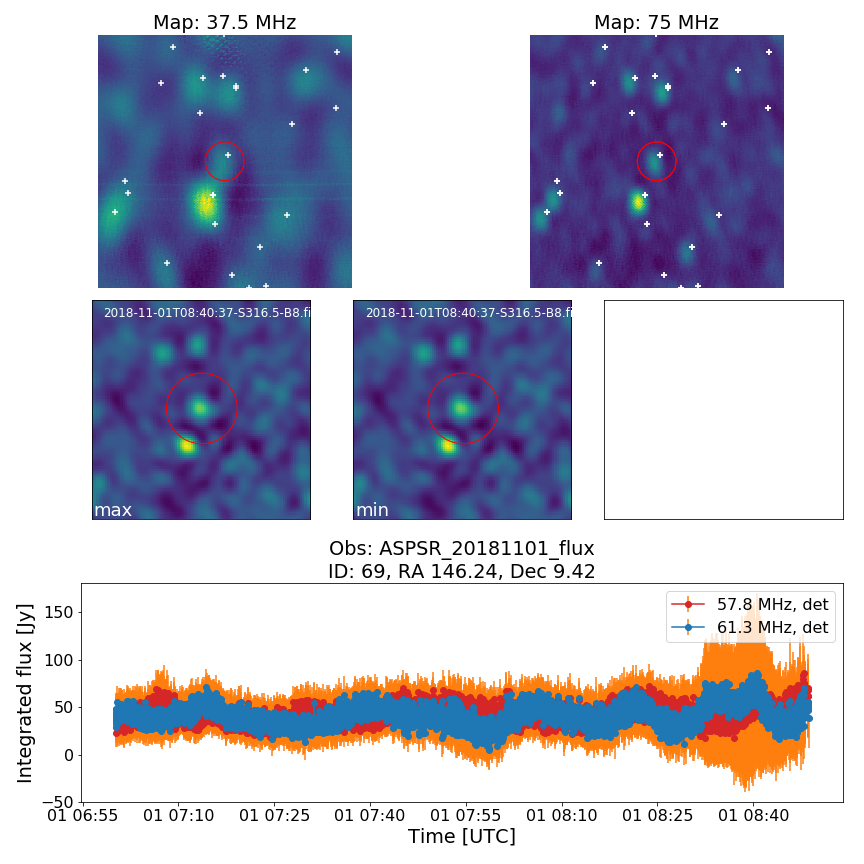

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


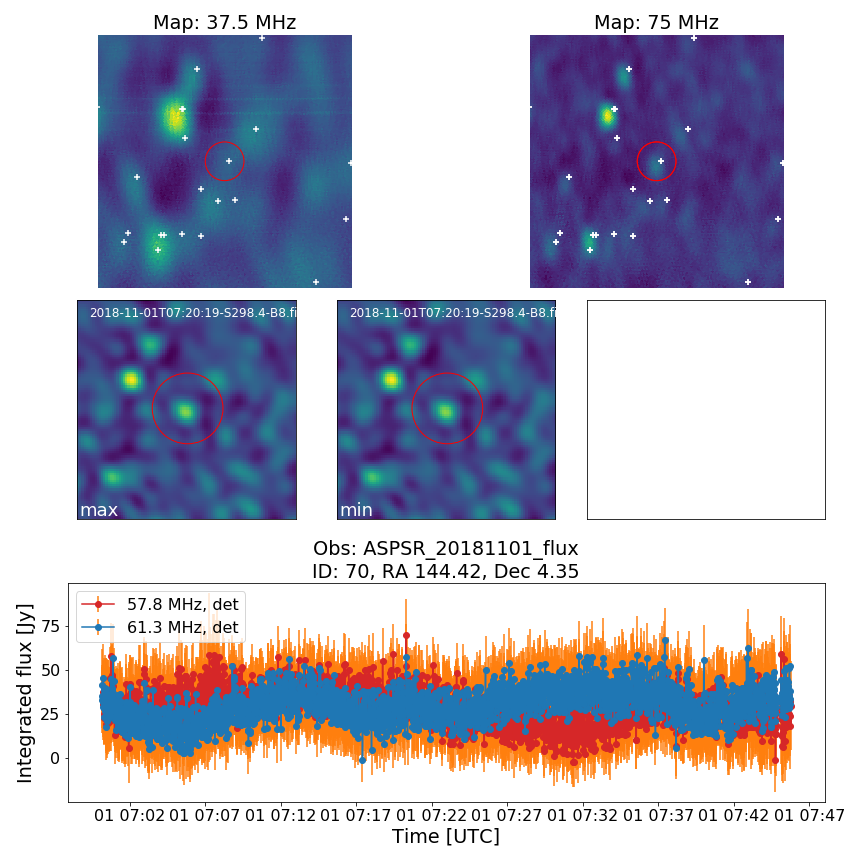

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


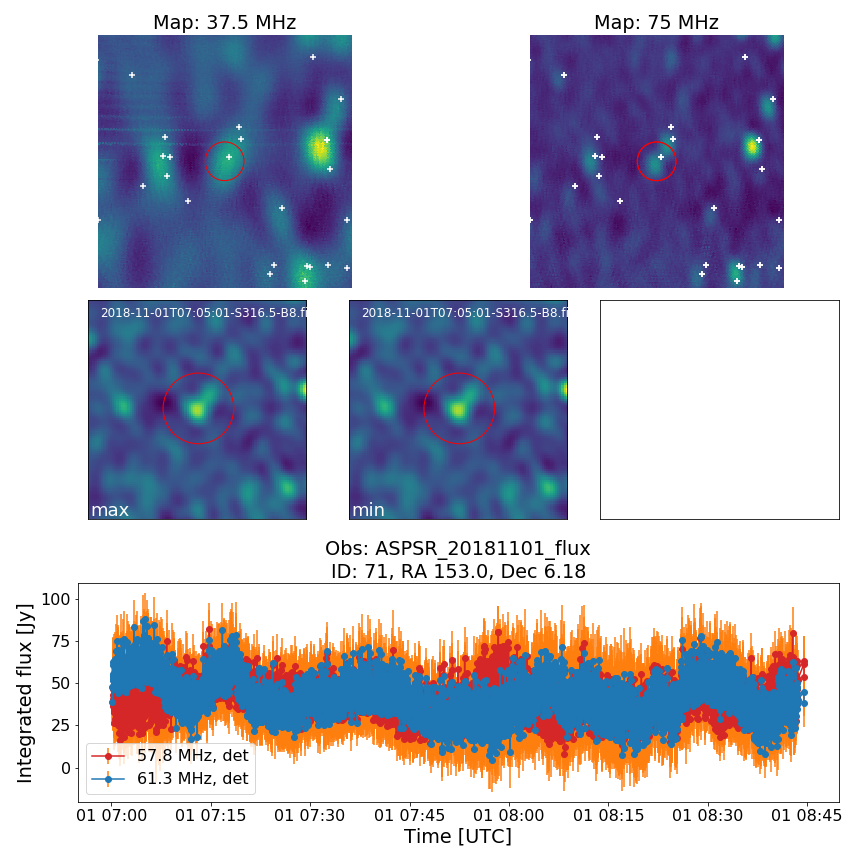

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


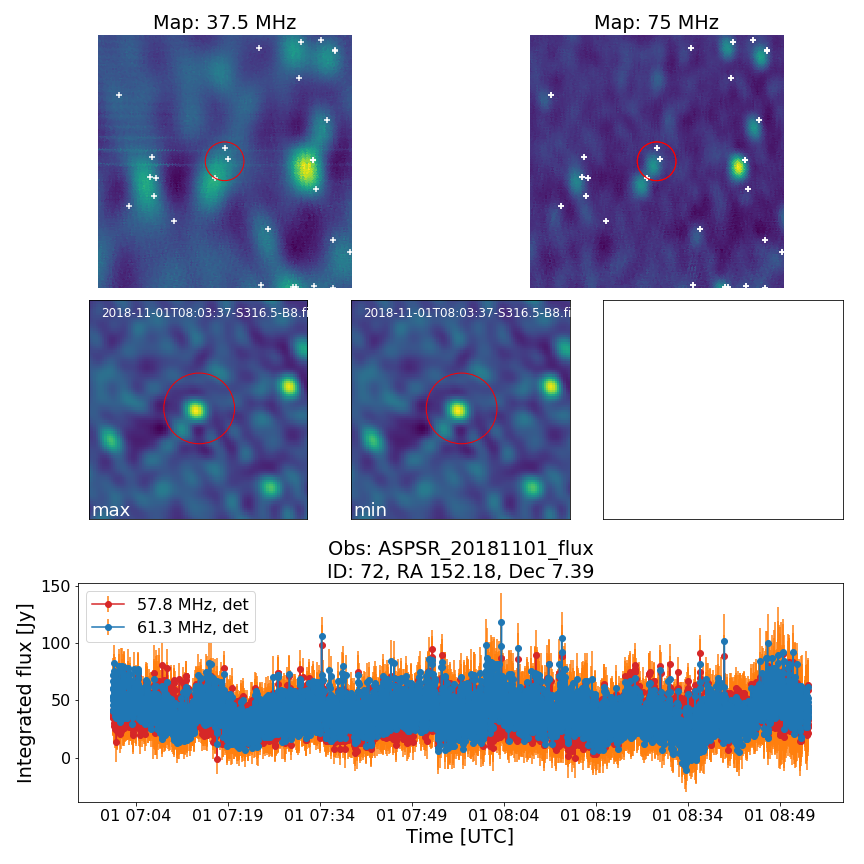

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


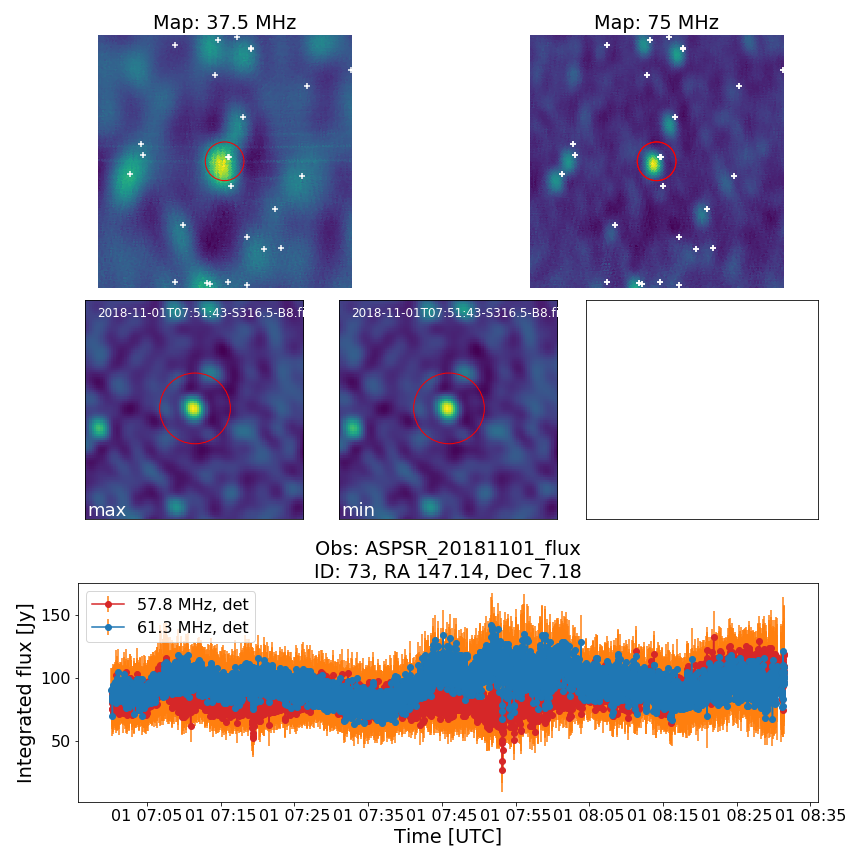

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


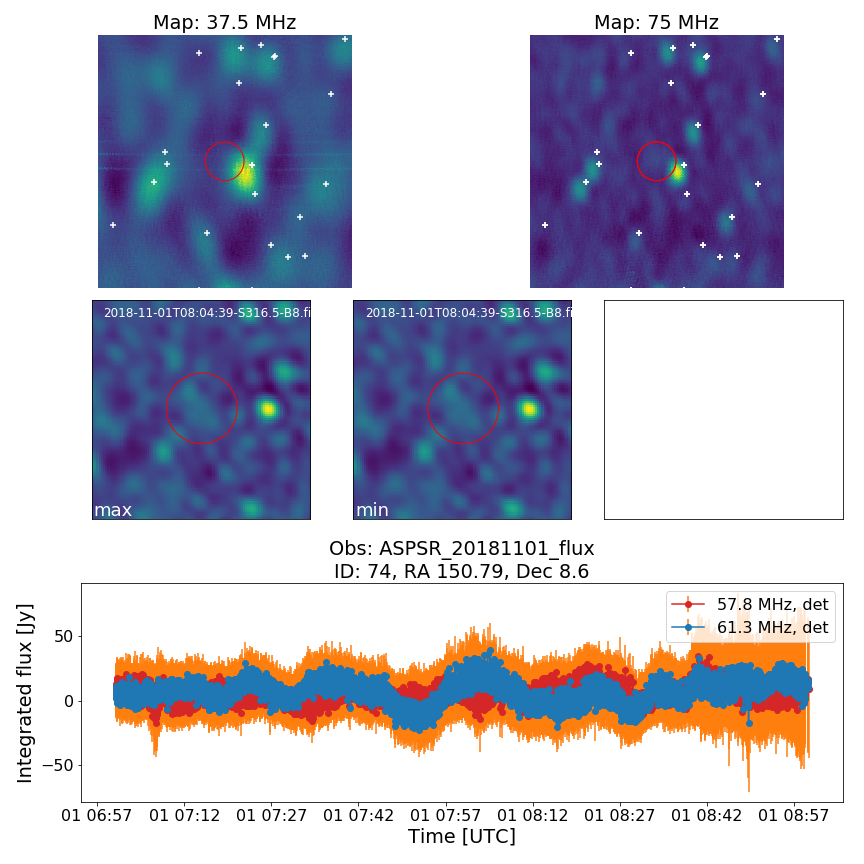

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


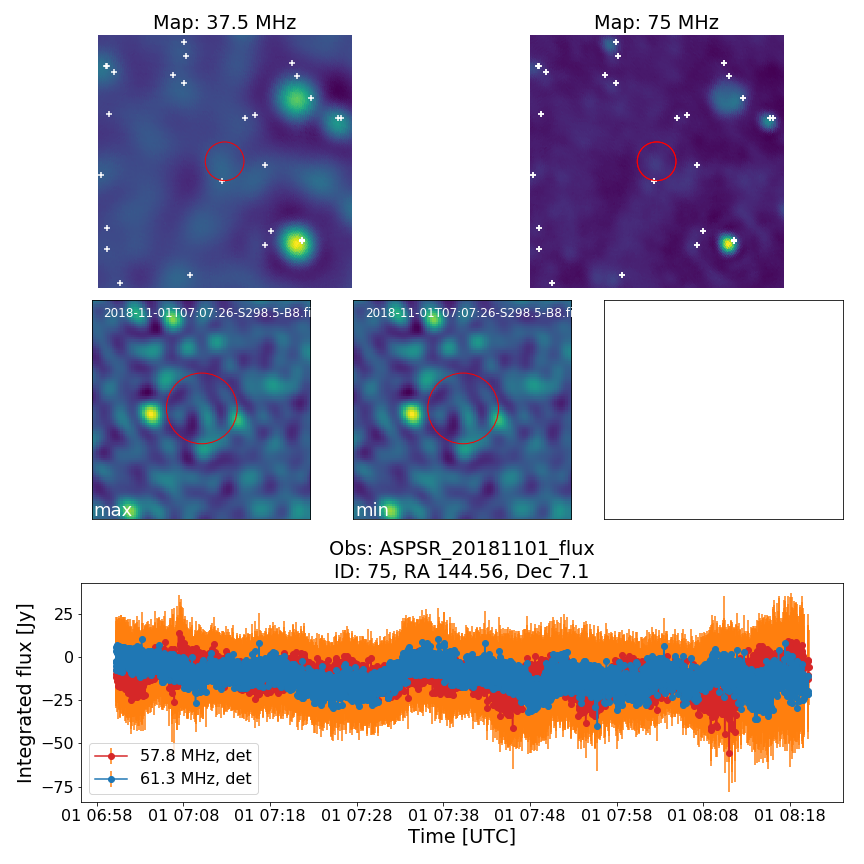

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


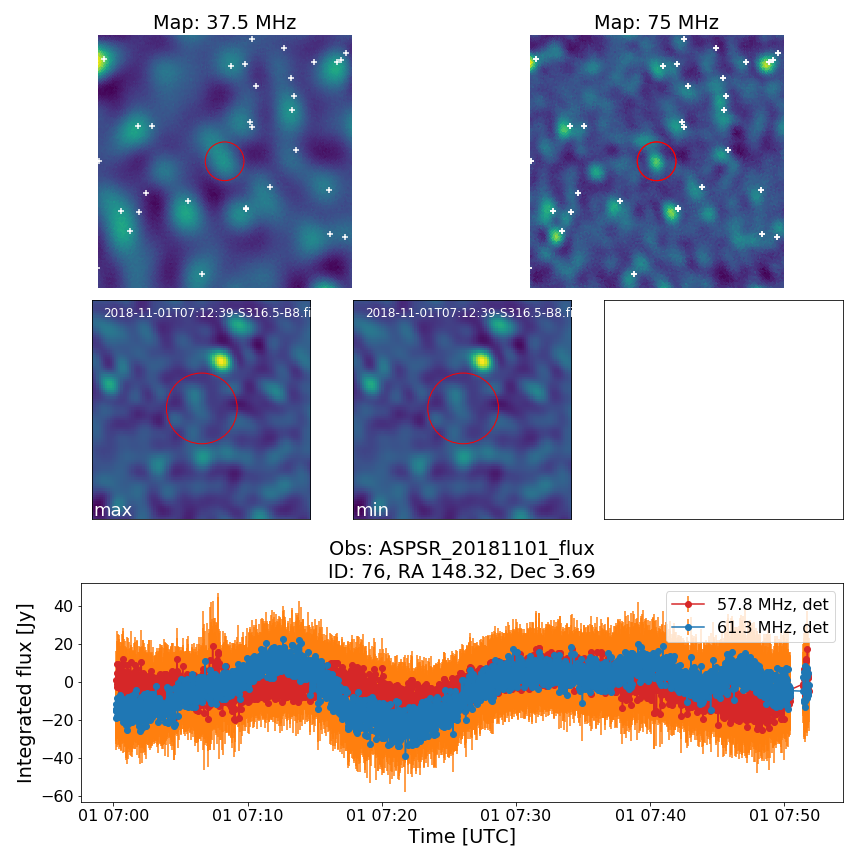

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


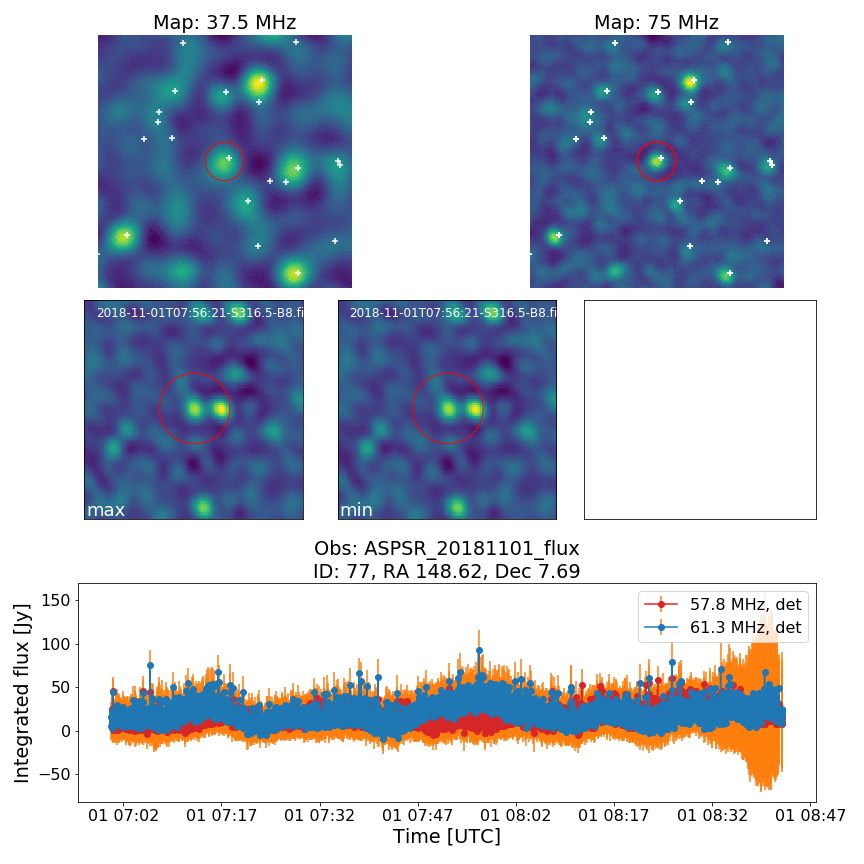

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


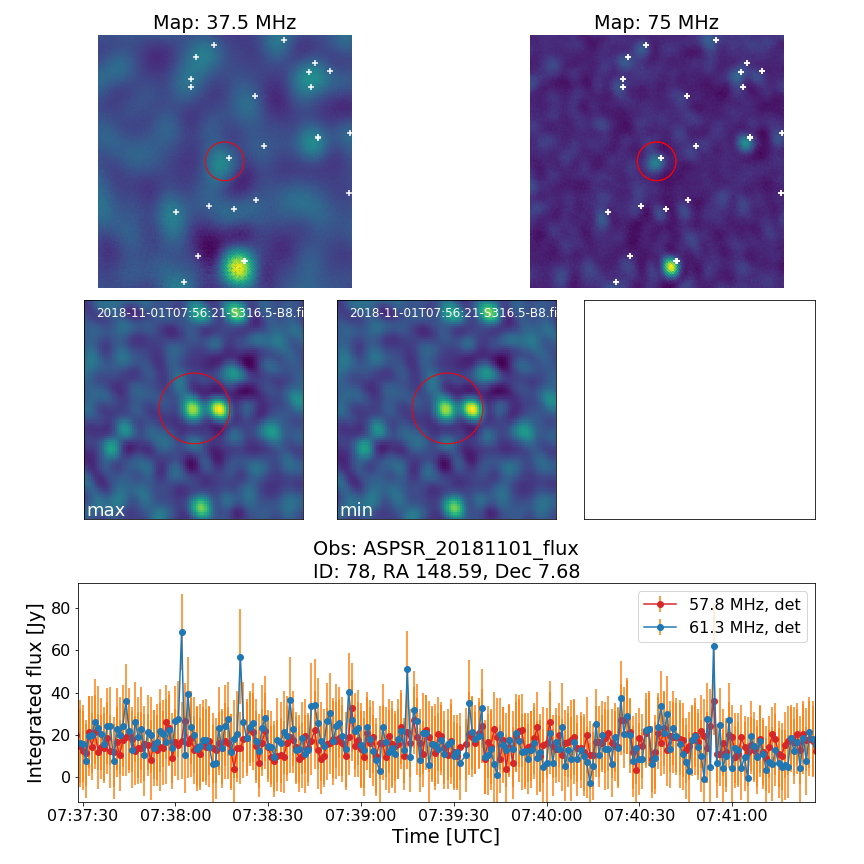

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


<IPython.core.display.Javascript object>


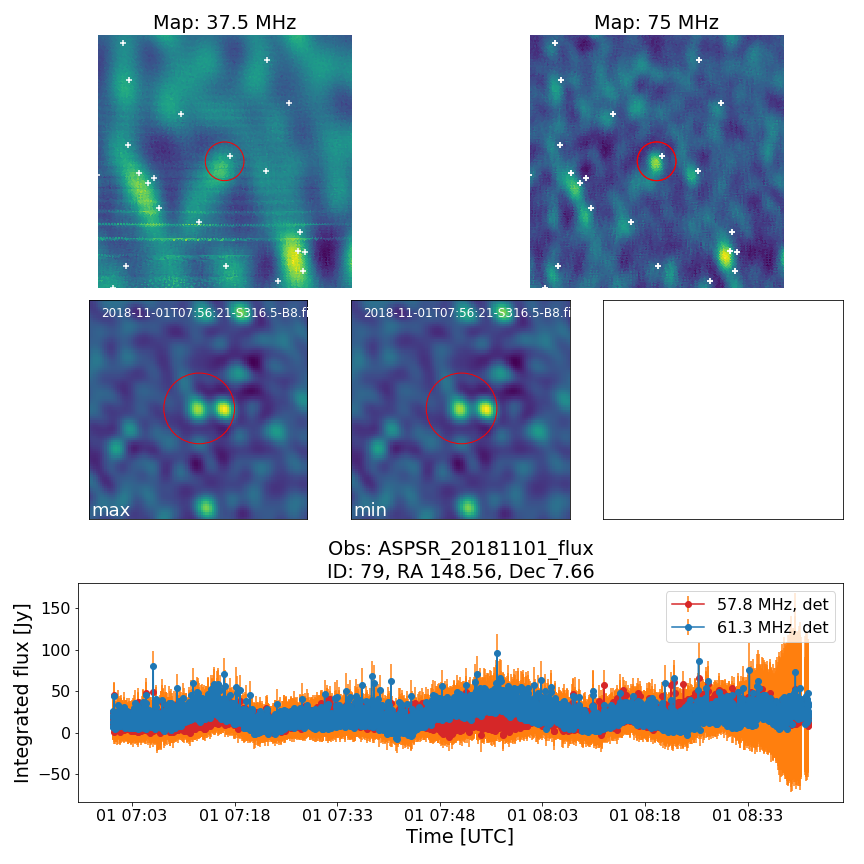

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


In [120]:
%matplotlib notebook

stamp_side = 600
half_side = int(stamp_side/2)

x = np.linspace(0, stamp_side, stamp_side)
y = np.linspace(0, stamp_side, stamp_side)
x, y = np.meshgrid(x, y)


map_dir = "/home/kuiack/skymaps/"
files = glob.glob(map_dir+"*.fits")
BANDS = [os.path.basename(i)[:4] for i in files]

delta = 100 
vlssr_thresh= 5
# i = 3

# source_df = retrieve_source(data, trans_data.runcat.iloc[i])

# print trans_data.runcat.iloc[i]
# del source_df

# 2579, 2460, 1260, 1985

# run_index = 2579 #np.unique(reduced.runcatid)[653]

fig_n = 1


IDS = np.unique(data[data.extract_type == 2].runcatid)
for _ID in IDS:#np.unique(data[data.extract_type == 2].runcatid):#pass_list:#AART_catsource.index:

    source_df = retrieve_source(data, _ID)[:-1]


    
    
    _source_flux = source_df.f_int[(source_df.freq_eff < 60000000) ].values
    _index = source_df.extract_type[(source_df.freq_eff < 60000000) ].values
    _source_flux[(_index == 1)] = np.nan


    plt.figure(fig_n,figsize=(12,12))
    map_load = hp.fitsfunc.read_map(map_dir+BANDS[2]+"_512_map.fits")
    stamp = hp.gnomview(map_load,  xsize=stamp_side,
                        rot=([r_data.loc[_ID].ra,
                              r_data.loc[_ID].decl]),
                        coord="C", return_projected_map=True,
                        fig=fig_n,sub=322,notext=True, title="Map: 75 MHz",cbar=False)

    hp.projscatter(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values,
                vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values, lonlat=True,
                   marker="+", color="white", coord="C")

    hp.projscatter(r_data.loc[_ID].ra,
                   r_data.loc[_ID].decl,lonlat=True,
                   edgecolors="red", facecolor="none", s=1500, coord="C", lw=1)

    map_load = hp.fitsfunc.read_map(map_dir+BANDS[3]+"_512_map.fits")

    stamp = hp.gnomview(map_load, xsize=stamp_side,
                        rot=([r_data.loc[_ID].ra,
                              r_data.loc[_ID].decl]),
                        coord="C", return_projected_map=True, fig=1,sub=321, 
                        notext=True, title="Map: 37.5 MHz",cbar=False)


    hp.projscatter(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values,
                vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values, lonlat=True,
                   marker="+", color="white", coord="C")

    hp.projscatter(r_data.loc[_ID].ra,
                   r_data.loc[_ID].decl,lonlat=True,
                   edgecolors="red", facecolor="none", s=1500, coord="C", lw=1)


    plt.subplot(313)

    plt.errorbar(source_df.taustart_ts[(source_df.freq_eff < 60000000)].values,
                 _source_flux, 
                 yerr = source_df.f_int_err[(source_df.freq_eff < 60000000) ].values,
                 fmt="o-", color="C3",ecolor="C1", label="57.8 MHz, det")

    del _source_flux

    if len(source_df.f_int_err[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values) > 0:
        plt.errorbar(source_df.taustart_ts[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values,
                     source_df.f_int[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values, 
                     yerr = source_df.f_int_err[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values,
                     fmt=".", color="C3",ecolor="C1", label="57.8 MHz, ff")

    # plt.ylim([0,80])
    _source_flux = source_df.f_int[(source_df.freq_eff > 60000000) ].values
    _index = source_df.extract_type[(source_df.freq_eff > 60000000) ].values
    _source_flux[(_index == 1)] = np.nan

    # plt.figure(figsize=(24,8))
    plt.errorbar(source_df.taustart_ts[(source_df.freq_eff > 60000000) ].values,
                 _source_flux, 
                 yerr = source_df.f_int_err[(source_df.freq_eff > 60000000) ].values,
                 fmt="o-",color="C0", ecolor="C1", label="61.3 MHz, det")

    del _source_flux

    if len(source_df.f_int_err[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values) > 0:
        plt.errorbar(source_df.taustart_ts[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values,
                     source_df.f_int[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values, 
                     yerr = source_df.f_int_err[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values,
                     fmt=".", color="C0",ecolor="C1", label="61.3 MHz, ff")


    plt.legend()
    plt.ylabel("Integrated flux [Jy]")
    plt.xlabel("Time [UTC]")
    # plt.xlim([source_df.taustart_ts[source_df.freq_eff > 60000000].values[0],
    #          source_df.taustart_ts[source_df.freq_eff > 60000000].values[10]])

    # plt.xlim([datetime.datetime(year=2017, month=2, day=25,hour=1 , minute=48, second=0),
    #           datetime.datetime(year=2017, month=2, day=25,hour=1 , minute=58, second=0)])

    # plt.savefig("/home/kuiack/scintilation_source.pdf")
#     plt.tight_layout()
    plt.title("Obs: AS"+dbname+"\nID: "+str(_ID)+", RA "+str(round(source_df.ra.mean(),2))+", Dec "+str(round(source_df.decl.mean(),2)))
    
    
    plt.subplot(3,3,4)
    if  os.path.isfile(source_df[ source_df.f_int == source_df.f_int.max()].url[0]):
        filename = source_df[ source_df.f_int == source_df.f_int.max()].url[0]
    elif os.path.isfile("/mnt/ais001/"+source_df[ source_df.f_int == source_df.f_int.max()].url[0].split("/")[2]+"/"+source_df[ source_df.f_int == source_df.f_int.max()].url[0].split("/")[3]+"/"+os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])): 
        filename = "/mnt/ais001/"+source_df[ source_df.f_int == source_df.f_int.max()].url[0].split("/")[2]+"/"+source_df[ source_df.f_int == source_df.f_int.max()].url[0].split("/")[3]+"/"+os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])
    else: 
        filename = "/data/AS_20181101-PSR_0950_flux/"+os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])

        
    wcs = WCS(filename)
    im_pix_x, im_pix_y, n, nn = wcs.wcs_world2pix(source_df.ra.mean(),source_df.decl.mean(),1,1,1)

    pos = [im_pix_x, im_pix_y]

    plt.text(5,92,os.path.basename(filename), color="white", fontsize=12)
    plt.text(0.5,0.5,"max", color="white", fontsize=18)
    plt.imshow(fits.open(filename)[0].data[0,0,pos[1]-delta/2:pos[1]+delta/2,pos[0]-delta/2:pos[0]+delta/2], origin="lower")
    plt.scatter(delta/2,delta/2, s=50*delta, facecolor="none", edgecolor="red")

    plt.xticks([])
    plt.yticks([])
    
    plt.subplot(3,3,5)
    if  os.path.isfile(source_df[ source_df.f_int == source_df.f_int.min()].url[0]):
        filename = source_df[ source_df.f_int == source_df.f_int.min()].url[0]
    elif os.path.isfile("/mnt/"+source_df[ source_df.f_int == source_df.f_int.min()].url[0].split("/")[2]+"/"+source_df[ source_df.f_int == source_df.f_int.min()].url[0].split("/")[3]+"/"+os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])): 
        filename = "/mnt/"+source_df[ source_df.f_int == source_df.f_int.min()].url[0].split("/")[2]+"/"+source_df[ source_df.f_int == source_df.f_int.min()].url[0].split("/")[3]+"/"+os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])
    else: 
        filename = "/data/AS_20181101-PSR_0950_flux/"+os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])

    wcs = WCS(filename)
    im_pix_x, im_pix_y, n, nn = wcs.wcs_world2pix(source_df.ra.mean(),source_df.decl.mean(),1,1,1)

    pos = [im_pix_x, im_pix_y]

    plt.text(5,92,os.path.basename(filename), color="white", fontsize=12)
    plt.text(0.5,0.5,"min", color="white", fontsize=18)
    plt.imshow(fits.open(filename)[0].data[0,0,pos[1]-delta/2:pos[1]+delta/2,pos[0]-delta/2:pos[0]+delta/2], origin="lower")
    plt.scatter(delta/2,delta/2, s=50*delta, facecolor="none", edgecolor="red")
    plt.xticks([])
    plt.yticks([])
    
    plt.subplot(3,3,6)
    plt.plot()
    plt.xticks([])
    plt.yticks([])
    
#     plt.figure(figsize=(10,8))
#     plt.title(str(_ID)+" v_int")
#     plt.plot(source_df.v_int[(source_df.freq_eff < 60000000)], ".",label="57.8 MHz")
#     plt.plot(source_df.v_int[(source_df.freq_eff > 60000000)], ".",label="61.3 MHz")
#     plt.legend()
    
#     plt.figure(figsize=(10,8))
#     plt.title(str(_ID)+" eta")
#     plt.plot(source_df.eta_int[(source_df.freq_eff < 60000000)], ".", label="57.8 MHz")
#     plt.plot(source_df.eta_int[(source_df.freq_eff > 60000000)], ".", label="61.3 MHz")
#     plt.legend()
    plt.tight_layout()
    plt.show()
    fig_n +=1
#     plt.figure(figsize=(12,6))
#     plt.plot(source_df.taustart_ts[(source_df.freq_eff > 60000000) ].values,
#                  source_df.v_int[(source_df.freq_eff > 60000000) ].values, 
#                  color="C5",  label="High band, det")
#     plt.ylabel("V_int")
#     plt.xlabel("Time [UTC]")
#     # plt.xlim([datetime.datetime(year=2017, month=2, day=25,hour=3 , minute=48, second=0),
#     #           datetime.datetime(year=2017, month=2, day=25,hour=4 , minute=10, second=0)])


#     # if _ID == 2578:
#     #     plt.ylim([0,300])

#     # del source_df       
#     #     
#     plt.show()



In [119]:
"/mnt/"+source_df[ source_df.f_int == source_df.f_int.min()].url[0].split("/")[2]+"/"+source_df[ source_df.f_int == source_df.f_int.min()].url[0].split("/")[3]+"/"+os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])

u'/mnt/ais001/AS_20181101-PSR_0950_flux/2018-11-01T08:37:58-S316.5-B8.fits'

In [110]:
os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])

u'2018-11-01T08:37:58-S316.5-B8.fits'

In [84]:
"/data/AS_20181101-PSR_0950_flux/"+filename[18:37]+"*"+filename[38:40]+"*"

'/data/AS_20181101-PSR_0950_flux/2018-11-01T09:05:31*S2*'

In [102]:
basename

u'/mnt/ais001/AS_20181101-PSR_0950_flux/2018-11-01T08:37:58-S316.5-B8.fits'

In [44]:
print source_df.ra.mean()
wcs = WCS(glob.glob("/mnt/ais001/AS_20181101-PSR_0950_flux/"+os.path.basename(filename)[:19]+"*S2*")[0])
wcs.wcs_world2pix(source_df.ra.mean(),source_df.decl.mean(),1,1,1)

146.98


IndexError: list index out of range

In [58]:
print filename
print "/data/AS_20181101-PSR_0950_flux/"+os.path.basename(filename)[:19]+"*"+os.path.basename(filename)[20:22]+"*"
print glob.glob("/data/AS_20181101-PSR_0950_flux/"+os.path.basename(filename)[:19]+"*S2*")[0]

/mnt/ais001/AS_20181101/2018-11-01T09:05:31-S296-B7.fits
/mnt/ais001/AS_20181101-PSR_0950_flux/2018-11-01T09:05:31*S2*
/data/AS_20181101-PSR_0950_flux/2018-11-01T09:05:31-S298.7-B8.fits


<IPython.core.display.Javascript object>


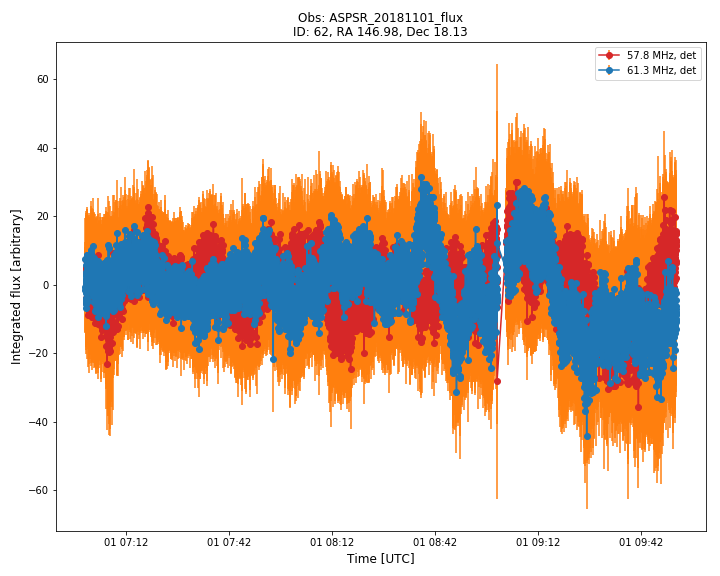

<IPython.core.display.Javascript object>


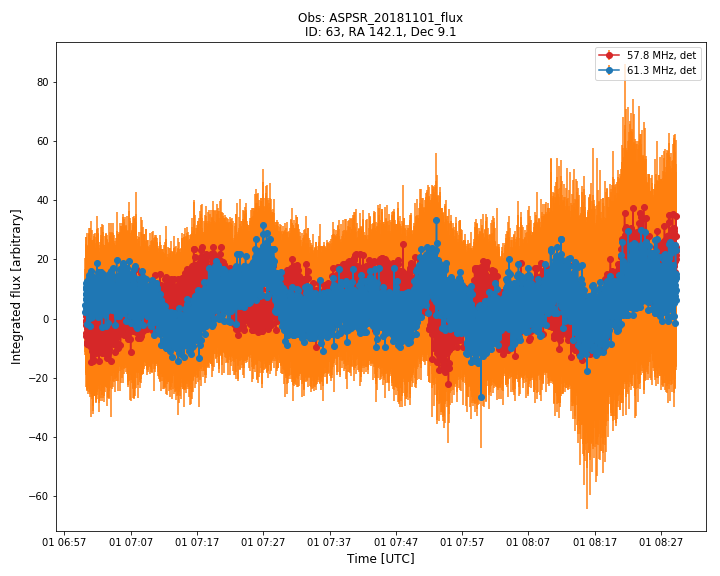

<IPython.core.display.Javascript object>


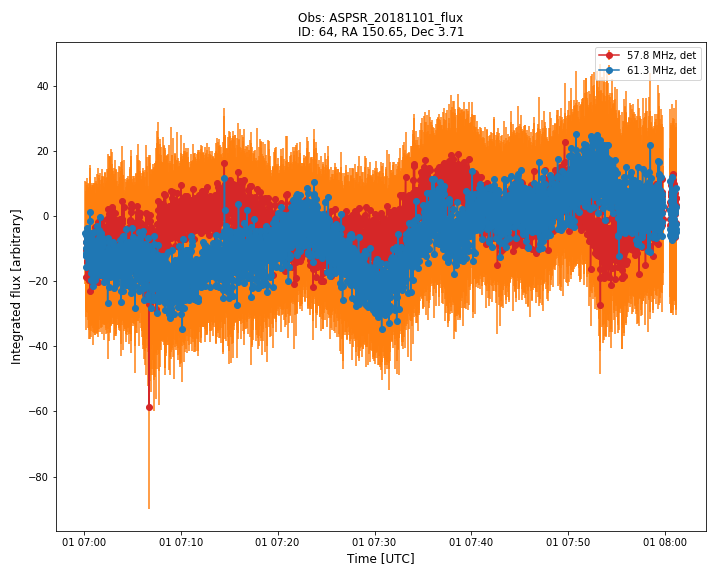

<IPython.core.display.Javascript object>


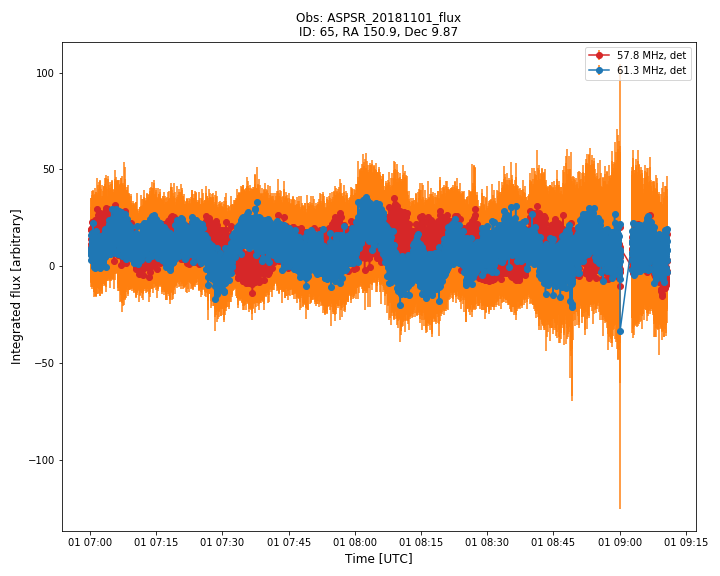

<IPython.core.display.Javascript object>


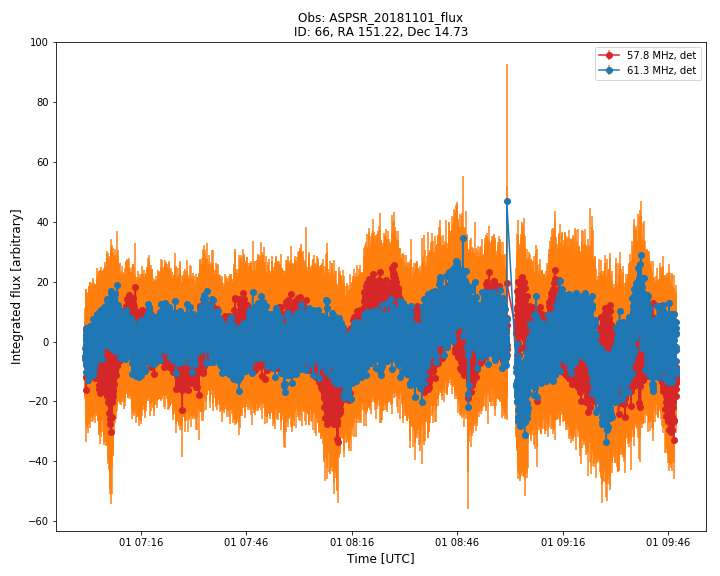

<IPython.core.display.Javascript object>


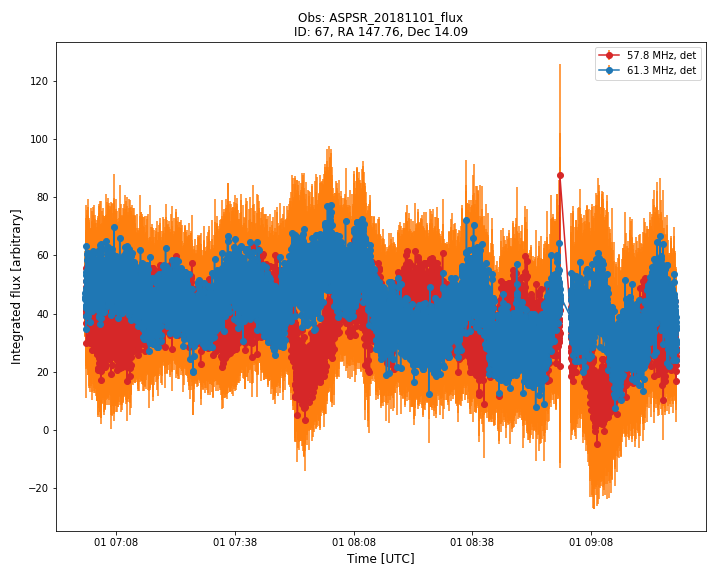

<IPython.core.display.Javascript object>


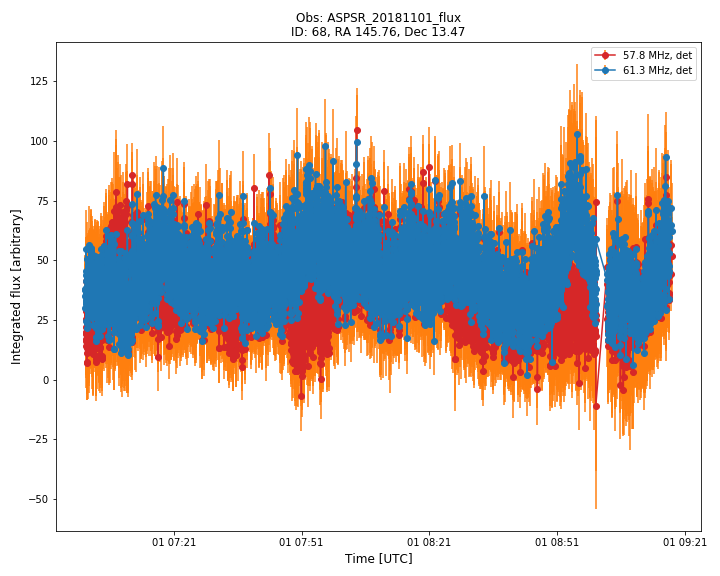

<IPython.core.display.Javascript object>


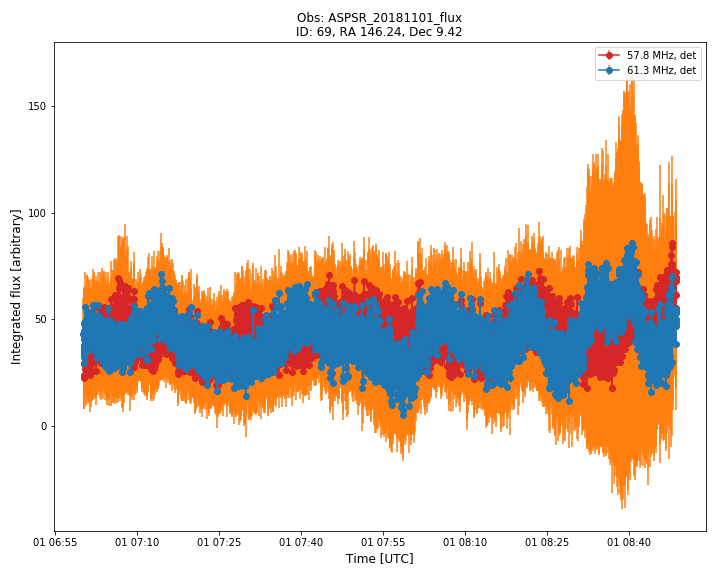

<IPython.core.display.Javascript object>


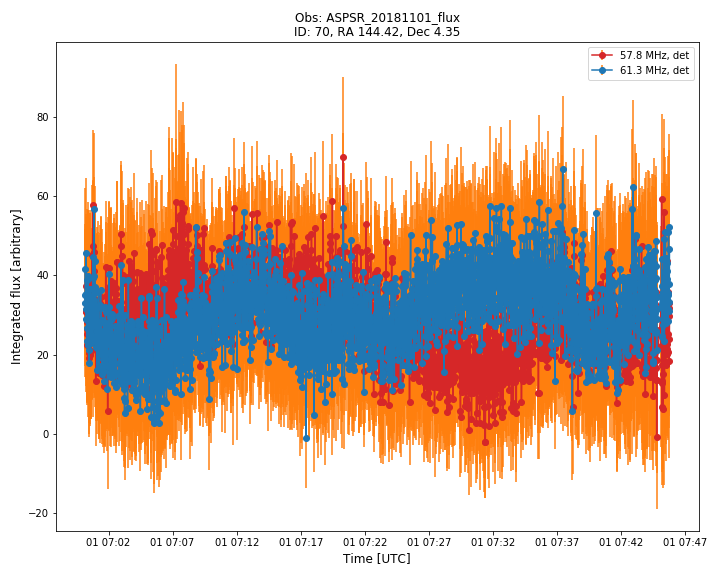

<IPython.core.display.Javascript object>


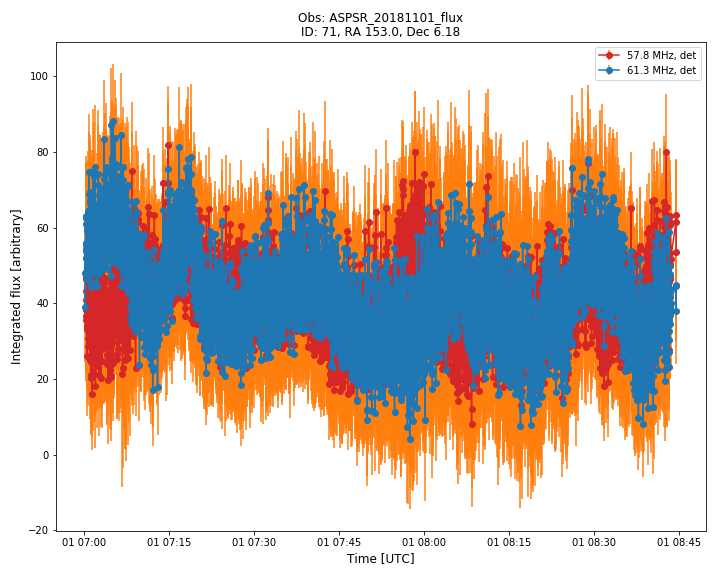

<IPython.core.display.Javascript object>


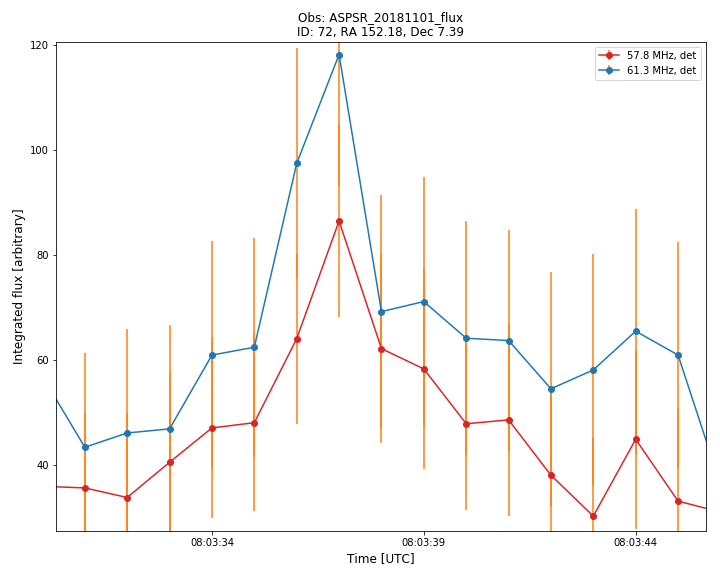

<IPython.core.display.Javascript object>


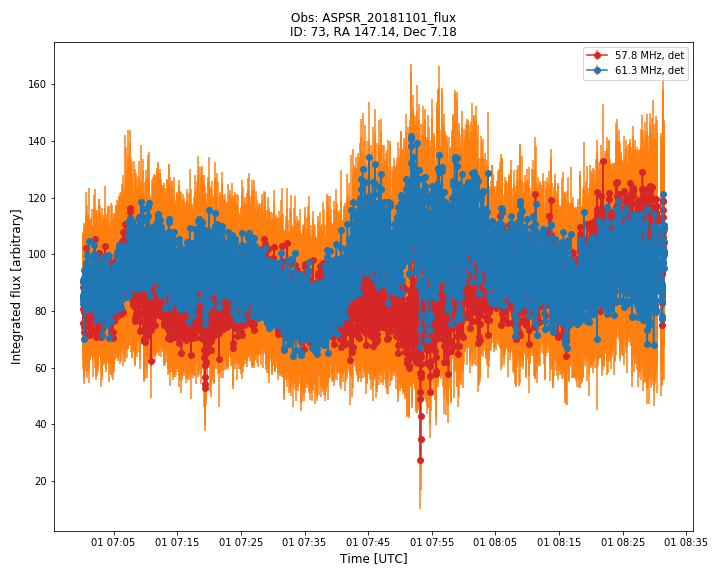

<IPython.core.display.Javascript object>


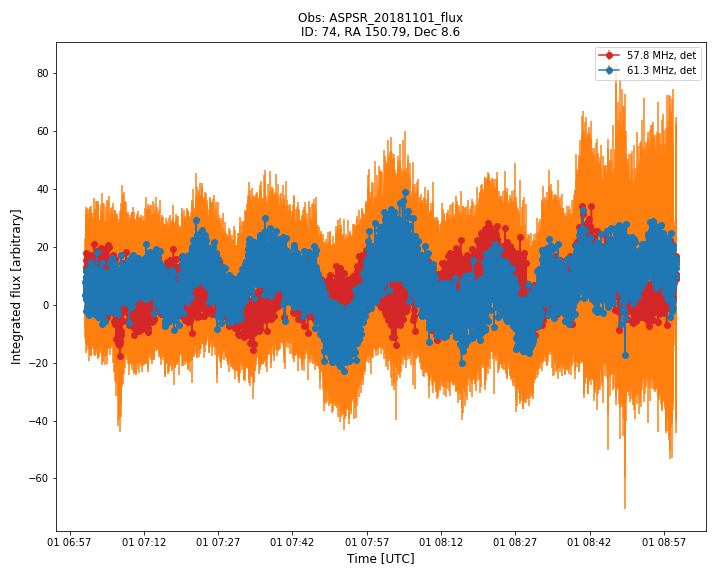

<IPython.core.display.Javascript object>


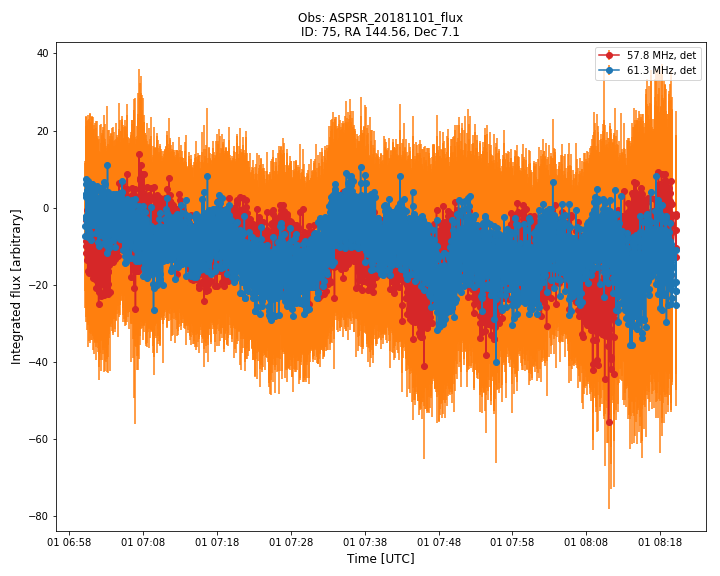

<IPython.core.display.Javascript object>


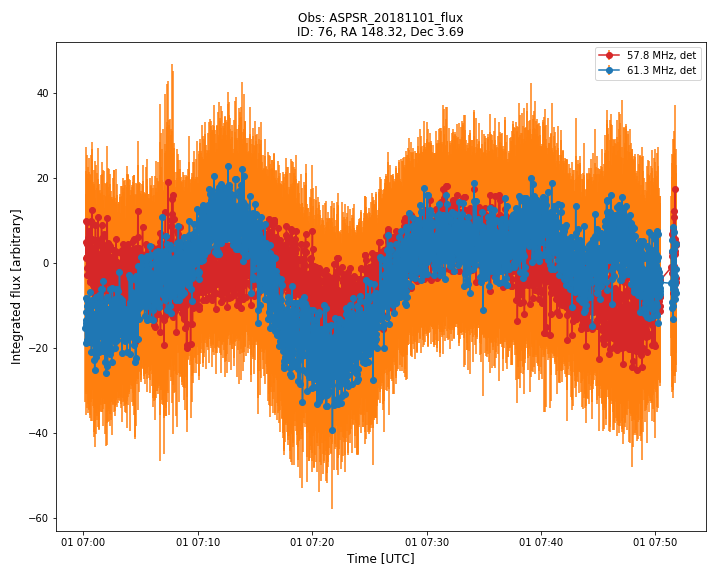

<IPython.core.display.Javascript object>


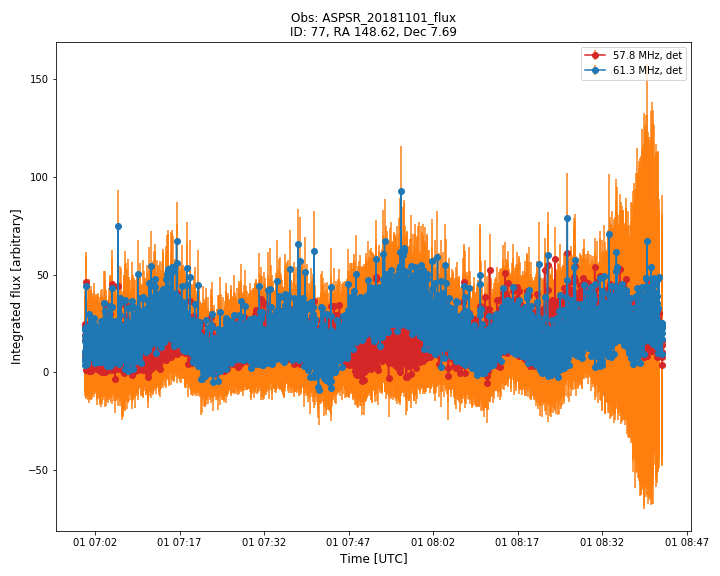

<IPython.core.display.Javascript object>


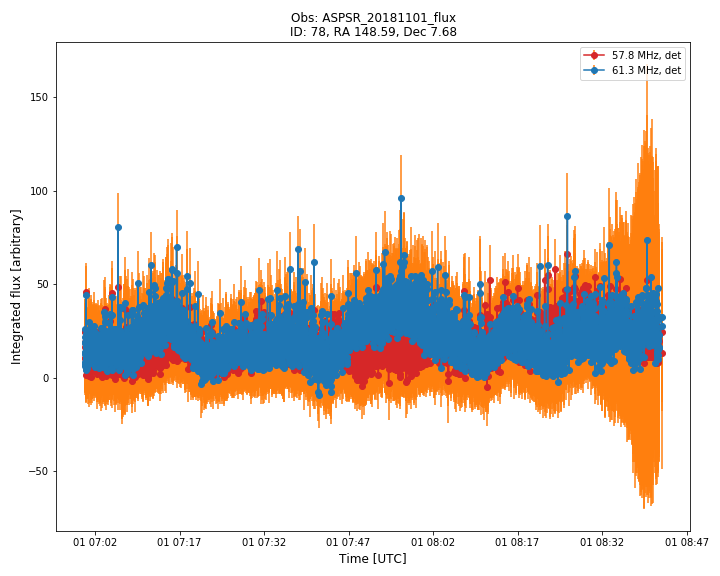

<IPython.core.display.Javascript object>


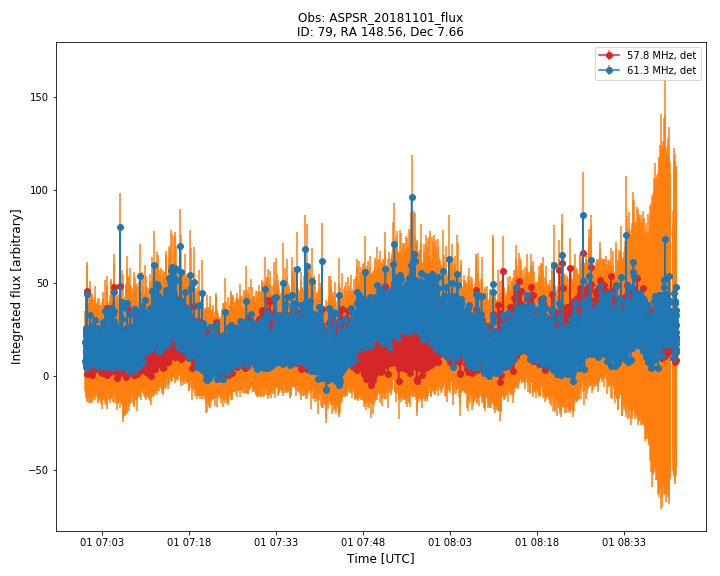

In [23]:
fig_n = 0

for _ID in np.unique(data.runcatid):#np.unique(data[data.extract_type == 2].runcatid):#pass_list:#AART_catsource.index:

    source_df = retrieve_source(data, _ID)


    
    
    _source_flux = source_df.f_int[(source_df.freq_eff < 60000000) ].values
    _index = source_df.extract_type[(source_df.freq_eff < 60000000) ].values
    _source_flux[(_index == 1)] = np.nan


    plt.figure(figsize=(10,8))

    plt.errorbar(source_df.taustart_ts[(source_df.freq_eff < 60000000)].values,
                 _source_flux, 
                 yerr = source_df.f_int_err[(source_df.freq_eff < 60000000) ].values,
                 fmt="o-", color="C3",ecolor="C1", label="57.8 MHz, det")

    del _source_flux

    if len(source_df.f_int_err[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values) > 0:
        plt.errorbar(source_df.taustart_ts[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values,
                     source_df.f_int[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values, 
                     yerr = source_df.f_int_err[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values,
                     fmt=".", color="C3",ecolor="C1", label="57.8 MHz, ff")

    # plt.ylim([0,80])
    _source_flux = source_df.f_int[(source_df.freq_eff > 60000000) ].values
    _index = source_df.extract_type[(source_df.freq_eff > 60000000) ].values
    _source_flux[(_index == 1)] = np.nan

    # plt.figure(figsize=(24,8))
    plt.errorbar(source_df.taustart_ts[(source_df.freq_eff > 60000000) ].values,
                 _source_flux, 
                 yerr = source_df.f_int_err[(source_df.freq_eff > 60000000) ].values,
                 fmt="o-",color="C0", ecolor="C1", label="61.3 MHz, det")

    del _source_flux

    if len(source_df.f_int_err[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values) > 0:
        plt.errorbar(source_df.taustart_ts[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values,
                     source_df.f_int[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values, 
                     yerr = source_df.f_int_err[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values,
                     fmt=".", color="C0",ecolor="C1", label="61.3 MHz, ff")


    plt.legend()
    plt.ylabel("Integrated flux [arbitrary]")
    plt.xlabel("Time [UTC]")

    plt.title("Obs: AS"+dbname+"\nID: "+str(_ID)+", RA "+str(round(source_df.ra.mean(),2))+", Dec "+str(round(source_df.decl.mean(),2)))
    
    
    plt.tight_layout()
    plt.show()
    fig_n +=1

<IPython.core.display.Javascript object>


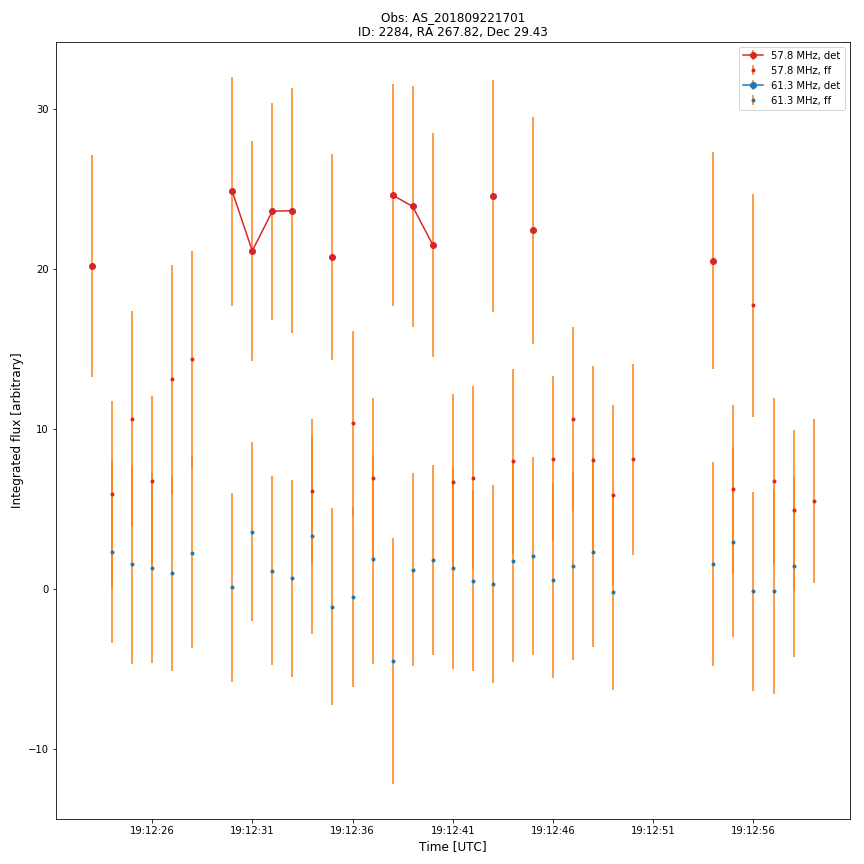

<IPython.core.display.Javascript object>


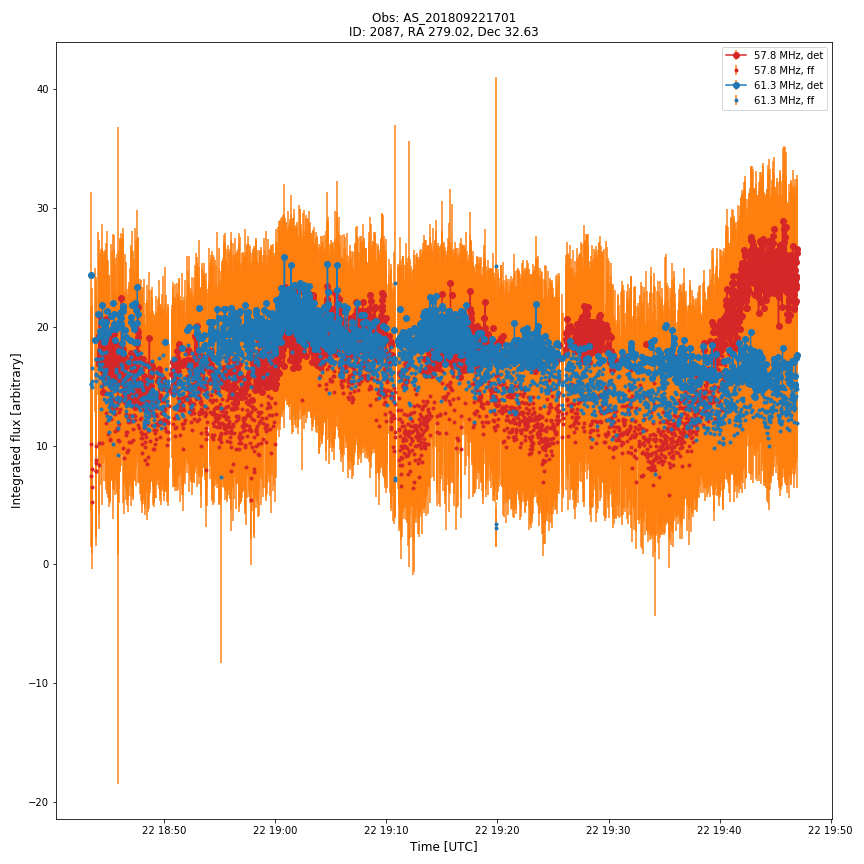

<IPython.core.display.Javascript object>


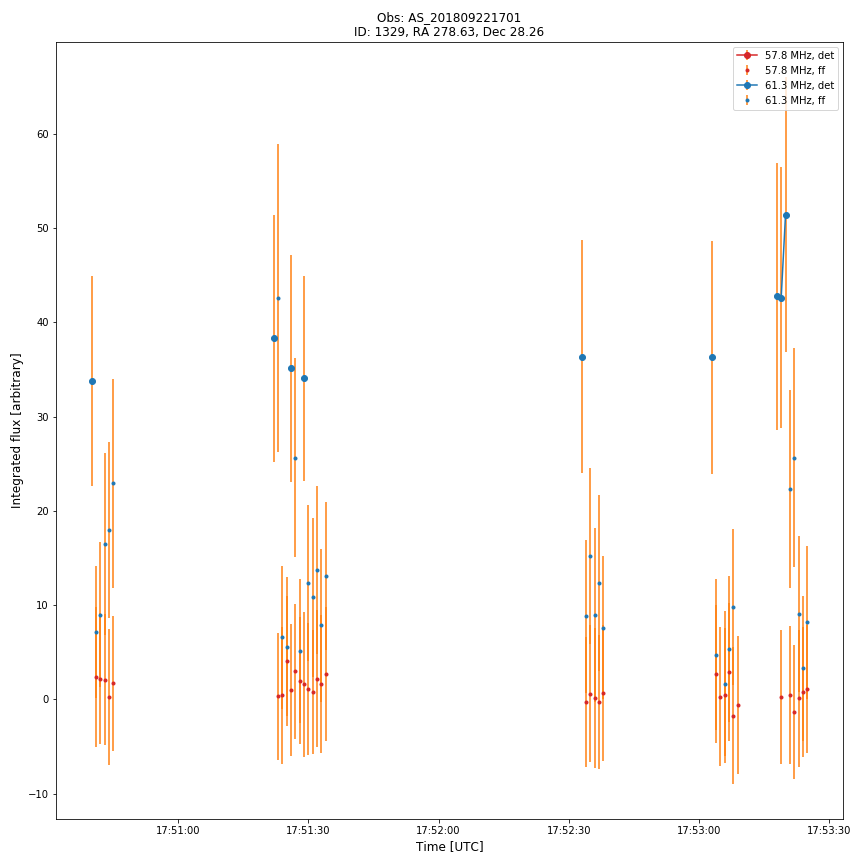

<IPython.core.display.Javascript object>


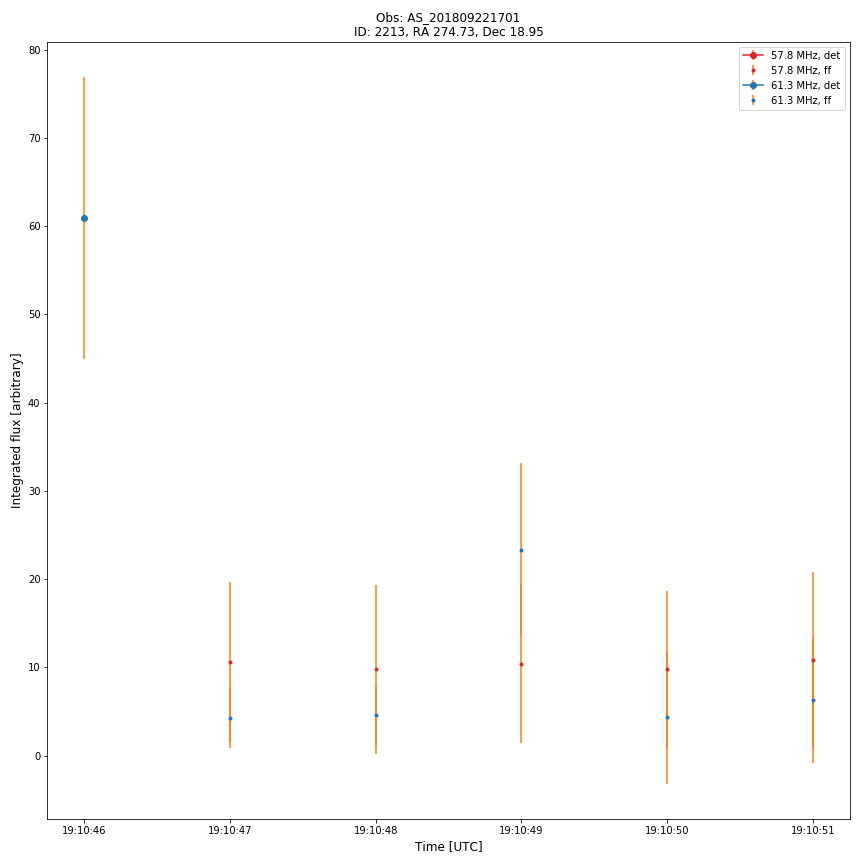

In [75]:
for _ID in [2284,2087,1329,2213]:#np.unique(data[data.extract_type == 2].runcatid):#pass_list:#AART_catsource.index:

    source_df = retrieve_source(data, _ID)


    
    
    _source_flux = source_df.f_int[(source_df.freq_eff < 60000000) ].values
    _index = source_df.extract_type[(source_df.freq_eff < 60000000) ].values
    _source_flux[(_index == 1)] = np.nan


    plt.figure(fig_n,figsize=(12,12))
#     map_load = hp.fitsfunc.read_map(map_dir+BANDS[2]+"_512_map.fits")
#     stamp = hp.gnomview(map_load,  xsize=stamp_side,
#                         rot=([base.loc[_ID].ra,
#                               base.loc[_ID].decl]),
#                         coord="C", return_projected_map=True,
#                         fig=fig_n,sub=322,notext=True, title="Map: 75 MHz",cbar=False)

#     hp.projscatter(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values,
#                 vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values, lonlat=True,
#                    marker="+", color="white", coord="C")

#     hp.projscatter(base.loc[_ID].ra,
#                    base.loc[_ID].decl,lonlat=True,
#                    edgecolors="red", facecolor="none", s=1500, coord="C", lw=1)

#     map_load = hp.fitsfunc.read_map(map_dir+BANDS[3]+"_512_map.fits")

#     stamp = hp.gnomview(map_load, xsize=stamp_side,
#                         rot=([base.loc[_ID].ra,
#                               base.loc[_ID].decl]),
#                         coord="C", return_projected_map=True, fig=1,sub=321, 
#                         notext=True, title="Map: 37.5 MHz",cbar=False)


#     hp.projscatter(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values,
#                 vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values, lonlat=True,
#                    marker="+", color="white", coord="C")

#     hp.projscatter(base.loc[_ID].ra,
#                    base.loc[_ID].decl,lonlat=True,
#                    edgecolors="red", facecolor="none", s=1500, coord="C", lw=1)


#     plt.subplot(313)

    plt.errorbar(source_df.taustart_ts[(source_df.freq_eff < 60000000)].values,
                 _source_flux, 
                 yerr = source_df.f_int_err[(source_df.freq_eff < 60000000) ].values,
                 fmt="o-", color="C3",ecolor="C1", label="57.8 MHz, det")

    del _source_flux

    if len(source_df.f_int_err[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values) > 0:
        plt.errorbar(source_df.taustart_ts[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values,
                     source_df.f_int[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values, 
                     yerr = source_df.f_int_err[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values,
                     fmt=".", color="C3",ecolor="C1", label="57.8 MHz, ff")

    # plt.ylim([0,80])
    _source_flux = source_df.f_int[(source_df.freq_eff > 60000000) ].values
    _index = source_df.extract_type[(source_df.freq_eff > 60000000) ].values
    _source_flux[(_index == 1)] = np.nan

    # plt.figure(figsize=(24,8))
    plt.errorbar(source_df.taustart_ts[(source_df.freq_eff > 60000000) ].values,
                 _source_flux, 
                 yerr = source_df.f_int_err[(source_df.freq_eff > 60000000) ].values,
                 fmt="o-",color="C0", ecolor="C1", label="61.3 MHz, det")

    del _source_flux

    if len(source_df.f_int_err[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values) > 0:
        plt.errorbar(source_df.taustart_ts[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values,
                     source_df.f_int[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values, 
                     yerr = source_df.f_int_err[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values,
                     fmt=".", color="C0",ecolor="C1", label="61.3 MHz, ff")


    plt.legend()
    plt.ylabel("Integrated flux [arbitrary]")
    plt.xlabel("Time [UTC]")
    # plt.xlim([source_df.taustart_ts[source_df.freq_eff > 60000000].values[0],
    #          source_df.taustart_ts[source_df.freq_eff > 60000000].values[10]])

    # plt.xlim([datetime.datetime(year=2017, month=2, day=25,hour=1 , minute=48, second=0),
    #           datetime.datetime(year=2017, month=2, day=25,hour=1 , minute=58, second=0)])

    # plt.savefig("/home/kuiack/scintilation_source.pdf")
#     plt.tight_layout()
    plt.title("Obs: AS"+dbname+"\nID: "+str(_ID)+", RA "+str(round(source_df.ra.mean(),2))+", Dec "+str(round(source_df.decl.mean(),2)))
    
    
#     plt.subplot(3,3,4)
#     if  os.path.isfile(source_df[ source_df.f_int == source_df.f_int.max()].url[0]):
#         filename = source_df[ source_df.f_int == source_df.f_int.max()].url[0]
#     else: 
#         filename = "/mnt/ais001/"+source_df[ source_df.f_int == source_df.f_int.max()].url[0].split("/")[2]+"/"+source_df[ source_df.f_int == source_df.f_int.max()].url[0].split("/")[3]

        
#     wcs = WCS(filename)
#     im_pix_x, im_pix_y, n, nn = wcs.wcs_world2pix(source_df.ra.mean(),source_df.decl.mean(),1,1,1)

#     pos = [im_pix_x, im_pix_y]

#     plt.text(5,92,os.path.basename(filename), color="white", fontsize=12)
#     plt.text(0.5,0.5,"max", color="white", fontsize=18)
#     plt.imshow(fits.open(filename)[0].data[0,0,pos[1]-delta/2:pos[1]+delta/2,pos[0]-delta/2:pos[0]+delta/2], origin="lower")
#     plt.scatter(delta/2,delta/2, s=50*delta, facecolor="none", edgecolor="red")

#     plt.xticks([])
#     plt.yticks([])
    
#     plt.subplot(3,3,5)
#     if  os.path.isfile(source_df[ source_df.f_int == source_df.f_int.min()].url[0]):
#         filename = source_df[ source_df.f_int == source_df.f_int.min()].url[0]

#     wcs = WCS(filename)
#     im_pix_x, im_pix_y, n, nn = wcs.wcs_world2pix(source_df.ra.mean(),source_df.decl.mean(),1,1,1)

#     pos = [im_pix_x, im_pix_y]

#     plt.text(5,92,os.path.basename(filename), color="white", fontsize=12)
#     plt.text(0.5,0.5,"min", color="white", fontsize=18)
#     plt.imshow(fits.open(filename)[0].data[0,0,pos[1]-delta/2:pos[1]+delta/2,pos[0]-delta/2:pos[0]+delta/2], origin="lower")
#     plt.scatter(delta/2,delta/2, s=50*delta, facecolor="none", edgecolor="red")
#     plt.xticks([])
#     plt.yticks([])
    
#     plt.subplot(3,3,6)
#     plt.plot()
#     plt.xticks([])
#     plt.yticks([])
    
#     plt.figure(figsize=(10,8))
#     plt.title(str(_ID)+" v_int")
#     plt.plot(source_df.v_int[(source_df.freq_eff < 60000000)], ".",label="57.8 MHz")
#     plt.plot(source_df.v_int[(source_df.freq_eff > 60000000)], ".",label="61.3 MHz")
#     plt.legend()
    
#     plt.figure(figsize=(10,8))
#     plt.title(str(_ID)+" eta")
#     plt.plot(source_df.eta_int[(source_df.freq_eff < 60000000)], ".", label="57.8 MHz")
#     plt.plot(source_df.eta_int[(source_df.freq_eff > 60000000)], ".", label="61.3 MHz")
#     plt.legend()
    plt.tight_layout()
    plt.show()
    fig_n +=1

## Single Subband lightcurve

In [22]:
np.unique(data.freq_eff)

16

In [28]:
target_ra = 273.5
target_decl = 26.5

# target_ra = 311.
# target_decl = 50.


# target_ra = 148.56
# target_decl = 7.66

radius = 1



# IDS = np.unique(data[(data.ra > target_ra-radius) &  (data.ra < target_ra+radius) &
#                      (data.decl > target_decl-radius) &  (data.decl < target_decl+radius) &
#                      (data.extract_type == 2)].runcatid )
IDS = np.unique(data[(data.ra > target_ra-radius) &  (data.ra < target_ra+radius) &
                     (data.decl > target_decl-radius) &  (data.decl < target_decl+radius) ].runcatid )

print IDS

[  1   2 216 221 231 234 235 236 241 244 245 246 248]


In [46]:
IDS = []
aart_flux = []

for i in range(len(aart)):


    target_ra = aart.iloc[i].ra
    target_decl = aart.iloc[i].decl

# target_ra = 311.
# target_decl = 50.


# target_ra = 148.56
# target_decl = 7.66

    radius = 0.5



# IDS = np.unique(data[(data.ra > target_ra-radius) &  (data.ra < target_ra+radius) &
#                      (data.decl > target_decl-radius) &  (data.decl < target_decl+radius) &
#                      (data.extract_type == 2)].runcatid )
    ID = np.unique(data[(data.ra > target_ra-radius) &  (data.ra < target_ra+radius) &
                     (data.decl > target_decl-radius) &  (data.decl < target_decl+radius) ].runcatid )
    try:
        print ID[0]
        IDS.append(ID[0])
        aart_flux.append(aart.iloc[i].f_int)
    except IndexError:
        continue 



45
2
159
152
187
126
268
80
79
196
129
3
317
112
168
174
304
203
110
309
144
5
294
55
80
207
9
139
148
250
135
115
122
127
300
134
130
4
157
284
118
253
307


In [23]:
[215,220,230,233,234,235,240,243,244,245,247,281,283,239,186,152,137,249,309,304]

356

In [13]:
[1,2,3,4,5,196,197,288]

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
       118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
       131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
       144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
       157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169,
       170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 18

In [33]:
IDS = []
aart_flux = []

for i in range(len(aart)):


    target_ra = aart.iloc[i].ra
    target_decl = aart.iloc[i].decl

# target_ra = 311.
# target_decl = 50.


# target_ra = 148.56
# target_decl = 7.66

    radius = 0.5



# IDS = np.unique(data[(data.ra > target_ra-radius) &  (data.ra < target_ra+radius) &
#                      (data.decl > target_decl-radius) &  (data.decl < target_decl+radius) &
#                      (data.extract_type == 2)].runcatid )
    ID = np.unique(data[(data.ra > target_ra-radius) &  (data.ra < target_ra+radius) &
                     (data.decl > target_decl-radius) &  (data.decl < target_decl+radius) ].runcatid )
    try:
#         print ID[0]
        IDS.append(ID[0])
        aart_flux.append(aart.iloc[i].f_int)
    except IndexError:
        continue 

IDS.append(1)
aart_flux.append("non")

45
2
159
152
187
126
268
80
79
196
129
3
317
112
168
174
304
203
110
309
144
5
294
55
80
207
9
139
148
250
135
115
122
127
300
134
130
4
157
284
118
253
307


<IPython.core.display.Javascript object>


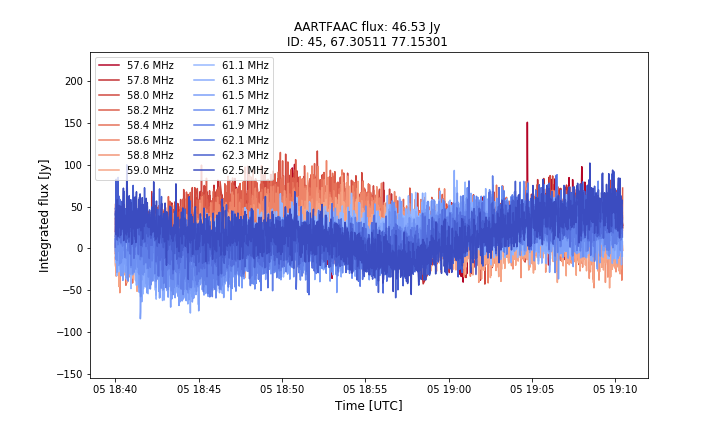

<IPython.core.display.Javascript object>


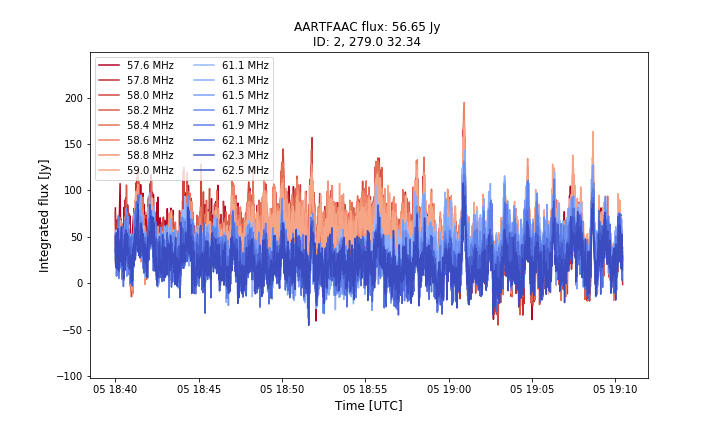

<IPython.core.display.Javascript object>


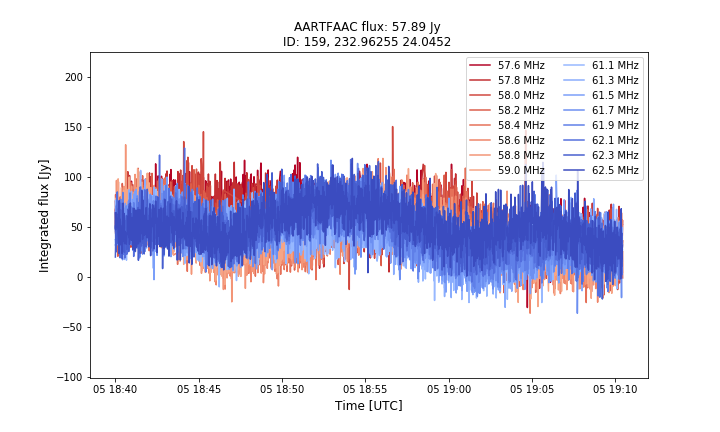

<IPython.core.display.Javascript object>


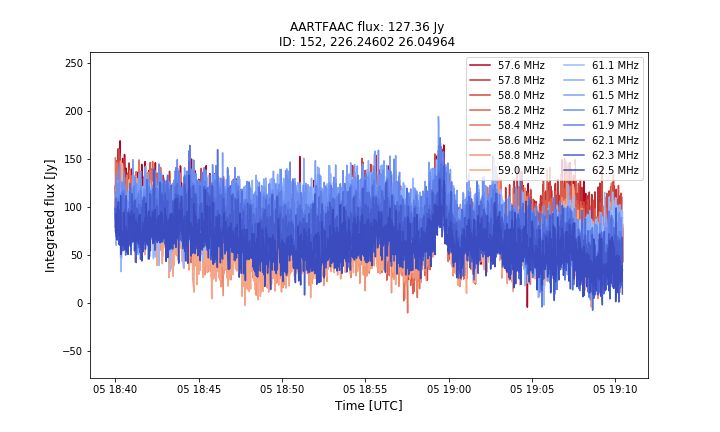

<IPython.core.display.Javascript object>


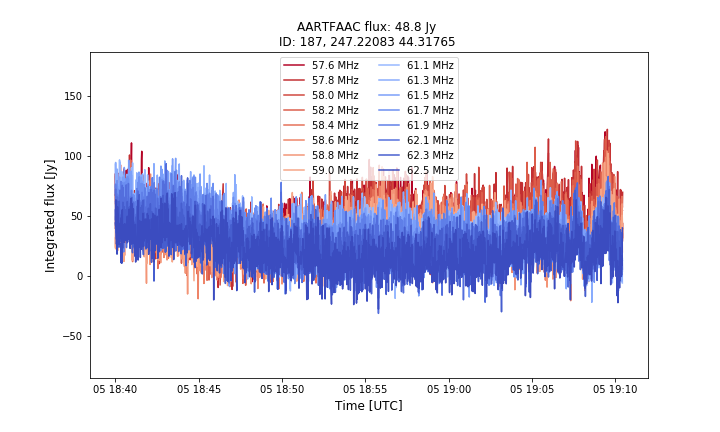

<IPython.core.display.Javascript object>


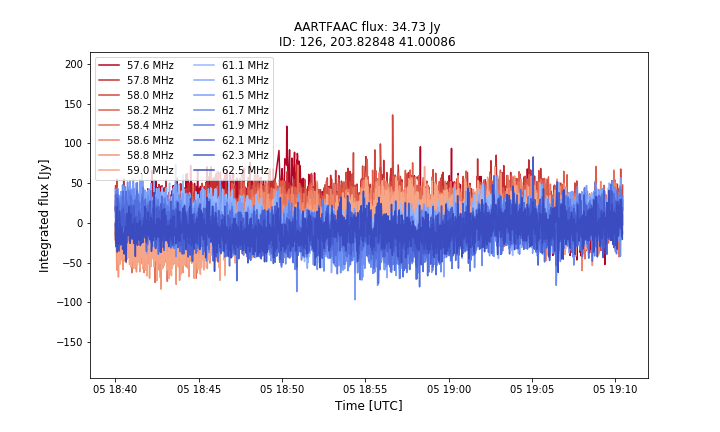

<IPython.core.display.Javascript object>


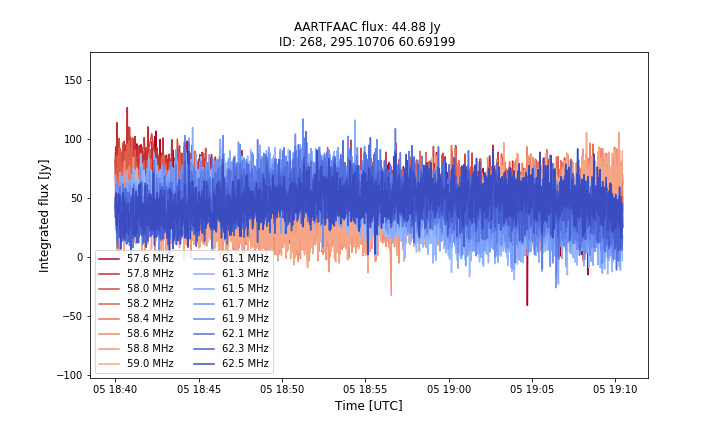

<IPython.core.display.Javascript object>


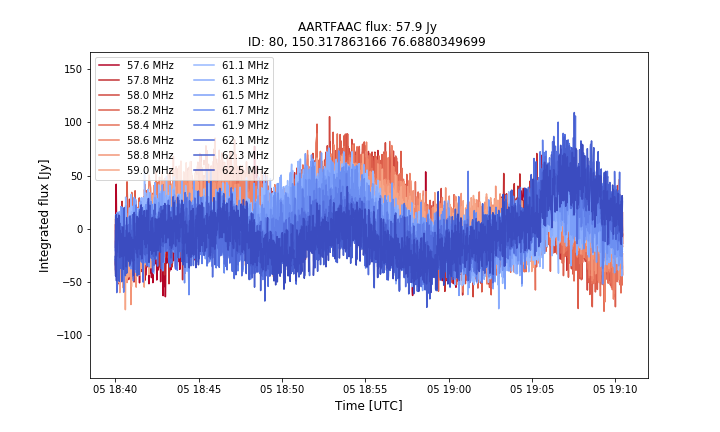

<IPython.core.display.Javascript object>


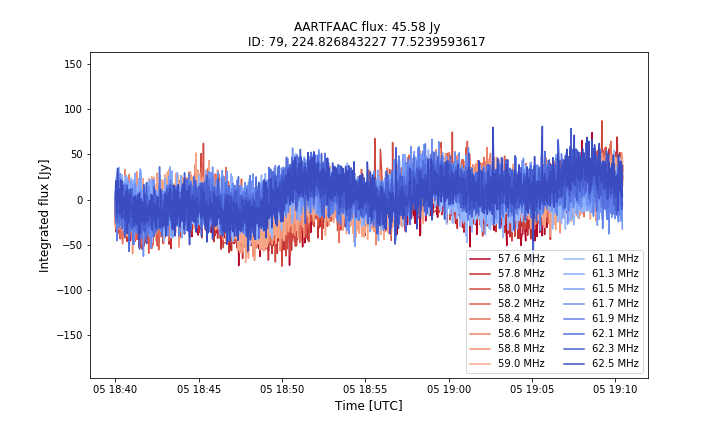

<IPython.core.display.Javascript object>


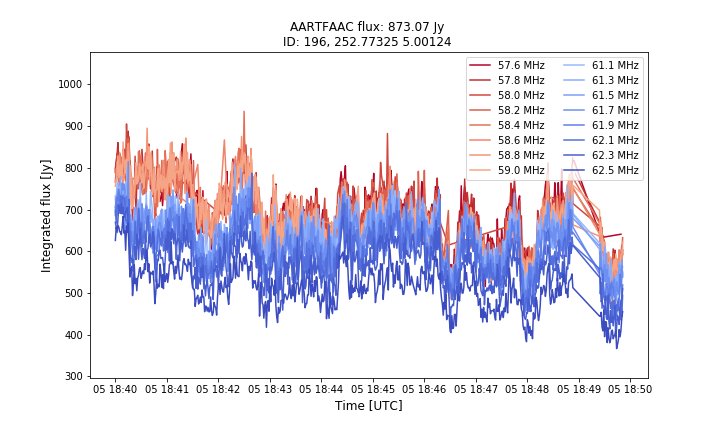

<IPython.core.display.Javascript object>


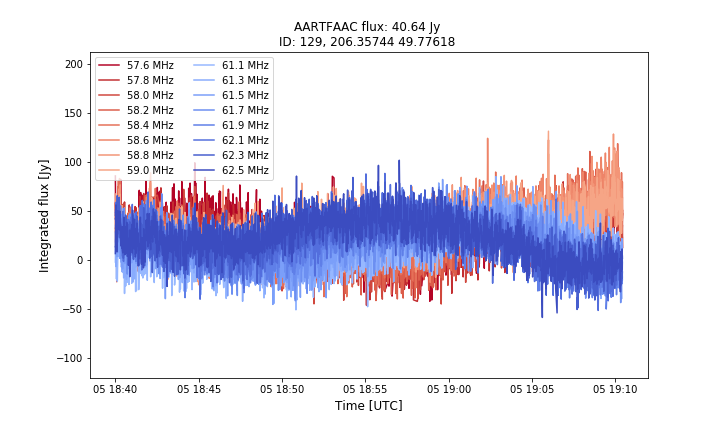

<IPython.core.display.Javascript object>


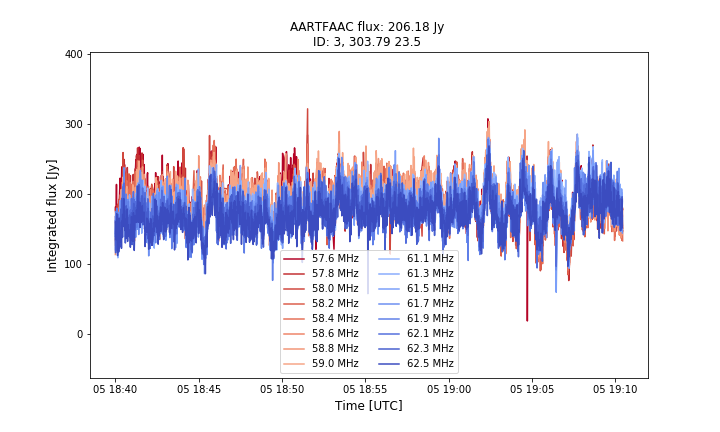

<IPython.core.display.Javascript object>


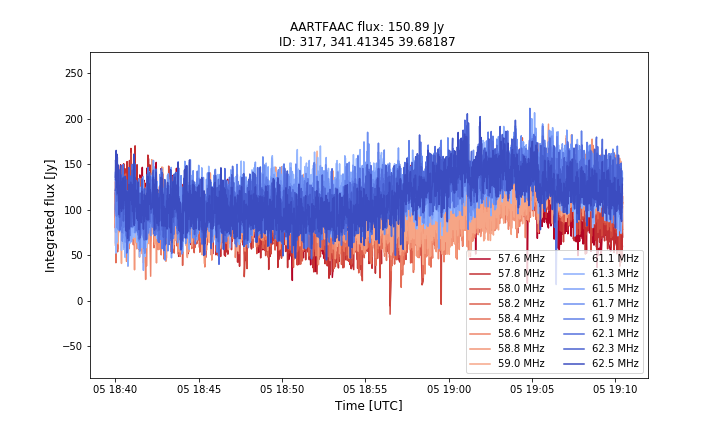

<IPython.core.display.Javascript object>


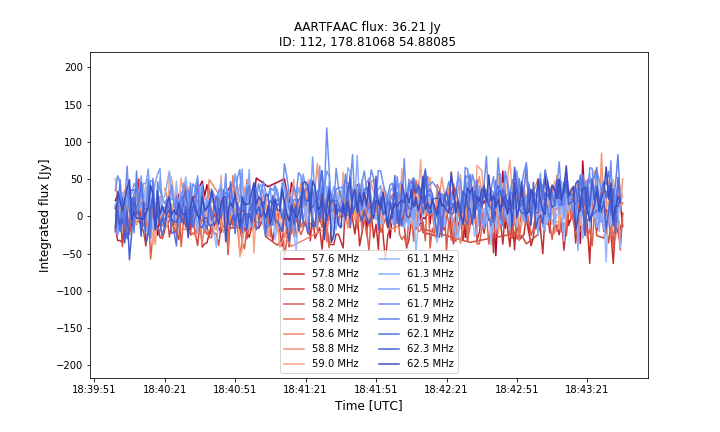

<IPython.core.display.Javascript object>


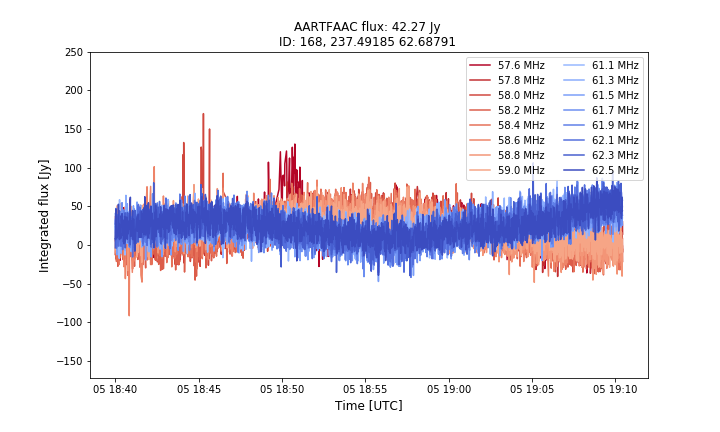

<IPython.core.display.Javascript object>


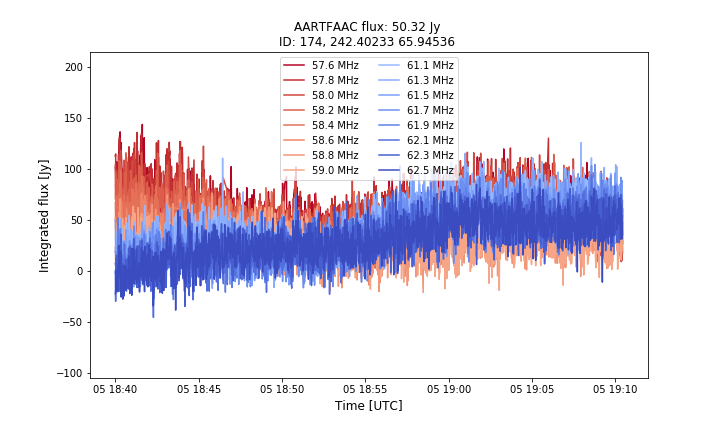

<IPython.core.display.Javascript object>


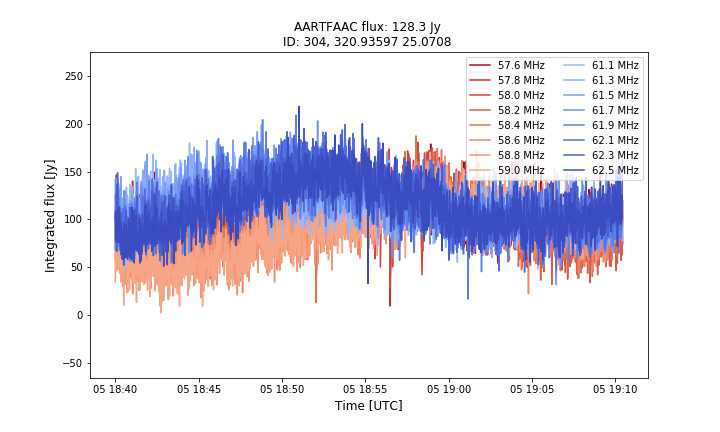

<IPython.core.display.Javascript object>


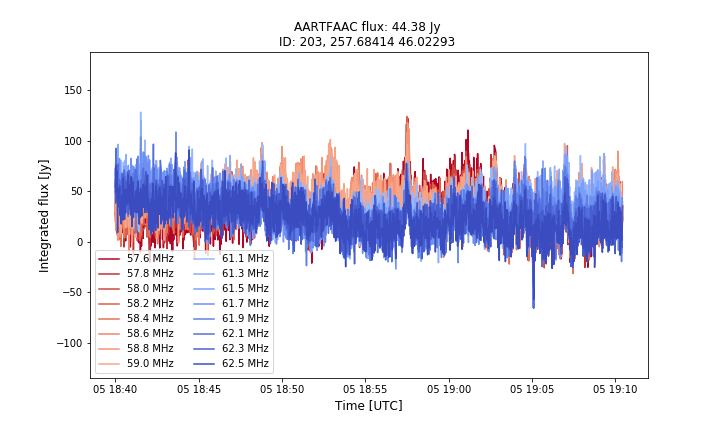

<IPython.core.display.Javascript object>


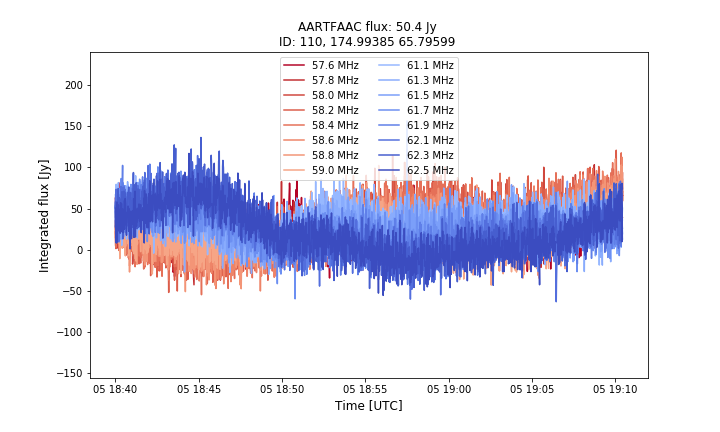

<IPython.core.display.Javascript object>


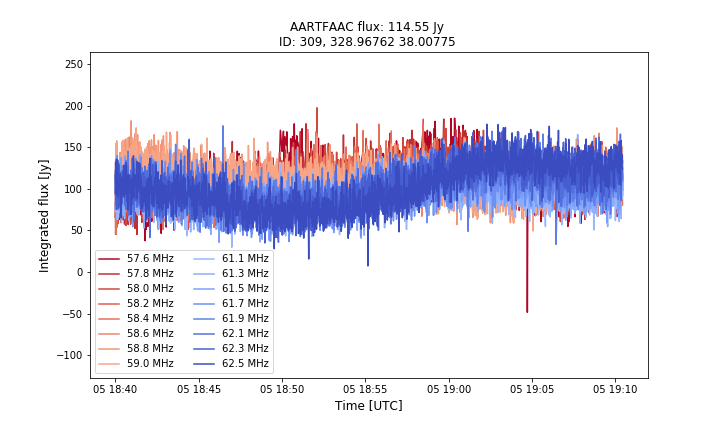

<IPython.core.display.Javascript object>


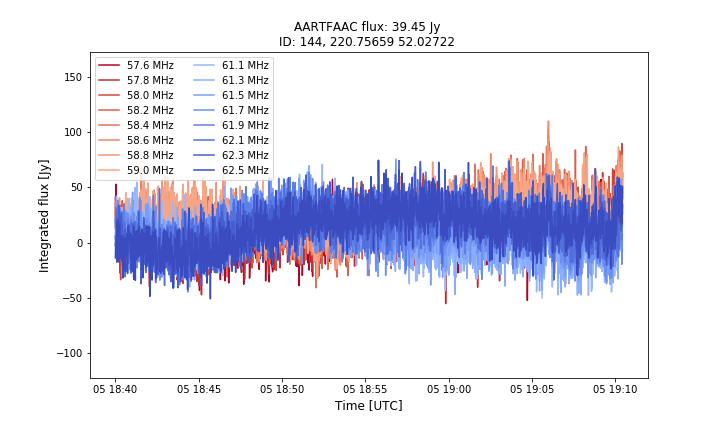

<IPython.core.display.Javascript object>


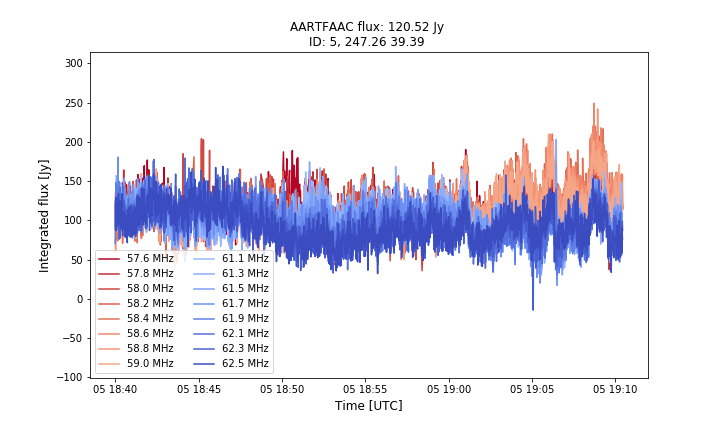

<IPython.core.display.Javascript object>


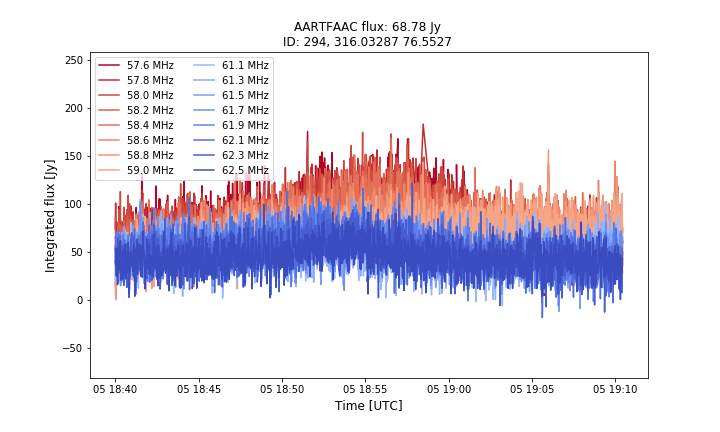

<IPython.core.display.Javascript object>


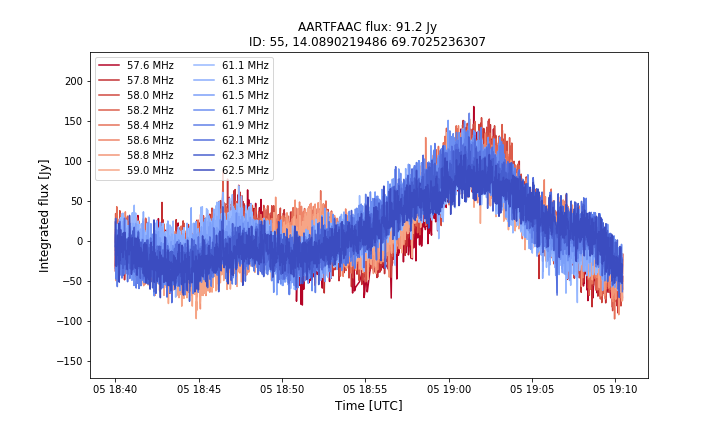

<IPython.core.display.Javascript object>


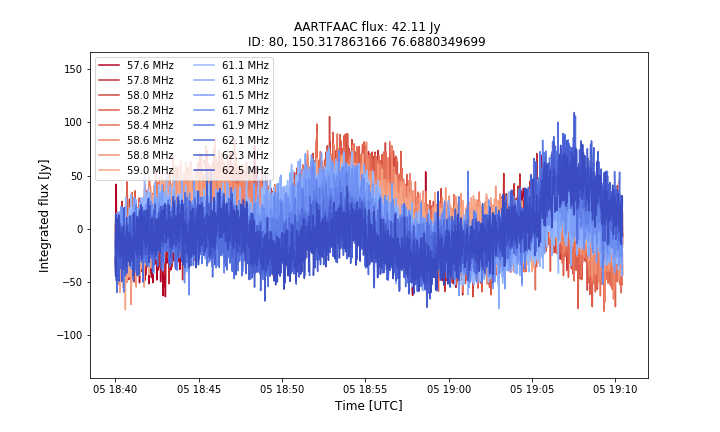

<IPython.core.display.Javascript object>


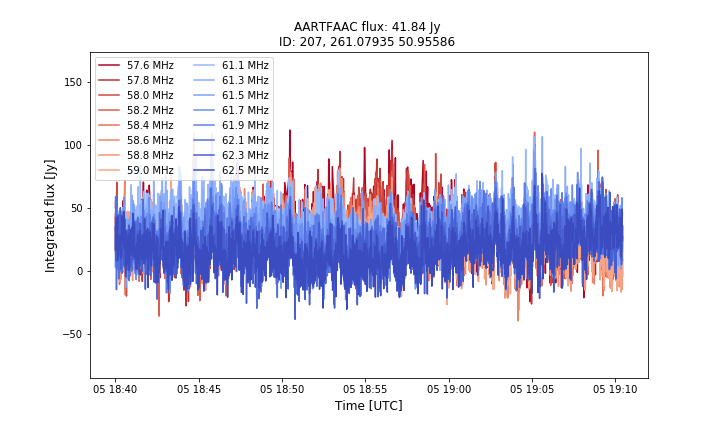

<IPython.core.display.Javascript object>


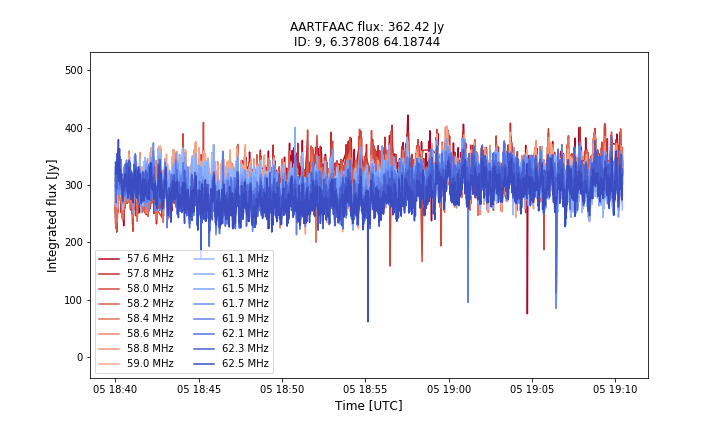

<IPython.core.display.Javascript object>


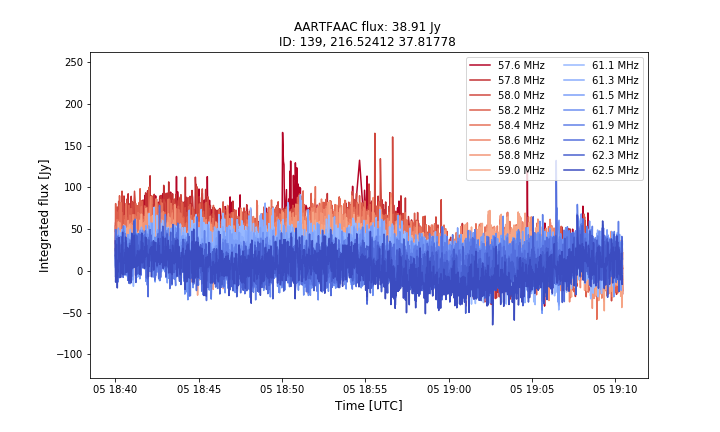

<IPython.core.display.Javascript object>


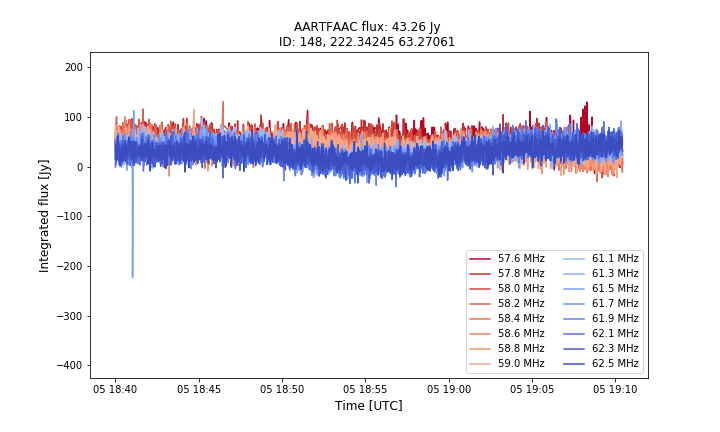

<IPython.core.display.Javascript object>


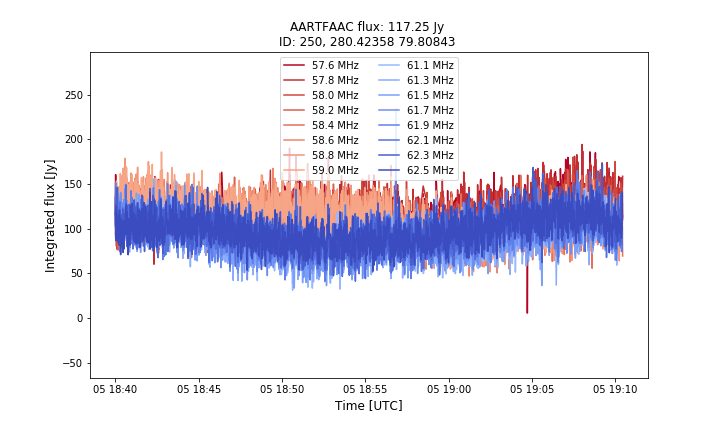

<IPython.core.display.Javascript object>


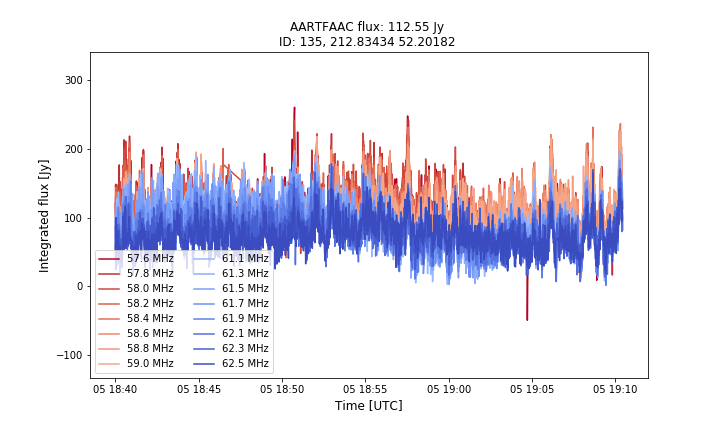

<IPython.core.display.Javascript object>


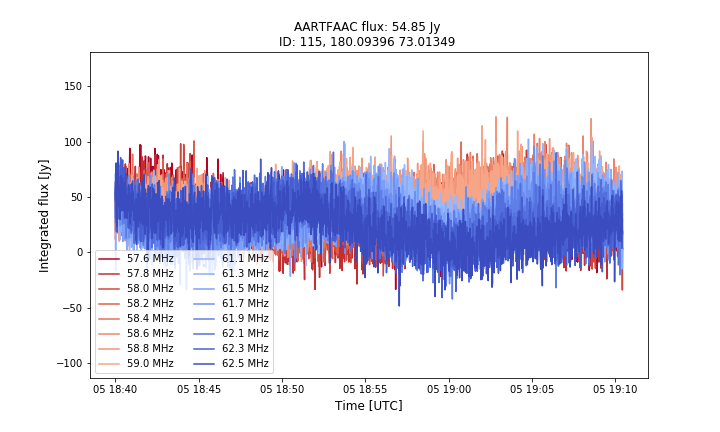

<IPython.core.display.Javascript object>


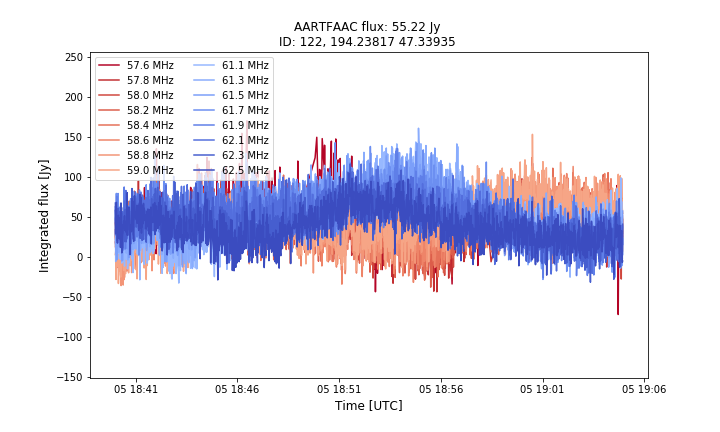

<IPython.core.display.Javascript object>


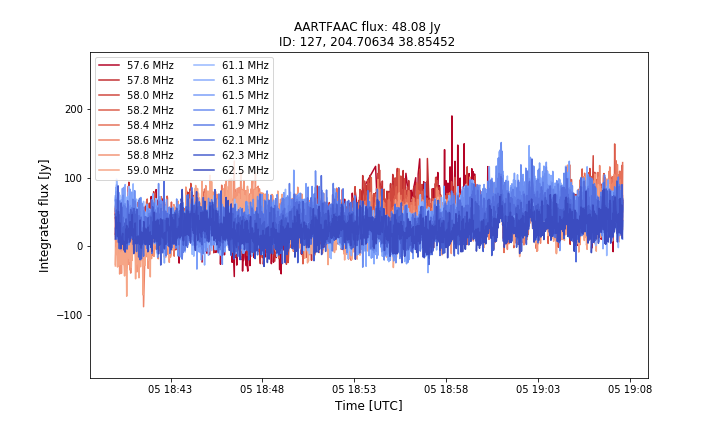

<IPython.core.display.Javascript object>


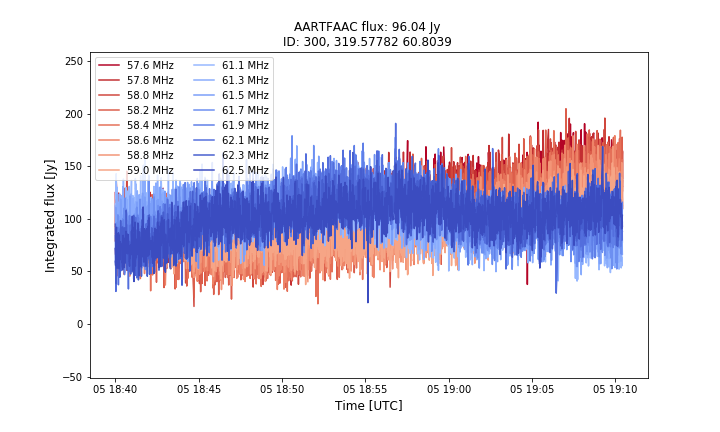

<IPython.core.display.Javascript object>


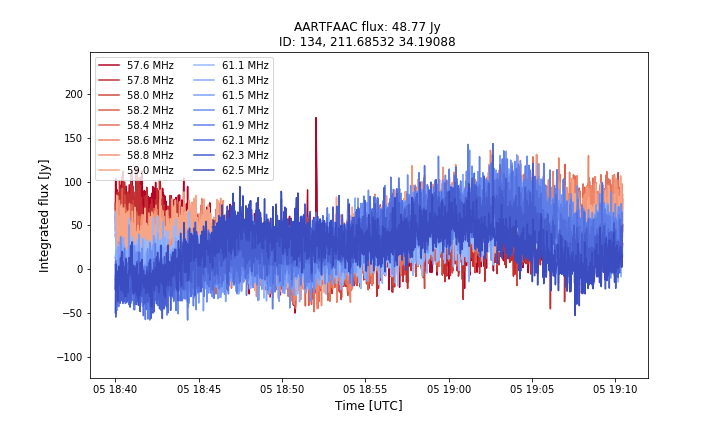

<IPython.core.display.Javascript object>


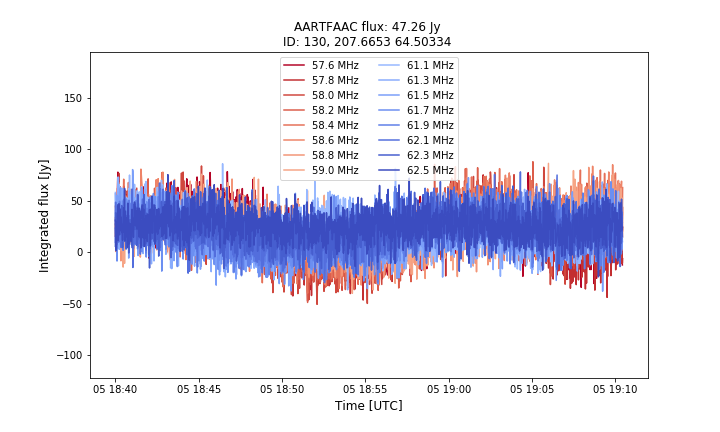

<IPython.core.display.Javascript object>


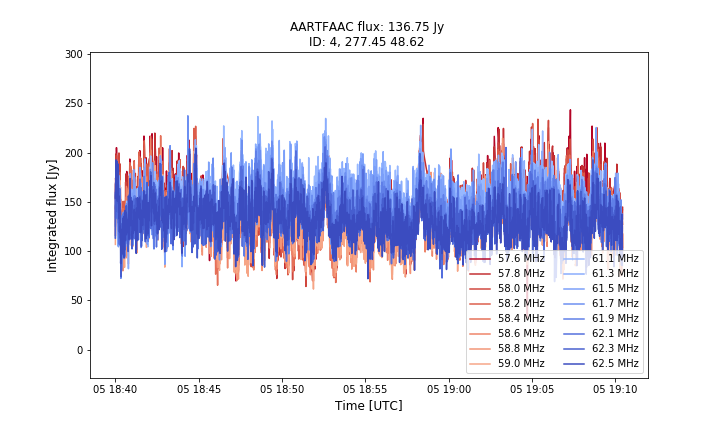

<IPython.core.display.Javascript object>


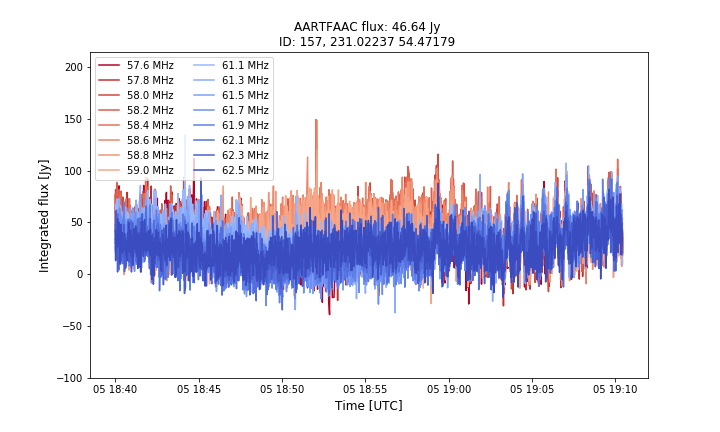

<IPython.core.display.Javascript object>


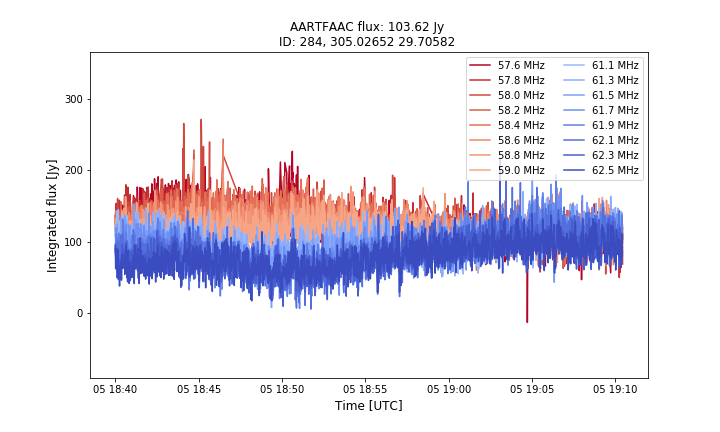

<IPython.core.display.Javascript object>


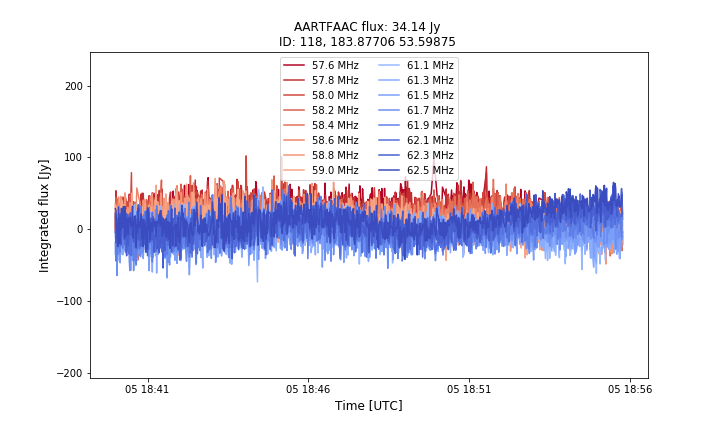

<IPython.core.display.Javascript object>


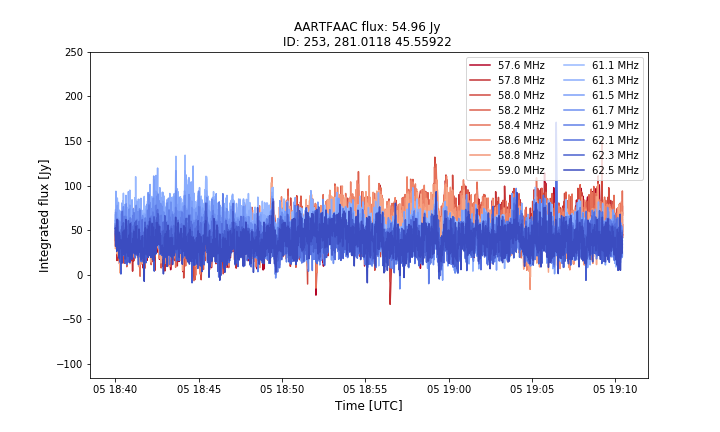

<IPython.core.display.Javascript object>


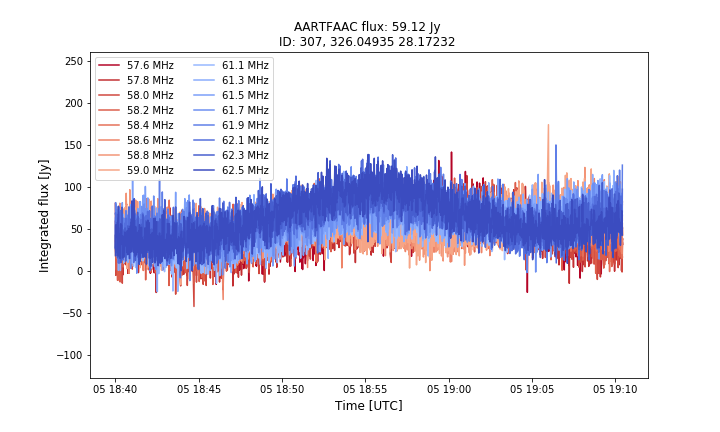

<IPython.core.display.Javascript object>


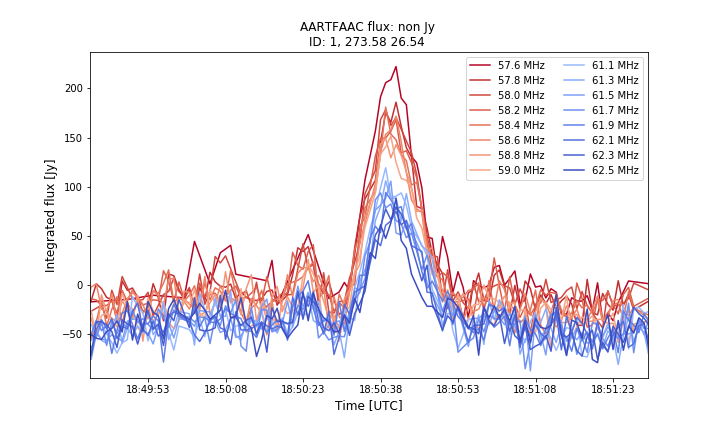

In [36]:
%matplotlib notebook



all_freq = np.unique(data.freq_eff)
scaled_all_freq = (all_freq - all_freq.min()) / all_freq.ptp()
colors = plt.cm.coolwarm(scaled_all_freq)


fig_n =0

for _ID in IDS: # np.unique(data.runcatid):

    source_df = retrieve_source(data, _ID)
    n_c = 0
    for freq in all_freq:


        plt.figure(fig_n,figsize=(10,6))

        plt.errorbar(source_df.taustart_ts[(source_df.freq_eff == freq)].values,
                     source_df.f_int[(source_df.freq_eff == freq) ].values,
                     yerr = source_df.f_int_err[(source_df.freq_eff == freq) ].values,
                     fmt="-", color=colors[::-1][n_c],ecolor="white", label="{} MHz".format(round(freq/1e6,1)))

        n_c+=1

    
    

    plt.title("AARTFAAC flux: {} Jy \nID: {}, {} {} ".format(aart_flux[fig_n],_ID,
                                                            round(np.nanmean(source_df.ra),2),
                                                            round(np.nanmean(source_df.decl),2) ))
    plt.ylabel("Integrated flux [Jy]")
    plt.legend(ncol=2)


    plt.xlabel("Time [UTC]")
    plt.show()
    fig_n +=1

In [27]:
IDS.append(1)

In [28]:
r_data.to_csv("/home/kuiack/tr_20160906.csv", index=True)

NameError: name 'r_data' is not defined

In [33]:
aart = pd.read_csv("/home/kuiack/AARTFAAC_catalogue.csv")

In [29]:
IDS

[45,
 2,
 159,
 152,
 187,
 126,
 268,
 80,
 79,
 196,
 129,
 3,
 317,
 112,
 168,
 174,
 304,
 203,
 110,
 309,
 144,
 5,
 294,
 55,
 80,
 207,
 9,
 139,
 148,
 250,
 135,
 115,
 122,
 127,
 300,
 134,
 130,
 4,
 157,
 284,
 118,
 253,
 307,
 [1, 2],
 [1, 2],
 [1, 2],
 1,
 1]

In [114]:

all_freq = np.unique(burst.freq_eff)
scaled_all_freq = (all_freq - all_freq.min()) / all_freq.ptp()
colors = plt.cm.coolwarm(scaled_all_freq)

<IPython.core.display.Javascript object>


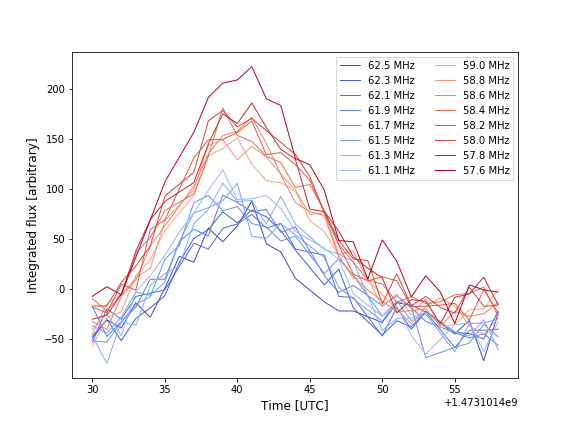

<IPython.core.display.Javascript object>


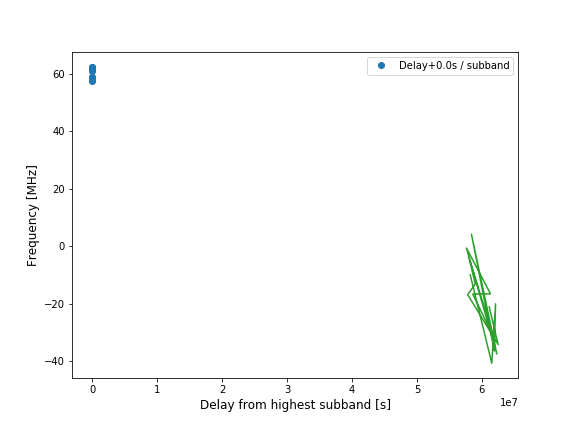

In [171]:
burst = data[(data.runcatid == 1) &
            (data.taustart_ts > datetime.datetime(year=2016,day=5, month=9, hour=18,minute=50,second=28)) & 
            (data.taustart_ts < datetime.datetime(year=2016,day=5, month=9, hour=18,minute=51,second=0))]

burst.set_index(burst.taustart_ts, inplace=True)
burst = burst.sort_index()
burst["timestep"] = [x.timestamp() for x in burst.taustart_ts]





all_freq = np.unique(data.freq_eff)
scaled_all_freq = (all_freq - all_freq.min()) / all_freq.ptp()
colors = plt.cm.coolwarm(scaled_all_freq)


start = []
end = [] 
for freq in all_freq[::-1]:
    start.append(np.min(burst.timestep[(burst.freq_eff == freq)].values))
    end.append(np.max(burst.timestep[(burst.freq_eff == freq)].values))
xnew = np.arange(np.max(start),np.min(end), step)



#     plt.subplot(211)
n_c = 0
fig_n = 0
step=0.01
delay3 = []

_source_flux = burst.f_int[(burst.freq_eff == all_freq[-1]) ].values


fa = interpolate.interp1d(burst.timestep[(burst.freq_eff == all_freq[-1])].values, 
                          _source_flux)
roll_n = 0
i = 0
roll = i*np.array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,18.,  19.,  20.,  21.,  22.,  23.,  24.,  25.], dtype=int)



fig_n =0
for freq in all_freq[::-1]:
    
    _source_flux = burst.f_int[(burst.freq_eff == freq) ].values


    
    fb = interpolate.interp1d(burst.timestep[(burst.freq_eff == freq)].values, 
                              _source_flux)    
#     print p1

#     popt,pcov = curve_fit(gaus,burst[(burst.freq_eff == freq)].timestep.values,_source_flux,
#                           p0=p1, sigma=burst.f_int_err[(burst.freq_eff == freq) ].values)
#     print popt

    plt.figure(333,figsize=(8,6))
#     plt.errorbar(np.roll(burst.taustart_ts[(burst.freq_eff == freq)].values,roll[roll_n]),
#                  _source_flux,
#                  yerr = burst.f_int_err[(burst.freq_eff == freq) ].values,
#                  fmt=".-", color=colors[n_c],ecolor="white", label="{} MHz".format(round(freq/1e6,1)))

    
    plt.errorbar(xnew,np.roll(fb(xnew),roll[roll_n]),lw=1,
                 color=colors[n_c], label="{} MHz".format(round(freq/1e6,1)))
   
    
#     plt.plot(burst.taustart_ts[(burst.freq_eff == freq)].values,
#              gaus(burst[(burst.freq_eff == freq)].timestep.values,*popt),'.-',color=colors[n_c],label='fit')
    
    
#     plt.figure(fig_n, figsize=(12,10))
#     plt.plot(burst.taustart_ts[(burst.freq_eff == freq)].values,
#              gaus(burst[(burst.freq_eff == freq)].timestep.values,*popt),'.-',color=colors[n_c],label='fit')




#     xnew = np.arange(np.min(burst.timestep[(burst.freq_eff == all_freq[-1])].values),
#                             np.max(burst.timestep[(burst.freq_eff == all_freq[-1])].values), step)


#         A = fftpack.fft(fa(xnew))
#         B = fftpack.fft(np.roll(fb(xnew),roll[roll_n]))
#         Ar = -A.conjugate()
#         Br = -B.conjugate()
#         plt.figure()
#         plt.subplot(121)
#         plt.plot(np.abs(fftpack.ifft(Ar*B)))

#         delay2.append(match(fa(xnew),np.roll(fb(xnew),roll[roll_n])))
#         plt.plot(signal.correlate(fa(xnew),np.roll(fb(xnew),roll[roll_n]), mode="same"))

    delay3.append(np.argmax(signal.correlate(fa(xnew),fa(xnew), mode="same")) - np.argmax(signal.correlate(fa(xnew),np.roll(fb(xnew),roll[roll_n]), mode="same"))  )
    # plt.plot(np.abs(fftpack.ifft(A*Br)))
#         plt.subplot(122)
#         plt.plot(fa(xnew))
#         plt.plot(np.roll(fb(xnew),roll_n))
    roll_n += 1


    n_c+=1


plt.ylabel("Integrated flux [arbitrary]")
plt.legend(ncol=2)

#     plt.subplot(212)

#     n_c = 0
#     for freq in all_freq:

#         _source_flux = source_df.f_int[(source_df.freq_eff == freq) ].values
#         _index = source_df.extract_type[(source_df.freq_eff == freq) ].values
#         _source_flux[(_index == 1)] = np.nan





#         plt.errorbar(source_df.taustart_ts[(source_df.freq_eff == freq)].values,
#                  _source_flux, 
#                  yerr = source_df.f_int_err[(source_df.freq_eff == freq) ].values,
#                  fmt="o-", color=colors[n_c],ecolor="white", label="{} MHz".format(round(freq/1e6,1)))
#         n_c+=1

#     #     del _source_flux

#     #     if len(source_df.f_int_err[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values) > 0:
#     #         plt.errorbar(source_df.taustart_ts[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values,
#     #                      source_df.f_int[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values, 
#     #                      yerr = source_df.f_int_err[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values,
#     #                      fmt=".", color="C3",ecolor="C1", label="57.8 MHz, ff")


#     plt.legend(ncol=2)


#     plt.ylabel("Integrated flux [arbitrary]")
plt.xlabel("Time [UTC]")



plt.figure(figsize=(8,6))
plt.plot(np.array(delay3)*step,all_freq[::-1]/1e6,"o", label="Delay+{}s / subband".format(step*i))
plt.ylabel("Frequency [MHz]")
plt.xlabel("Delay from highest subband [s]")
plt.legend()



In [187]:
def index(v,k,alph):
    return k*(v)**alph

<IPython.core.display.Javascript object>


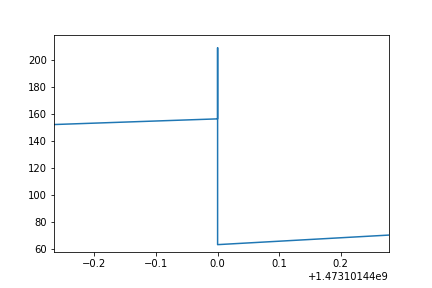

In [194]:
plt.figure()
plt.plot(burst.timestep, burst.f_int)

In [208]:
print np.unique(burst.timestep)[20]

1473101449.0


In [188]:
indexes = []
consts = [] 

for time in np.unique(burst.timestep):
    try:
        index, const = curve_fit(index,burst[burst.timestep == time].freq_eff, burst[burst.timestep == time].f_int)
        indexes.append(index)
        consts.append(const)
    except RuntimeError:
        indexes.append(np.nan)
        consts.append(np.nan)

In [210]:
curve_fit(index,burst[burst.timestep == 1473101449.0].freq_eff, burst[burst.timestep == 1473101449.0].f_int)

RuntimeError: Optimal parameters not found: Number of calls to function has reached maxfev = 600.

<IPython.core.display.Javascript object>


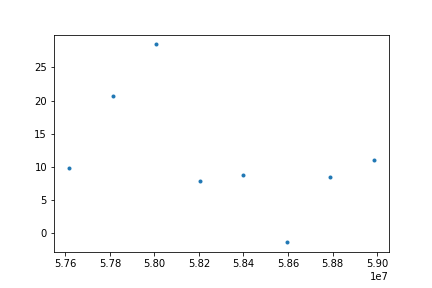

In [209]:
plt.figure()
plt.plot(burst[burst.timestep == 1473101449.0].freq_eff, burst[burst.timestep == 1473101449.0].f_int,".")
# plt.plot(burst[burst.timestep == 147310143e+09].freq_eff, index(burst[burst.timestep == 1.47310143e+09].freq_eff,1,-1))

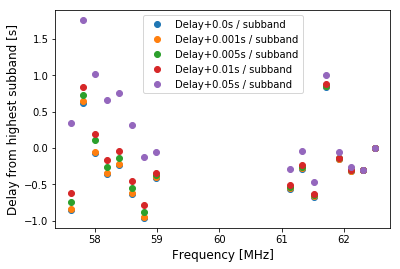

In [49]:
from scipy import interpolate, signal


delay2 = [0]


fa = interpolate.interp1d(burst.timestep[(burst.freq_eff == all_freq[-1])].values, 
                          burst.f_int[(burst.freq_eff == all_freq[-1]) ].values)


step = 0.001
for i in [0,1,5,10,50]:
    roll_n = 0
    roll = i*np.array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,18.,  19.,  20.,  21.,  22.,  23.,  24.,  25.], dtype=int)


    delay3 = [0]

    for freq in all_freq[::-1][1:]:
    #     fa = interpolate.interp1d(burst.timestep[(burst.freq_eff == all_freq[-1])].values, 
    #                               burst.f_int[(burst.freq_eff == all_freq[-1]) ].values)

        fb = interpolate.interp1d(burst.timestep[(burst.freq_eff == freq)].values, 
                                  burst.f_int[(burst.freq_eff == freq) ].values)


        xnew = np.arange(np.min(burst.timestep[(burst.freq_eff == all_freq[-1])].values),
                                np.max(burst.timestep[(burst.freq_eff == all_freq[-1])].values), step)


#         A = fftpack.fft(fa(xnew))
#         B = fftpack.fft(np.roll(fb(xnew),roll[roll_n]))
#         Ar = -A.conjugate()
#         Br = -B.conjugate()
#         plt.figure()
#         plt.subplot(121)
#         plt.plot(np.abs(fftpack.ifft(Ar*B)))

#         delay2.append(match(fa(xnew),np.roll(fb(xnew),roll[roll_n])))
#         plt.plot(signal.correlate(fa(xnew),np.roll(fb(xnew),roll[roll_n]), mode="same"))

        delay3.append(np.argmax(signal.correlate(fa(xnew),fa(xnew), mode="same")) - np.argmax(signal.correlate(fa(xnew),np.roll(fb(xnew),roll[roll_n]), mode="same"))  )
        # plt.plot(np.abs(fftpack.ifft(A*Br)))
#         plt.subplot(122)
#         plt.plot(fa(xnew))
#         plt.plot(np.roll(fb(xnew),roll_n))
        roll_n += 1

    plt.figure(1)
    plt.plot(all_freq[::-1]/1e6,np.array(delay3)*step,"o", label="Delay+{}s / subband".format(0.001*i))
    plt.xlabel("Frequency [MHz]")
    plt.ylabel("Delay from highest subband [s]")
    plt.legend()

AttributeError: 'DataFrame' object has no attribute 'timestep'

<Figure size 864x864 with 0 Axes>

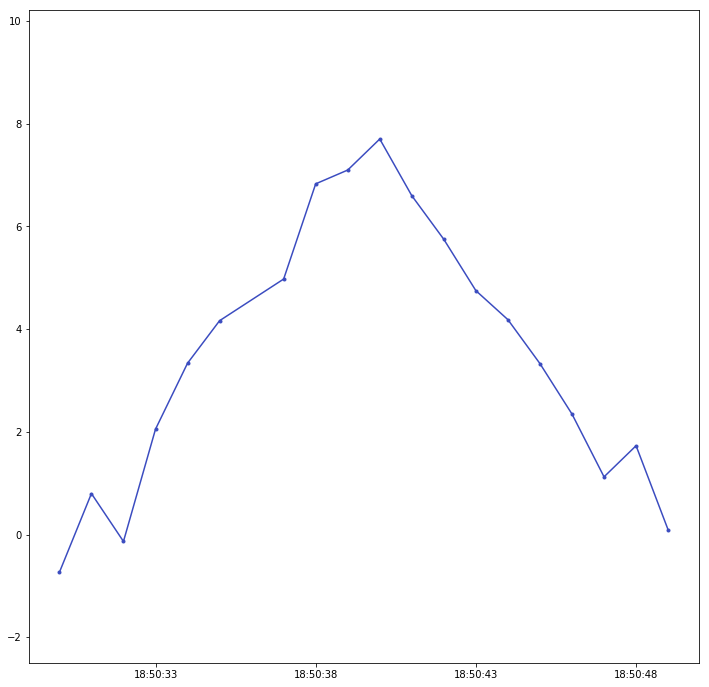

In [166]:
import pylab as plb
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy import asarray as ar,exp

def gaus(x,a,x0,sigma,c):
    return a*exp(-(x-x0)**2/(2*sigma**2))+c


plt.figure(plot_fig,figsize=(12,12))
#     plt.subplot(211)
n_c = 0
for freq in all_freq:

    _source_flux = burst.f_int[(burst.freq_eff == freq) ].values
    _index = burst.extract_type[(burst.freq_eff == freq) ].values
    _source_flux[(_index == 1)] = np.nan




    plt.figure(1,figsize=(12,12))
    plt.errorbar(burst.taustart_ts[(burst.freq_eff == freq)].values,
             _source_flux, 
             yerr = burst.f_int_err[(burst.freq_eff == freq) ].values,
             fmt=".-", color=colors[n_c],ecolor="white", label="{} MHz".format(round(freq/1e6,1)))
    
    
    
    
    
    p1 = [3,burst[(burst.freq_eff == freq)].timestep.values[np.where(_source_flux == np.max(_source_flux))[0]],4,0]
    print p1

    popt,pcov = curve_fit(gaus,burst[(burst.freq_eff == freq)].timestep.values,_source_flux,p0=p1)
    print popt
    
    plt.figure(2,figsize=(12,12))
    plt.plot(burst.taustart_ts[(burst.freq_eff == freq)].values,
         gaus(burst[(burst.freq_eff == freq)].timestep.values,*popt),'.-',color=colors[n_c],label='fit')

    
    n_c+=1


plt.ylabel("Integrated flux [arbitrary]")
plt.legend(ncol=2)


plt.xlabel("Time [UTC]")




plt.title("Obs: AS"+dbname+"\nID: "+str(_ID)+", RA "+str(round(burst.ra.mean(),2))+", Dec "+str(round(burst.decl.mean(),2)))



plt.show()

[10.0, 1473101441.0, 3.0, 0.0]
[  5.41125318e+00   1.47310144e+09   3.38452653e+00   7.15785600e-01]
[10.0, 1473101442.0, 3.0, 0.0]
[  4.86723103e+00   1.47310144e+09   3.50827027e+00  -4.32376482e-01]
[10.0, 1473101439.0, 3.0, 0.0]
[  5.43674910e+00   1.47310144e+09   3.59244473e+00  -4.90455812e-01]
[10.0, 1473101442.0, 3.0, 0.0]
[  4.52612377e+00   1.47310144e+09   3.62232172e+00  -5.23219239e-01]
[10.0, 1473101440.0, 3.0, 0.0]
[  4.90941397e+00   1.47310144e+09   3.50420560e+00  -5.31695369e-01]
[10.0, 1473101442.0, 3.0, 0.0]
[  4.35317392e+00   1.47310144e+09   3.50125148e+00  -7.63636509e-01]
[10.0, 1473101440.0, 3.0, 0.0]
[  5.08202711e+00   1.47310144e+09   3.58640470e+00  -7.60617882e-01]
[10.0, 1473101441.0, 3.0, 0.0]
[  5.02086550e+00   1.47310144e+09   3.67137324e+00  -8.78569198e-01]
[10.0, 1473101440.0, 3.0, 0.0]
[  3.90889363e+00   1.47310144e+09   3.66410123e+00  -7.42569875e-01]
[10.0, 1473101440.0, 3.0, 0.0]
[  4.28732171e+00   1.47310144e+09   3.49219698e+00  -7.7307

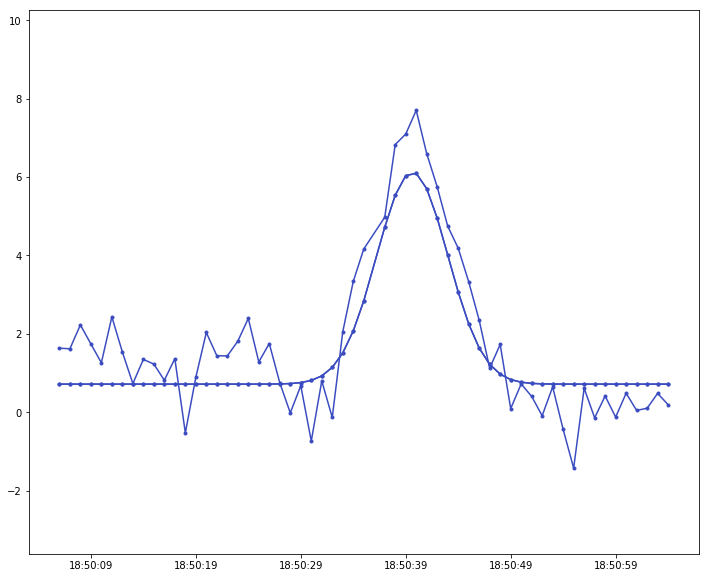

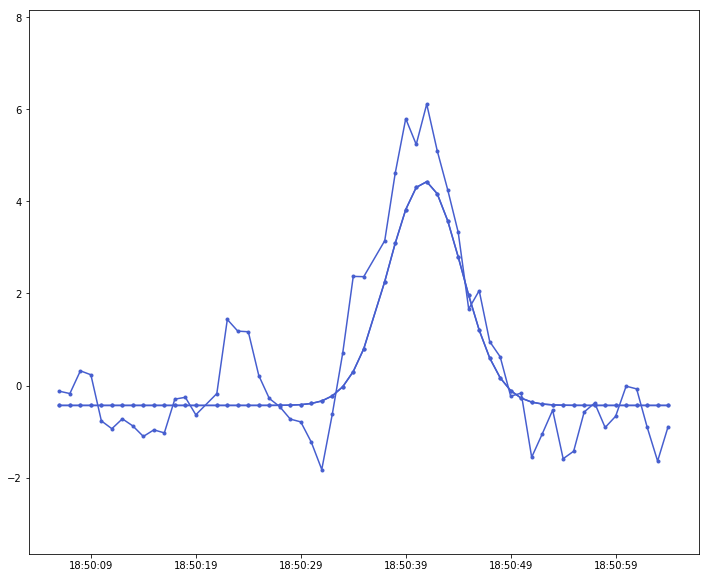

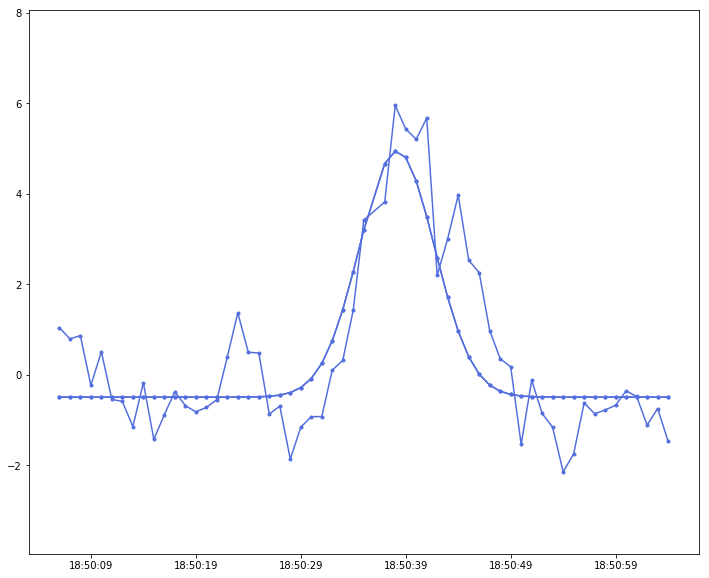

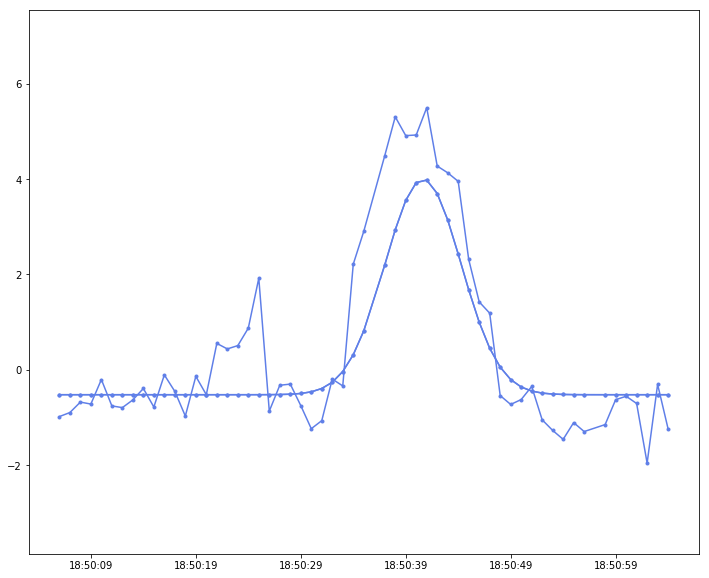

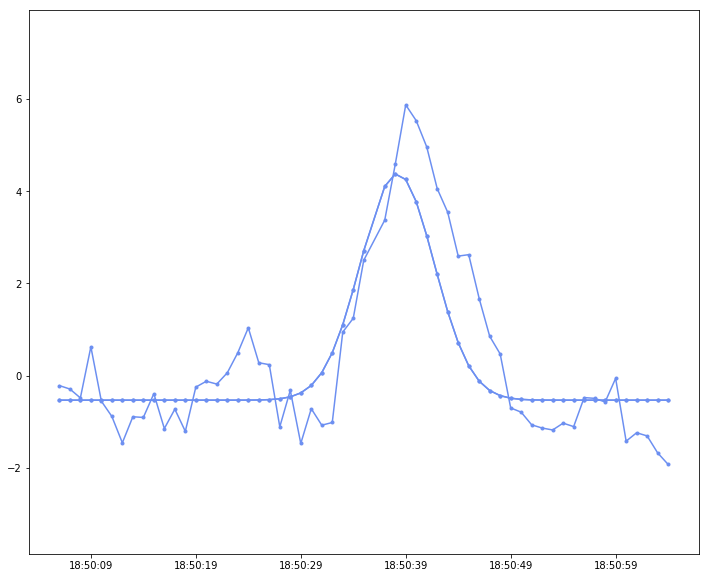

...

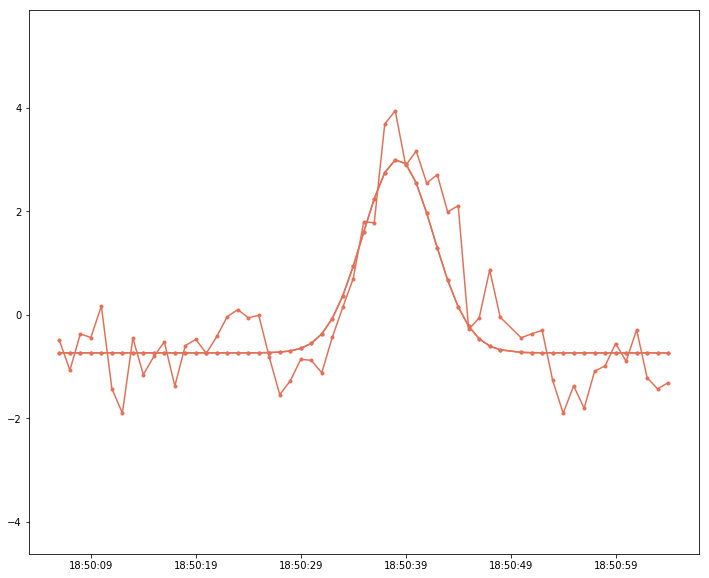

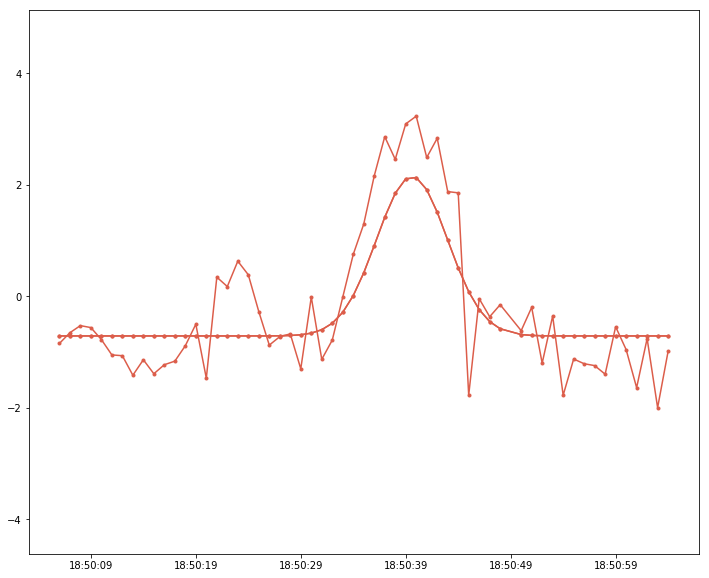

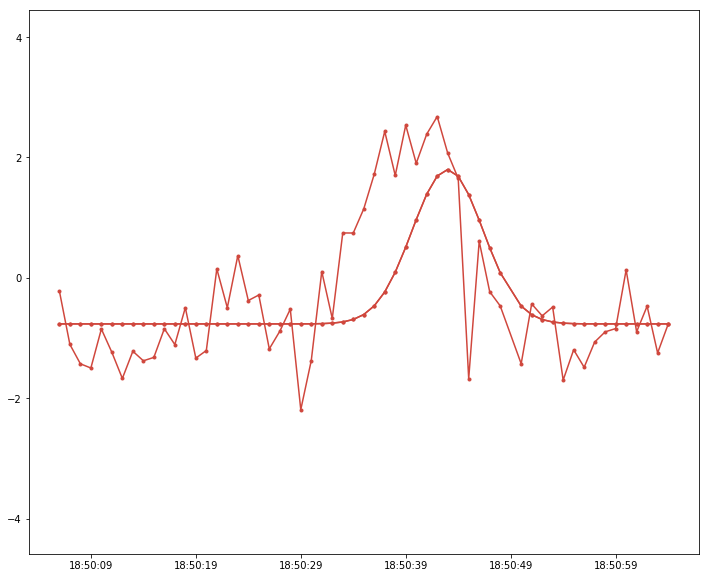

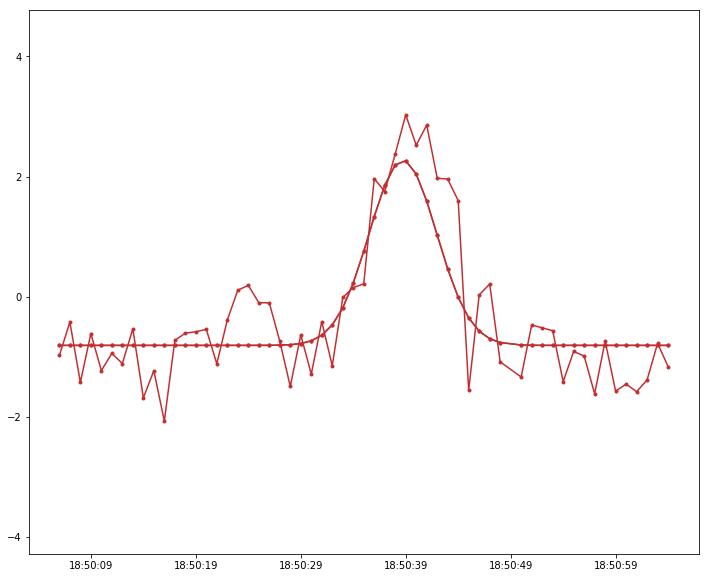

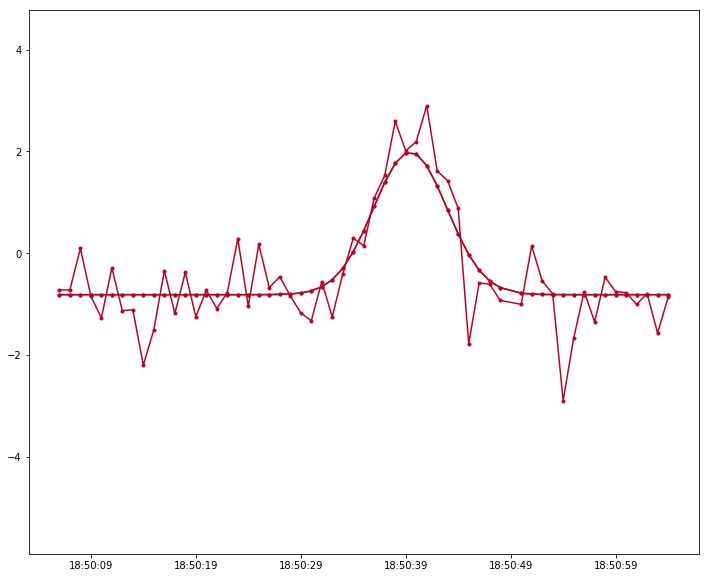

In [132]:


%matplotlib inline 

def gaus(x,a,x0,sigma,c):
    return a*exp(-(x-x0)**2/(2*sigma**2))+c

burst["timestep"] = [x.timestamp() for x in burst.taustart_ts]

fig_n = 0 
n_c = 0
for freq in all_freq:
    
    _source_flux = burst.f_int[(burst.freq_eff == freq) ].values
#     _index = burst.extract_type[(burst.freq_eff == freq) ].values
#     _source_flux[(_index == 1)] = np.nan

    p1 = [10.0,
          1.0+float(burst[(burst.freq_eff == freq)].timestep.values[np.where(_source_flux == np.max(_source_flux))[0]]),
          3.0,
          0.0]
    
    
    print p1

    popt,pcov = curve_fit(gaus,burst[(burst.freq_eff == freq)].timestep.values,_source_flux,
                          p0=p1, sigma=burst.f_int_err[(burst.freq_eff == freq) ].values)
    print popt

    plt.figure(fig_n, figsize=(12,10))
    plt.errorbar(burst.taustart_ts[(burst.freq_eff == freq)].values,
                 _source_flux, 
                 yerr = burst.f_int_err[(burst.freq_eff == freq) ].values,
                 fmt=".-", color=colors[n_c],ecolor="white", label="{} MHz".format(round(freq/1e6,1)))

    plt.plot(burst.taustart_ts[(burst.freq_eff == freq)].values,
             gaus(burst[(burst.freq_eff == freq)].timestep.values,*popt),'.-',color=colors[n_c],label='fit')
    
    
    plt.figure(fig_n, figsize=(12,10))
    plt.plot(burst.taustart_ts[(burst.freq_eff == freq)].values,
             gaus(burst[(burst.freq_eff == freq)].timestep.values,*popt),'.-',color=colors[n_c],label='fit')
    
    fig_n+=1
    n_c+=1

[10, array([  1.47310144e+09]), 5, 1]
[  1.00000000e+01   1.47310144e+09   5.00000000e+00   1.00000000e+00]


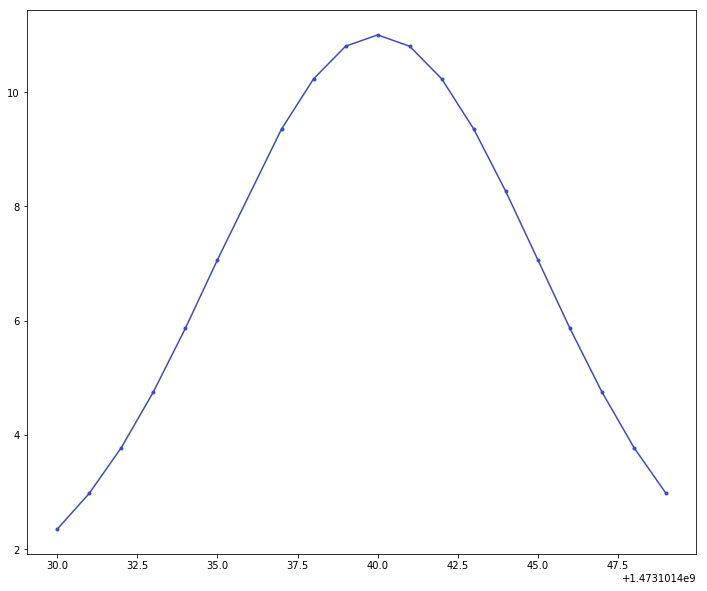

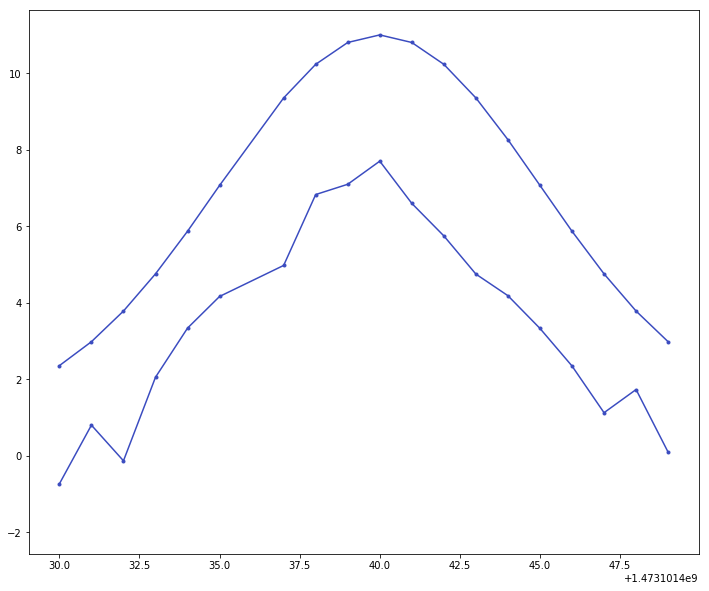

In [168]:
n_c=0
freq = all_freq[0]

_source_flux = burst.f_int[(burst.freq_eff == freq) ].values
_index = burst.extract_type[(burst.freq_eff == freq) ].values
_source_flux[(_index == 1)] = np.nan

p1 = [10,burst[(burst.freq_eff == freq)].timestep.values[np.where(_source_flux == np.max(_source_flux))[0]],5,1]
print p1

popt,pcov = curve_fit(gaus,burst[(burst.freq_eff == freq)].timestep.values,_source_flux,p0=p1)
print popt

plt.figure(99999, figsize=(12,10))
plt.errorbar(burst.timestep[(burst.freq_eff == freq)].values,
             _source_flux, 
             yerr = burst.f_int_err[(burst.freq_eff == freq) ].values,
             fmt=".-", color=colors[n_c],ecolor="white", label="{} MHz".format(round(freq/1e6,1)))

plt.plot(burst.timestep[(burst.freq_eff == freq)].values,
         gaus(burst[(burst.freq_eff == freq)].timestep.values,*popt),'.-',color=colors[n_c],label='fit')


plt.figure(99998, figsize=(12,10))
plt.plot(burst.timestep[(burst.freq_eff == freq)].values,
         gaus(burst[(burst.freq_eff == freq)].timestep.values,*popt),'.-',color=colors[n_c],label='fit')
    

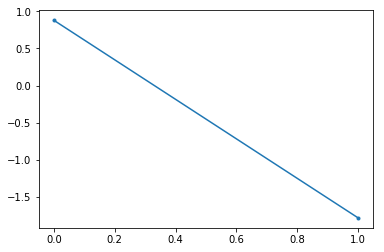

In [173]:
_source_flux = burst.f_int[(burst.freq_eff == all_freq[-1]) ].values
plt.plot(_source_flux[38:40],".-")

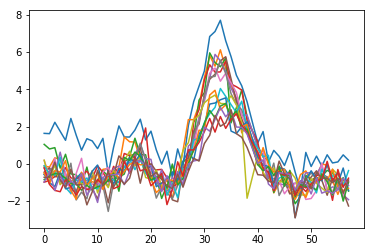

In [225]:
for i in all_freq:
    _source_flux = burst.f_int[(burst.freq_eff == i) ].values
    _source_flux[39] = np.mean([_source_flux[38],_source_flux[40]])
    plt.plot(_source_flux )

In [227]:
i=0

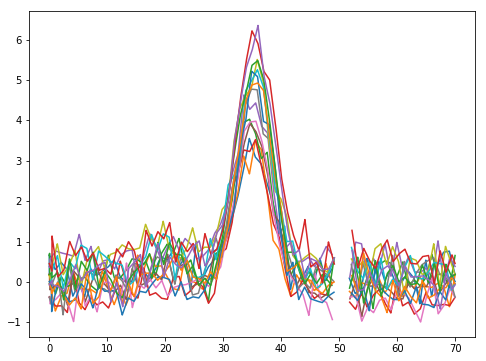

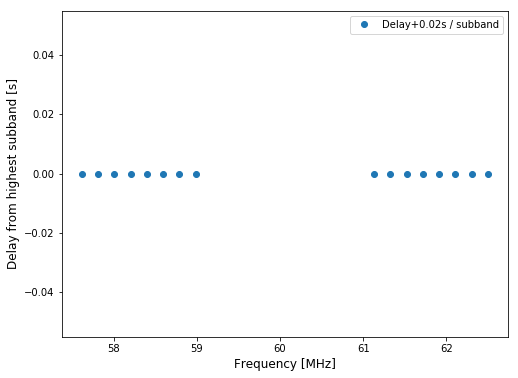

In [183]:
xaxis = np.linspace(0,70,70)
y_vals = [] 




for a in np.linspace(3,6,16):
#     ydata = gaus(xaxis,a,35,3,0.2*np.random.randn(1))
    ydata = gaus(xaxis,a,35,3,0.2*np.random.randn(1))
    ydata += gaus(xaxis,0.5,20,3,0.2*np.random.randn(1))
    yn = ydata + 0.3*np.random.normal(size=len(xaxis))
    yn[49:51] *= np.nan
    y_vals.append(yn)

fa = interpolate.interp1d(xaxis,y_vals[0])

step = 0.001
i = 20
roll_n = 1
roll = i*np.array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,18.,  19.,  20.,  21.,  22.,  23.,  24.,  25.], dtype=int)

# plt.plot(xaxis,yn)
sim_delay = [0]

for y_dat in y_vals[1:]:

    fb = interpolate.interp1d(xaxis,y_dat)


    xnew = np.arange(np.min(xaxis),np.max(xaxis), step)
    plt.figure(3,figsize=(8,6))
    plt.plot(xnew,np.roll(fb(xnew),roll[roll_n]))

    sim_delay.append(np.argmax(signal.correlate(fa(xnew),fa(xnew), mode="same")) - np.argmax(signal.correlate(fa(xnew),np.roll(fb(xnew),roll[roll_n]), mode="same"))  )

    roll_n += 1


plt.figure(4,figsize=(8,6))
plt.plot(all_freq[::-1]/1e6,np.array(sim_delay)*step,"o", label="Delay+{}s / subband".format(step*i))
plt.xlabel("Frequency [MHz]")
plt.ylabel("Delay from highest subband [s]")
plt.legend()


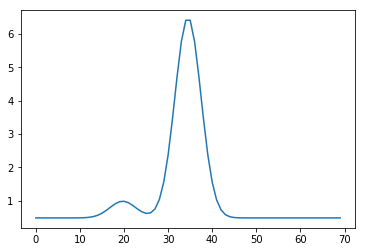

In [157]:
ydata = gaus(xaxis,a,35,3,0.2*np.random.randn(1))
ydata += gaus(xaxis,0.5,20,3,0.2*np.random.randn(1))
plt.plot(ydata)

In [55]:
2*np.array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,18.,  19.,  20.,  21.,  22.,  23.,  24.,  25.], dtype=int)

array([ 0,  2,  4,  6,  8, 10, 12, 14, 36, 38, 40, 42, 44, 46, 48, 50])

In [367]:
(np.linspace(0,7,8),np.linspace(18,25,8))

(array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.]),
 array([ 18.,  19.,  20.,  21.,  22.,  23.,  24.,  25.]))

<IPython.core.display.Javascript object>


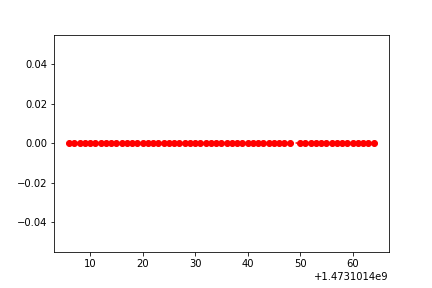

In [107]:
plt.figure()

plt.plot(burst[(burst.freq_eff == freq)].timestep.values,
         gaus(burst[(burst.freq_eff == freq)].timestep.values,*popt),'ro:',label='fit')
plt.show()

<IPython.core.display.Javascript object>


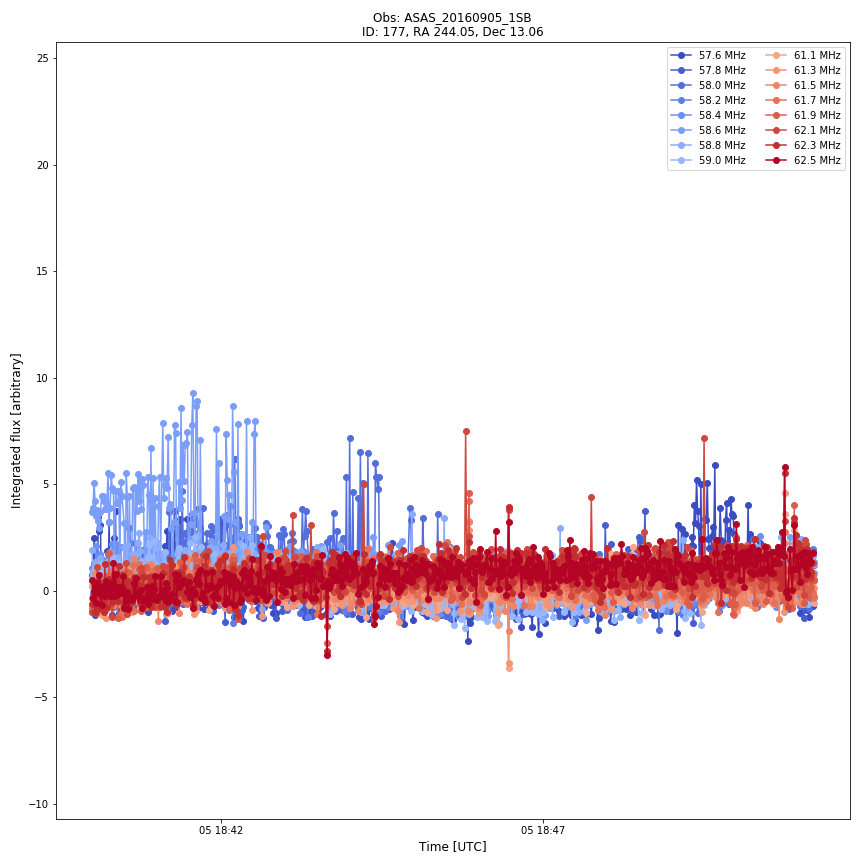

<IPython.core.display.Javascript object>


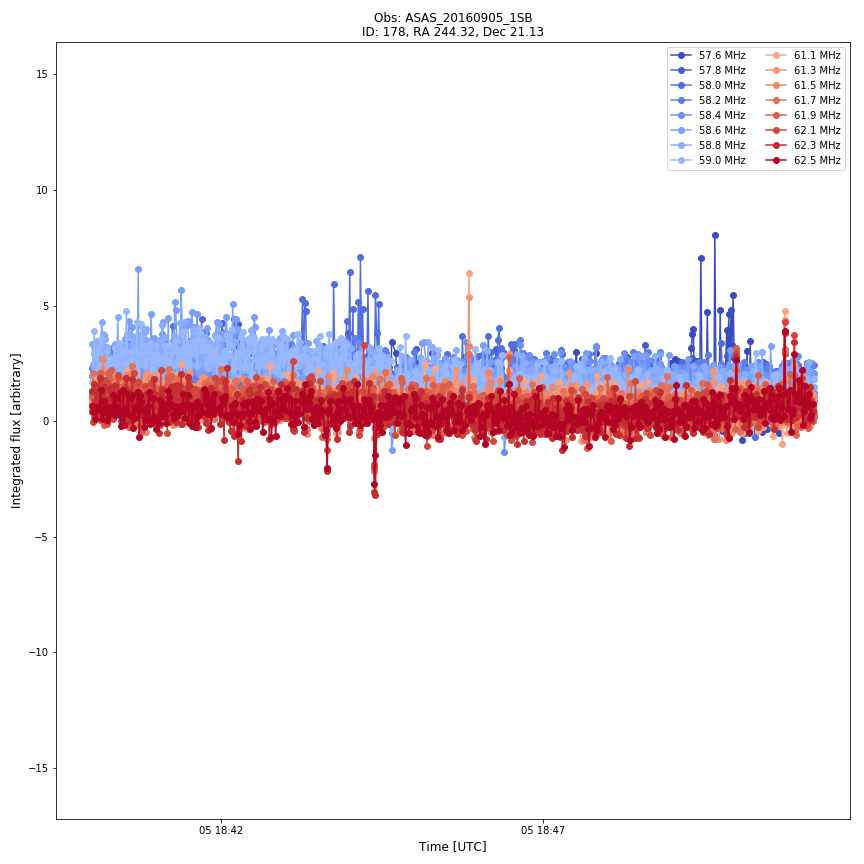

<IPython.core.display.Javascript object>


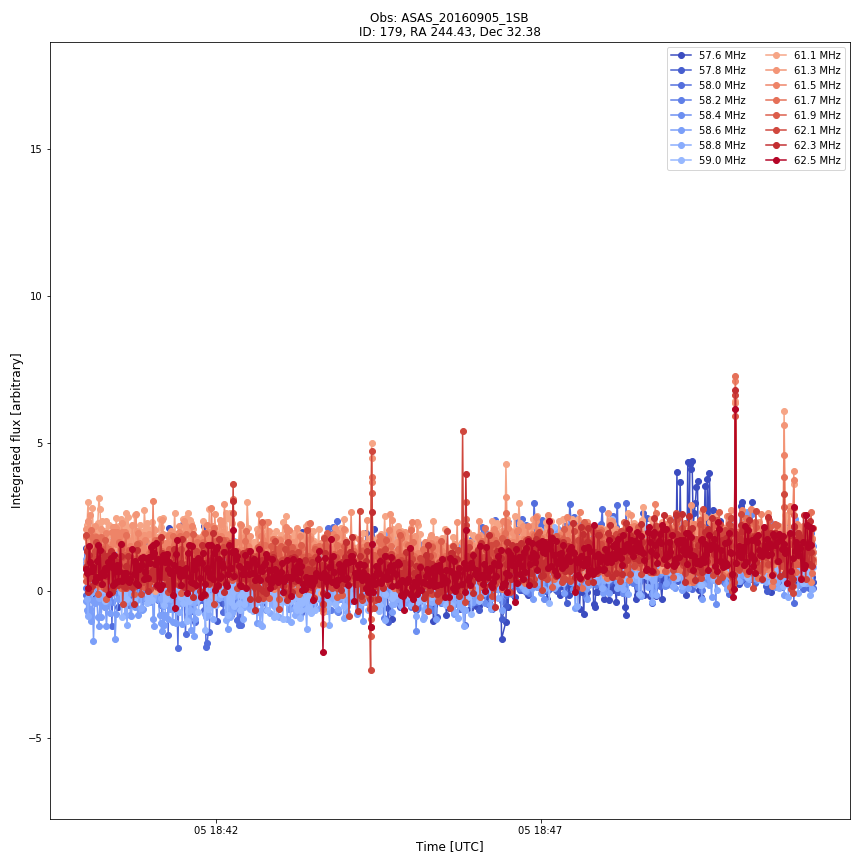

<IPython.core.display.Javascript object>


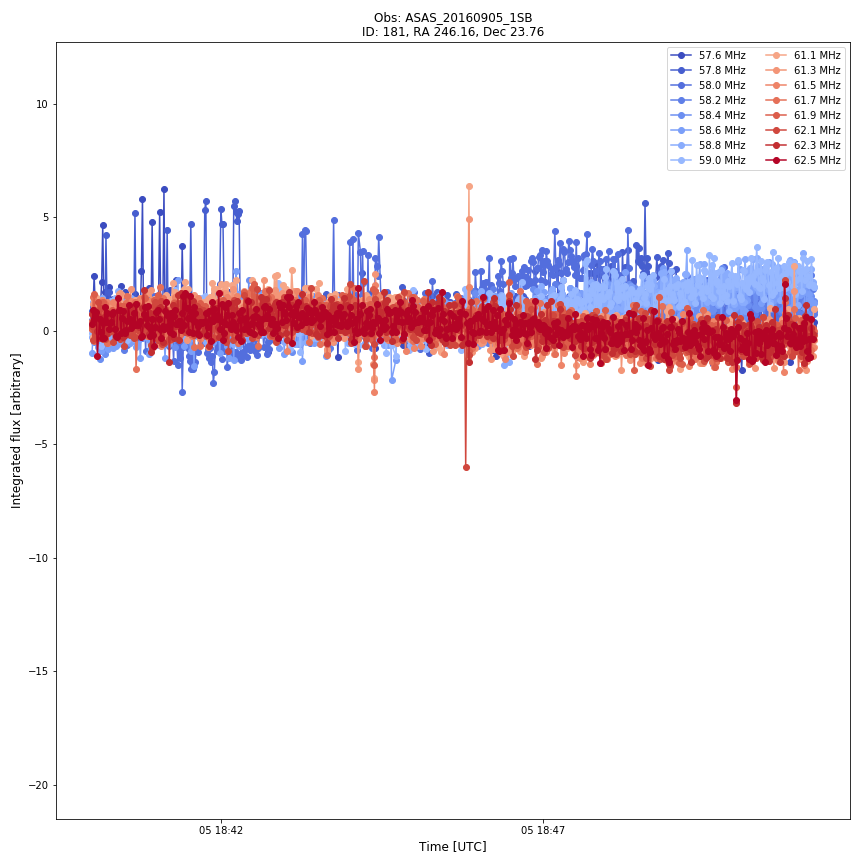

<IPython.core.display.Javascript object>


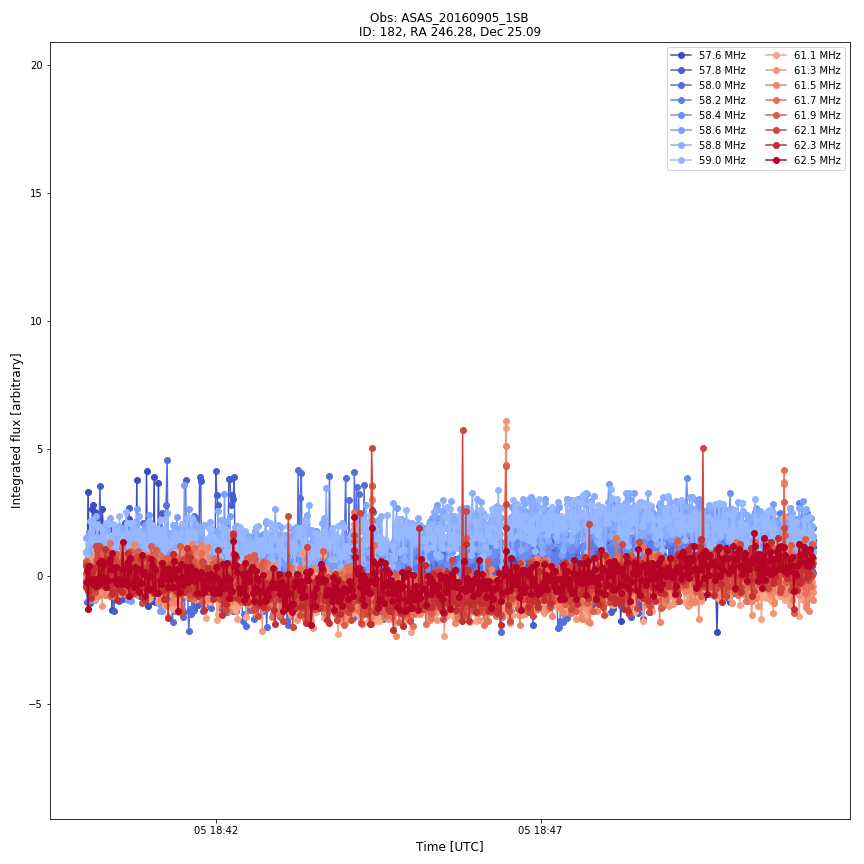

<IPython.core.display.Javascript object>


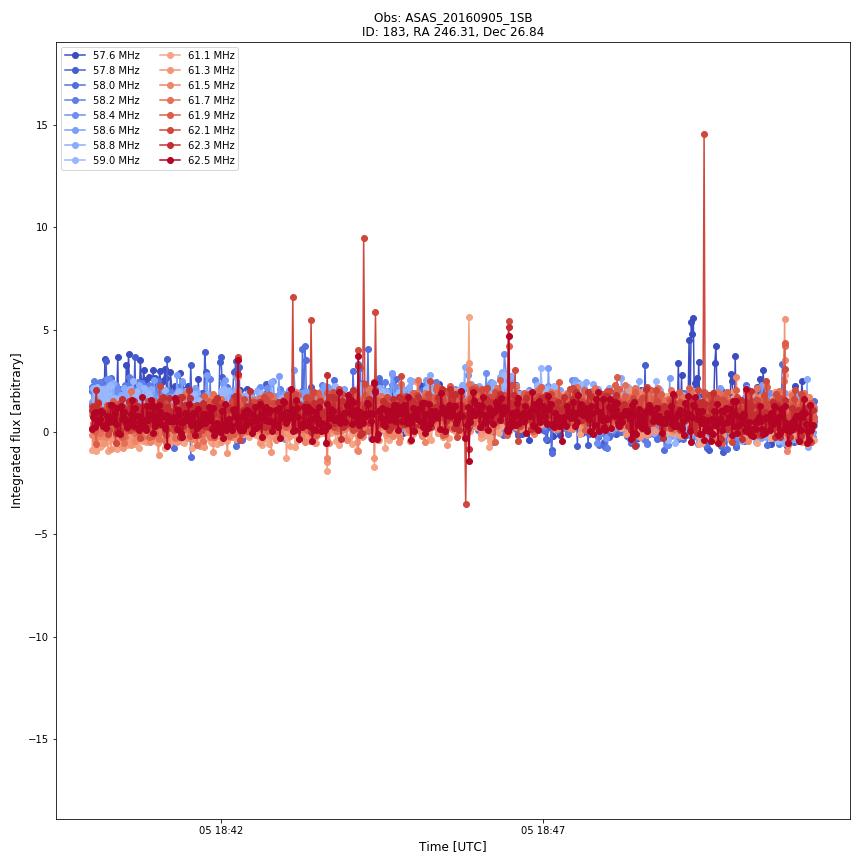

<IPython.core.display.Javascript object>


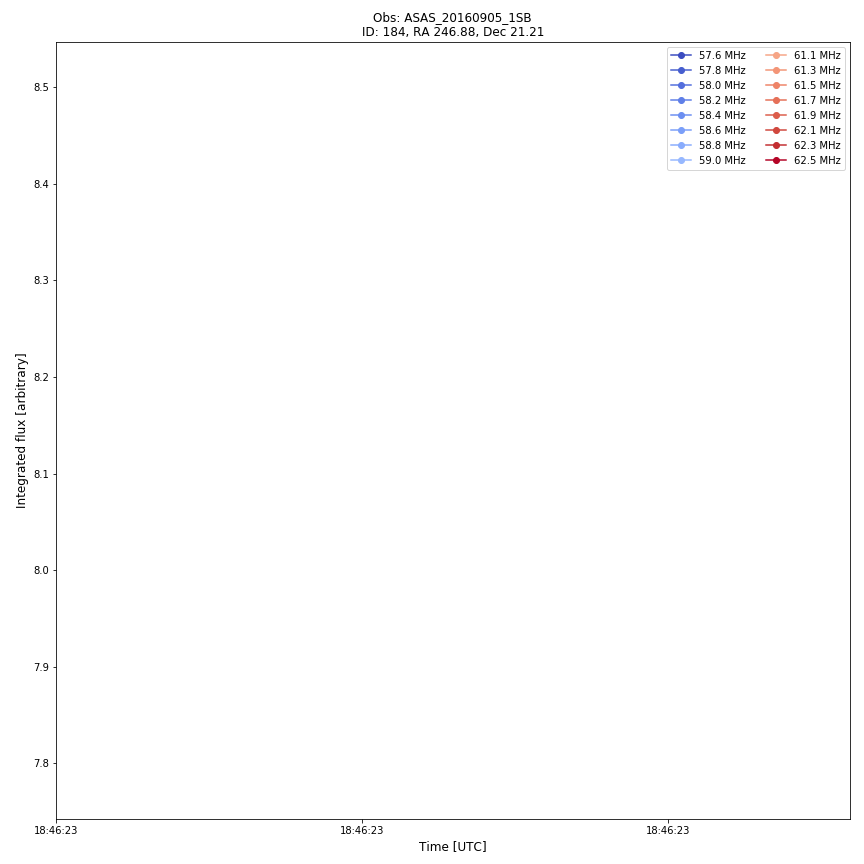

<IPython.core.display.Javascript object>


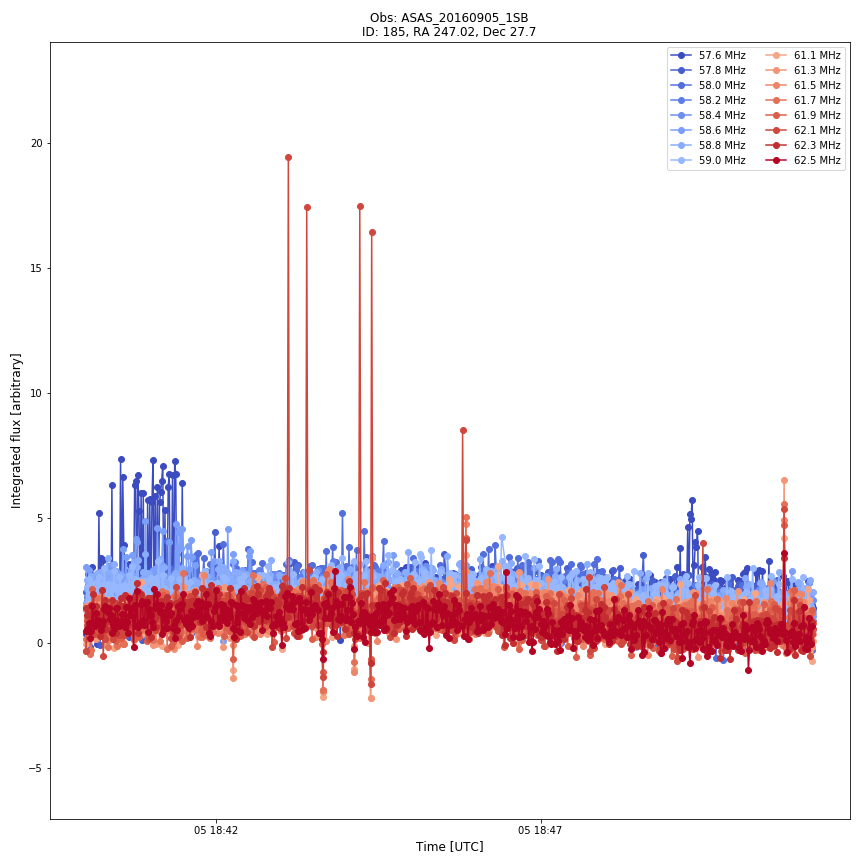

<IPython.core.display.Javascript object>


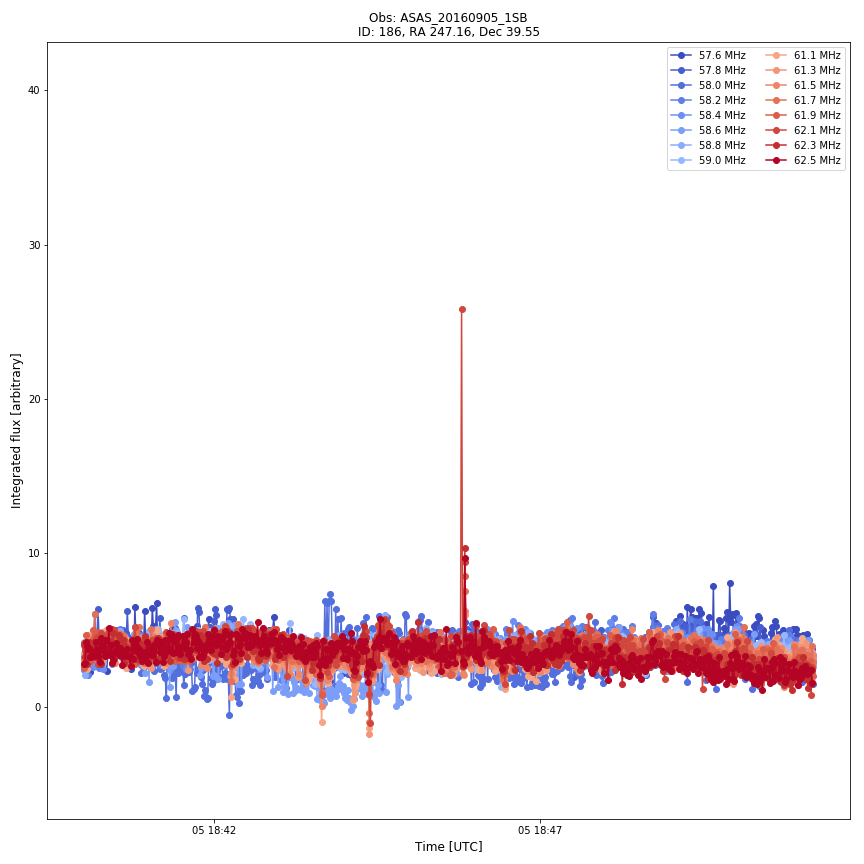

<IPython.core.display.Javascript object>


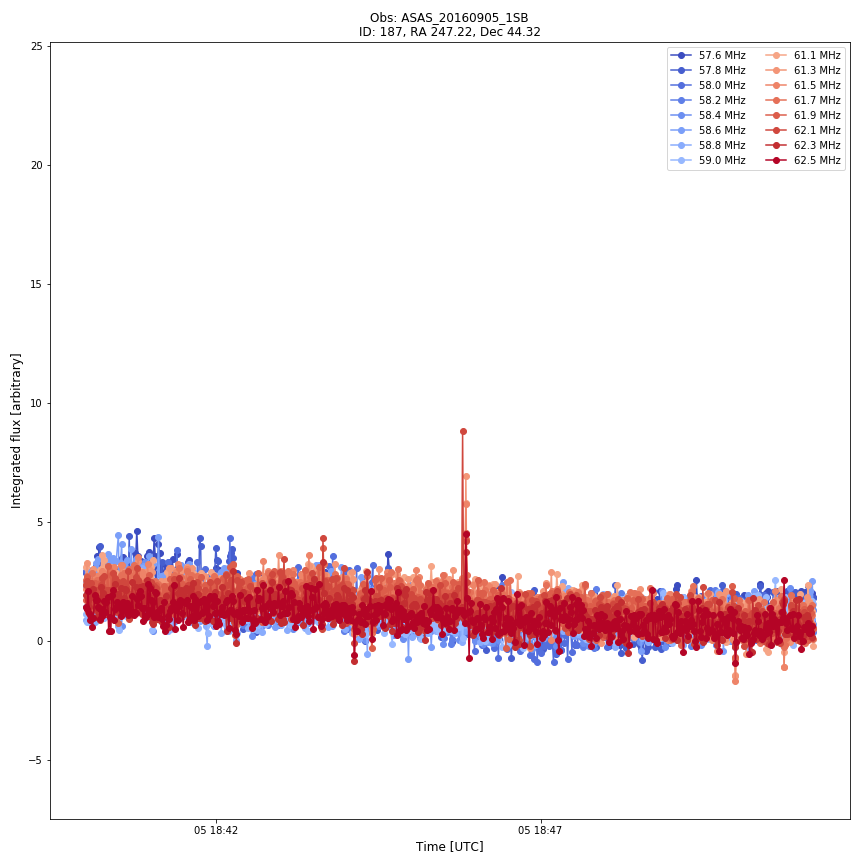

<IPython.core.display.Javascript object>


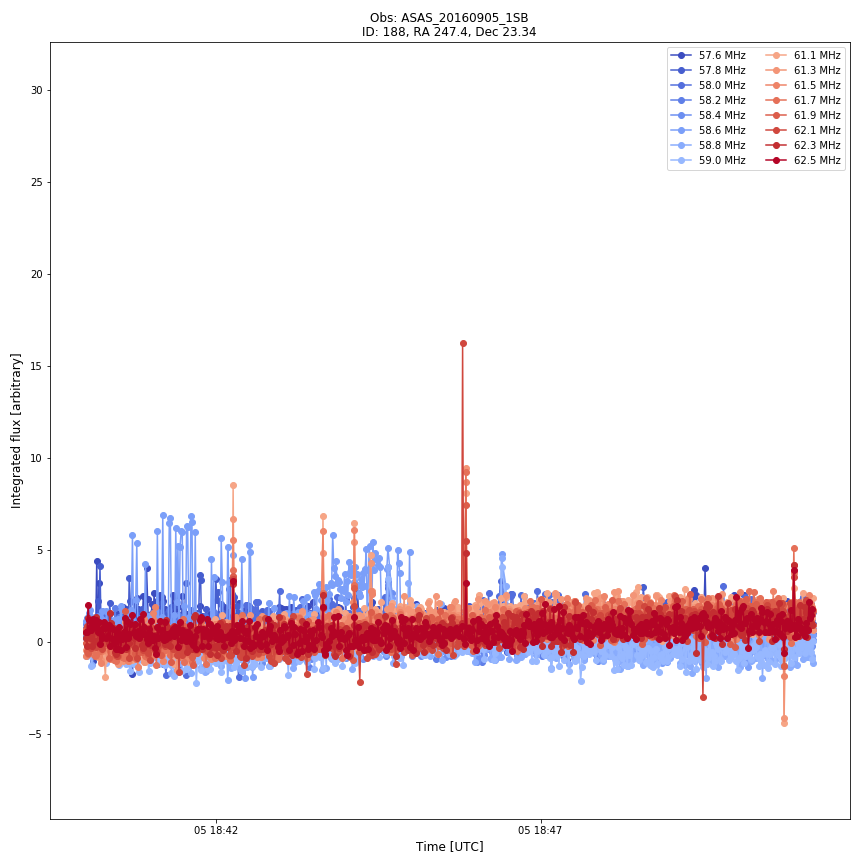

<IPython.core.display.Javascript object>


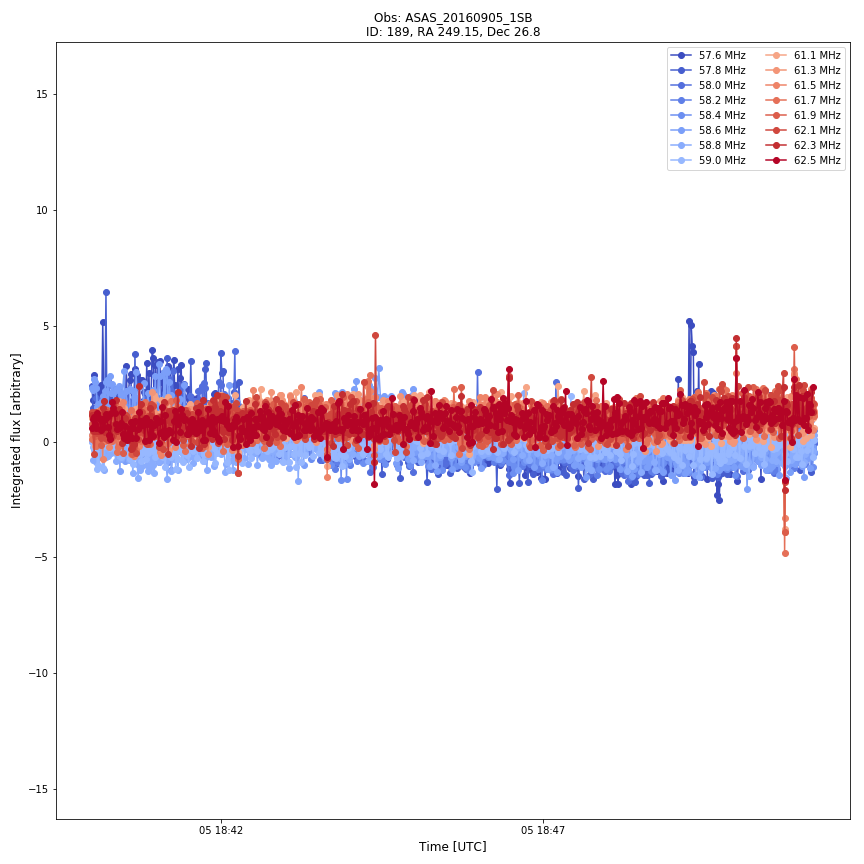

<IPython.core.display.Javascript object>


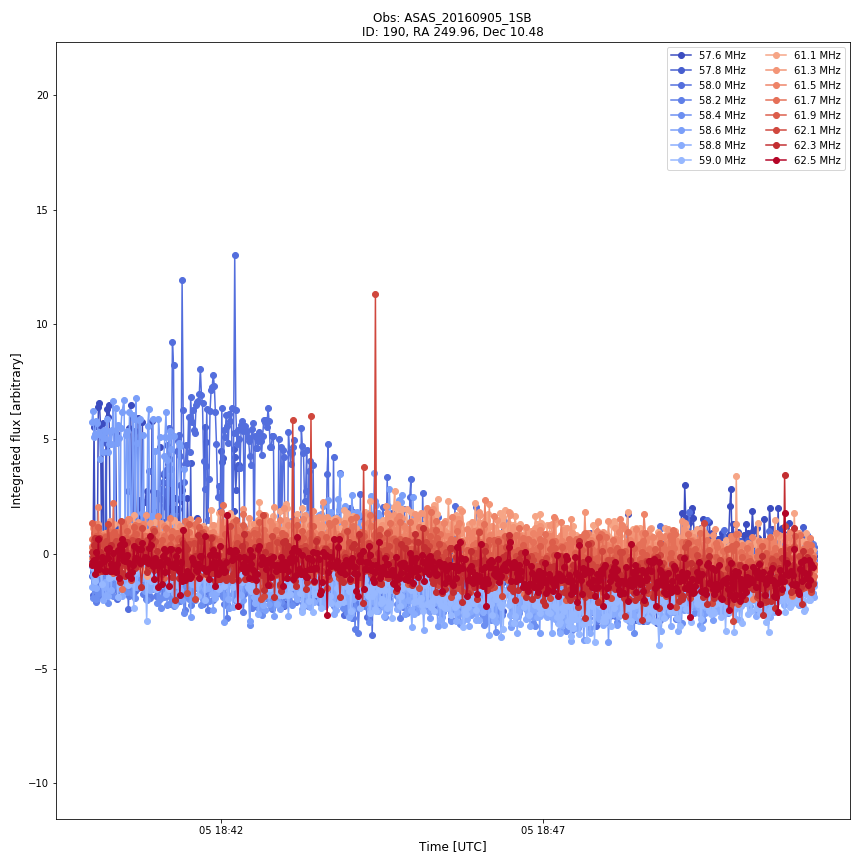

<IPython.core.display.Javascript object>


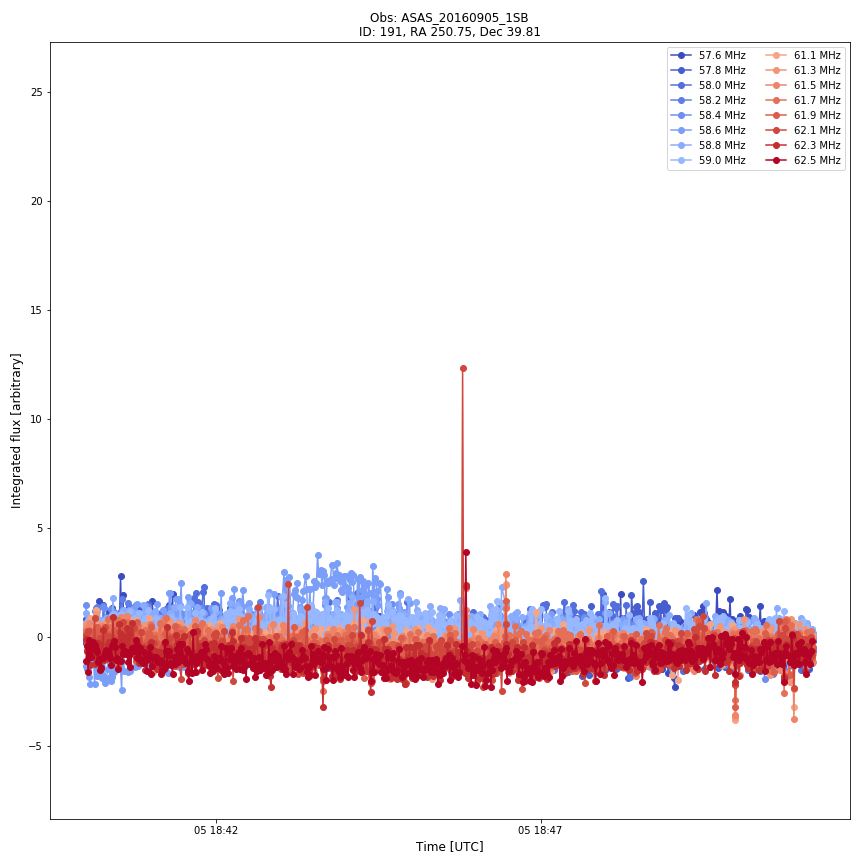

<IPython.core.display.Javascript object>


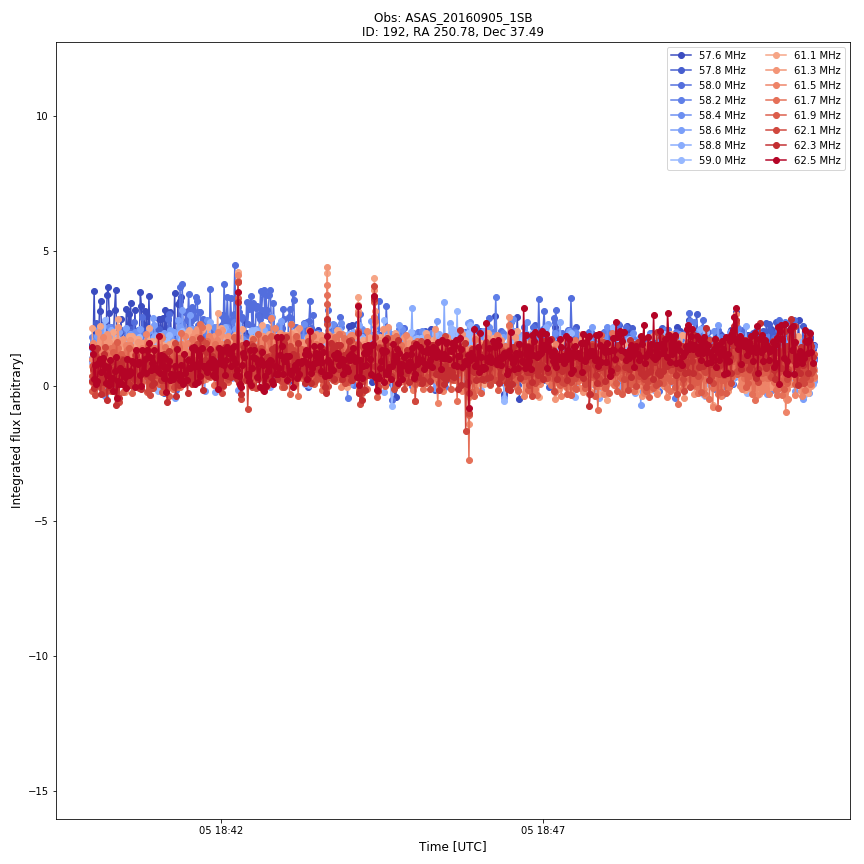

<IPython.core.display.Javascript object>


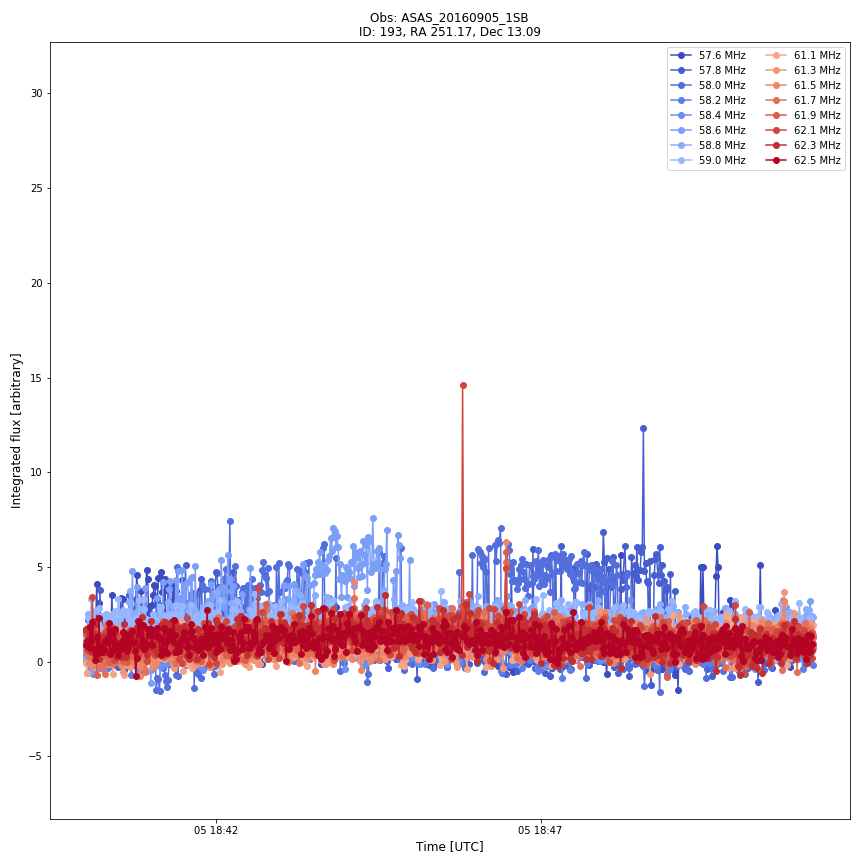

<IPython.core.display.Javascript object>


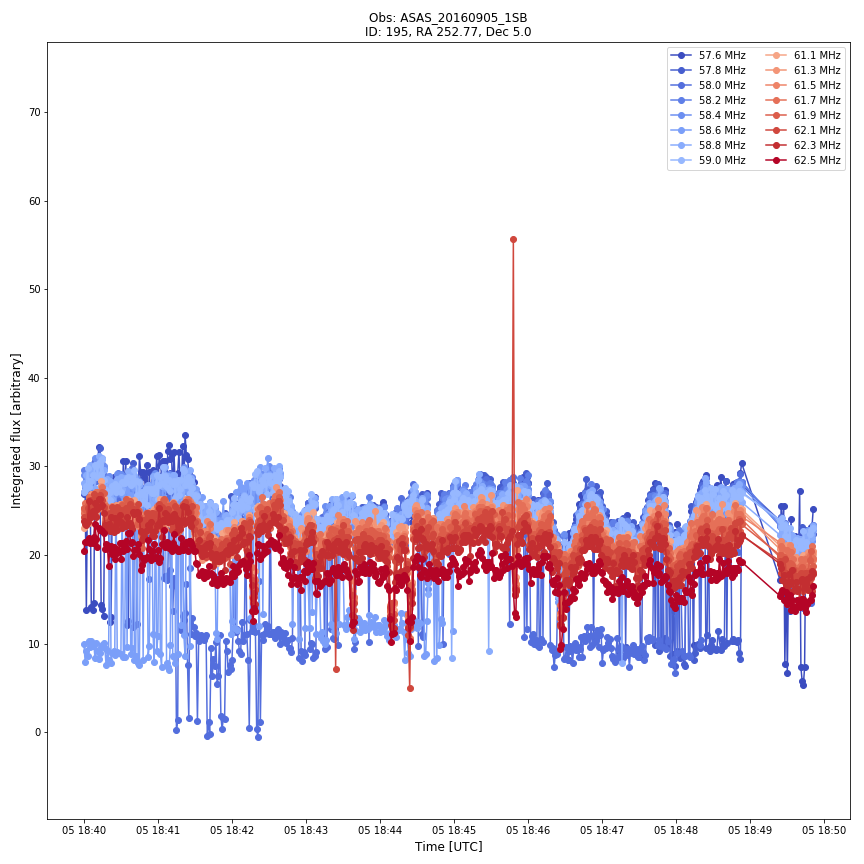

<IPython.core.display.Javascript object>


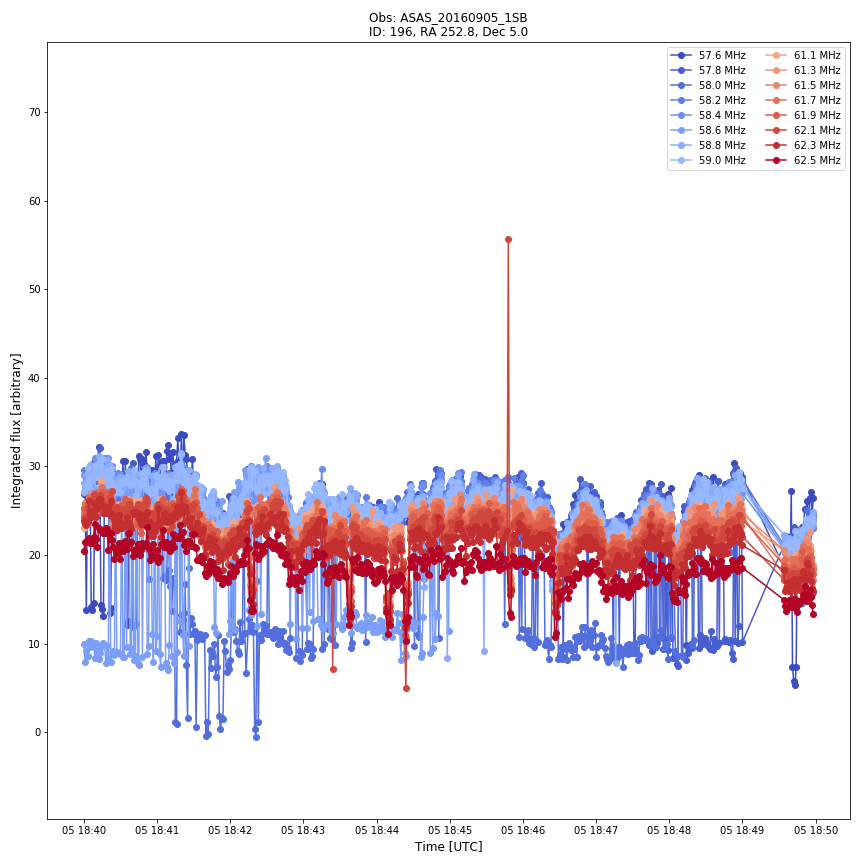

<IPython.core.display.Javascript object>


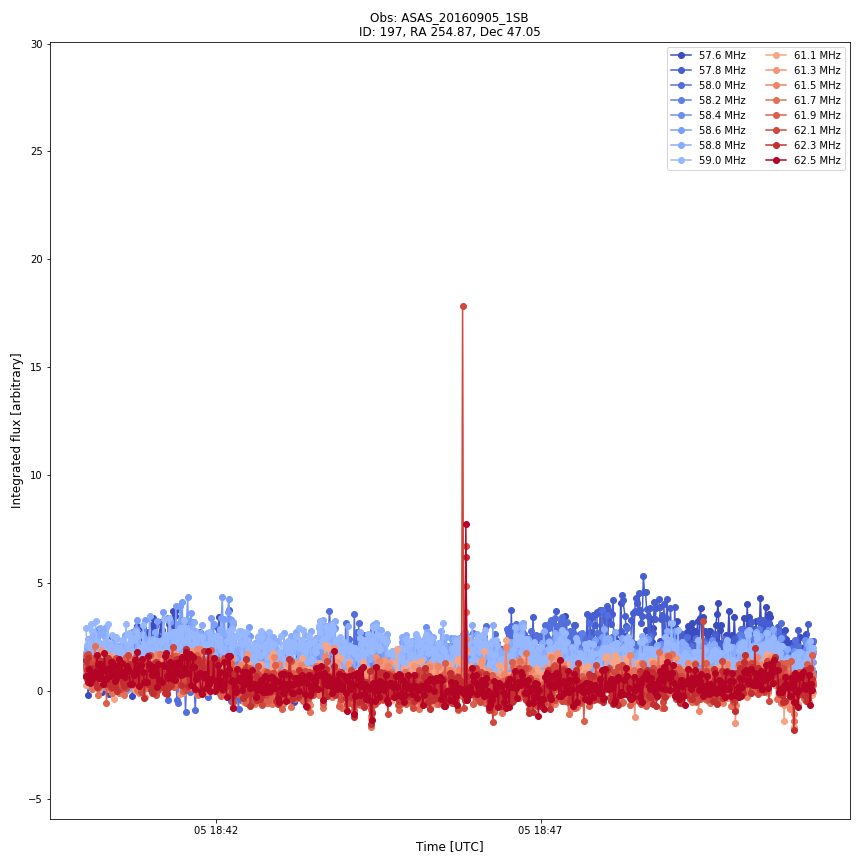

<IPython.core.display.Javascript object>


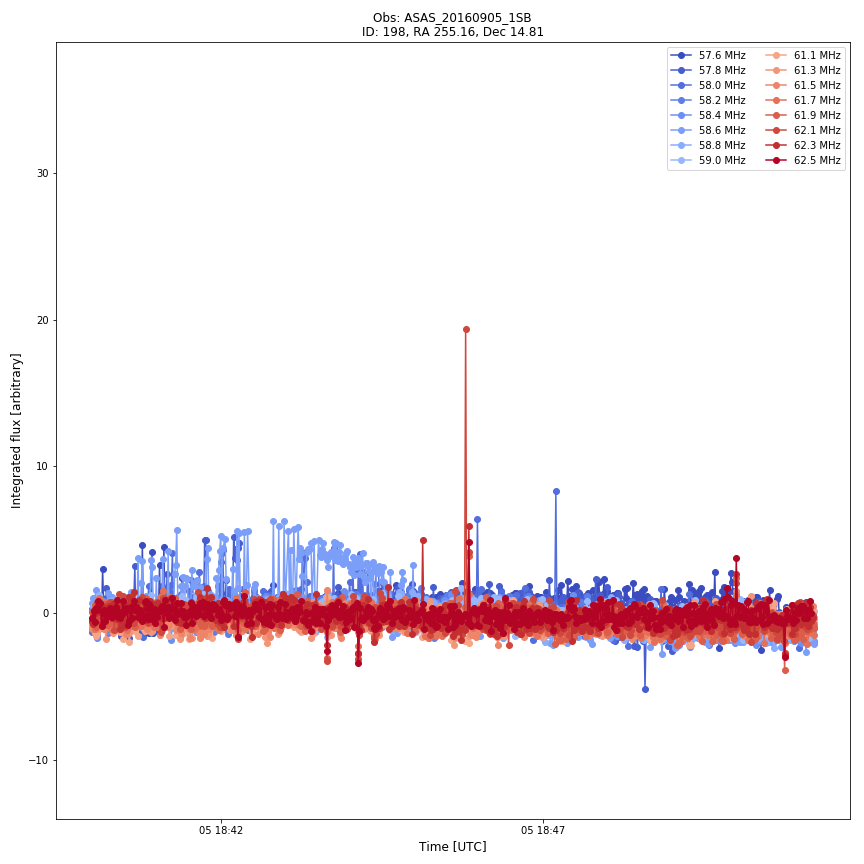

<IPython.core.display.Javascript object>


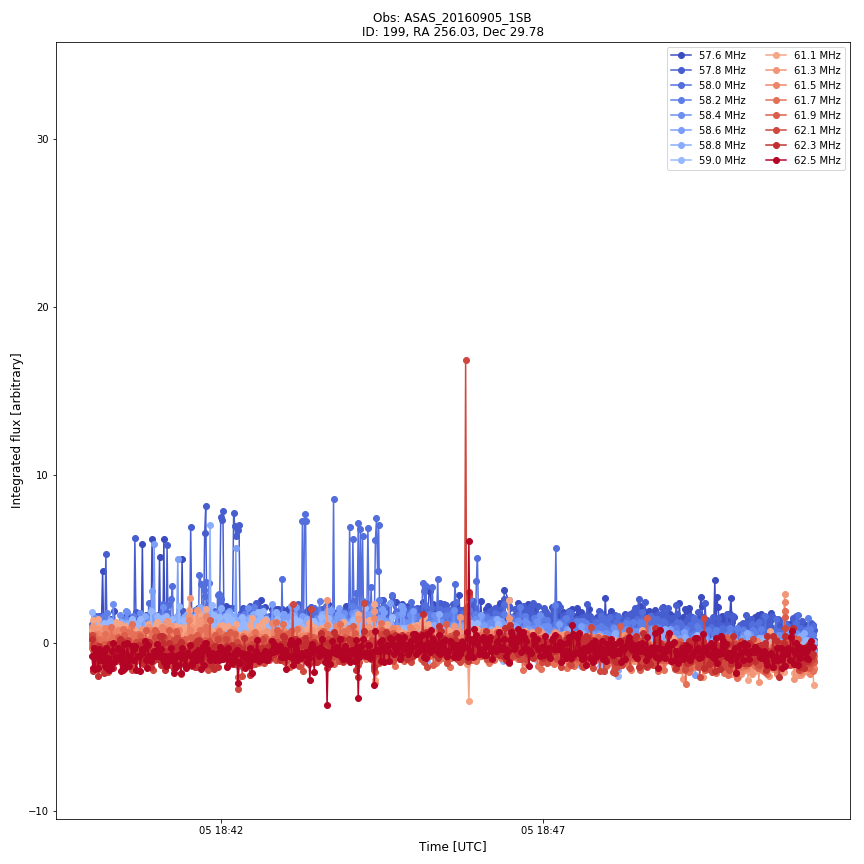

<IPython.core.display.Javascript object>


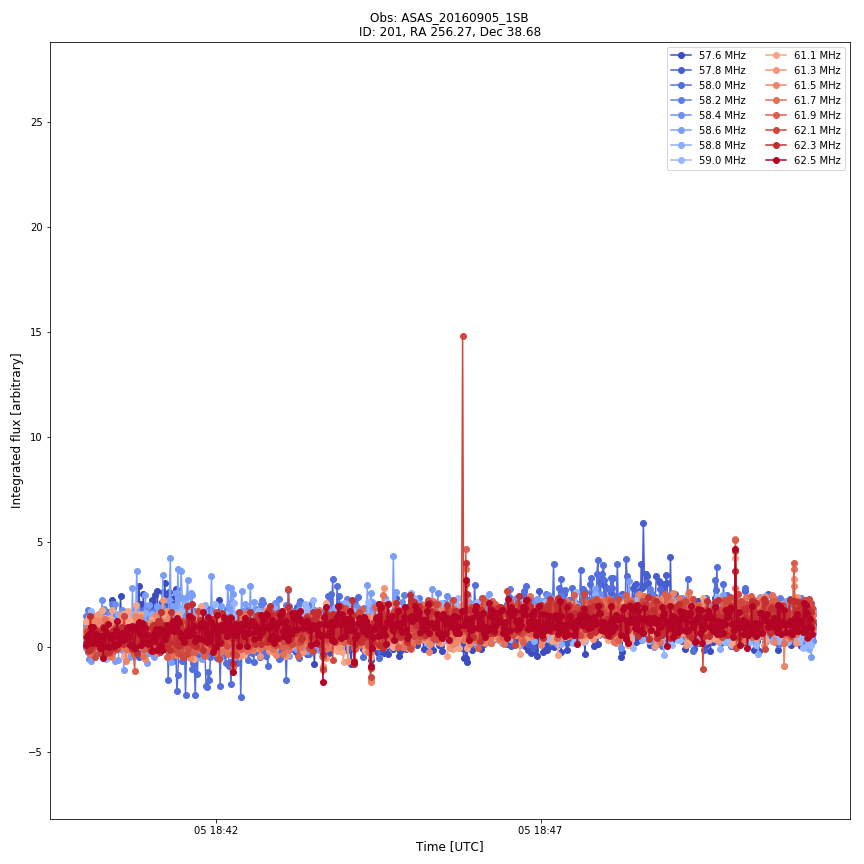

<IPython.core.display.Javascript object>


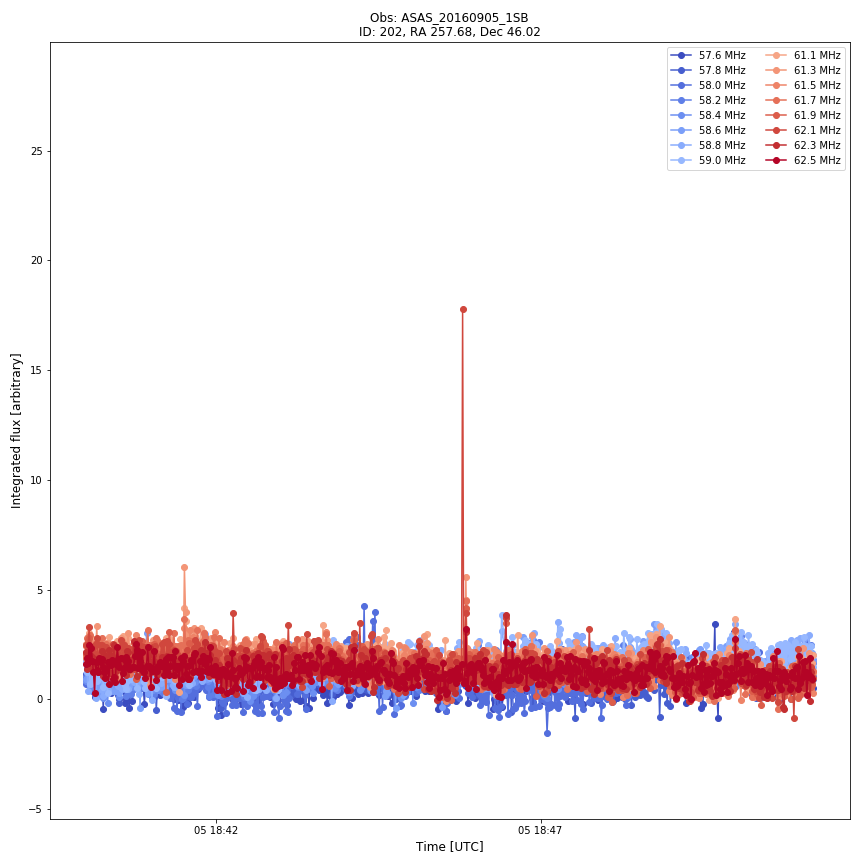

<IPython.core.display.Javascript object>


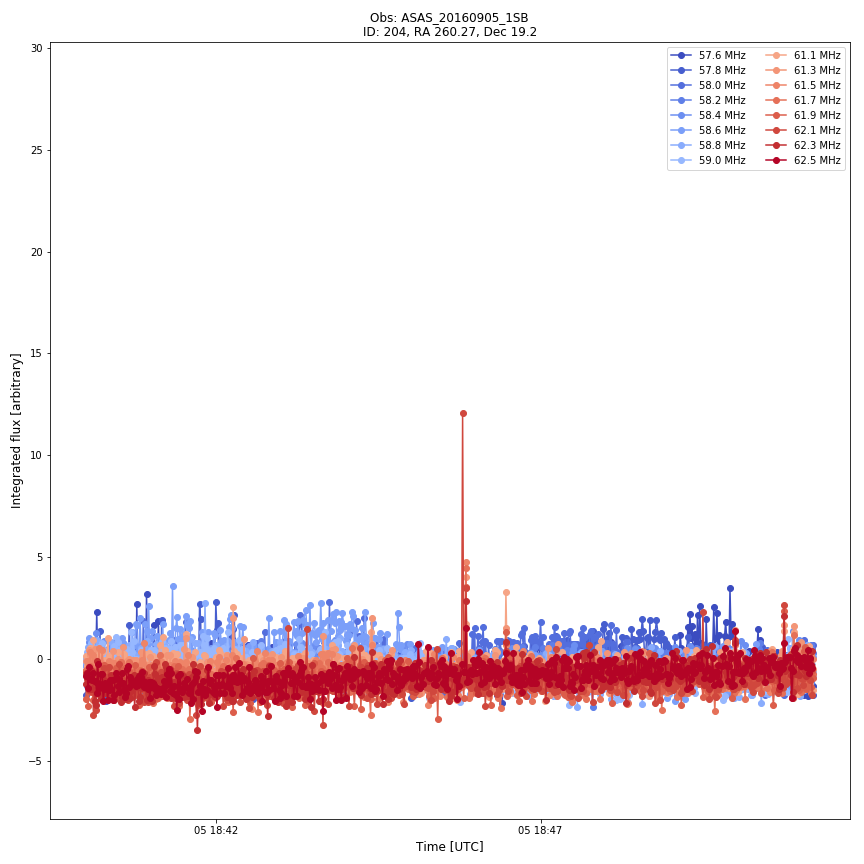

<IPython.core.display.Javascript object>


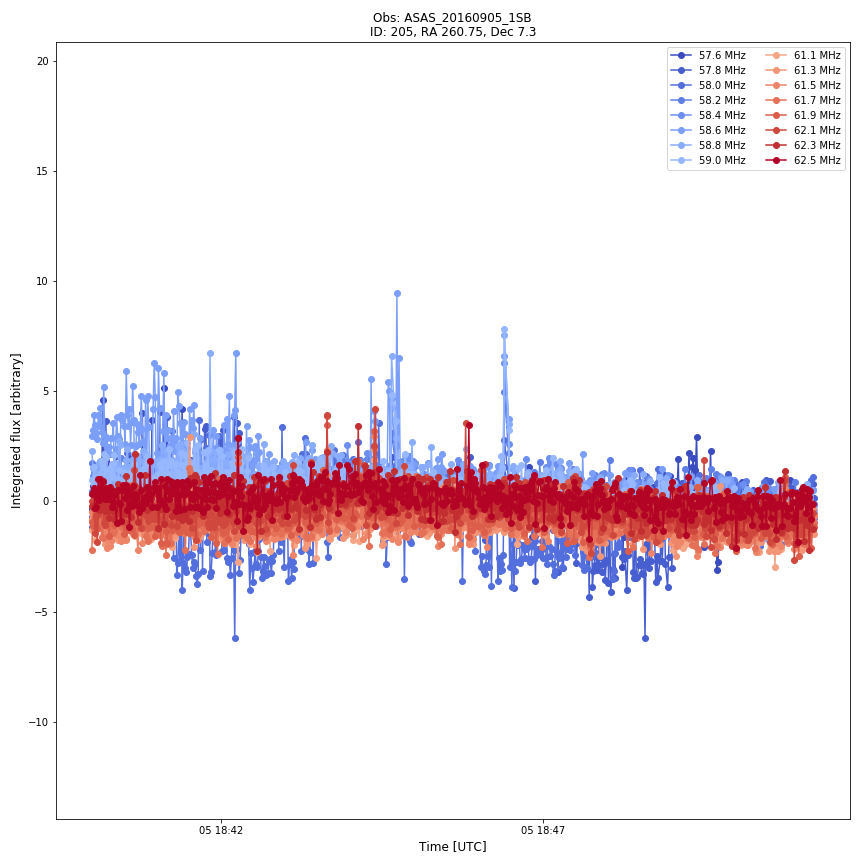

<IPython.core.display.Javascript object>


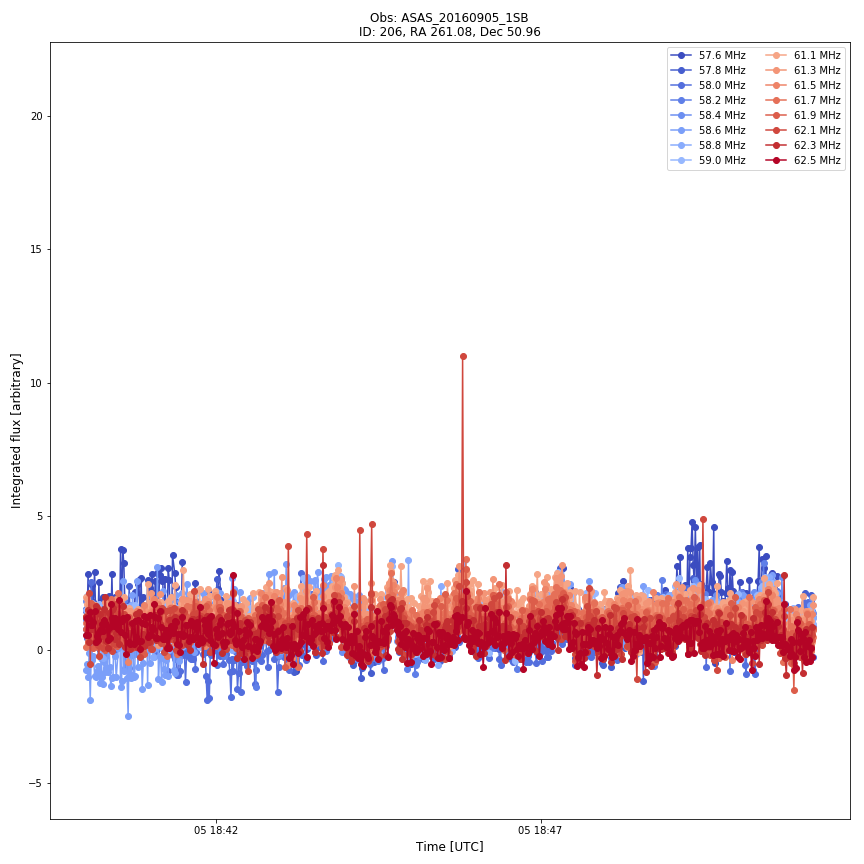

<IPython.core.display.Javascript object>


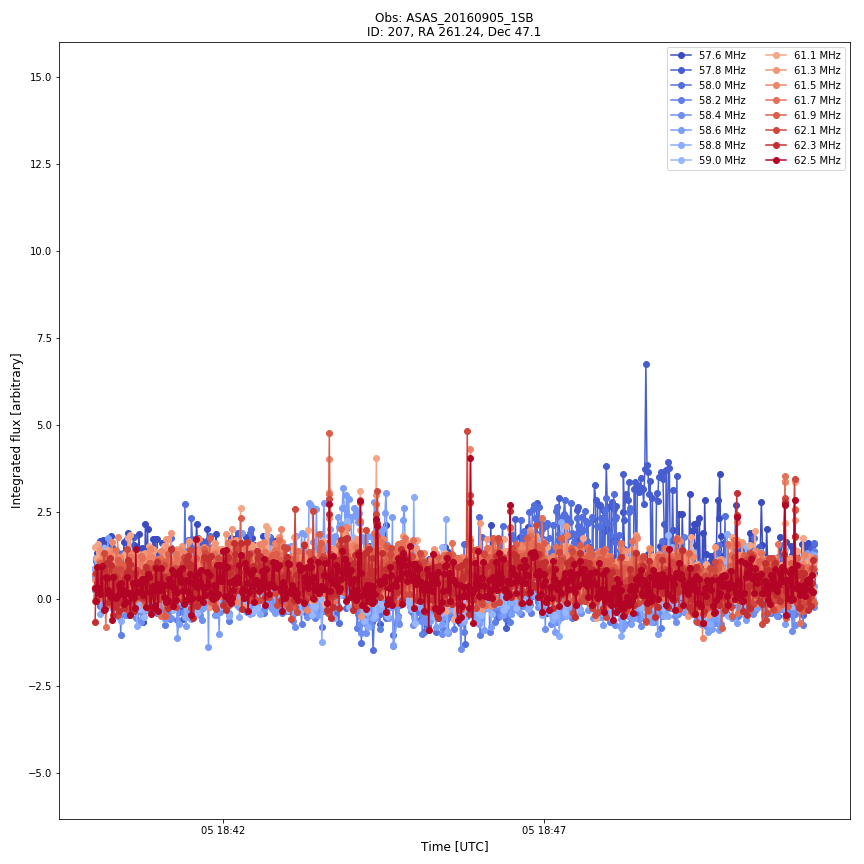

<IPython.core.display.Javascript object>


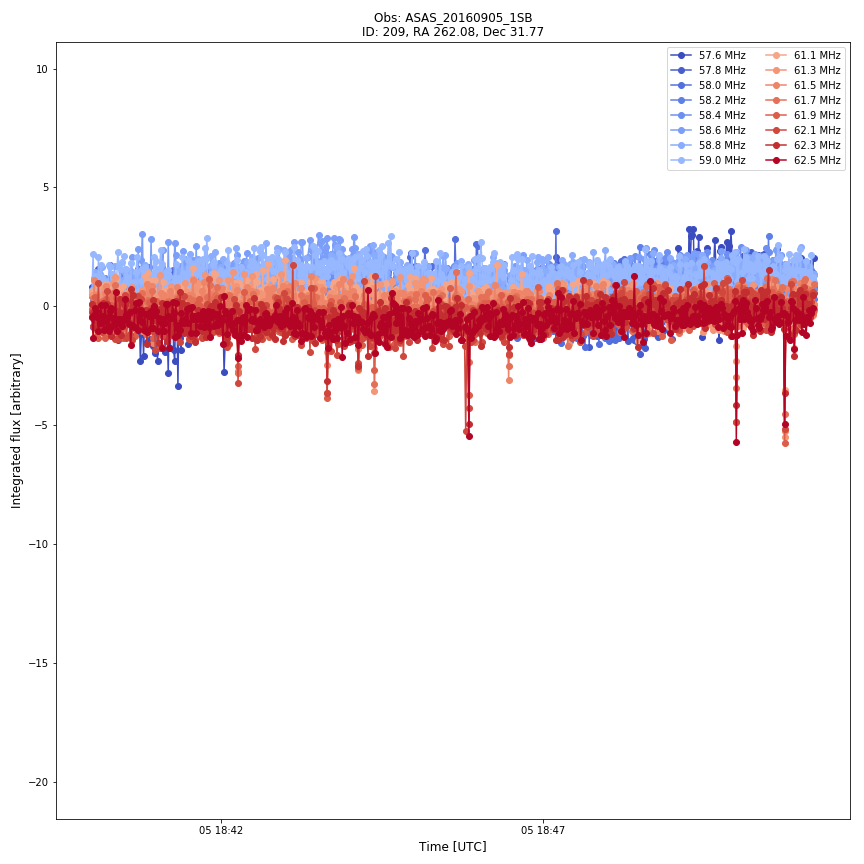

<IPython.core.display.Javascript object>


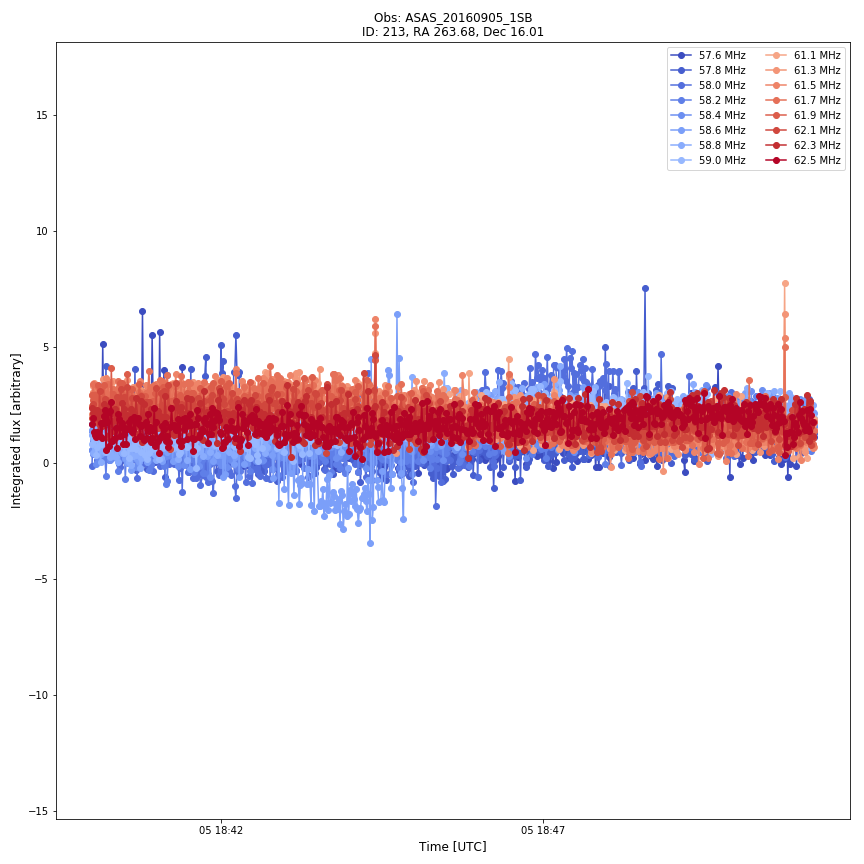

<IPython.core.display.Javascript object>


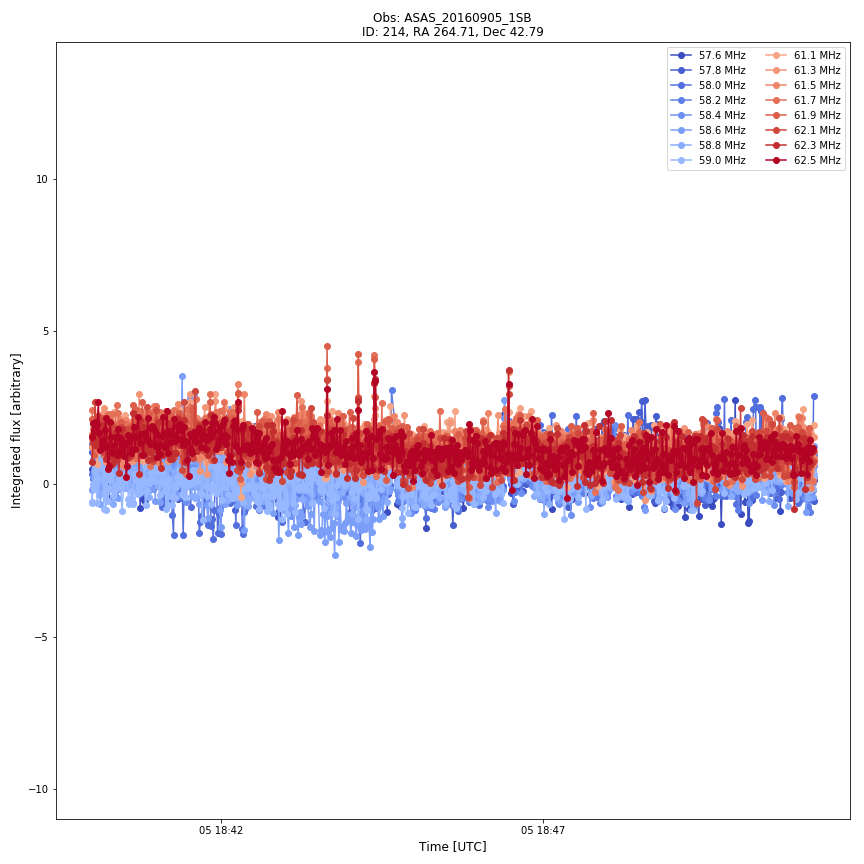

<IPython.core.display.Javascript object>


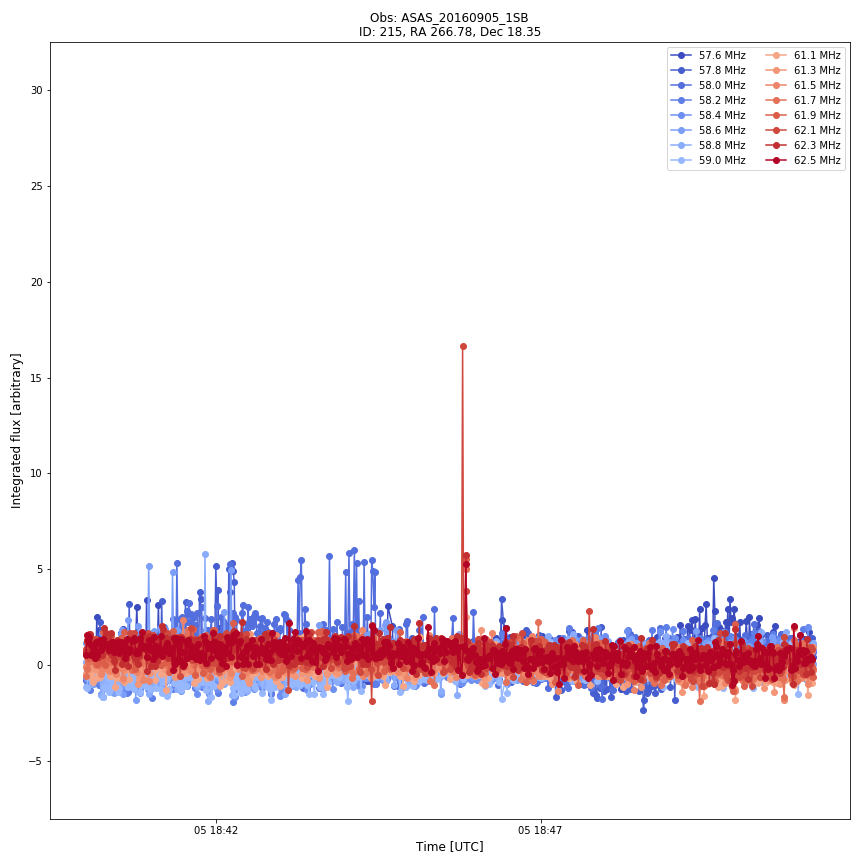

<IPython.core.display.Javascript object>


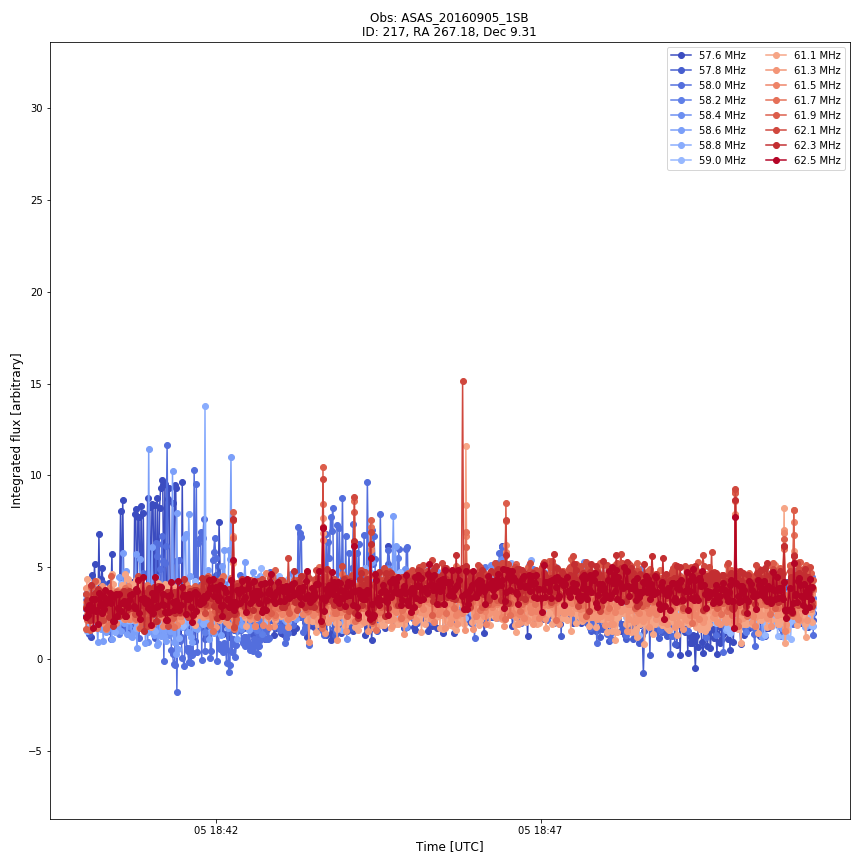

<IPython.core.display.Javascript object>


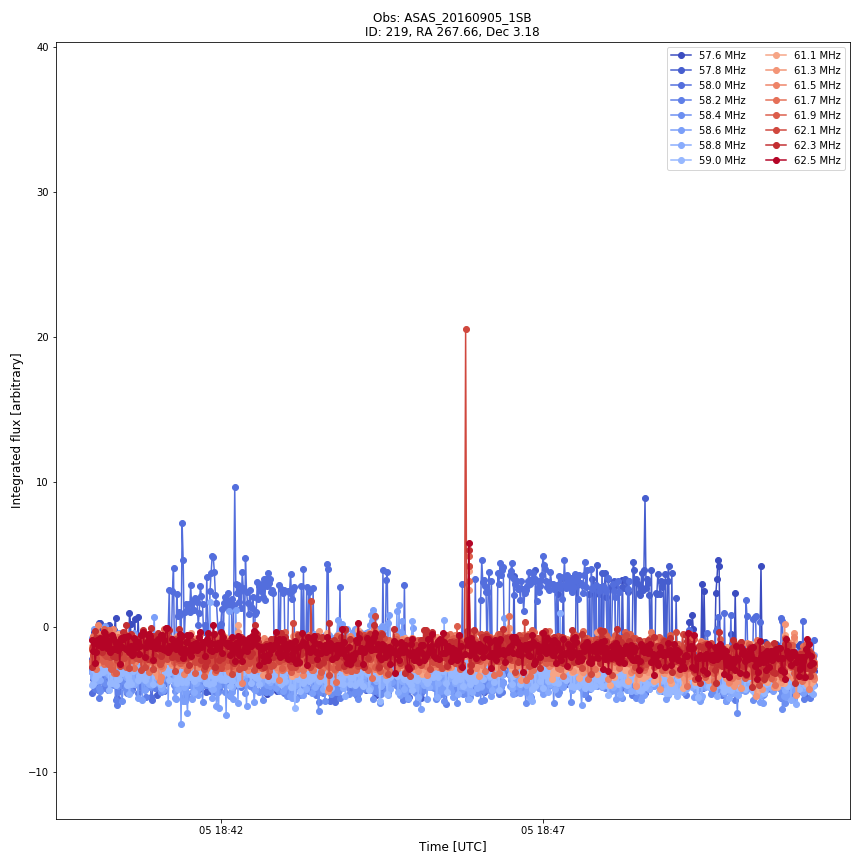

<IPython.core.display.Javascript object>


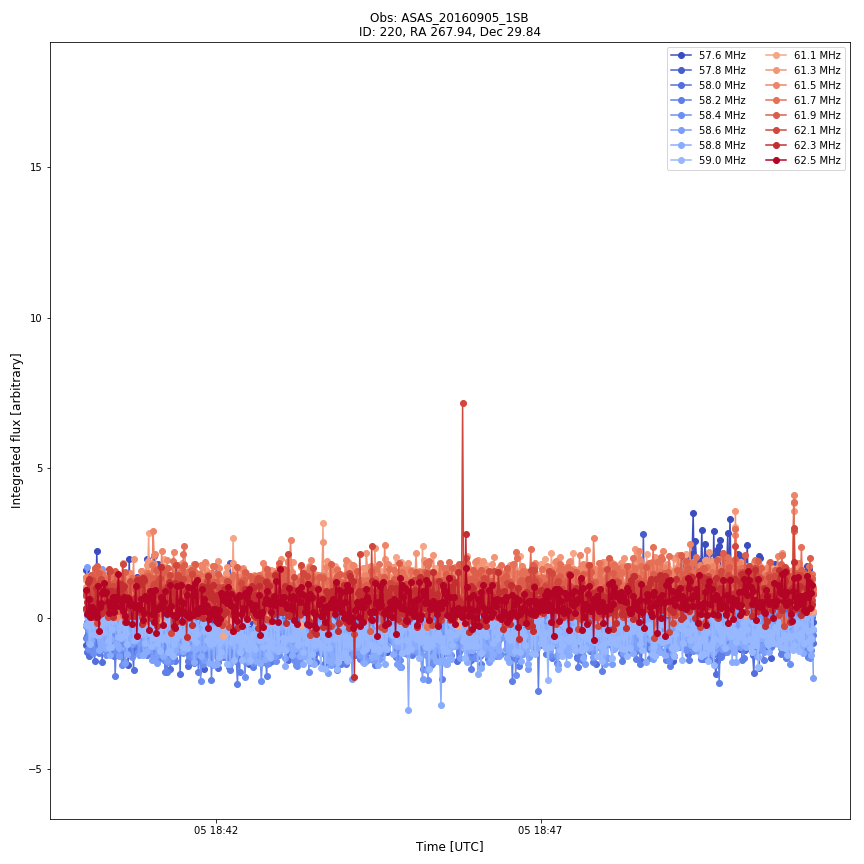

<IPython.core.display.Javascript object>


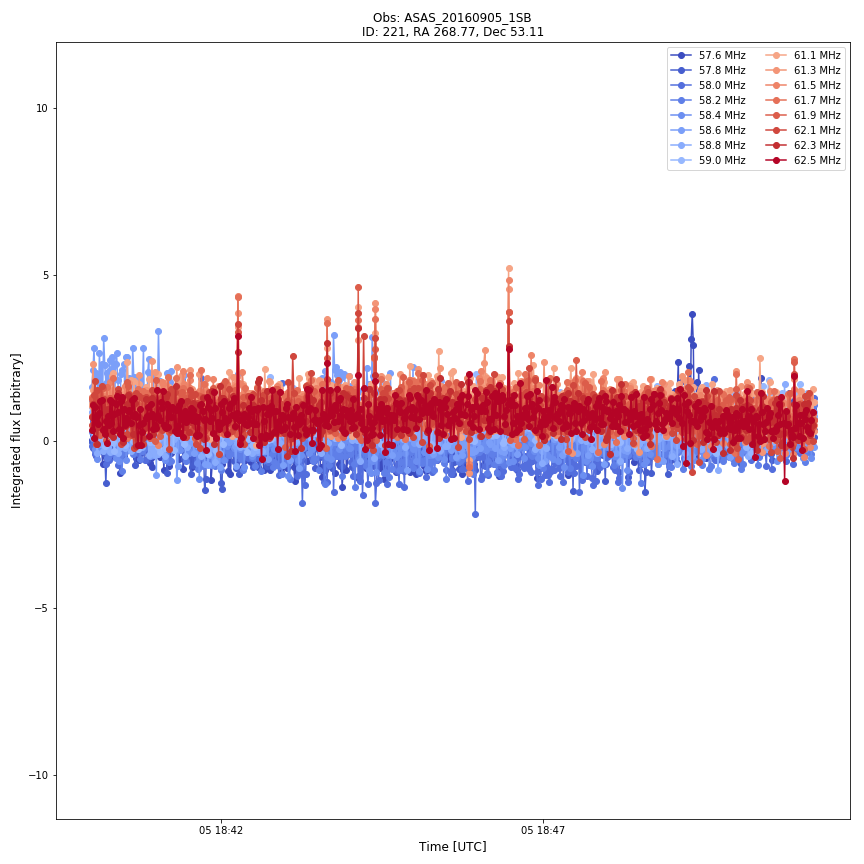

<IPython.core.display.Javascript object>


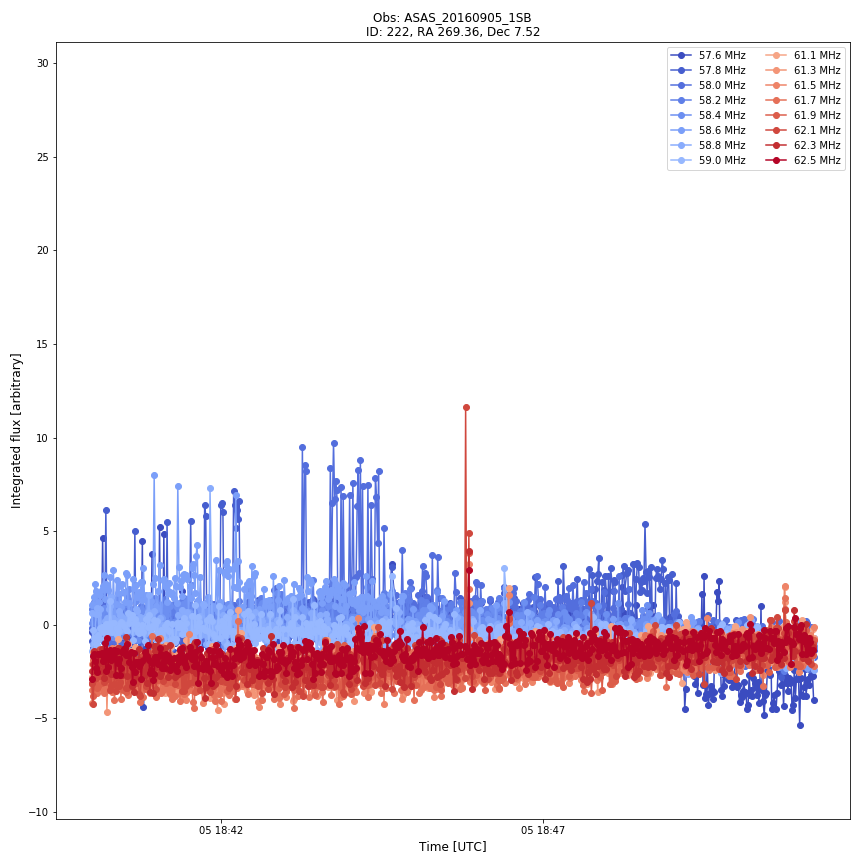

<IPython.core.display.Javascript object>


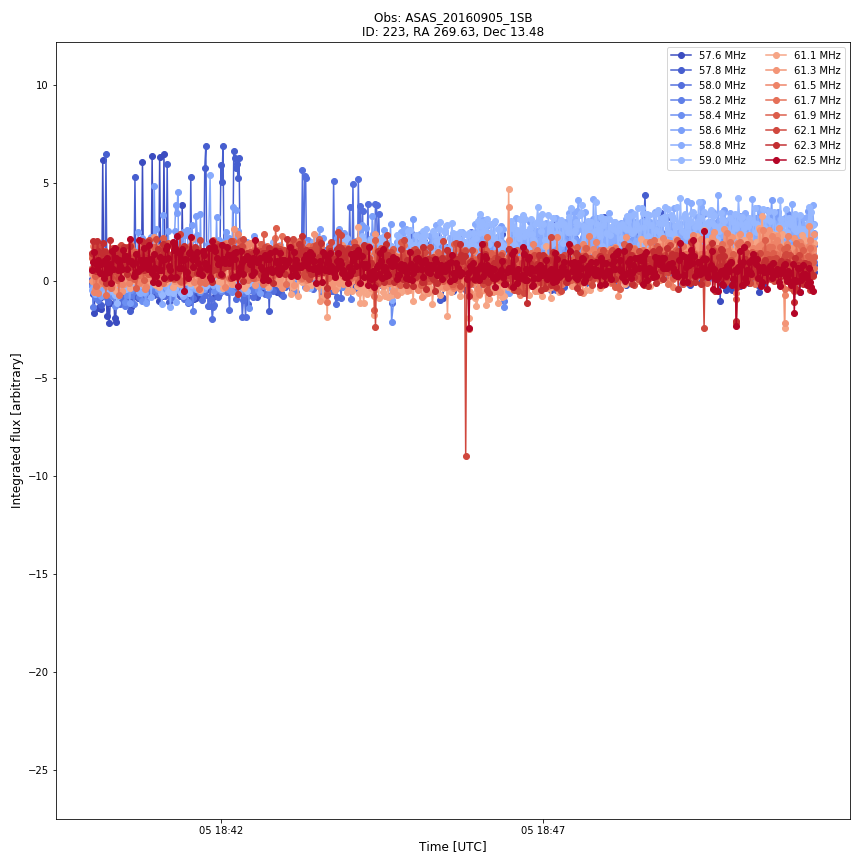

<IPython.core.display.Javascript object>


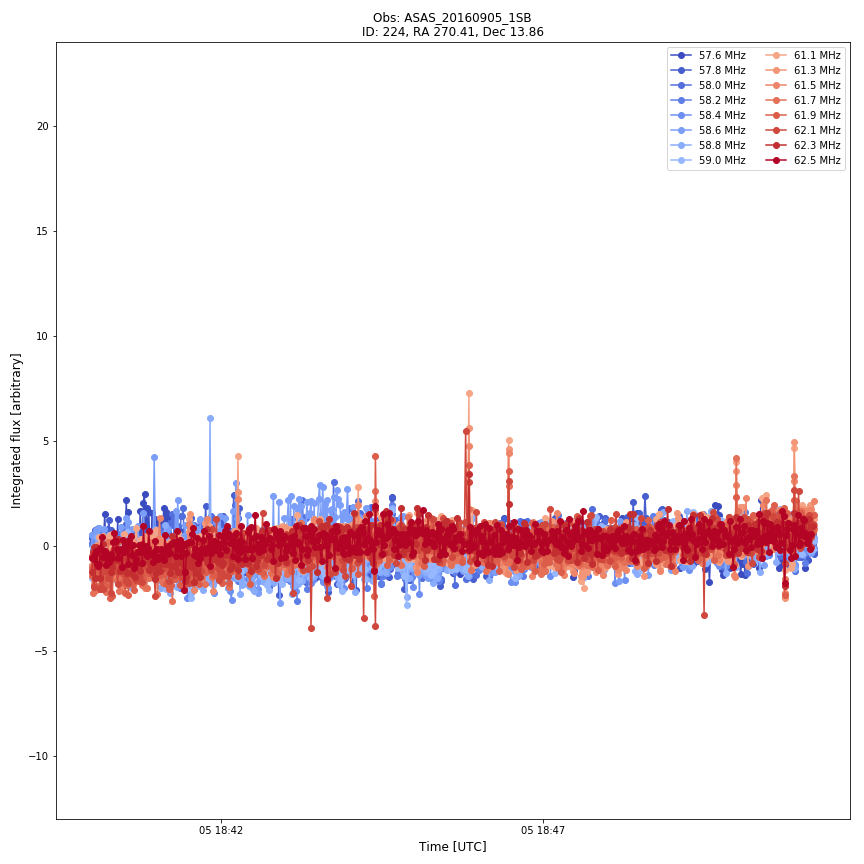

<IPython.core.display.Javascript object>


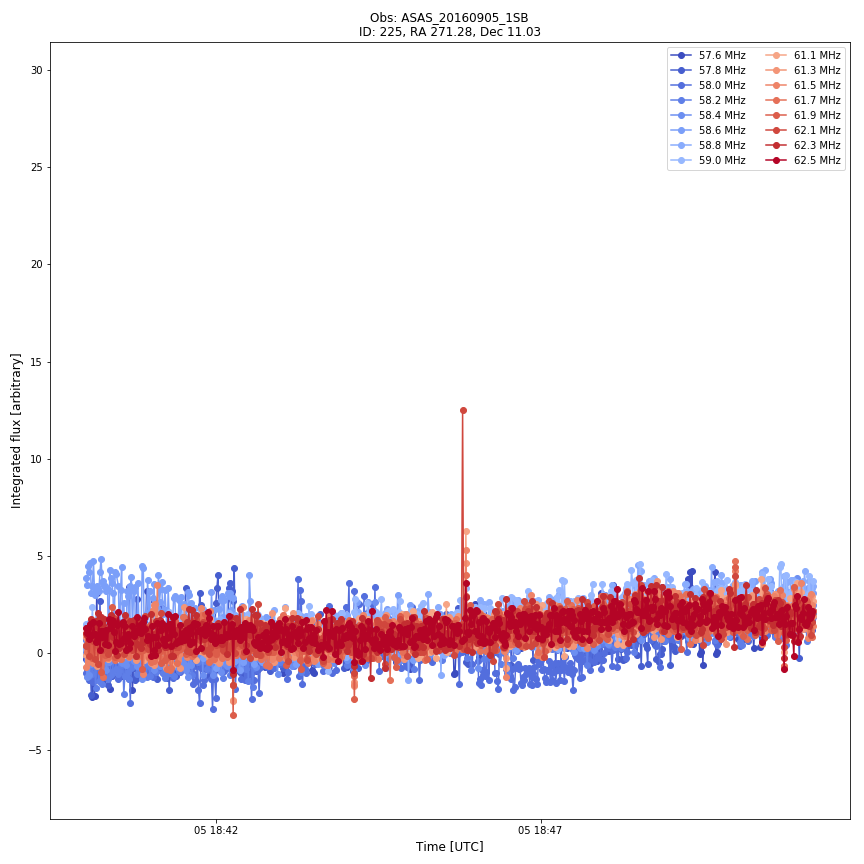

<IPython.core.display.Javascript object>


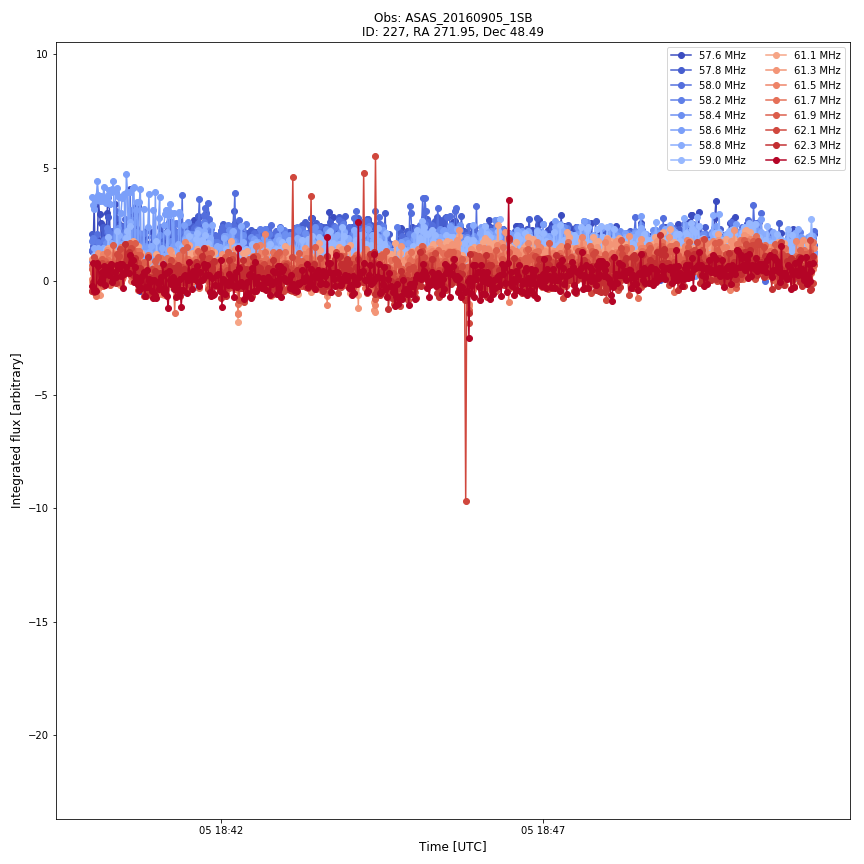

<IPython.core.display.Javascript object>


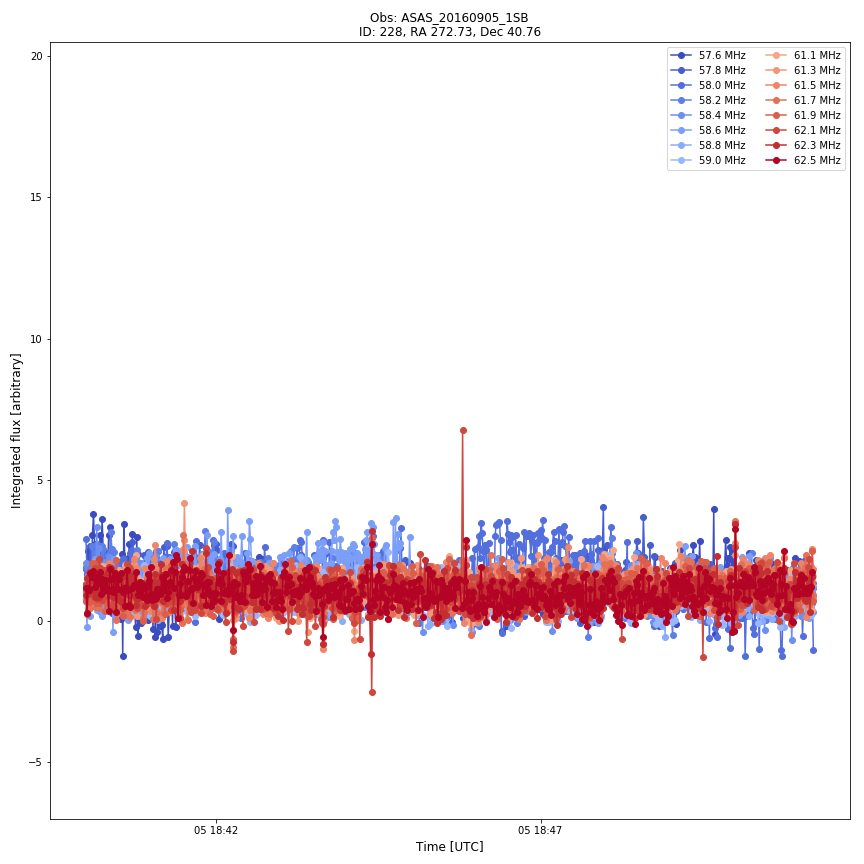

<IPython.core.display.Javascript object>


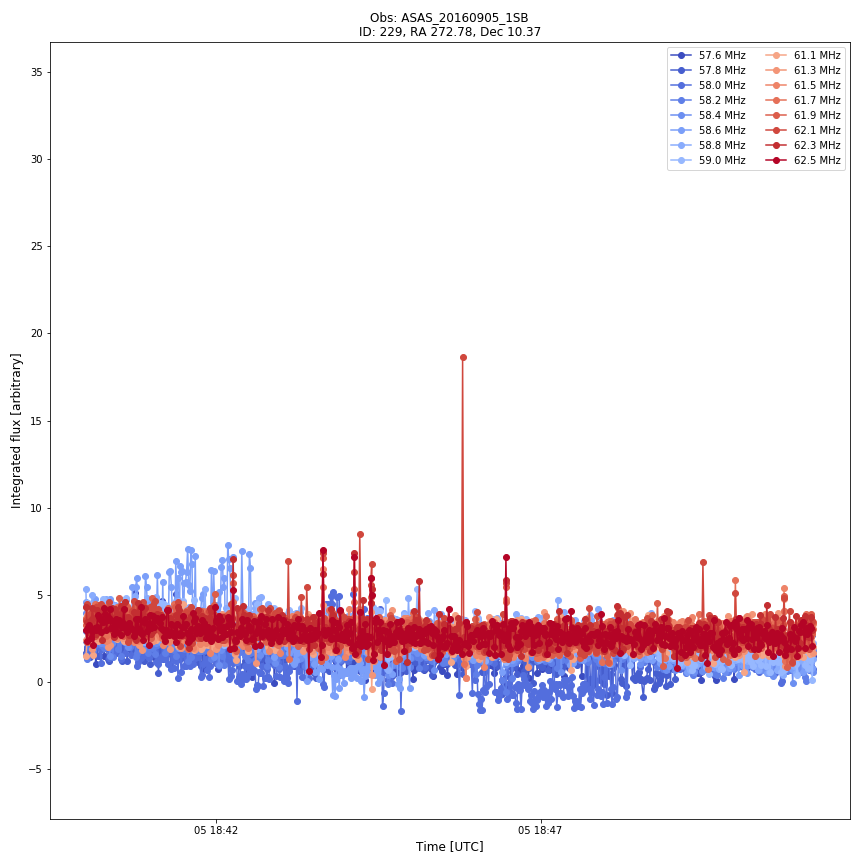

<IPython.core.display.Javascript object>


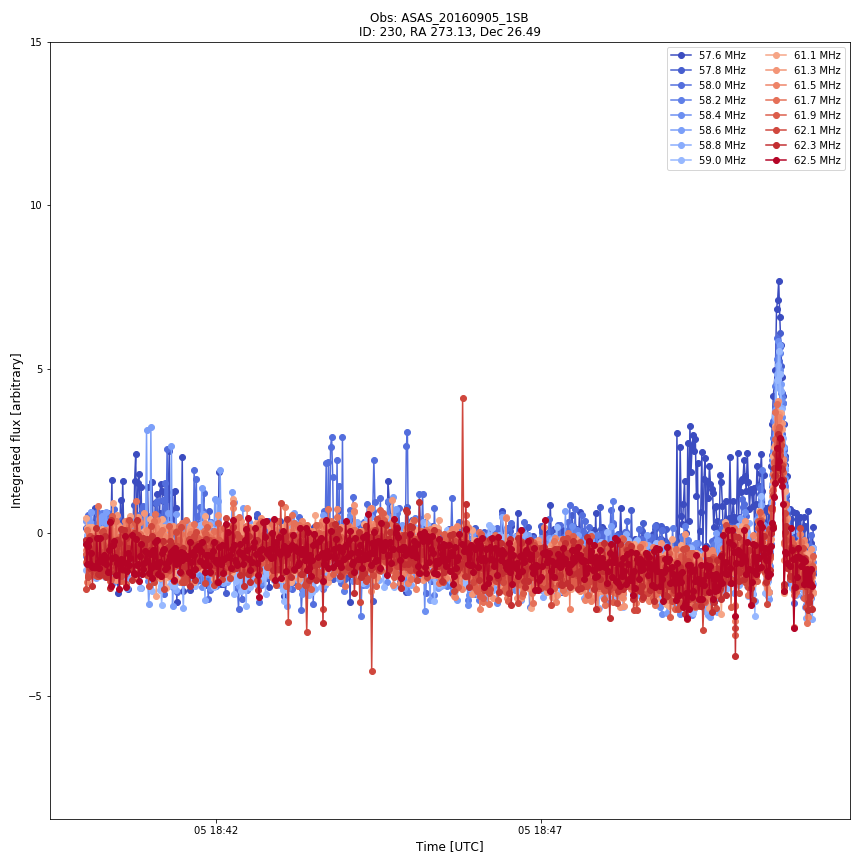

<IPython.core.display.Javascript object>


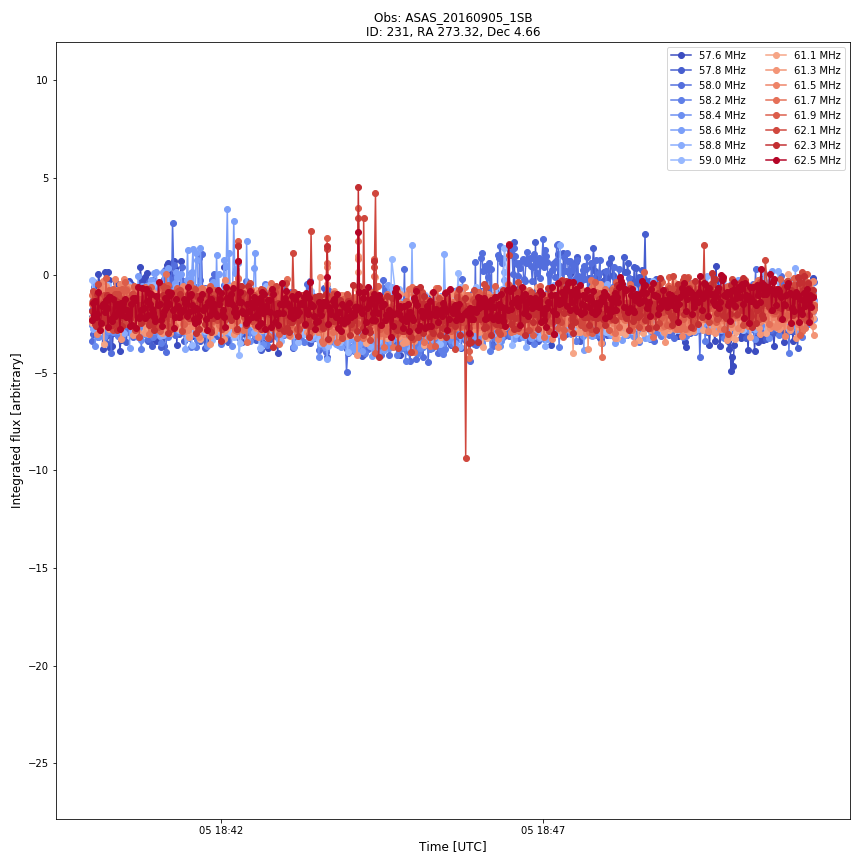

<IPython.core.display.Javascript object>


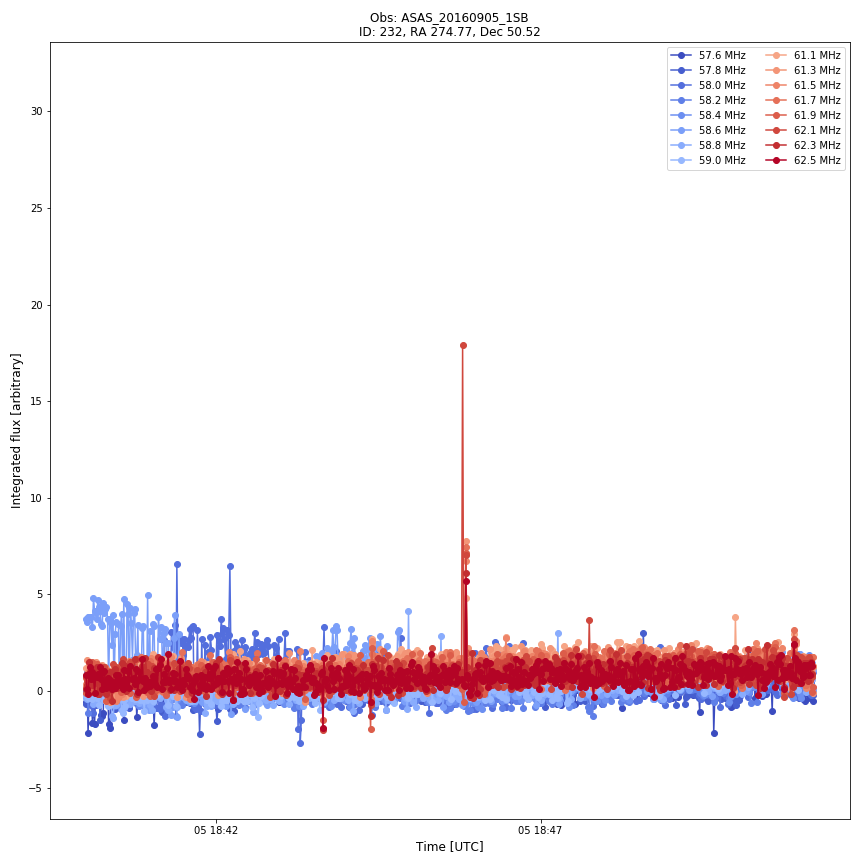

<IPython.core.display.Javascript object>


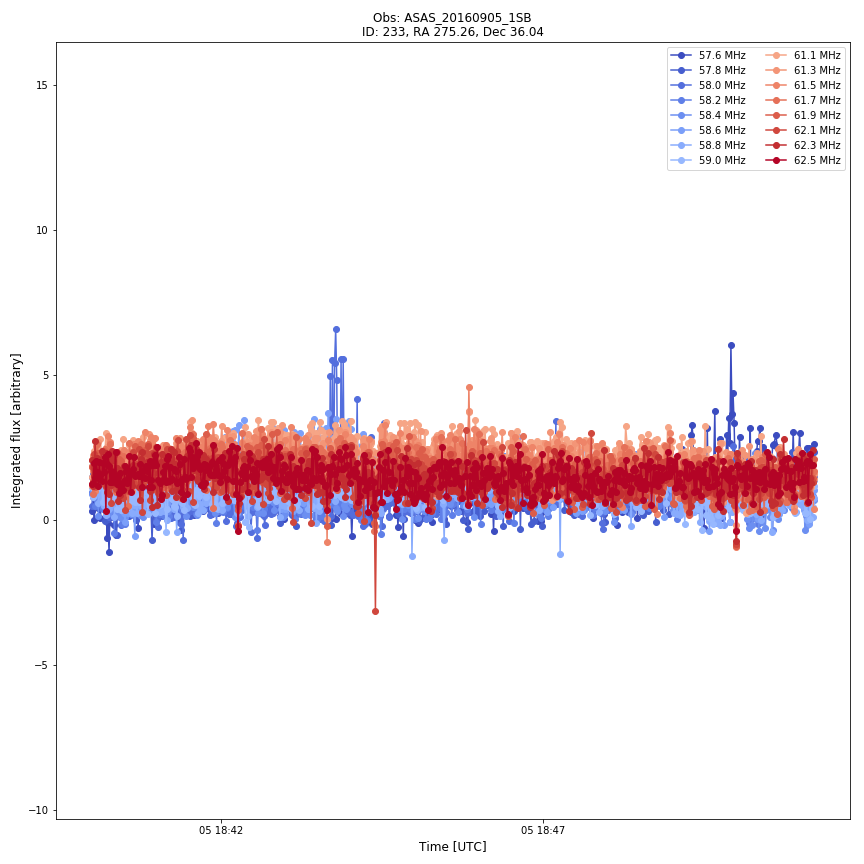

<IPython.core.display.Javascript object>


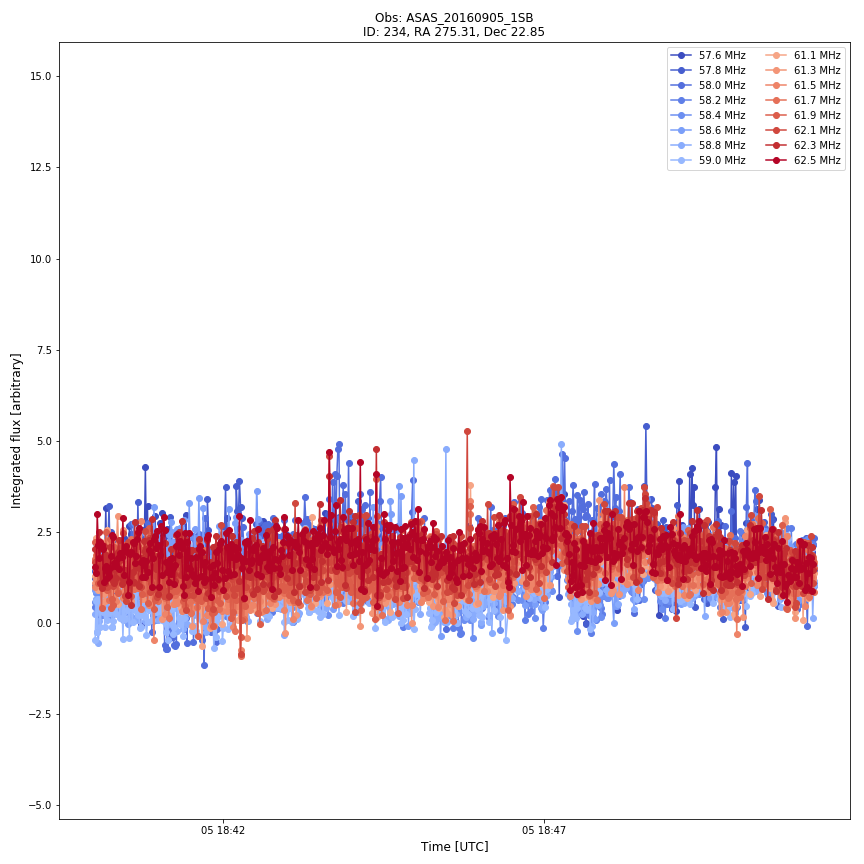

<IPython.core.display.Javascript object>


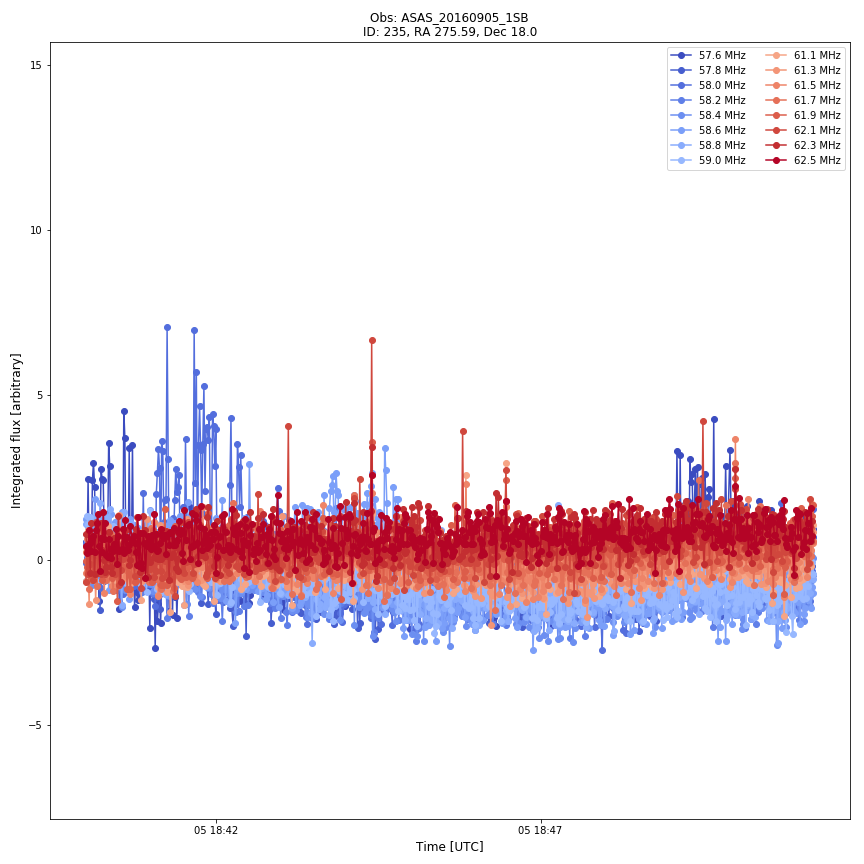

<IPython.core.display.Javascript object>


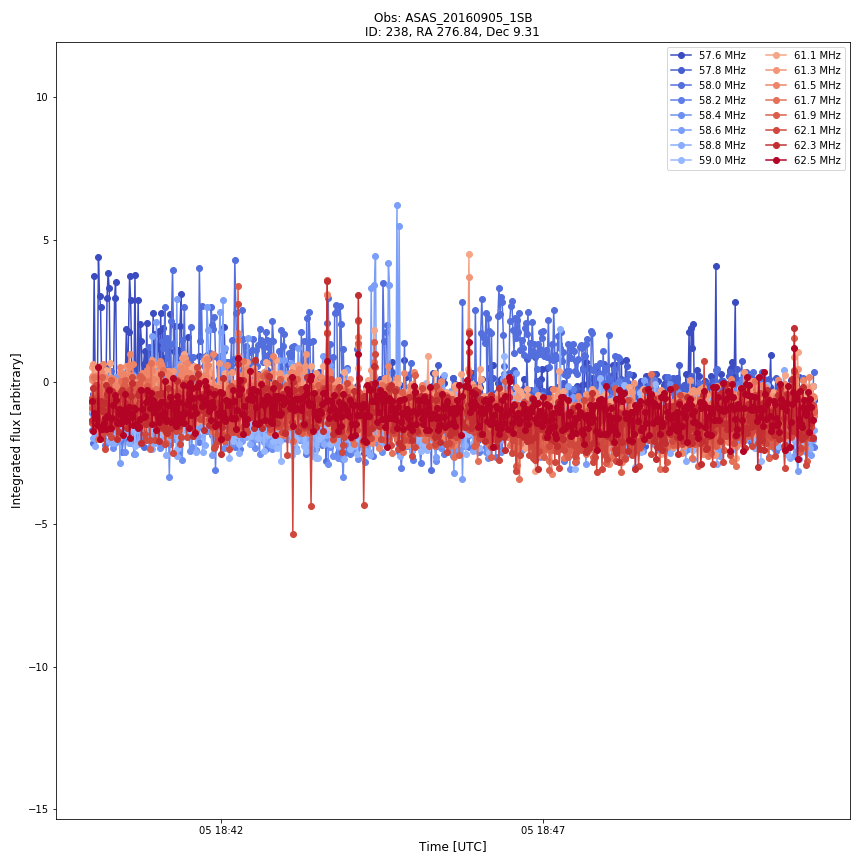

<IPython.core.display.Javascript object>


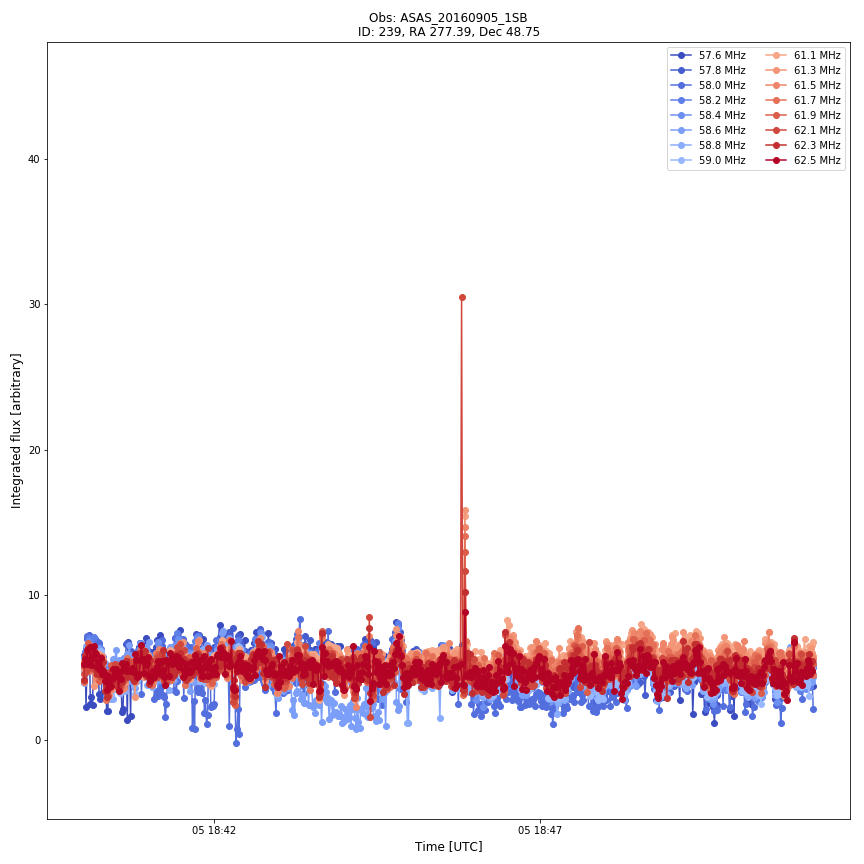

<IPython.core.display.Javascript object>


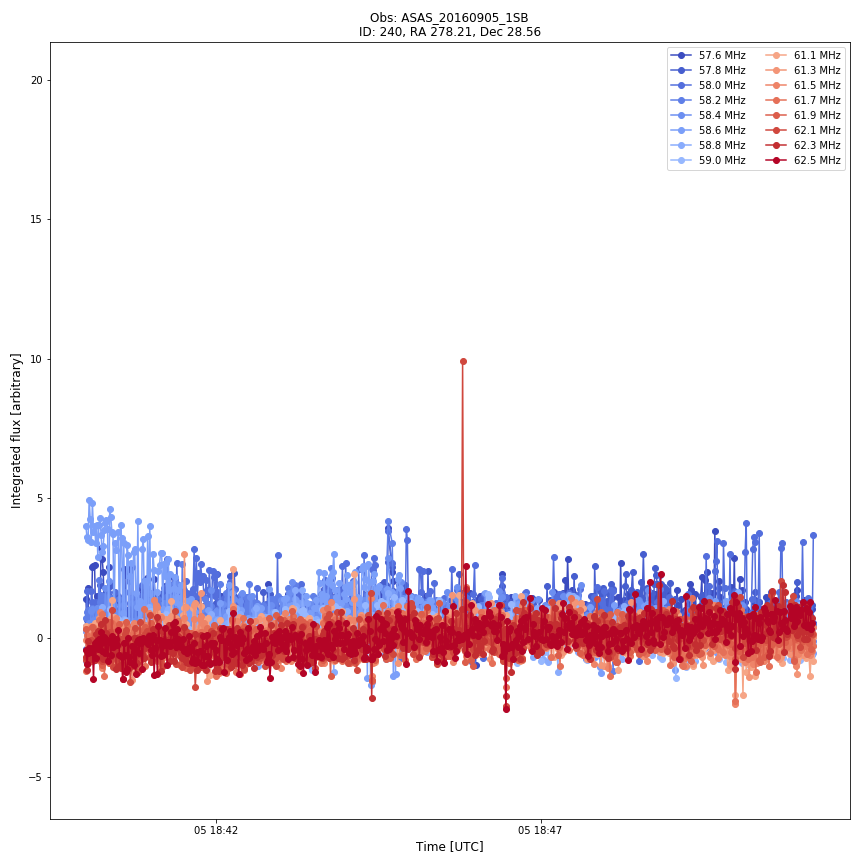

<IPython.core.display.Javascript object>


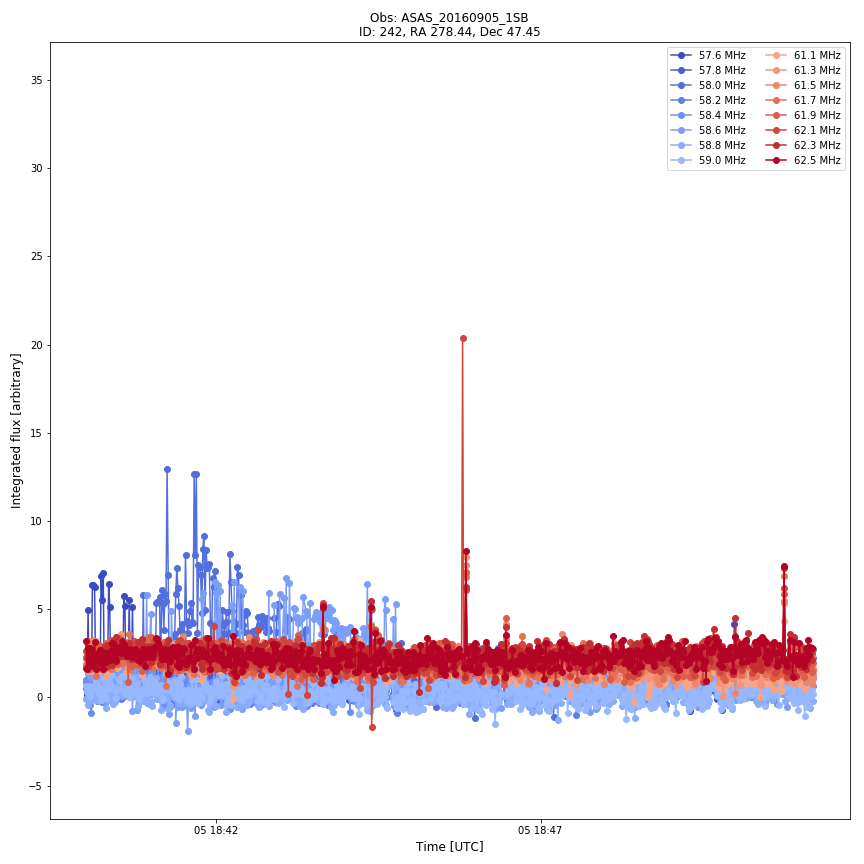

<IPython.core.display.Javascript object>


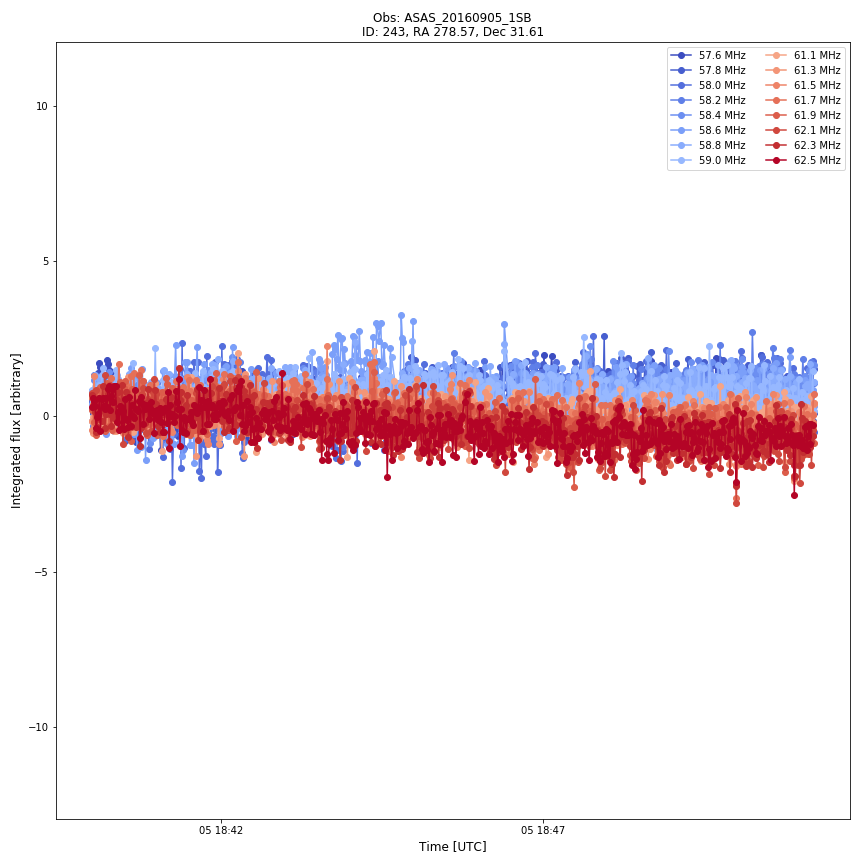

<IPython.core.display.Javascript object>


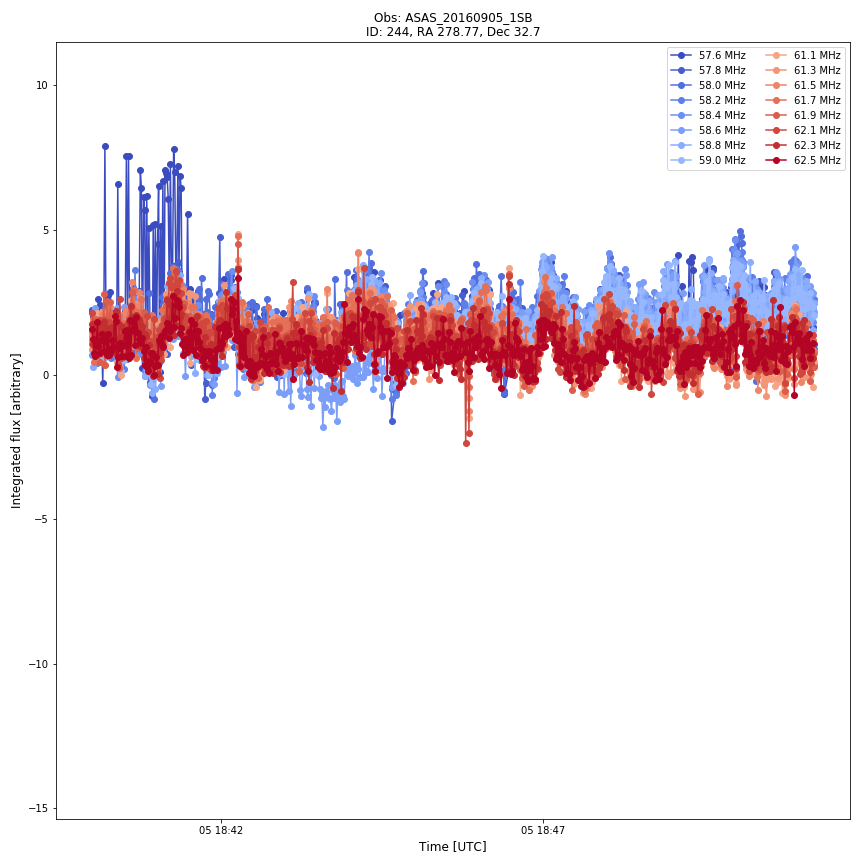

<IPython.core.display.Javascript object>


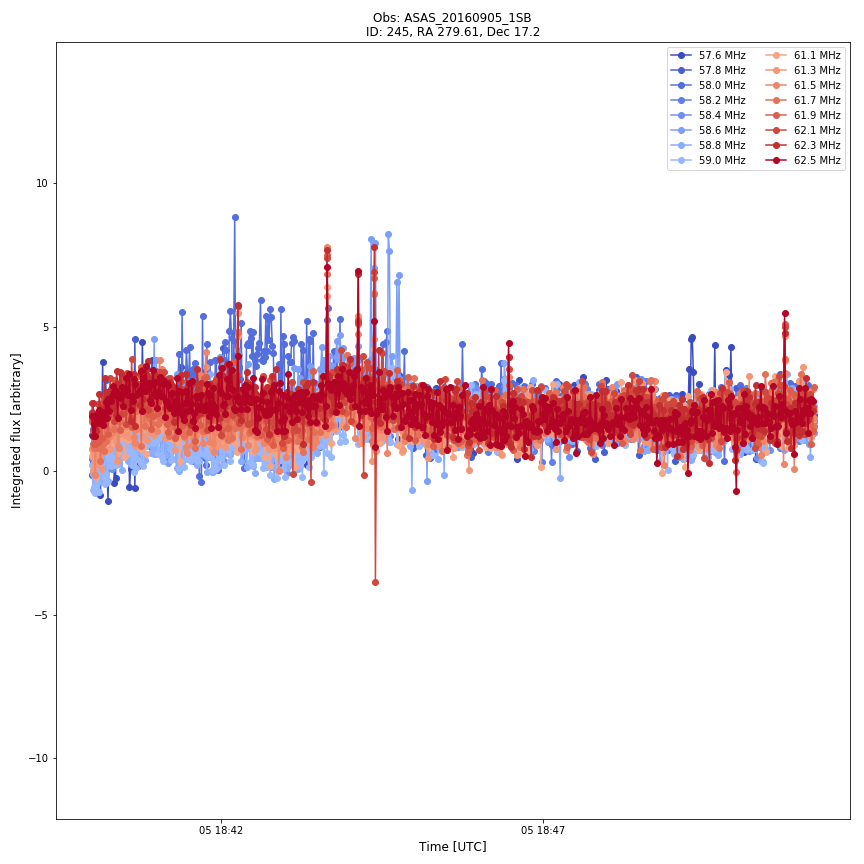

<IPython.core.display.Javascript object>


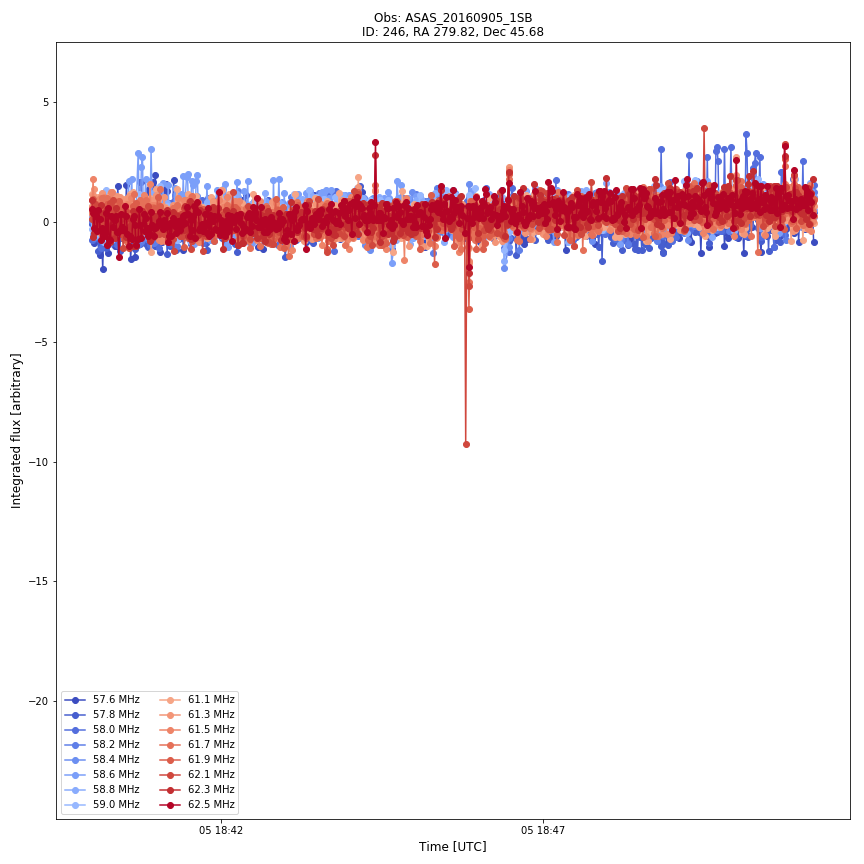

<IPython.core.display.Javascript object>


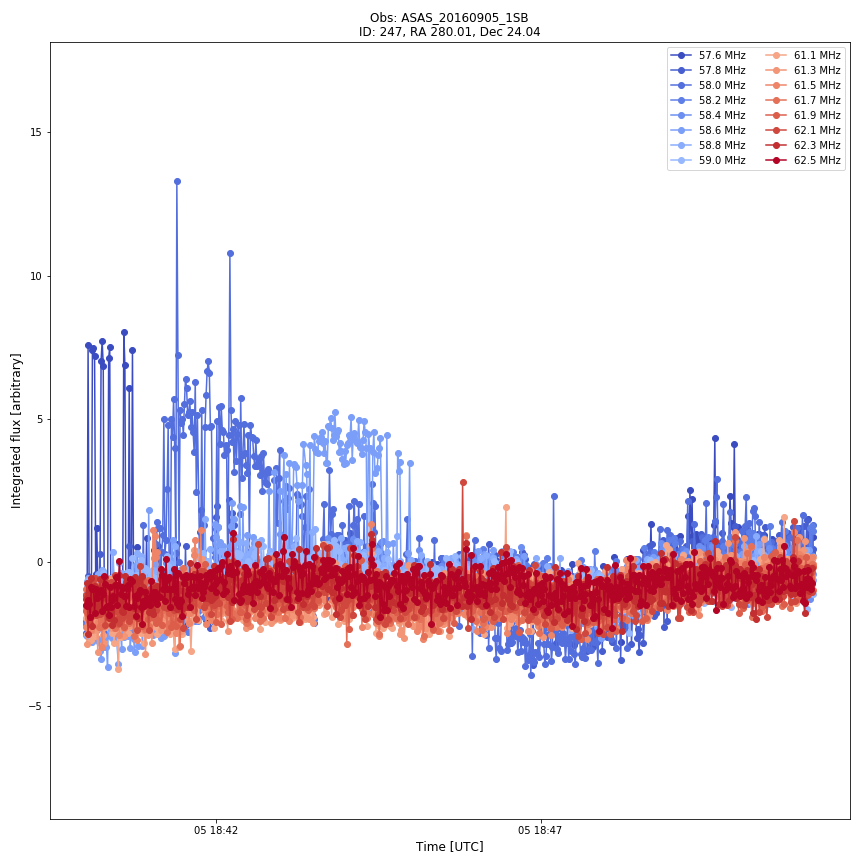

<IPython.core.display.Javascript object>


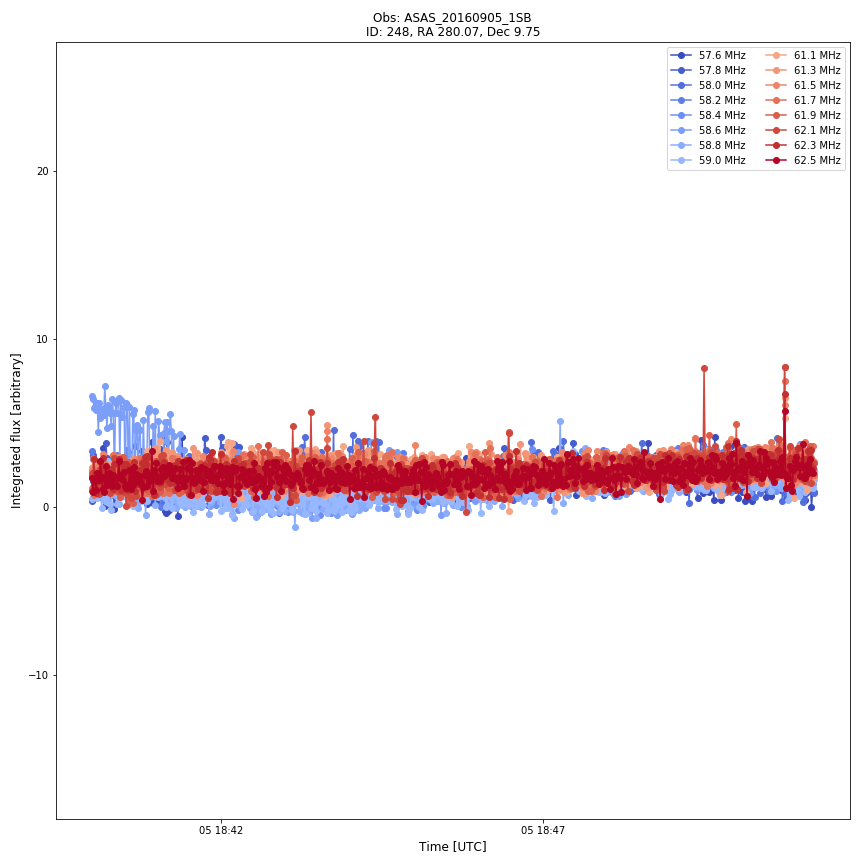

<IPython.core.display.Javascript object>


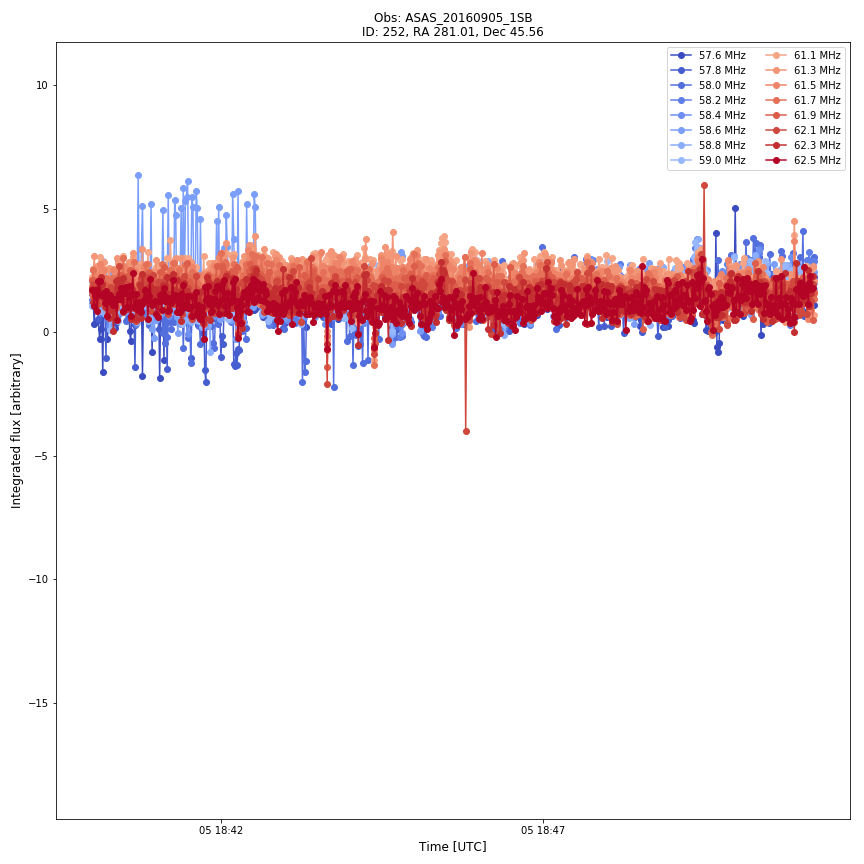

<IPython.core.display.Javascript object>


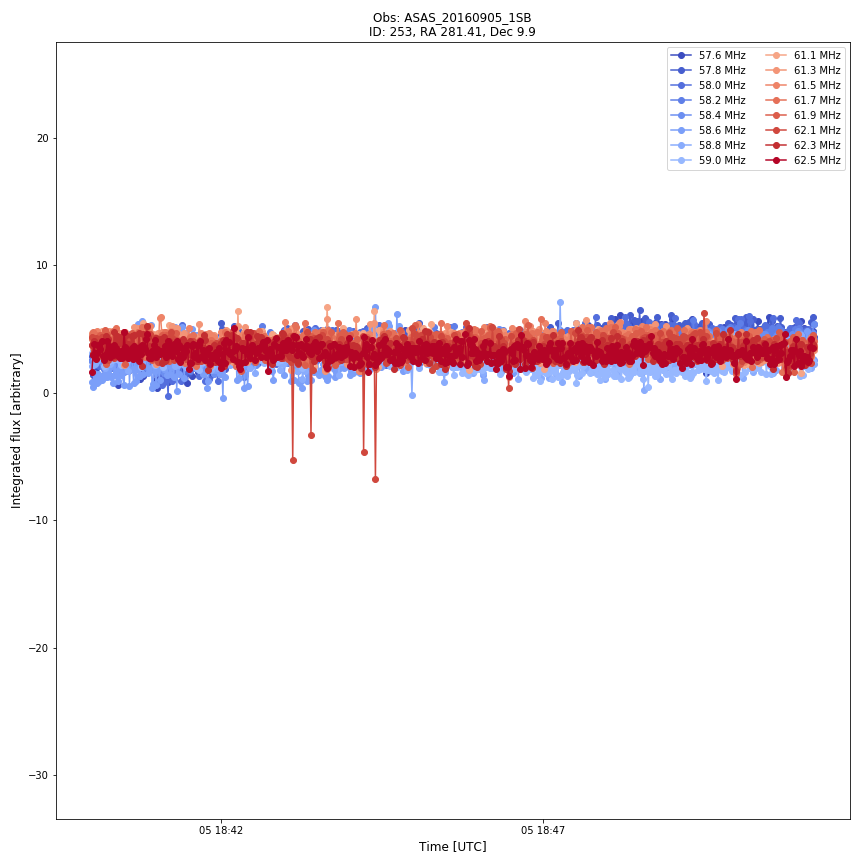

<IPython.core.display.Javascript object>


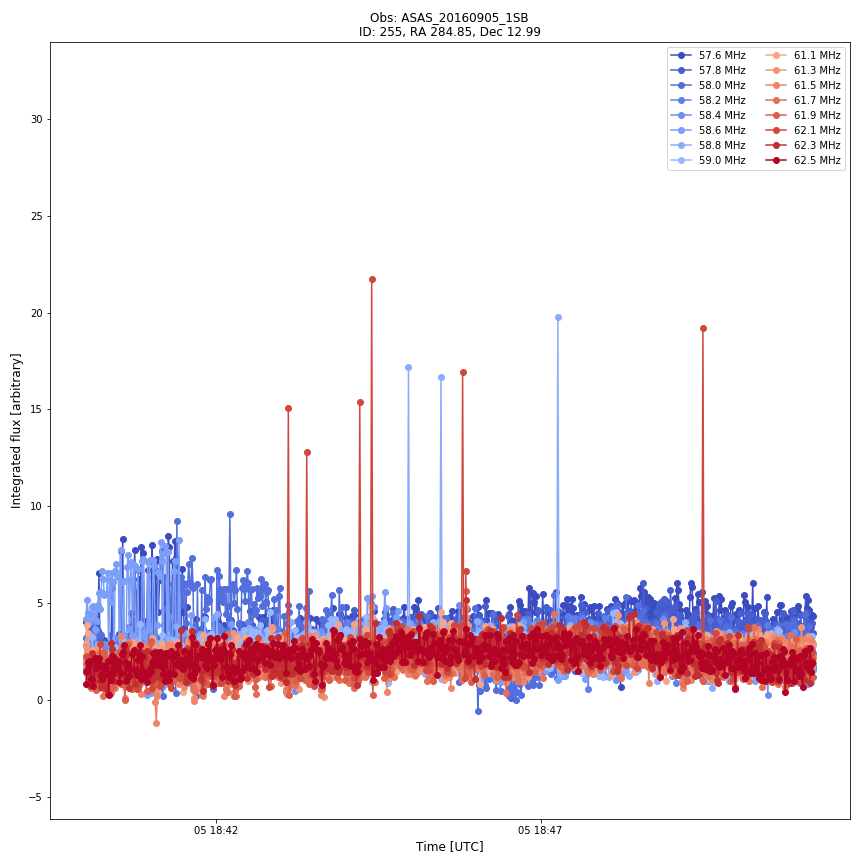

<IPython.core.display.Javascript object>


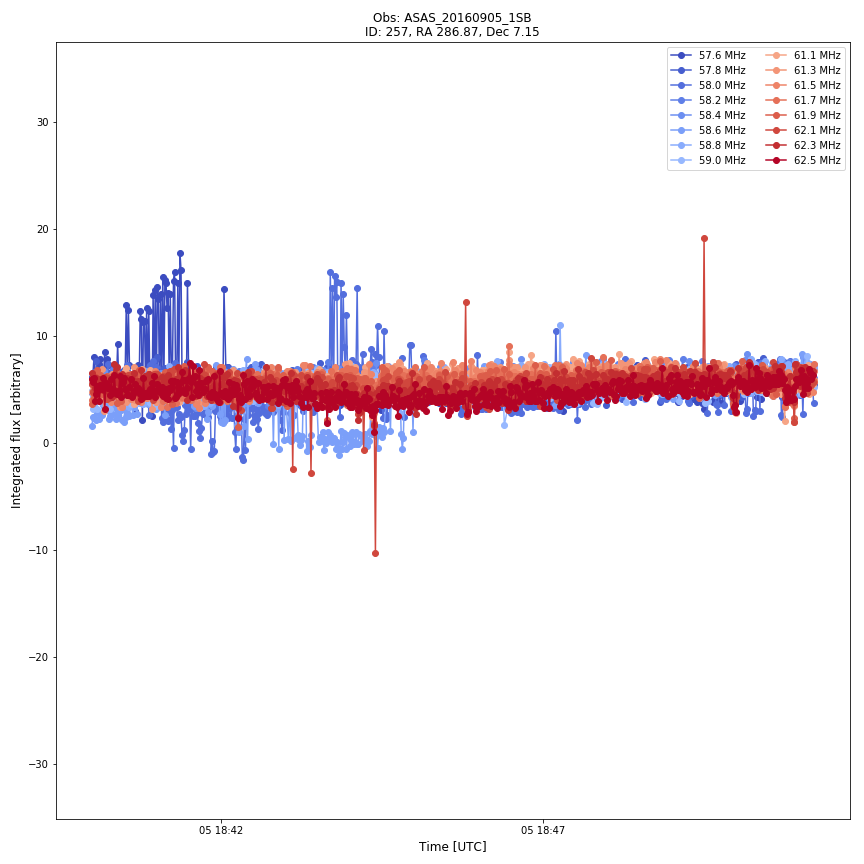

<IPython.core.display.Javascript object>


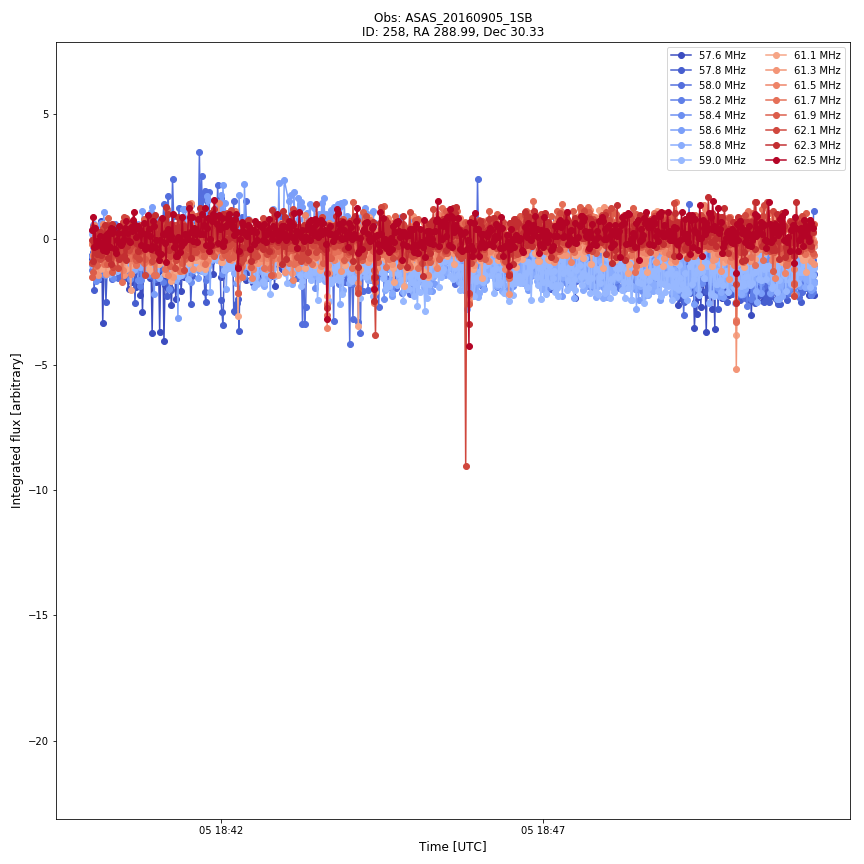

<IPython.core.display.Javascript object>


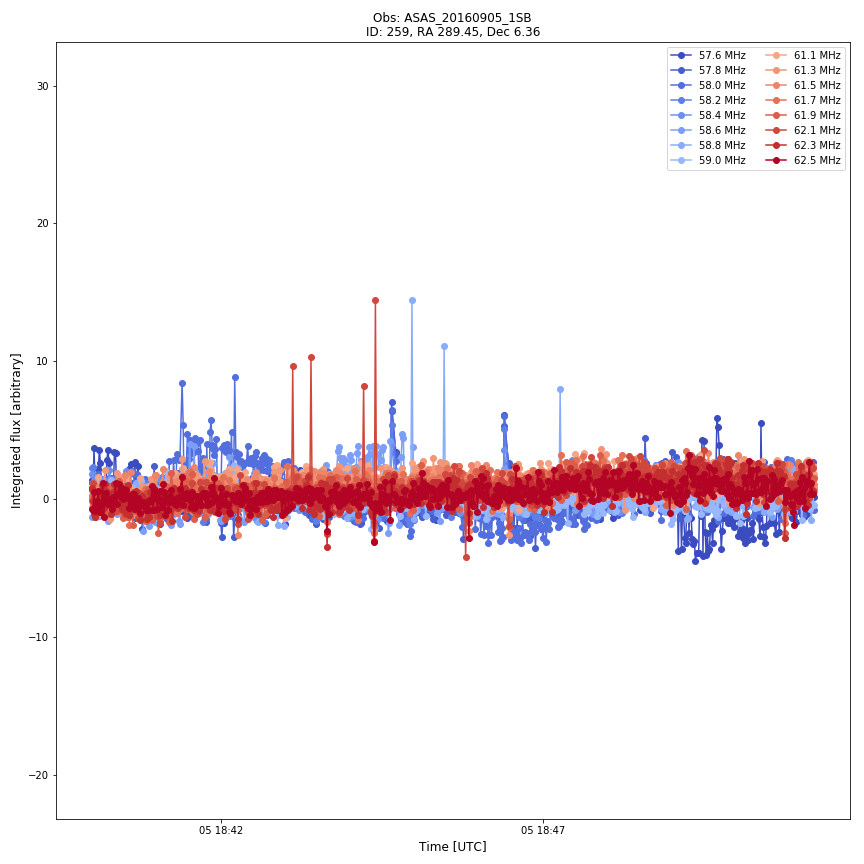

<IPython.core.display.Javascript object>


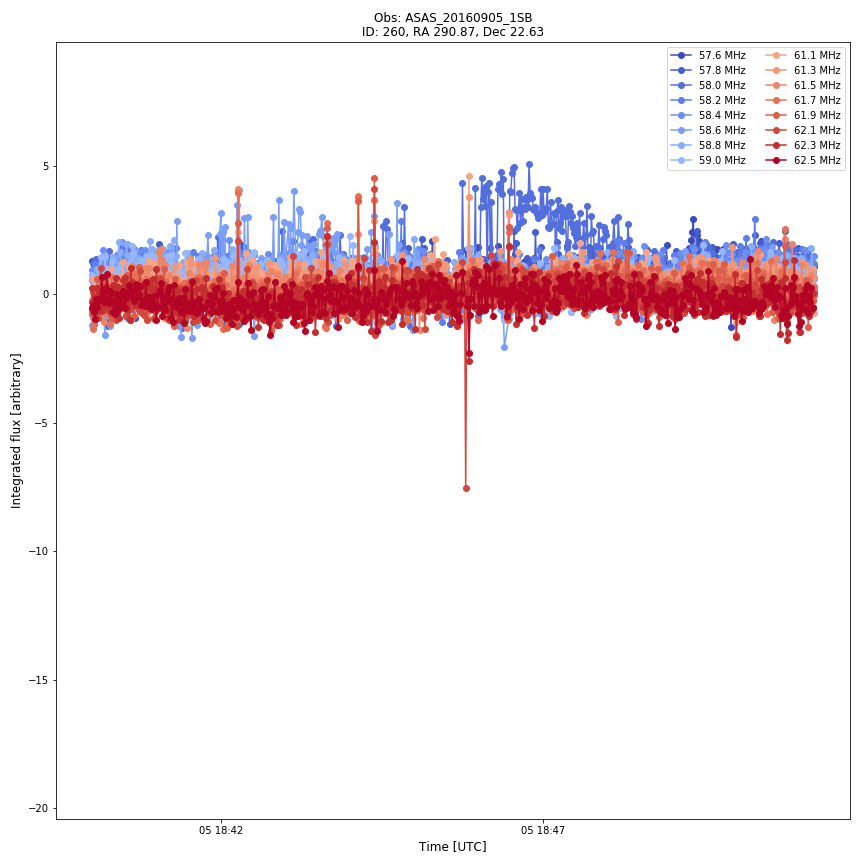

<IPython.core.display.Javascript object>


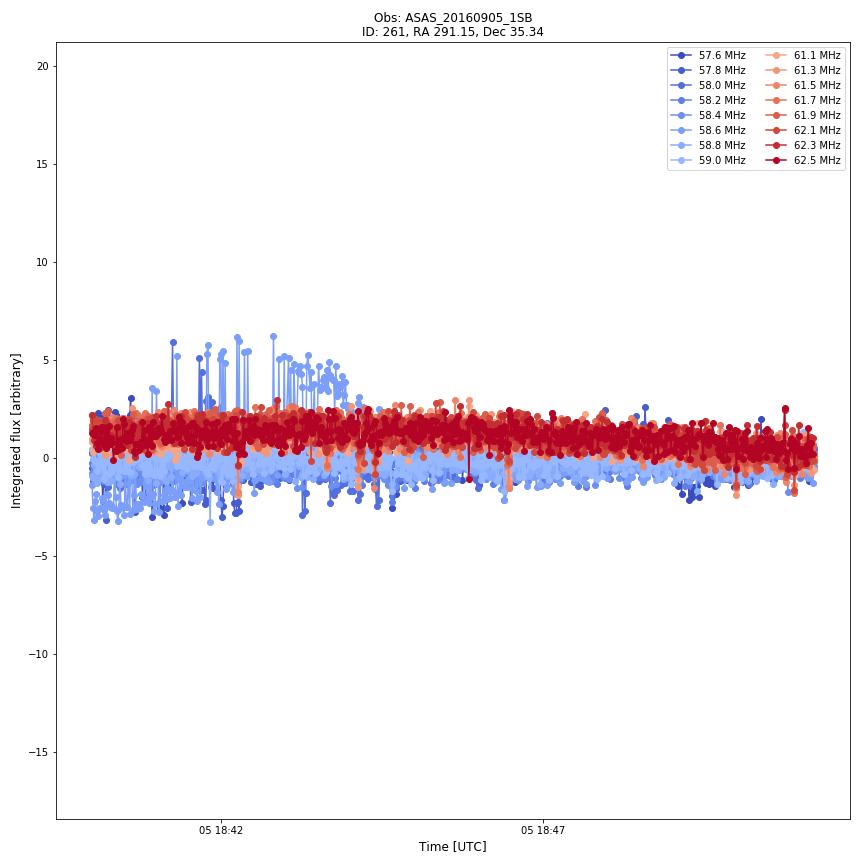

<IPython.core.display.Javascript object>


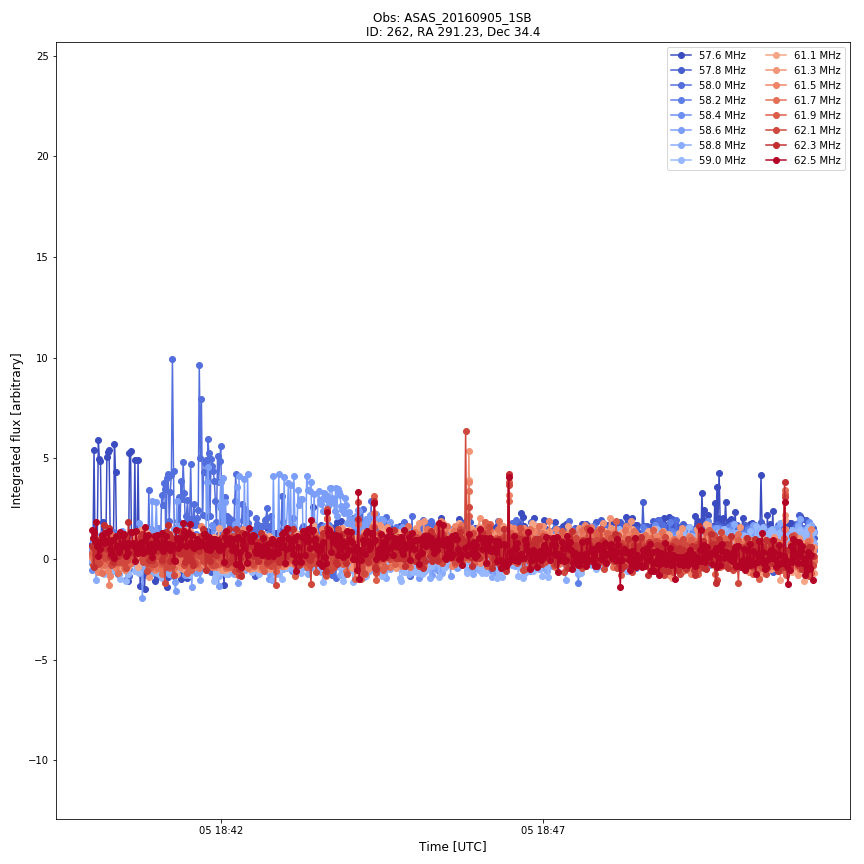

<IPython.core.display.Javascript object>


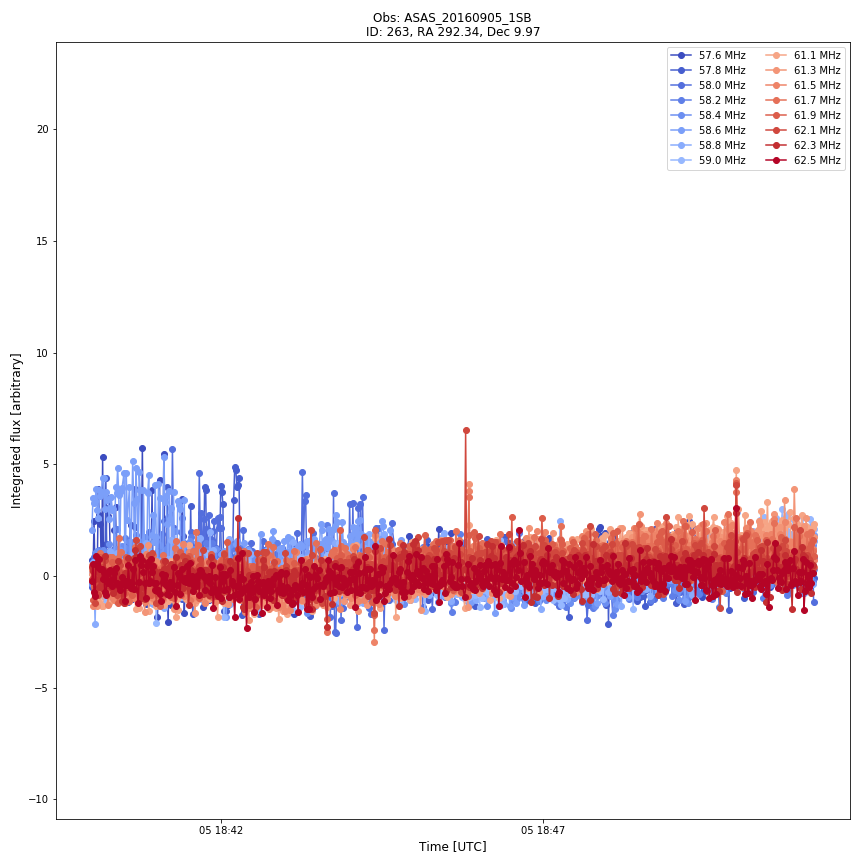

<IPython.core.display.Javascript object>


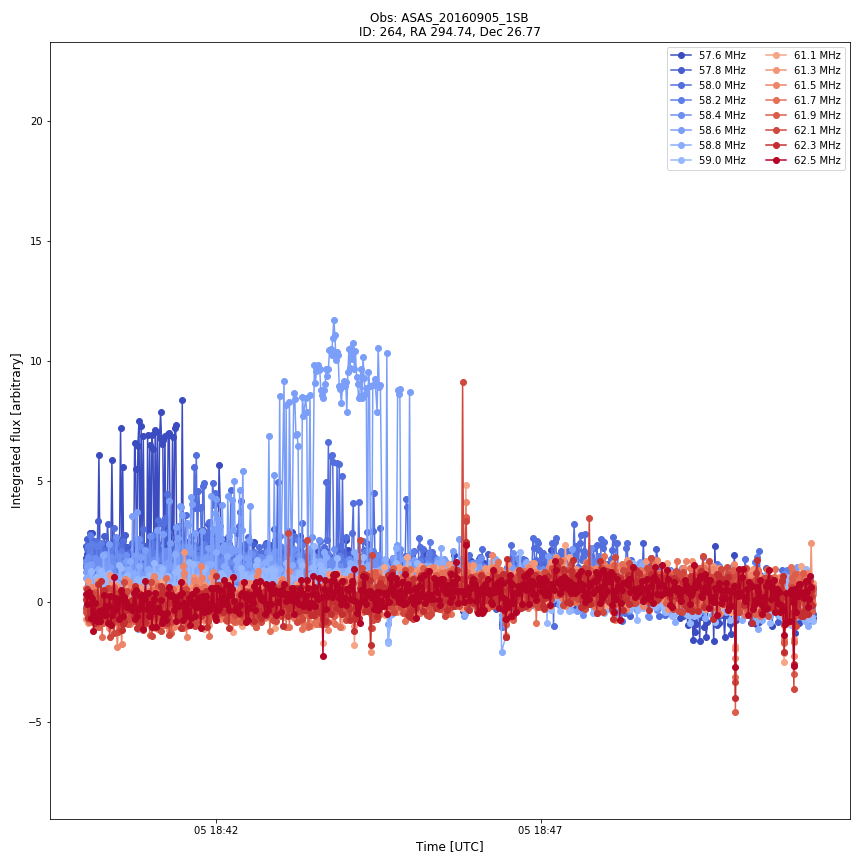

<IPython.core.display.Javascript object>


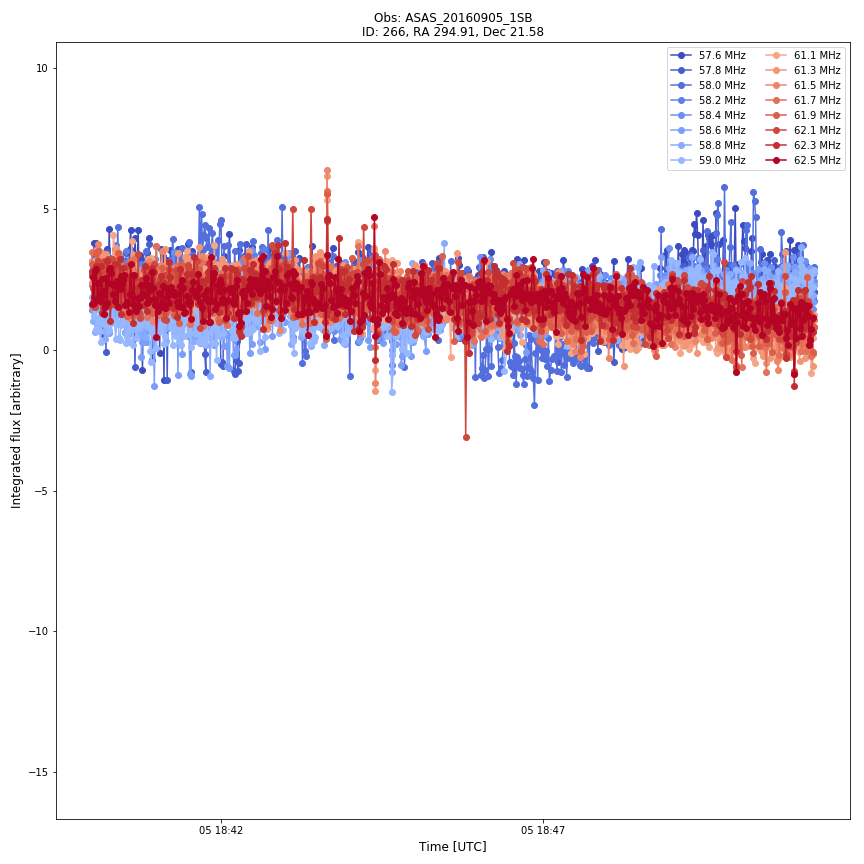

<IPython.core.display.Javascript object>


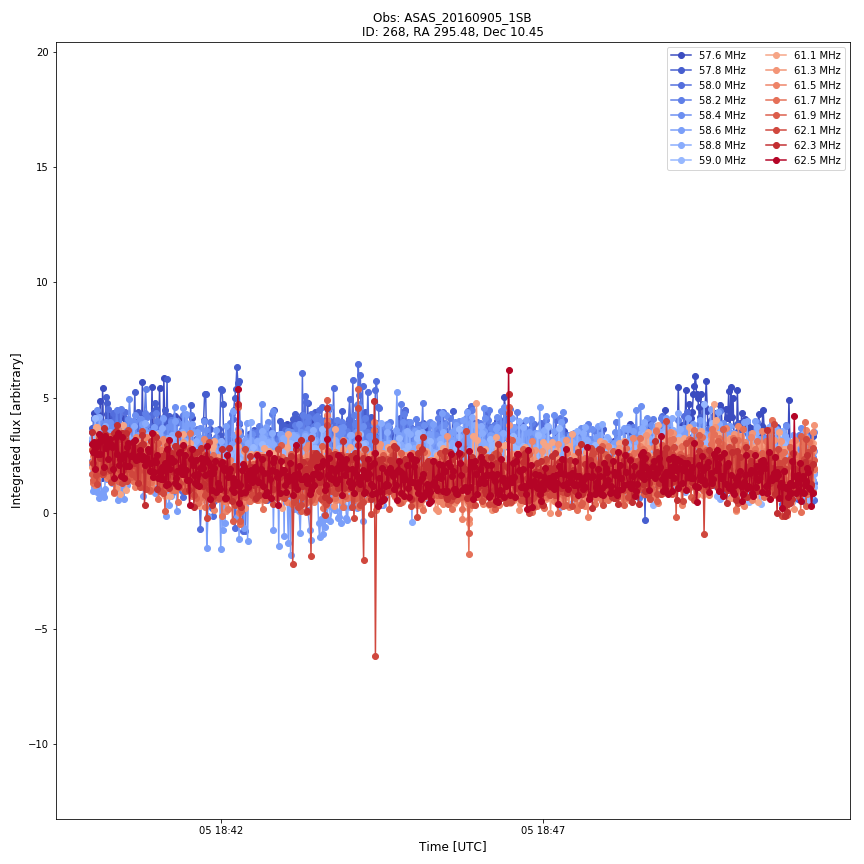

<IPython.core.display.Javascript object>


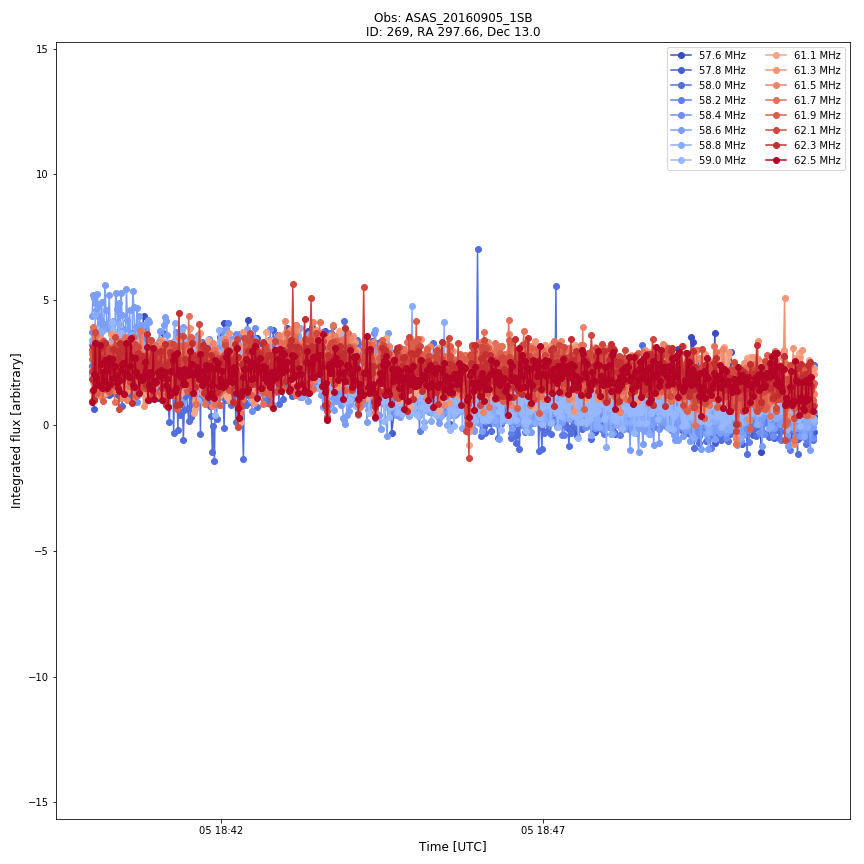

<IPython.core.display.Javascript object>


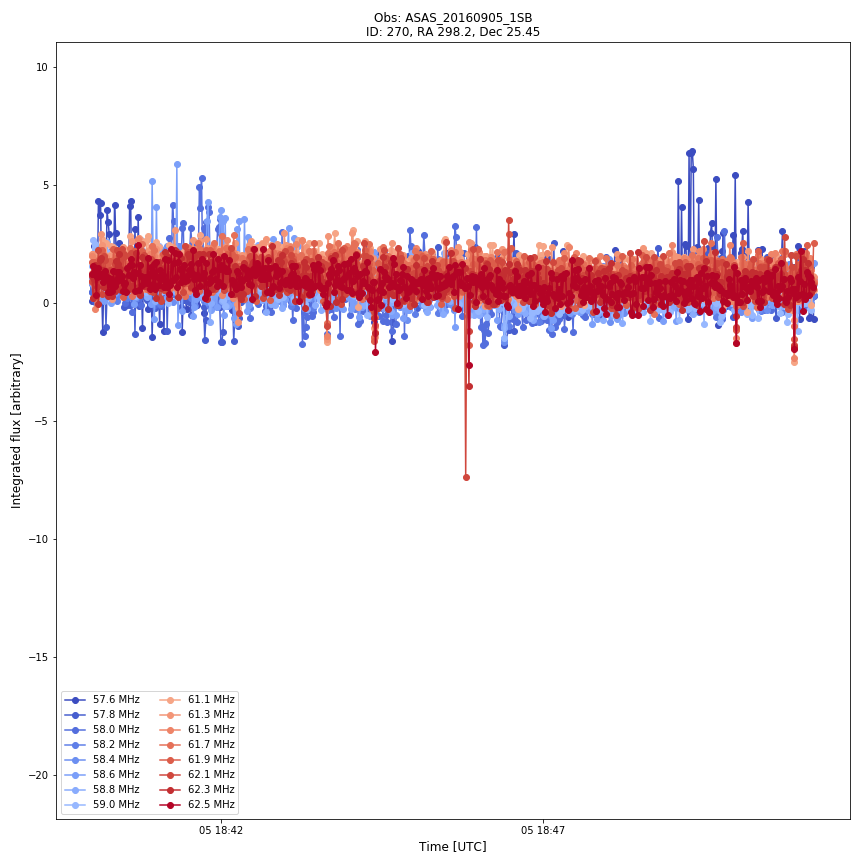

<IPython.core.display.Javascript object>


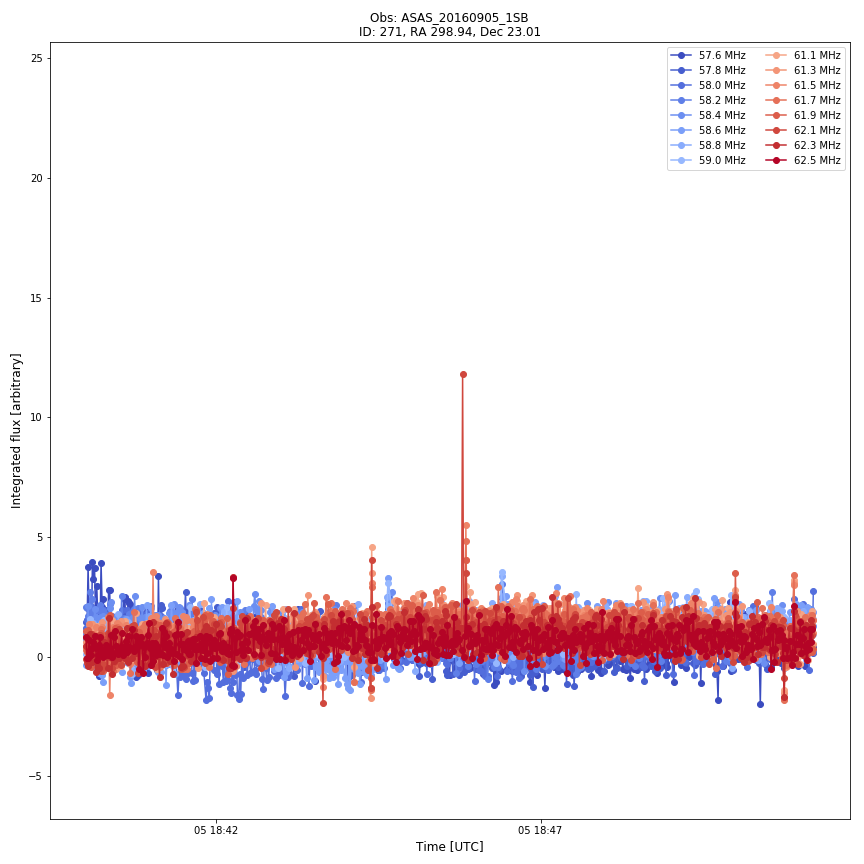

<IPython.core.display.Javascript object>


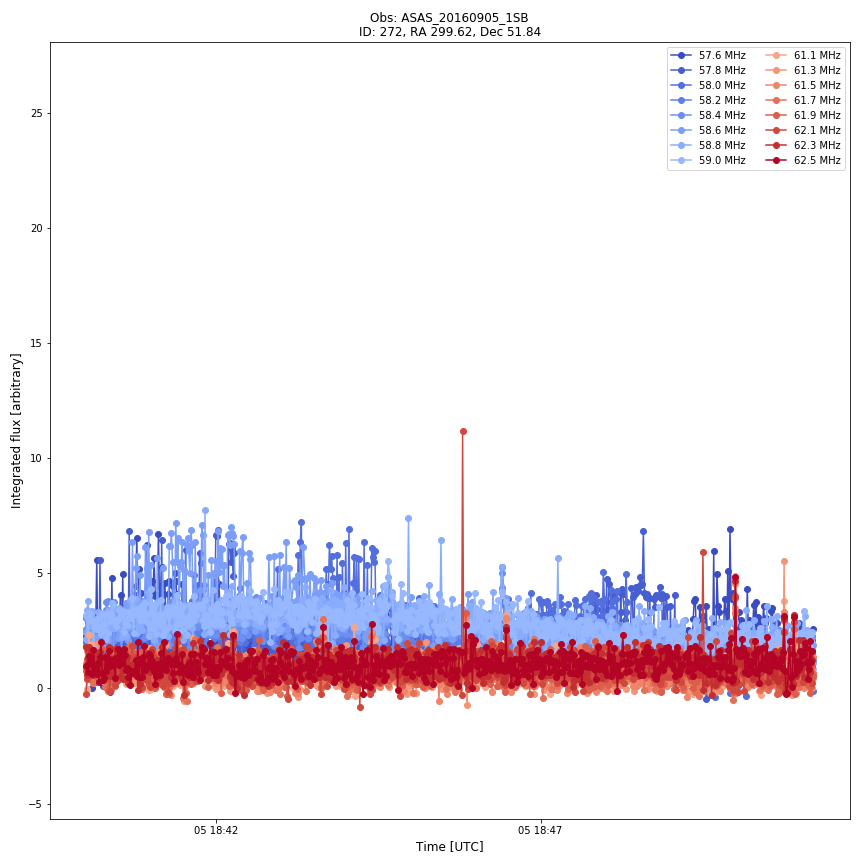

<IPython.core.display.Javascript object>


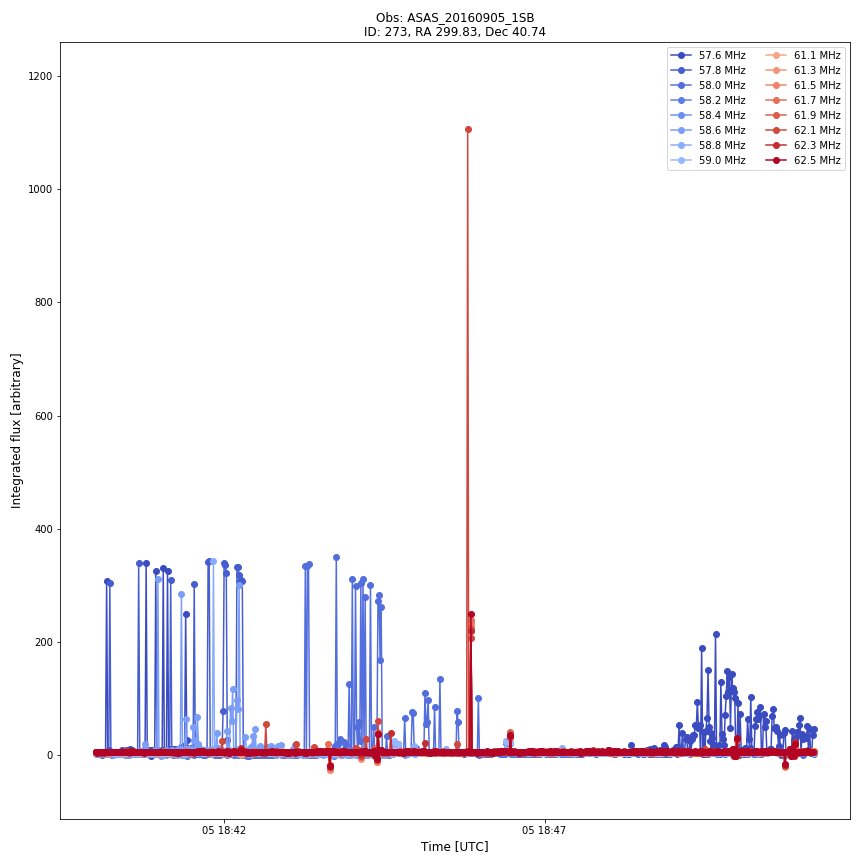

<IPython.core.display.Javascript object>


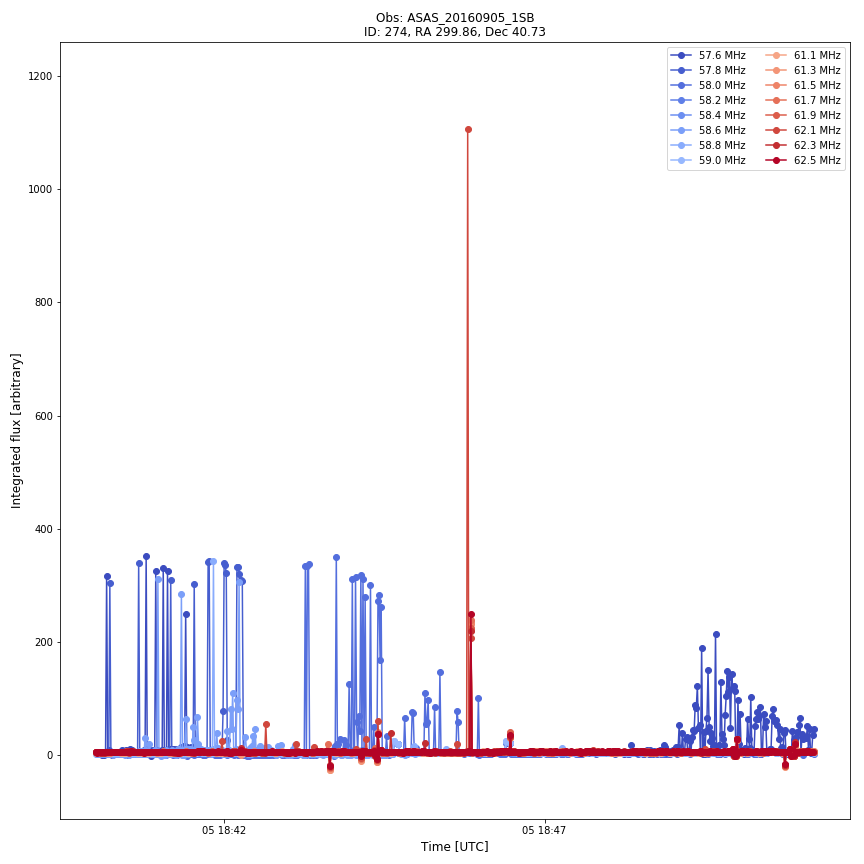

<IPython.core.display.Javascript object>


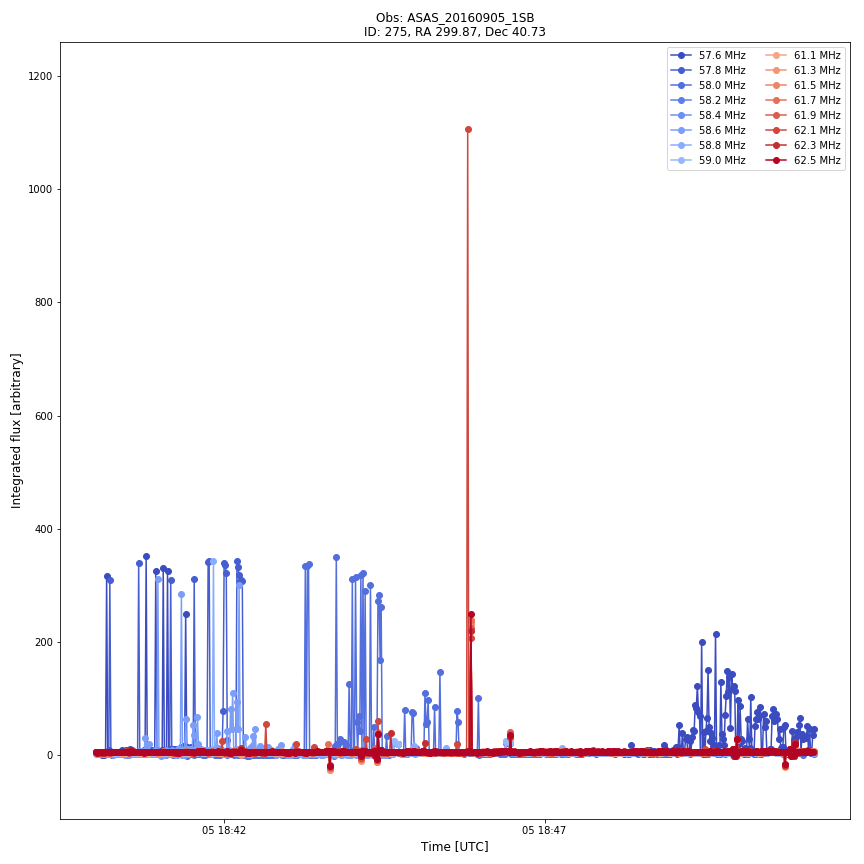

<IPython.core.display.Javascript object>


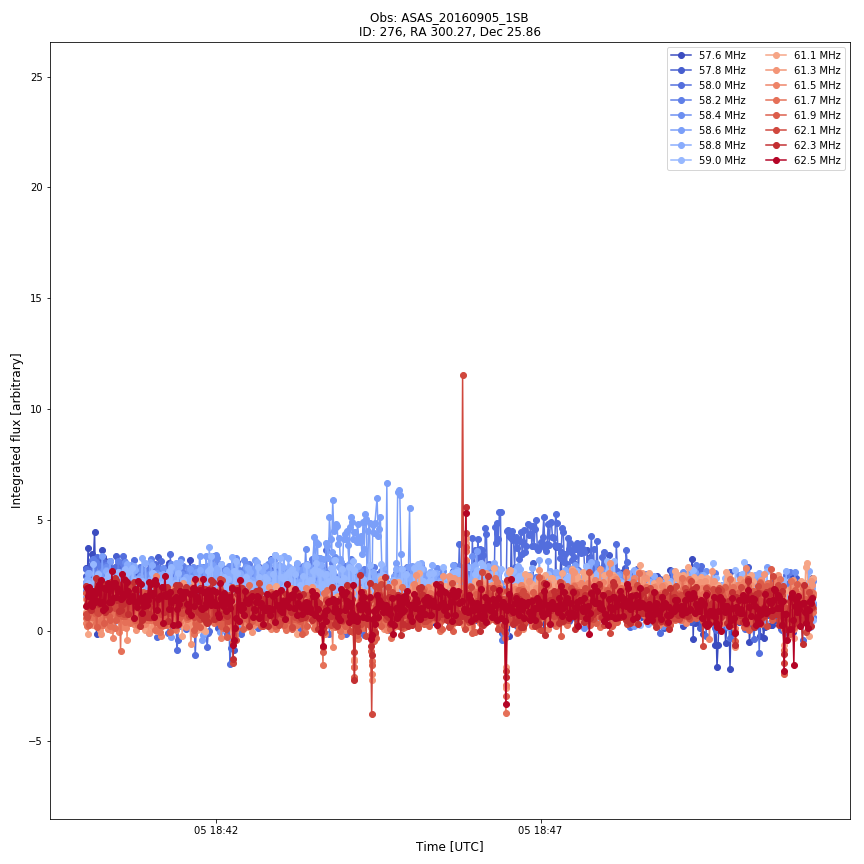

<IPython.core.display.Javascript object>


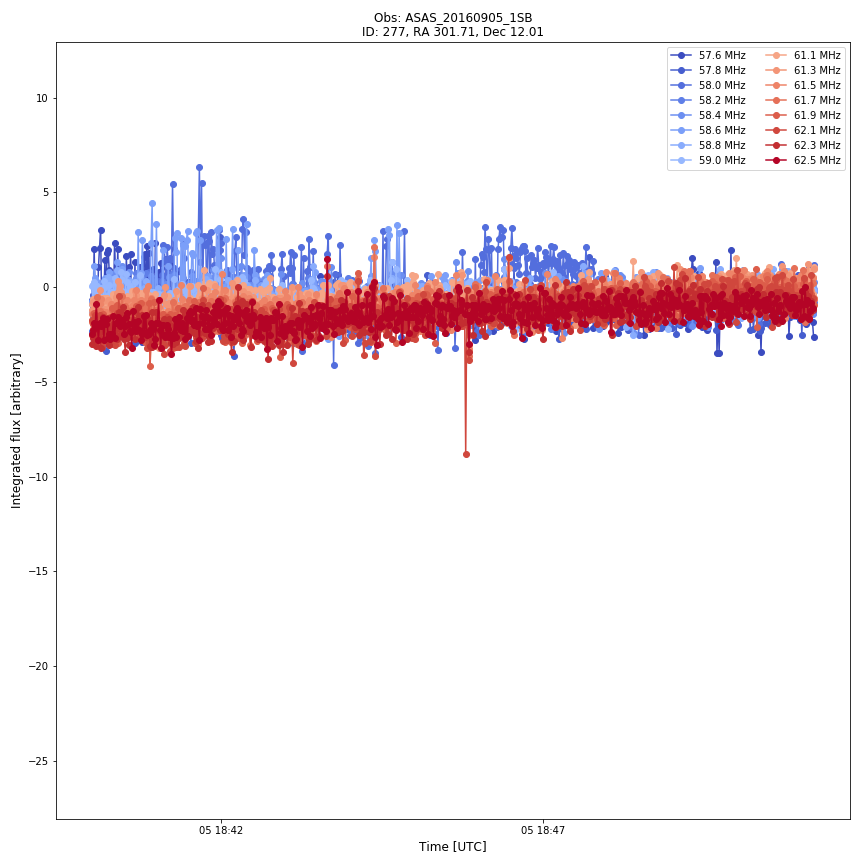

<IPython.core.display.Javascript object>


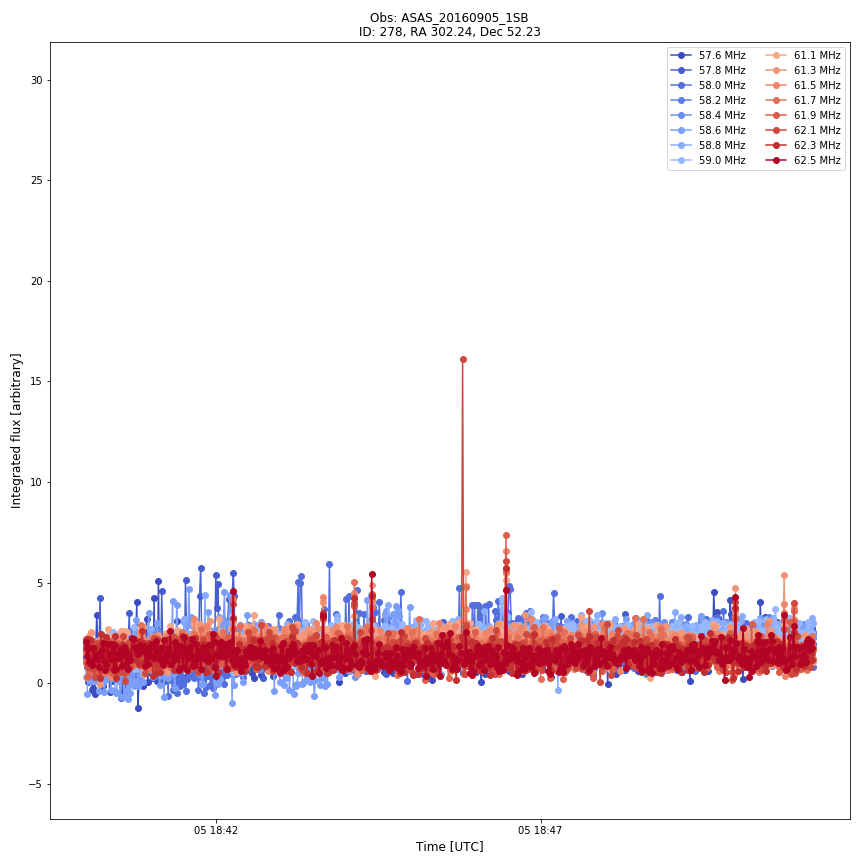

<IPython.core.display.Javascript object>


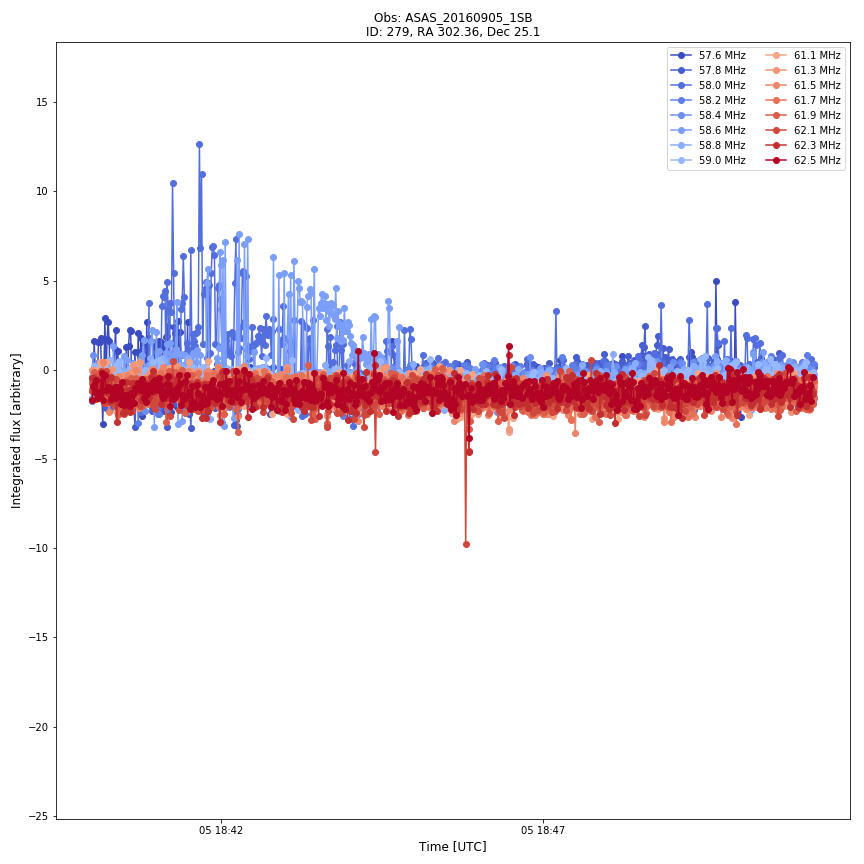

<IPython.core.display.Javascript object>


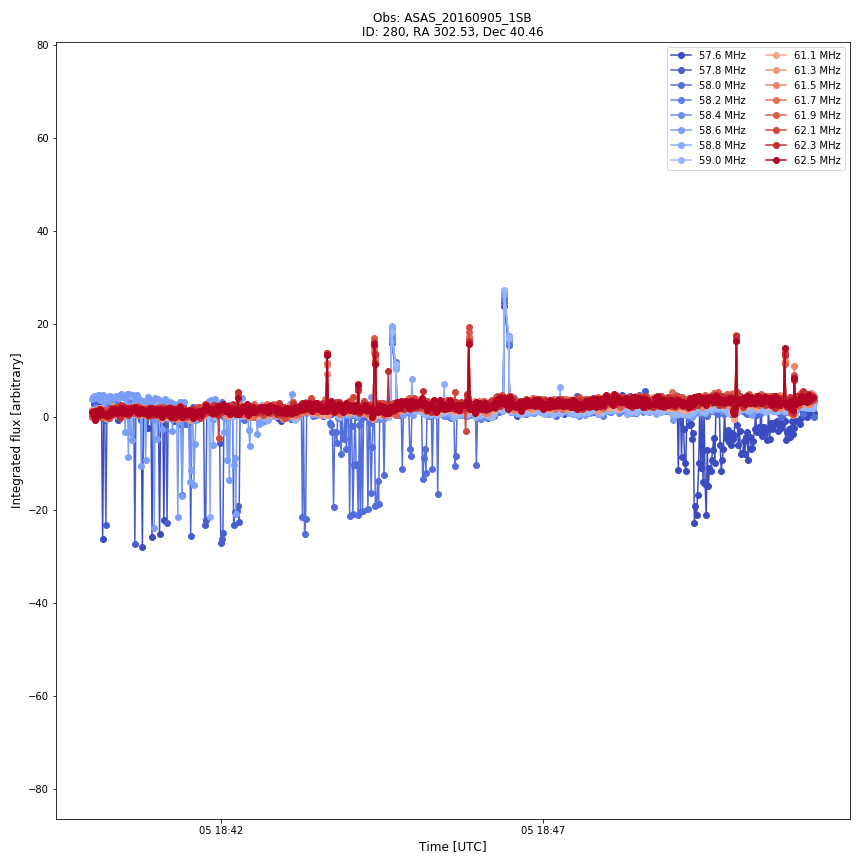

<IPython.core.display.Javascript object>


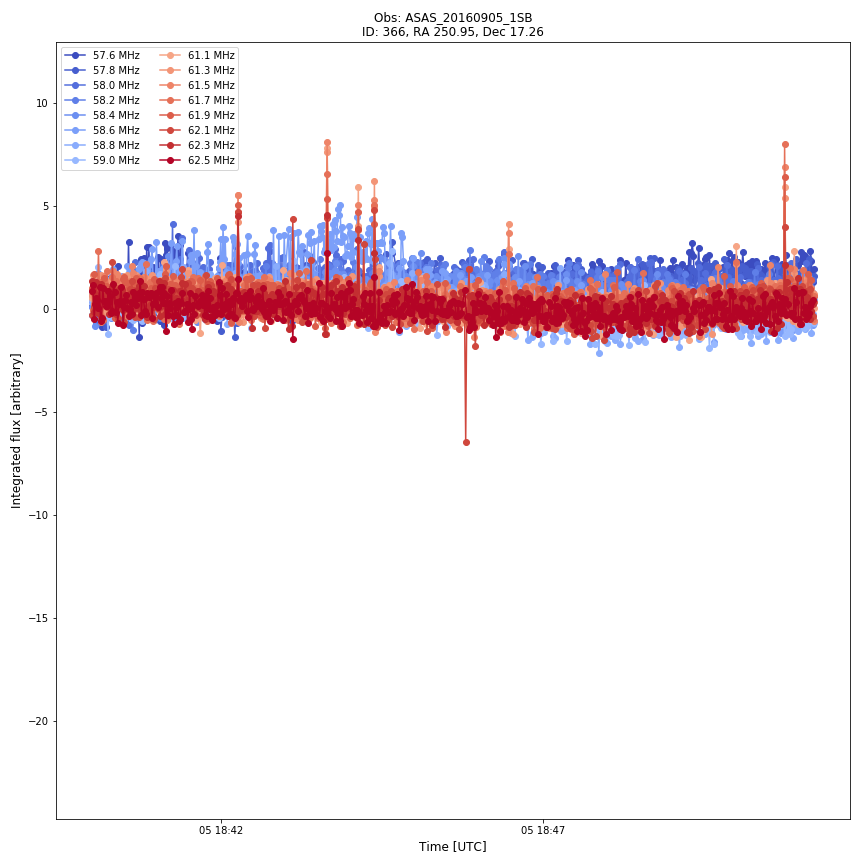

In [85]:
# for _ID in [17,2362, 2984,3622,3899,4452,3008]:#np.unique(data[data.extract_type == 2].runcatid):#pass_list:#AART_catsource.index:

%matplotlib notebook

plot_fig = 0
for _ID in IDS:

    source_df = retrieve_source(data, _ID)[1:]

    all_freq = np.unique(data.freq_eff)
    scaled_all_freq = (all_freq - all_freq.min()) / all_freq.ptp()
    colors = plt.cm.coolwarm(scaled_all_freq)

    plt.figure(plot_fig,figsize=(12,12))
#     plt.subplot(211)
    n_c = 0
    for freq in all_freq:

        _source_flux = source_df.f_int[(source_df.freq_eff == freq) ].values
        _index = source_df.extract_type[(source_df.freq_eff == freq) ].values
        _source_flux[(_index == 1)] = np.nan





        plt.errorbar(source_df.taustart_ts[(source_df.freq_eff == freq)].values,
                 _source_flux, 
                 yerr = source_df.f_int_err[(source_df.freq_eff == freq) ].values,
                 fmt="o-", color=colors[n_c],ecolor="white", label="{} MHz".format(round(freq/1e6,1)))
        n_c+=1

    #     del _source_flux

    #     if len(source_df.f_int_err[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values) > 0:
    #         plt.errorbar(source_df.taustart_ts[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values,
    #                      source_df.f_int[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values, 
    #                      yerr = source_df.f_int_err[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values,
    #                      fmt=".", color="C3",ecolor="C1", label="57.8 MHz, ff")

    plt.ylabel("Integrated flux [arbitrary]")
    plt.legend(ncol=2)

#     plt.subplot(212)

#     n_c = 0
#     for freq in all_freq:

#         _source_flux = source_df.f_int[(source_df.freq_eff == freq) ].values
#         _index = source_df.extract_type[(source_df.freq_eff == freq) ].values
#         _source_flux[(_index == 1)] = np.nan





#         plt.errorbar(source_df.taustart_ts[(source_df.freq_eff == freq)].values,
#                  _source_flux, 
#                  yerr = source_df.f_int_err[(source_df.freq_eff == freq) ].values,
#                  fmt="o-", color=colors[n_c],ecolor="white", label="{} MHz".format(round(freq/1e6,1)))
#         n_c+=1

#     #     del _source_flux

#     #     if len(source_df.f_int_err[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values) > 0:
#     #         plt.errorbar(source_df.taustart_ts[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values,
#     #                      source_df.f_int[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values, 
#     #                      yerr = source_df.f_int_err[(source_df.freq_eff == freq) & (source_df.extract_type == 1 )].values,
#     #                      fmt=".", color="C3",ecolor="C1", label="57.8 MHz, ff")


#     plt.legend(ncol=2)


#     plt.ylabel("Integrated flux [arbitrary]")
    plt.xlabel("Time [UTC]")




    plt.title("Obs: AS"+dbname+"\nID: "+str(_ID)+", RA "+str(round(source_df.ra.mean(),2))+", Dec "+str(round(source_df.decl.mean(),2)))

    plt.tight_layout()

    plot_fig +=1
plt.show()

In [72]:
for freq in all_freq:
#     print str(freq)[:2]+"."+str(freq)[3:5]
    print 

57.62
57.81
58.01
58.2
58.4
58.59
58.79
58.98
61.13
61.33
61.52
61.72
61.91
62.11
62.3
62.5


In [189]:
if os.path.isfile(source_df[ source_df.f_int == source_df.f_int.max()].url[0]):
    print source_df[ source_df.f_int == source_df.f_int.max()].url.values
    
else: 
    filename = "/mnt/ais001/"+source_df[ source_df.f_int == source_df.f_int.max()].url[0].split("/")[2]+"/"+source_df[ source_df.f_int == source_df.f_int.max()].url[0].split("/")[3]
print "/mnt/ais001/AS"+dbname+"/"+os.path.basename(source_df[ source_df.f_int == source_df.f_int.max()].url[0])

[u'/data/AS_20160831/2016-08-31T17:21:00-S314-B8.fits']
/mnt/ais001/AS_20160831/2016-08-31T17:21:00-S314-B8.fits
/mnt/ais001/AS_201608311510/2016-08-31T17:21:00-S314-B8.fits


<IPython.core.display.Javascript object>


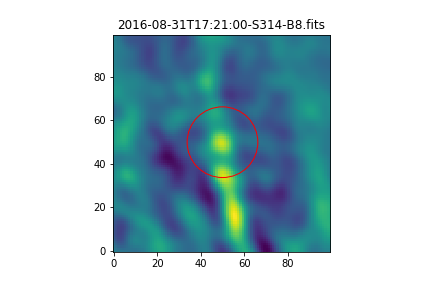

<IPython.core.display.Javascript object>


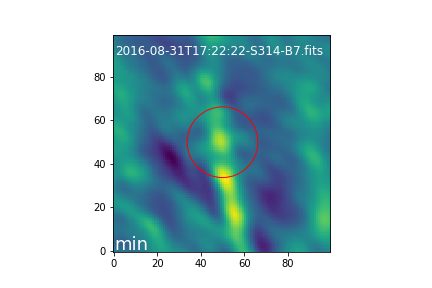

In [157]:
# ls /data/AS_20160831/2016-08-31T17:21:00-S314-B8.fits


# pos = [185,550] # X, Y pixel coordinates of the transient candidate
delta = 100       

if  os.path.isfile(source_df[ source_df.f_int == source_df.f_int.max()].url[0]):
    filename = source_df[ source_df.f_int == source_df.f_int.max()].url[0]
# filename = "/data/AS_20160831/2016-08-31T17:21:00-S314-B8.fits"

wcs = WCS(filename)
im_pix_x, im_pix_y, n, nn = wcs.wcs_world2pix(source_df.ra.mean(),source_df.decl.mean(),1,1,1)

pos = [im_pix_x, im_pix_y]

plt.figure()
plt.title(os.path.basename(filename))


plt.imshow(fits.open(filename)[0].data[0,0,pos[1]-delta/2:pos[1]+delta/2,pos[0]-delta/2:pos[0]+delta/2], origin="lower")
plt.scatter(delta/2,delta/2, s=50*delta, facecolor="none", edgecolor="red")
plt.show()


if  os.path.isfile(source_df[ source_df.f_int == source_df.f_int.min()].url[0]):
    filename = source_df[ source_df.f_int == source_df.f_int.min()].url[0]
# filename = "/data/AS_20160831/2016-08-31T17:21:00-S314-B8.fits"

wcs = WCS(filename)
im_pix_x, im_pix_y, n, nn = wcs.wcs_world2pix(source_df.ra.mean(),source_df.decl.mean(),1,1,1)

pos = [im_pix_x, im_pix_y]

plt.figure()
plt.text(0.5,90,os.path.basename(filename), color="white", fontsize=12)
plt.text(0.5,0.5,"min", color="white", fontsize=18)
plt.imshow(fits.open(filename)[0].data[0,0,pos[1]-delta/2:pos[1]+delta/2,pos[0]-delta/2:pos[0]+delta/2], origin="lower")
plt.scatter(delta/2,delta/2, s=50*delta, facecolor="none", edgecolor="red")
plt.show()

In [138]:
img, header = fits.getdata(filename, header=True)
print img[0,0,pos[1]-delta/2:pos[1]+delta/2,pos[0]-delta/2:pos[0]+delta/2]

[[ -4.79261018e-03  -1.50645173e+00  -2.39442468e+00 ...,   1.57047665e+00
    2.57747650e+00   3.18505788e+00]
 [ -5.90616941e-01  -2.19696617e+00  -3.29208517e+00 ...,   3.03282452e+00
    3.93019247e+00   4.33185387e+00]
 [ -1.49573243e+00  -3.13566661e+00  -4.35017729e+00 ...,   4.82088614e+00
    5.53475952e+00   5.66805744e+00]
 ..., 
 [  1.43553138e-01  -1.66357279e+00  -3.15295982e+00 ...,  -6.84194863e-01
   -1.29235566e+00  -2.00983000e+00]
 [ -3.15524042e-01  -1.96689248e+00  -3.30843973e+00 ...,  -2.09666038e+00
   -2.63385582e+00  -3.19826460e+00]
 [ -5.43451607e-01  -1.98743010e+00  -3.15918112e+00 ...,  -2.99447131e+00
   -3.37953472e+00  -3.75283933e+00]]


In [142]:
header

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                  -32 / number of bits per data pixel                  
NAXIS   =                    4 / number of data axes                            
NAXIS1  =                 1024 / length of data axis 1                          
NAXIS2  =                 1024 / length of data axis 2                          
NAXIS3  =                    1 / length of data axis 3                          
NAXIS4  =                    1 / length of data axis 4                          
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
AUTHOR  = 'https://github.com/transientskp/aartfaac-imaging-pipeline'           
REFERENC= 'http://aartfaac.org/'                                                
BZERO   =                   

In [8]:
vlssr_gt_10 = pd.read_csv("/home/kuiack/VLSSr_gt_10.csv")

f= open("/home/kuiack/VLSSr_monitor.json","w+")
f.write("[")
for i in range(len(vlssr_gt_10)):
    f.write("[{}, {}], \n".format(vlssr_gt_10["_RAJ2000"].values[i],
                                vlssr_gt_10["_DEJ2000"].values[i]))
    
f.write("]")
f.close()

In [ ]:
vlssr_gt_10 = pd.read_csv("/home/kuiack/VLSSr_gt_10.csv")



In [9]:
monitor_coords = []
for i in range(len(vlssr_gt_10)):
    monitor_coords.append([vlssr_gt_10["_RAJ2000"].values[i],
                           vlssr_gt_10["_DEJ2000"].values[i]])


In [8]:
import json
monitor_coords = [[148.56,7.66],
                  [147.14,7.18],
                  [148.26,-0.17],
                  [152.18,7.39],
                  [153.00,6.18],
                  [144.42,4.35],
                  [146.24,9.42],
                  [145.76,13.47],
                  [147.76,14.09],
                  [151.22,14.73],
                  [150.90,9.87],
                  [150.65,3.71],
                  [145.077,0.85],
                  [142.10,9.10],
                  [146.98,18.13]
                 ]

with open('/home/kuiack/PRS_monitor.json','w') as outfile:
    json.dump(monitor_coords,outfile)

In [9]:
with open('/home/kuiack/PRS_monitor.json','w') as outfile:
    json.dump(monitor_coords,outfile)

In [ ]:
def output_batch(self, batch):
    json_file = open('/home/kuiack/VLSSr_monitor.json','w')
    json.dumps(batch, json_file, sort_keys = True, 
               indent = 4, separators = (',', ': '))
    json_file.close()


<IPython.core.display.Javascript object>


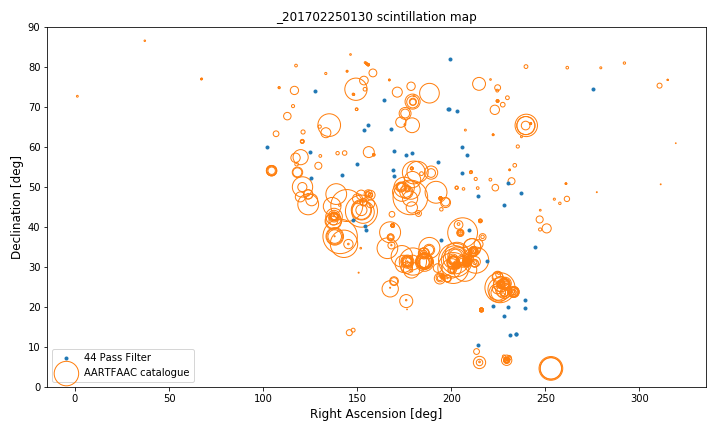

In [15]:
plt.figure(figsize=(10,6))
plt.title(dbname+" scintillation map")

plt.scatter(AART_catsource.ra.astype(float),AART_catsource.decl.astype(float),
            edgecolor="C1", facecolor="none",
            s=1e4*AART_catsource.eta_int.astype(float)/AART_catsource.f_datapoints.astype(float), 
            label="AARTFAAC catalogue")

plt.plot(_filtered.ra,
         _filtered.decl,
         ".", label="{} Pass Filter".format(len(_filtered)))

plt.ylim([0,90])
plt.ylabel("Declination [deg]")
plt.xlabel("Right Ascension [deg]")
plt.legend()
plt.tight_layout()

# plt.savefig("lalala.png")

In [68]:
plt.figure(figsize=(12,8))
plt.title(dbname)
plt.scatter(AART_catsource.ra.astype(float),AART_catsource.decl.astype(float),
            edgecolor="C1", facecolor="none",
            s=np.abs(AART_catsource.v_int[(AART_catsource.freq_eff > 60000000)].astype(float)-\
                    AART_catsource.v_int[(AART_catsource.freq_eff < 60000000)].astype(float))/\
            len(AART_catsource.v_int[(AART_catsource.freq_eff < 60000000)].astype(float)), label="AARTFAAC catalogue")

plt.plot(_filtered.ra,
         _filtered.decl,
         ".", label="{} Pass Filter".format(len(_filtered)))

plt.ylim([0,90])

SyntaxError: invalid syntax (<ipython-input-68-fc18f65c95ab>, line 9)

In [80]:


ra_s = []
decl_s = [] 
sizes_s = []


for i in AART_catsource.index:
    source_df = retrieve_source(data, i)
    
    ra_s.append(np.mean(source_df.ra))
    decl_s.append(np.mean(source_df.decl))
    sizes_s.append(np.abs(np.mean(source_df.v_int[(source_df.freq_eff < 60000000)])-\
    np.mean(source_df.v_int[(source_df.freq_eff > 60000000)]))/len(source_df))
    


In [23]:
x,y = np.meshgrid(np.linspace(0,360,361), np.linspace(0,90,91))

<IPython.core.display.Javascript object>


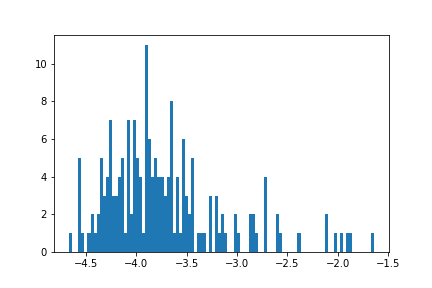

In [29]:
plt.figure()
x = plt.hist(np.log10(AART_catsource.eta_int.astype(float)/AART_catsource.f_datapoints.astype(float)),bins=100)
plt.show()

In [30]:
f = sp.interpolate.interp2d(AART_catsource.ra.astype(float),
                            AART_catsource.decl.astype(float),
                            np.log10(AART_catsource.eta_int.astype(float)/AART_catsource.f_datapoints.astype(float)))

In [26]:
xgrid,ygrid = np.meshgrid(np.linspace(0,360,361), np.linspace(0,90,91))

f = sp.interpolate.griddata((AART_catsource.ra.astype(float),AART_catsource.decl.astype(float)),
                        np.log10(AART_catsource.eta_int.astype(float)/AART_catsource.f_datapoints.astype(float)),
                        (xgrid, ygrid), method="linear")

<IPython.core.display.Javascript object>


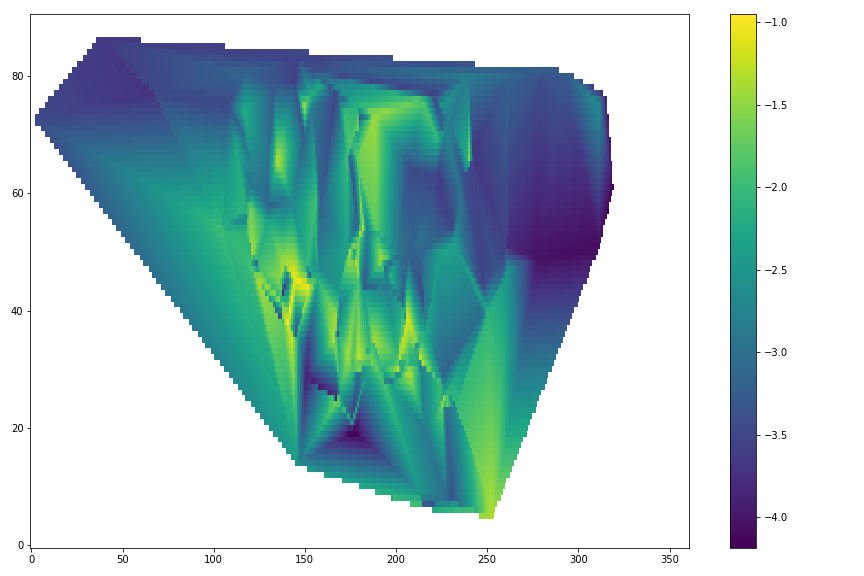

In [28]:

plt.figure(figsize=(12,8))
plt.imshow(f, origin="lower", aspect="auto")
plt.colorbar()
plt.tight_layout()

In [55]:
data.drop(data.index[[data[data.taustart_ts.diff() > datetime.timedelta(seconds=24*3600)].index.values]])

IndexError: index 1987188 is out of bounds for axis 1 with size 1986445

In [63]:
data = data[data.taustart_ts.diff() < datetime.timedelta(seconds=24*3600)]

In [59]:
data

,band,decl,decl_err,det_sigma,eta_int,extract_type,f_datapoints,f_int,f_int_err,f_peak,...,ra_err,rms_max,rms_min,runcatid,tau_time,taustart_ts,url,v_int,xtrsrc,round_times
0,23,39.847170,0.115050,6.420000,0.000000,0,1,99.795892,28.494656,97.083872,...,0.122377,26.355273,2.325151,1,5351.0,2016-08-31 14:35:37,/data/AS_20160831/2016-08-31T16:04:47-S314-B8....,0.000000,1,2016-08-31 16:04:47
1,24,40.044715,0.071138,7.242751,0.845428,0,5856,65.842888,16.575692,64.451933,...,0.111756,59.499602,2.111000,1,1.0,2016-08-31 17:41:39,/data/AS_20160831/2016-08-31T17:41:39-S296-B8....,26.512040,1071835,2016-08-31 17:41:39
2,23,39.981747,0.120755,6.166293,0.610135,0,2,72.245794,20.785922,70.252347,...,0.127385,40.993483,2.022061,1,1.0,2016-08-31 15:53:16,/data/AS_20160831/2016-08-31T15:53:16-S314-B8....,0.226467,261143,2016-08-31 15:53:16
3,24,40.032171,0.066771,7.495048,0.854840,0,5620,69.592096,16.669294,68.261172,...,0.106208,108.225166,2.650415,1,1.0,2016-08-31 17:37:40,/data/AS_20160831/2016-08-31T17:37:40-S296-B8....,25.971640,1046866,2016-08-31 17:37:40
4,24,39.759201,0.088737,8.042342,0.196372,0,882,80.916330,18.420374,79.518548,...,0.097990,26.465464,2.428512,1,1.0,2016-08-31 16:13:10,/data/AS_20160831/2016-08-31T16:13:10-S296-B7....,0.112034,401372,2016-08-31 16:13:10
5,23,40.064256,0.055322,9.683947,1.348259,0,6113,87.793737,17.252942,86.663573,...,0.087245,51.278017,2.423449,1,1.0,2016-08-31 17:39:58,/data/AS_20160831/2016-08-31T17:39:58-S314-B8....,22.987627,1060718,2016-08-31 17:39:58
6,23,39.837321,0.078387,9.572837,0.379091,0,1002,104.157187,20.987757,102.747504,...,0.086745,18.466919,2.535570,1,1.0,2016-08-31 16:13:10,/data/AS_20160831/2016-08-31T16:13:10-S314-B8....,22.681483,401400,2016-08-31 16:13:10
7,24,39.995644,0.065523,8.035712,0.844901,0,5864,73.536824,17.020039,72.223732,...,0.102725,66.112598,2.547861,1,1.0,2016-08-31 17:41:47,/data/AS_20160831/2016-08-31T17:41:47-S296-B8....,26.530165,1072671,2016-08-31 17:41:47
8,24,39.804402,0.084263,8.511717,0.196149,0,883,84.254883,18.239637,82.938700,...,0.093188,15.788076,2.296240,1,1.0,2016-08-31 16:13:11,/data/AS_20160831/2016-08-31T16:13:11-S296-B7....,0.111973,401477,2016-08-31 16:13:11
9,23,40.038180,0.051745,10.109951,1.243351,0,5861,99.688069,18.592305,98.532218,...,0.082691,55.937184,2.623362,1,1.0,2016-08-31 17:35:44,/data/AS_20160831/2016-08-31T17:35:44-S314-B8....,24.034720,1036298,2016-08-31 17:35:44


In [60]:
Znew = f(np.linspace(0,360,361), np.linspace(0,90,91))

TypeError: 'numpy.ndarray' object is not callable

In [67]:
np.mean(AART_catsource.v_int[(AART_catsource.freq_eff > 60000000)].astype(float).values)-\
                    np.mean(AART_catsource.v_int[(AART_catsource.freq_eff < 60000000)].astype(float).values)

-0.2017696416111629

In [64]:
(AART_catsource.v_int[(AART_catsource.freq_eff < 60000000)].astype(float).values)

array([  0.13682315,  17.23344054,   0.18759333,   0.2939002 ,
         0.13851679,   0.39836744,   0.50643938,   0.59556121,
         0.3889377 ,   0.48075452,   0.42587194,   0.39327938,
        23.40820278,   0.41762283,   0.38506442,   0.67113794,
         0.44400884,   0.47311735,   0.56711538,   0.46625962,
         0.4631447 ,   0.49137473,   0.25801539,   0.51532975,
         0.58167894,  -9.51314549,   0.53851688,   0.53227255,
         0.29546436,  11.72601232,   0.4352013 ,   0.2712176 ,
         0.31559421,   0.23470539,  -8.33663335,   0.33251272,
         0.48684133,   0.75884434,   0.14661773,   0.81990335,
         0.37635575,   0.66386845,   0.40593841,   0.62775116,
         0.50753966,   0.45378027,   0.37301603,   0.82966553,
         0.41994509,   0.36377781,   0.4064828 ,   0.68262676,
         0.46669705,   0.11636343,   4.06154764,   0.46359024,
         6.85564904,   0.25779232,   0.388417  ,   0.37427158,
         0.41844982,   0.42870986,   0.7395193 ,   0.63

### Map compare

In [ ]:
skymap =  "/home/kuiack/skymaps/S298_512_map.fits"


In [80]:
plot_lightcurve(data,641)

AttributeError: 'DataFrame' object has no attribute 'wm_ra'

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT
/home/kuiack/skymaps/S332_512_map.fits
141.908574974 52.9791852204


<IPython.core.display.Javascript object>


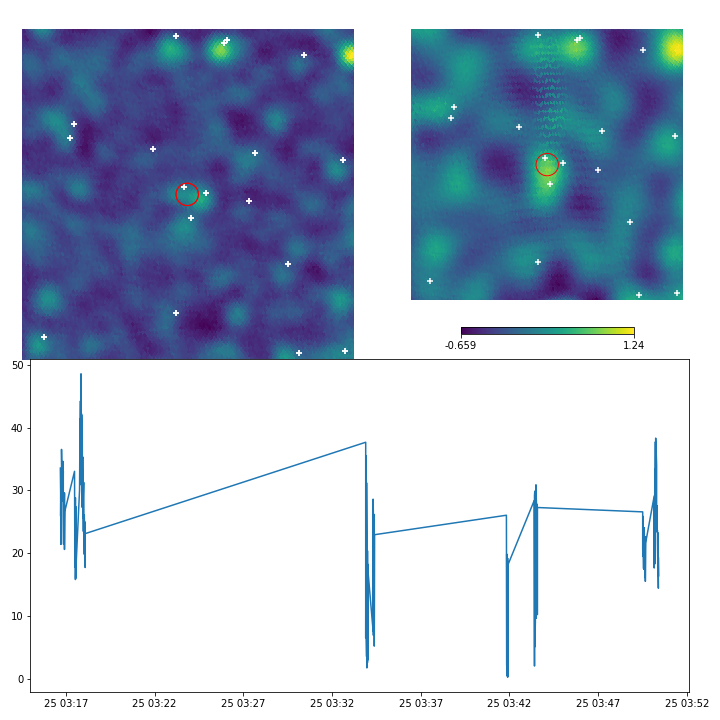

NSIDE = 512
ORDERING = RING in fits file
INDXSCHM = IMPLICIT


In [90]:

def twoD_Gaussian(xdata_tuple, amplitude, xo, yo, sigma, offset):
    theta = 0
    (x, y) = xdata_tuple
    xo = float(xo)
    yo = float(yo)    
    a = (np.cos(theta)**2)/(2*sigma**2) + (np.sin(theta)**2)/(2*sigma**2)
    b = -(np.sin(2*theta))/(4*sigma**2) + (np.sin(2*theta))/(4*sigma**2)
    c = (np.sin(theta)**2)/(2*sigma**2) + (np.cos(theta)**2)/(2*sigma**2)
    g = offset+amplitude*np.exp( - (a*((x-xo)**2) + 2*b*(x-xo)*(y-yo) 
                            + c*((y-yo)**2)))
    return g.ravel()


def get_stamp(map_load,stamp_side,ra,decl):
    return hp.gnomview(map_load, xsize=stamp_side,
                    rot=([ra,decl]), coord="C", return_projected_map=True)

%matplotlib notebook 


stamp_side = 500
half_side = int(stamp_side/2)

x = np.linspace(0, stamp_side, stamp_side)
y = np.linspace(0, stamp_side, stamp_side)
x, y = np.meshgrid(x, y)

fluxes = []
fluxes_err = []

# aartcat_dir = "/Users/kuiack/Desktop/"
# aart = pd.read_csv(aartcat_dir+"FINAL_flux_ref.csv")

map_dir = "/home/kuiack/skymaps/"
files = glob.glob(map_dir+"*.fits")
BANDS = [os.path.basename(i)[:4] for i in files]


flux_dict = {}


objest_index = 641

# for BAND in BANDS:
#     print(BAND)
#     flux_dict[BAND] = np.nan*np.zeros(len(aart))
#     flux_dict[BAND+"_err"] = np.nan*np.zeros(len(aart))
    
map_load = hp.fitsfunc.read_map(map_dir+BANDS[2]+"_512_map.fits")
    
print map_dir+BANDS[0]+"_512_map.fits"
    
print base.loc[objest_index].ra,base.loc[objest_index].decl
#     for i in range(len(aart)):
plt.figure(figsize=(10,10))

stamp = hp.gnomview(map_load,  xsize=stamp_side,
                    rot=([base.loc[objest_index].ra,
                          base.loc[objest_index].decl]),
                    coord="C", return_projected_map=True,fig=1,sub=221,notext=True, title="",cbar=False)

hp.projscatter(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values,
            vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values, lonlat=True,
               marker="+", color="white", coord="C")

hp.projscatter(base.loc[objest_index].ra,
               base.loc[objest_index].decl,lonlat=True,
               edgecolors="red", facecolor="none", s=500, coord="C", lw=1)

map_load = hp.fitsfunc.read_map(map_dir+BANDS[3]+"_512_map.fits")

stamp = hp.gnomview(map_load, xsize=stamp_side,
                    rot=([base.loc[objest_index].ra,
                          base.loc[objest_index].decl]),
                    coord="C", return_projected_map=True, fig=1,sub=222, notext=True, title="")


hp.projscatter(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values,
            vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values, lonlat=True,
               marker="+", color="white", coord="C")

hp.projscatter(base.loc[objest_index].ra,
               base.loc[objest_index].decl,lonlat=True,
               edgecolors="red", facecolor="none", s=500, coord="C", lw=1)


plt.subplot(212)

plt.plot(source_df.f_int)

# plt.scatter(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values,
#             vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values)

plt.tight_layout()
# plt.show()

In [71]:
1./hp.pixelfunc.nside2resol(512)

500.32897218859

In [30]:
hp.projscatter(vlssr[vlssr.Sp > vlssr_thresh]._RAJ2000.values,
            vlssr[vlssr.Sp > vlssr_thresh]._DEJ2000.values)

In [12]:
stamp_side = 800
half_side = int(stamp_side/2)
stamp = hp.gnomview(map_load, xsize=stamp_side,
                    rot=([150,
                          50]),
                    coord="C", return_projected_map=True, no_plot=True)

In [83]:
import healpy as hp

In [11]:
hp.visufunc.gnomview?

In [287]:
i = 340

c1 = SkyCoord(base.loc[i].ra*u.deg, base.loc[i].decl*u.deg, frame='fk5')

c2 = SkyCoord(base.drop(index=i).ra.values*u.deg, 
          base.drop(index=i).decl.values*u.deg, frame='fk5')

np.min(c1.separation(aart_coord).deg) > 3 \
    and np.min(c1.separation(ateam_coord).deg) > 10 \
    and (((c1.separation(c2).deg) > 10) * (np.abs(base.loc[i].timestep - base.drop(index=i).timestep) > 10000)).any()

True

In [22]:
for _ID in [609,768,27,58,52]:
    source_df = retrieve_source(data, _ID)
    _source_flux = source_df.f_int[(source_df.freq_eff < 60000000)  and (source_df.extract_type == 1) ].values
    

In [32]:
source_df = retrieve_source(data, 768)


<IPython.core.display.Javascript object>


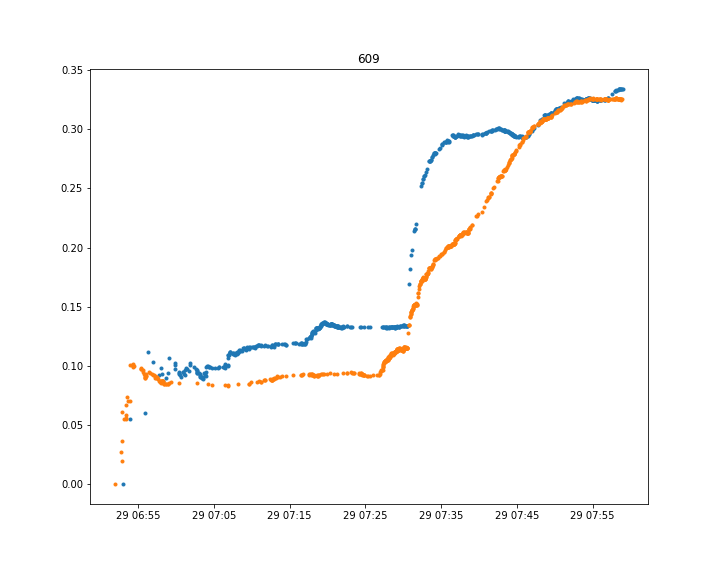

<IPython.core.display.Javascript object>


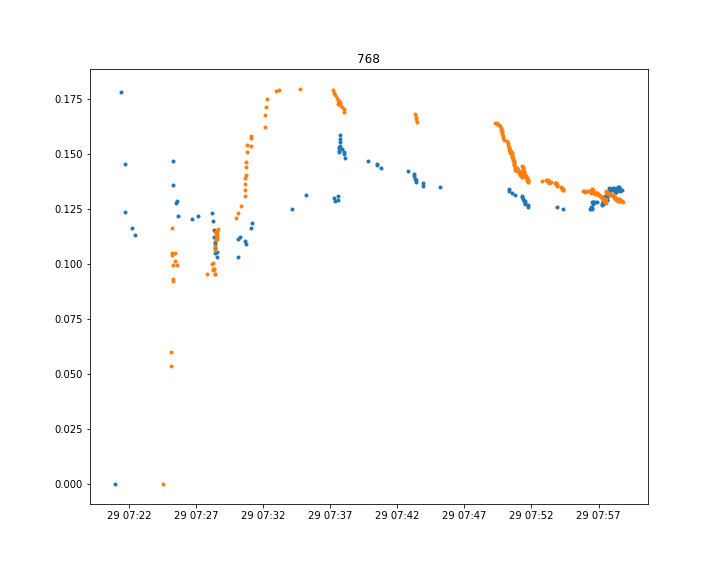

<IPython.core.display.Javascript object>


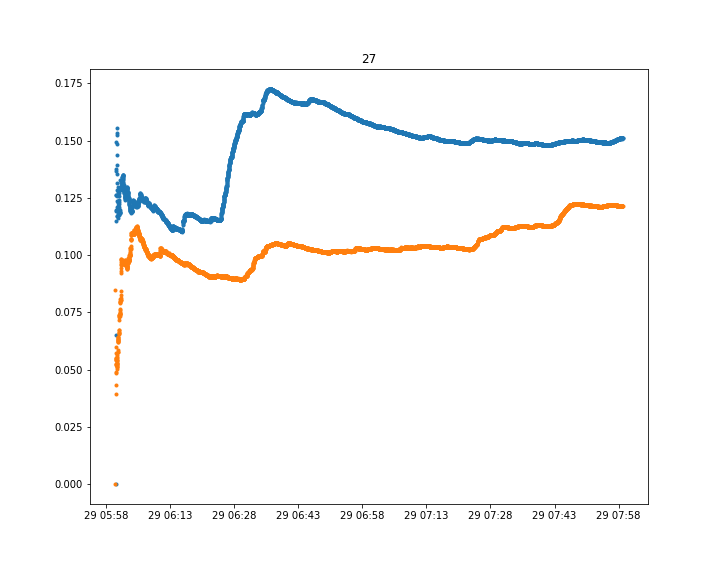

<IPython.core.display.Javascript object>


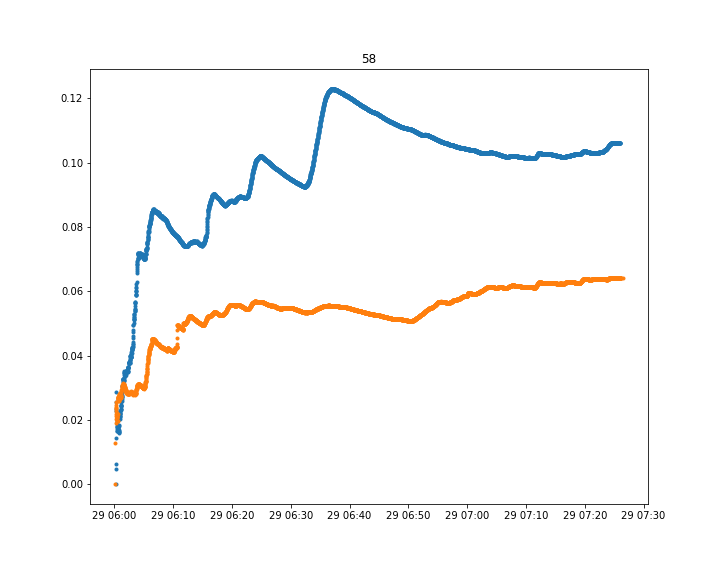

<IPython.core.display.Javascript object>


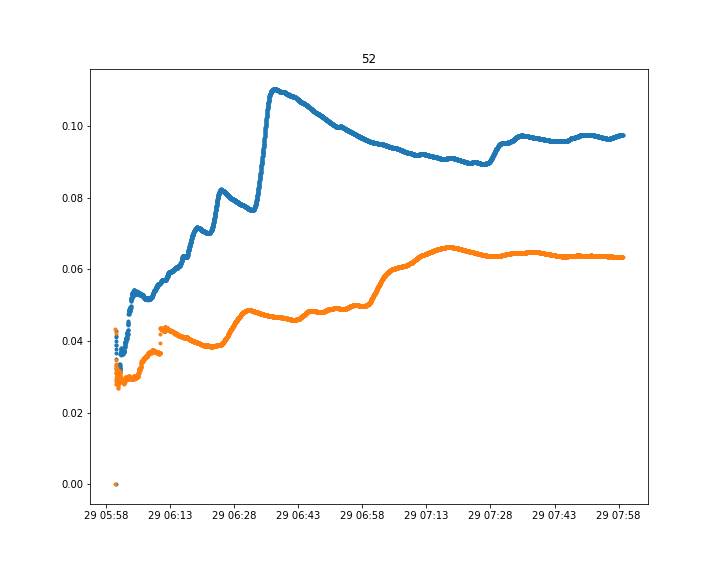

In [47]:
for _ID in [609,768,27,58,52]:
    source_df = retrieve_source(data, _ID)

    plt.figure(figsize=(10,8))
    plt.title(_ID)
    plt.plot(source_df.v_int[np.logical_and((source_df.freq_eff < 60000000),(source_df.extract_type == 0))], ".")

    plt.plot(source_df.v_int[np.logical_and((source_df.freq_eff > 60000000),(source_df.extract_type == 0))], ".")
    plt.show()

# plt.figure(figsize=(10,8))
# plt.plot(source_df.index, source_df.eta_int, ".")

In [105]:
# Match measurements from observation to AARTFAAC cat

idx, d2d, d3d = match_coordinates_sky(SkyCoord(AART_catsource.ra.values*u.deg,
                                               AART_catsource.decl.values*u.deg, frame='fk5'),
                                      SkyCoord(aart.ra.values*u.deg, 
                                               aart.decl.values*u.deg, frame='fk5'))

<IPython.core.display.Javascript object>


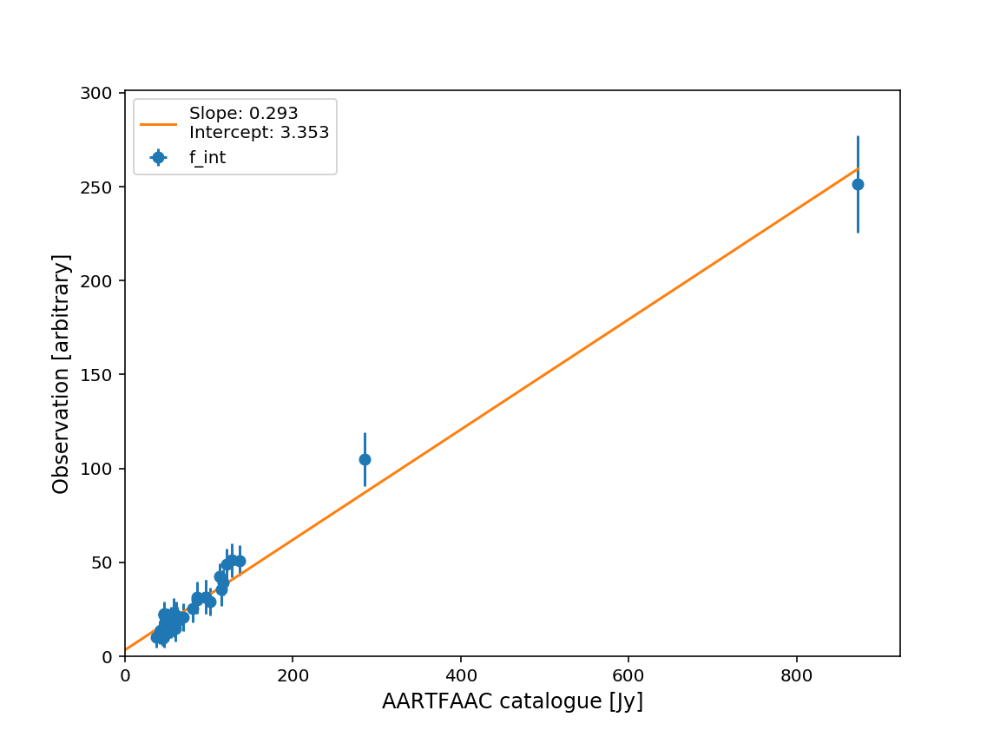

In [117]:
plt.figure(figsize=(8,6))
plt.errorbar(aart.iloc[idx].f_int,AART_catsource.f_int,
             yerr=AART_catsource.f_int_err, xerr=aart.iloc[idx].f_int_err, 
            fmt="o")

# for i in range(len(AART_catsource)):
#     plt.annotate(s=AART_catsource.index.values[i],
#                  xy=(aart.iloc[idx].f_int.values[i],AART_catsource.f_int.values[i]),
#                  xycoords="data")    

plt.xlabel("AARTFAAC catalogue [Jy]")
plt.ylabel("Observation [arbitrary]")

plt.xlim([0,np.max(aart.iloc[idx].f_int)+50.])
plt.ylim([0,np.max(AART_catsource.f_int)+50.])

fit = np.polyfit(aart.iloc[idx].f_int,AART_catsource.f_int,1)

plt.plot(np.linspace(0,np.max(aart.iloc[idx].f_int.values)),
         fit[1]+np.linspace(0,np.max(aart.iloc[idx].f_int.values))*fit[0],
         label="Slope: {}\nIntercept: {}".format(round(fit[0],3), round(fit[1],3)))

plt.legend()
plt.show()

In [115]:
np.linspace(0,aart.iloc[idx].f_int.values)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [108]:
fit

array([ 0.29344322,  3.35291153])

In [46]:
c1 = SkyCoord(69.*u.deg, 29.*u.deg, frame='fk5')

c2 = SkyCoord(70*u.deg, 
          26*u.deg, frame='fk5')
print c1.separation(c2).deg
# print ((c1.separation(c2).deg > 3) * ((np.abs(base.loc[340].timestep - base.drop(index=340).timestep)) > 1000)).all()
# print c1.separation(c2).deg > 3 *   (np.abs(base.loc[340].timestep - base.drop(index=340).timestep)) > 1000

3.12833150915


In [203]:
i = 0 

c1 = SkyCoord(filtered[filtered.index == 343].ra.values*u.deg, 
              filtered[filtered.index == 343].decl.values*u.deg, frame='fk5')

c2 = SkyCoord(filtered[filtered.index == 342].ra.values*u.deg, 
              filtered[filtered.index == 342].decl.values*u.deg, frame='fk5')

((c1.separation(c2).deg) > 1) * (np.abs(base.iloc[i].timestep - base.drop(index=base.index[i]).timestep) > 3)

In [225]:
base[base.index == 340]#.timestep.values - base[base.index == 342].timestep.values

,band,decl,decl_err,det_sigma,eta_int,extract_type,f_datapoints,f_int,f_int_err,f_peak,...,ra_err,rms_max,rms_min,tau_time,taustart_ts,url,v_int,xtrsrc,round_times,timestep
runcatid,,,,,,,,,,,,,,,,,,,,,
340,24,75.785875,0.048948,10.871815,0.0,0,1,58.063119,8.856106,57.612858,...,0.242649,23.505994,2.664603,1.0,2016-08-31 15:16:03,/data/AS_20160831/2016-08-31T15:16:03-S296-B7....,0.0,32209,2016-08-31 15:16:03,1.472657e+09


In [304]:
np.logical_or(np.array([True,True,False]), np.array([False,True,True]))

array([ True,  True,  True], dtype=bool)

In [216]:
filtered[filtered.index == 340].timestep.values - filtered[filtered.index == 342].timestep.values

array([], dtype=object)

In [204]:
c1.separation(c2).deg

array([ 1.36206605])

In [150]:
(c1.separation(c2).deg < 2 ) * (np.abs(base.iloc[i].timestep - base.drop(index=base.index[i]).timestep) < 240.)

runcatid
2       False
3       False
4       False
5       False
6       False
8       False
9       False
10      False
12      False
13      False
14      False
15      False
17      False
18      False
19      False
20      False
21      False
22      False
23      False
24      False
25      False
29      False
30      False
31      False
32      False
33      False
34      False
35      False
36      False
38      False
        ...  
4457    False
4475    False
4484    False
4540    False
4547    False
4567    False
4575    False
4579    False
4587    False
4592    False
4593    False
4595    False
4601    False
4602    False
4607    False
4609    False
4612    False
4640    False
4650    False
4662    False
4663    False
4678    False
4697    False
4738    False
4759    False
4760    False
4765    False
4770    False
4817    False
4827    False
Name: timestep, Length: 357, dtype: bool

In [155]:
N_pass = 0

for i in range(len(base)):
    if np.min(np.abs(base.iloc[i].timestep - base.drop(index=base.index[i]).timestep)) > 240:
        N_pass += 1
        
print N_pass

6


In [149]:
np.array([True,True,False]) * np.array([True,False,False])

array([ True, False, False], dtype=bool)

2017-02-27 03:50:10 2017-02-27 03:50:43


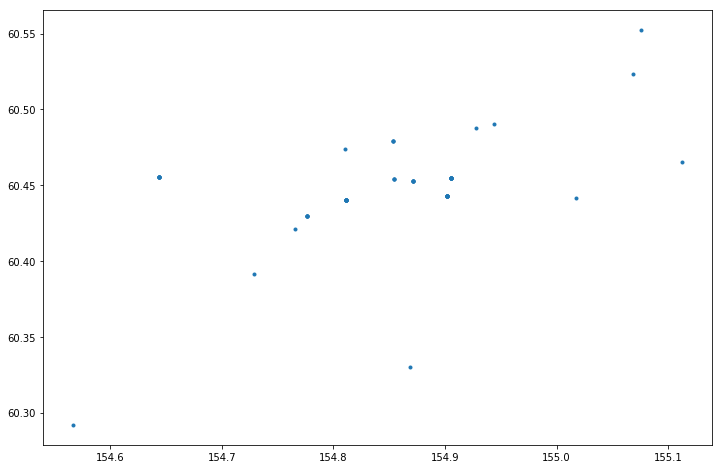

In [58]:
IDS = [3037,3038,3040,3042,3046,3048,3050,3051]
# IDS = [349,350,351]
IDS = [36]
plt.figure(figsize=(12,8))

for _id in IDS:
    source_df = retrieve_source(data, _id)
    print np.min(source_df.taustart_ts),np.max(source_df.taustart_ts)
    plt.plot(source_df.ra, source_df.decl, ".")

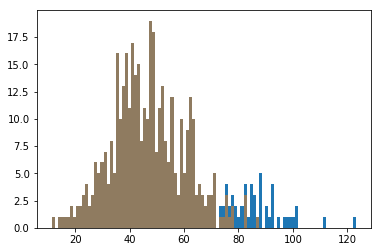

In [81]:
%matplotlib inline
x = plt.hist(source_df.f_int[(source_df.freq_eff < 60000000)].values, bins=100)

y = plt.hist(source_df.f_int[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values, bins=x[1], alpha=0.5)

<IPython.core.display.Javascript object>


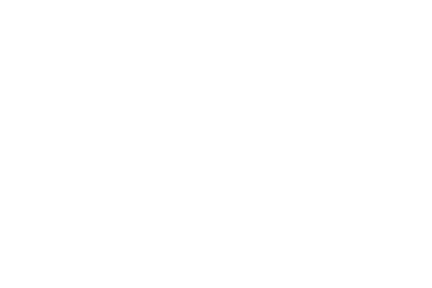

<IPython.core.display.Javascript object>


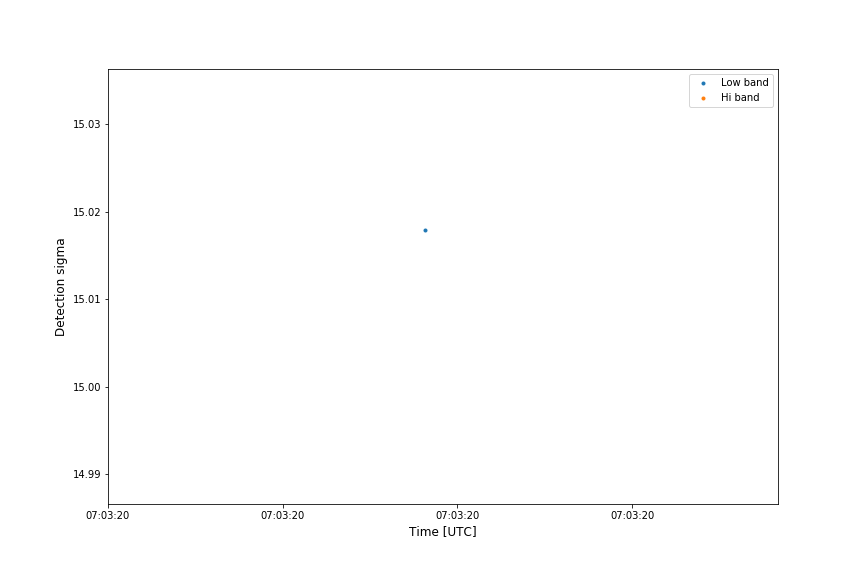

In [94]:

%matplotlib notebook


plt.figure(figsize=(12,8))
plt.plot((source_df[source_df.band ==23].f_peak)/source_df[source_df.band ==23].det_sigma, ".", label="Low band")
plt.plot((source_df[source_df.band ==24].f_peak)/source_df[source_df.band ==24].det_sigma, ".", label="Hi band")

# plt.plot(source_df[source_df.band ==23].f_peak/source_df[source_df.band ==23].rms_min, ".", c="C0", label="Low band")
# plt.plot(source_df[source_df.band ==24].f_peak/source_df[source_df.band ==24].rms_min, ".", c="C3", label="Hi band")

# plt.plot([np.min(np.append(source_df[source_df.band ==23].index,source_df[source_df.band ==24].index)),
#           np.max(np.append(source_df[source_df.band ==23].index,source_df[source_df.band ==24].index))],[5,5],"--" )

# plt.plot([np.min(np.append(source_df[source_df.band ==23].index,source_df[source_df.band ==24].index)),
#           np.max(np.append(source_df[source_df.band ==23].index,source_df[source_df.band ==24].index))],[8,8],"--" )

plt.ylabel("Detection sigma")
plt.xlabel("Time [UTC]")

plt.legend()
plt.show()


In [97]:
img = "/data/AS_201611120632/20161112070320UTC_S316.5_I8x1_W6_A1.5.fits"

plt.contourf(data[(data.url == img)].ra,data[(data.url == img)].decl,
             data[(data.url == img)].f_peak/data[(data.url == img)].det_sigma)

TypeError: Input z must be a 2D array.

In [104]:
data[(data.url == img)].taustart_ts.iloc[0]

KeyError: 0

In [106]:
from astropy.coordinates import AltAz, EarthLocation,SkyCoord, get_sun
from astropy.time import Time
from astropy import units as u
import astropy.io.fits as fits


CS002 = EarthLocation.from_geocentric (3826577.109500000, 461022.900196000, 5064892.758, 'm')
position = SkyCoord(data[(data.url == img)].ra.values*u.degree,
                    data[(data.url == img)].decl.values*u.degree)



AttributeError: 'Timestamp' object has no attribute 'values'

In [108]:
position = position.transform_to(AltAz(obstime=data[(data.url == img)].taustart_ts.iloc[0], location=CS002))

<IPython.core.display.Javascript object>


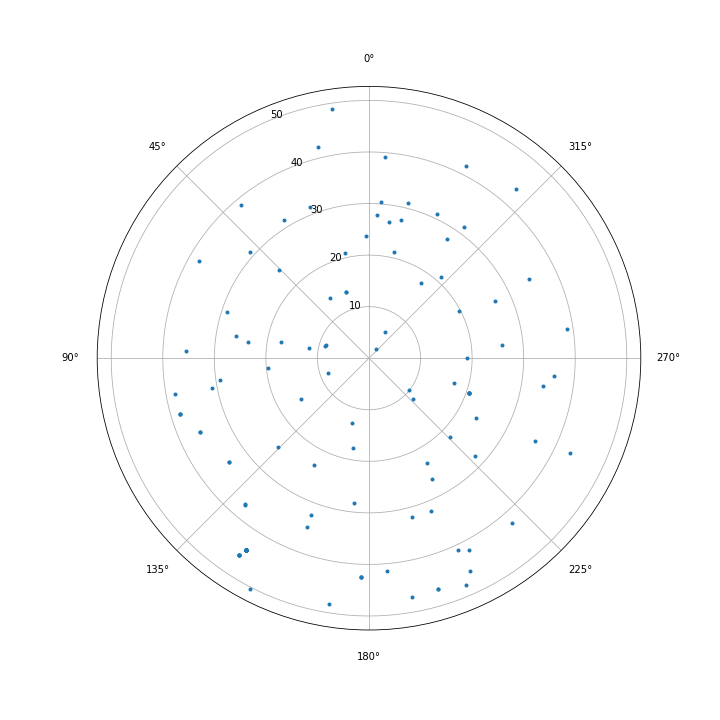

In [122]:


plt.clf()
plt.figure(figsize=(10,10))
ax = plt.subplot(111, projection="polar", adjustable="box")
ax.set_theta_zero_location("N")
plt.plot(position.az.rad,90-position.alt.deg,".")

In [128]:
def pol2cart(rho, phi):
    x = rho * np.cos(phi)
    y = rho * np.sin(phi)
    return(x, y)

In [130]:
x,y =pol2cart(np.abs(90-position.alt.deg),position.az.deg)

<IPython.core.display.Javascript object>


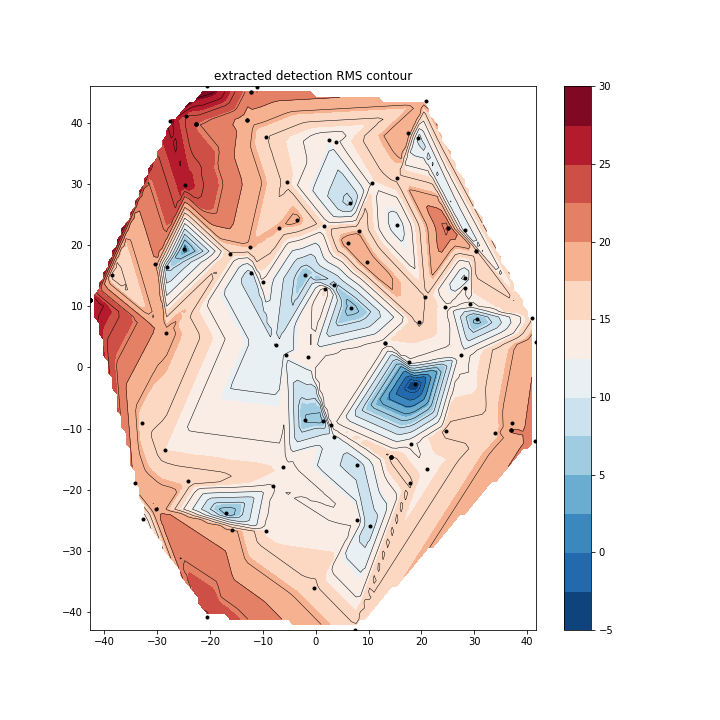

In [144]:
import matplotlib.tri as tri
plt.clf

np.random.seed(19680801)

ngridx = 100
ngridy = 100
# x = position.az.deg
# y = 90-position.alt.deg
z = data[(data.url == img)].f_peak/data[(data.url == img)].det_sigma

fig, ax1= plt.subplots(figsize=(10,10))
# ax1.set_theta_zero_location("N")


xi = np.linspace(np.min(x), np.max(x), ngridx)
yi = np.linspace(np.min(y), np.max(y), ngridy)

triang = tri.Triangulation(x, y)
interpolator = tri.LinearTriInterpolator(triang, z)
Xi, Yi = np.meshgrid(xi, yi)
zi = interpolator(Xi, Yi)

ax1.contour(xi, yi, zi, 20, linewidths=0.5, colors='k')
cntr1 = ax1.contourf(xi, yi, zi, 14, cmap="RdBu_r")

fig.colorbar(cntr1, ax=ax1)
ax1.plot(x, y, 'ko', ms=3)
# ax1.axis((-2, 2, -2, 2))
ax1.set_title('extracted detection RMS contour' )

plt.show()

In [16]:
source_df

NameError: name 'source_df' is not defined

<IPython.core.display.Javascript object>


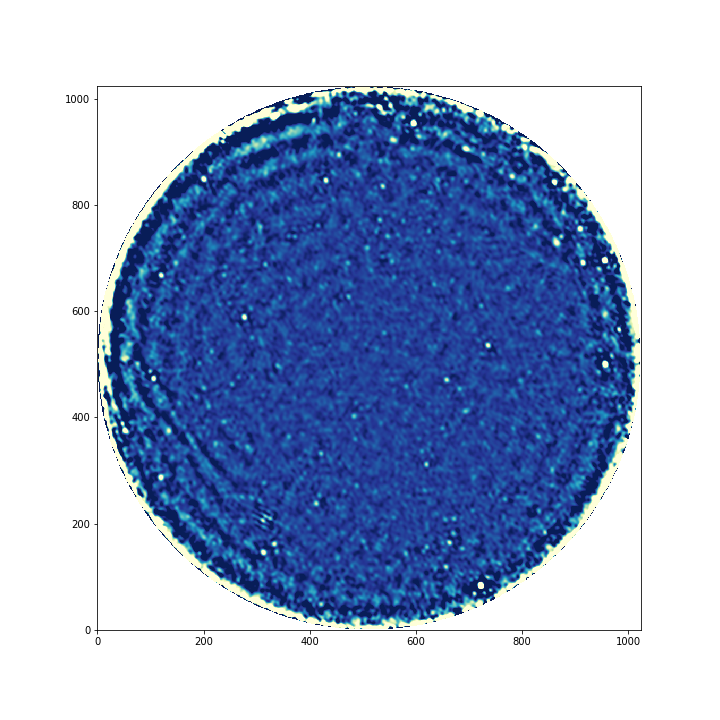

In [145]:
plt.figure(figsize=(10,10))
fitsimg = fits.open(img)[0].data
plt.imshow(fitsimg[0,0,:,:],origin="lower", cmap="YlGnBu_r", vmin=-50,vmax=250)
plt.show()

## TODO

    - Use source extractions to make, survey area/sensitivity/time plot. 
        -- at each LST how many filter regions are in sky?
        
    - Add spacetime filter
    
    - change plot colour to reflect filter criteria 
    
    - check ionosphere scinitlation as function of source brightness. 
    
    - check flux distribution, expected fraction above 8 sigma? 
    
    - process and check more data 

## 

<IPython.core.display.Javascript object>


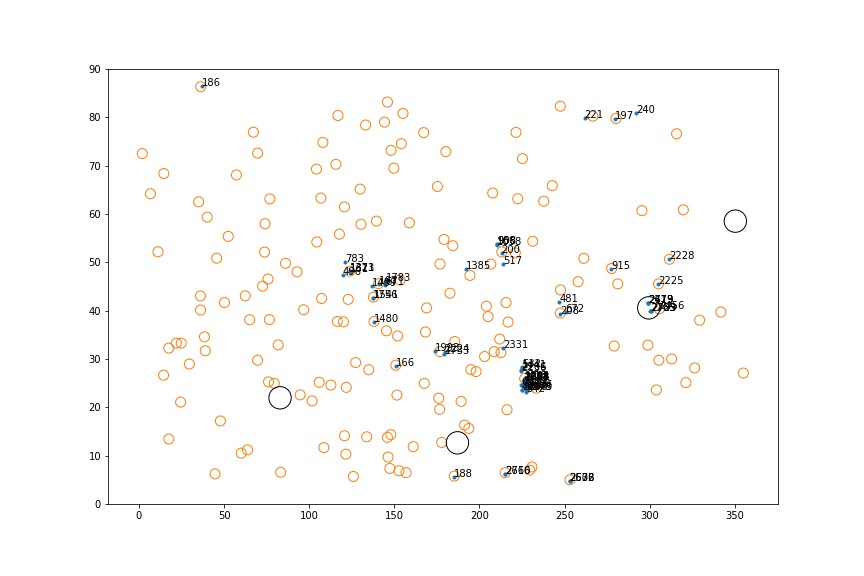

In [14]:
%matplotlib notebook

thresh = 5

ateam = {"ra":[82.88,299.43,350.28,187.07],"decl":[21.98,40.59,58.54,12.66]}


plt.figure(figsize=(12,8))
# plt.plot(base.ra, base.decl, ".")
# plt.scatter(vlssr[vlssr.Sp > thresh]._RAJ2000, 
#             vlssr[vlssr.Sp > thresh]._DEJ2000,
#             s=100,facecolor='none', edgecolor="k")

plt.plot(base[base.det_sigma >= 8].ra, base[base.det_sigma >= 8].decl, ".")
plt.scatter(aart.ra,aart.decl,edgecolor="C1", facecolor="none",s=100)


for i in range(len(base[base.det_sigma >= 8])):
    plt.annotate(s=base[base.det_sigma >= 8].index.values[i],
                 xy=(base[base.det_sigma >= 8].ra.values[i],base[base.det_sigma >= 8].decl.values[i]),
                 xycoords="data")
    
plt.scatter(ateam["ra"],ateam["decl"],edgecolor="black", facecolor="none",s=500)
plt.ylim([0,90])
plt.show()

In [33]:
thresh = 5

base_coord = SkyCoord(ra=(base.ra*u.degree).values, dec=(base.decl*u.degree).values)

vlssr_coord = SkyCoord(ra=(vlssr[vlssr.Sp > thresh]._RAJ2000*u.degree).values,
                       dec=(vlssr[vlssr.Sp > thresh]._DEJ2000*u.degree).values)

idx, d2d, d3d = base_coord.match_to_catalog_sky(vlssr_coord) 




In [ ]:
2579, 2460, 1260, 1985

0.5 1118


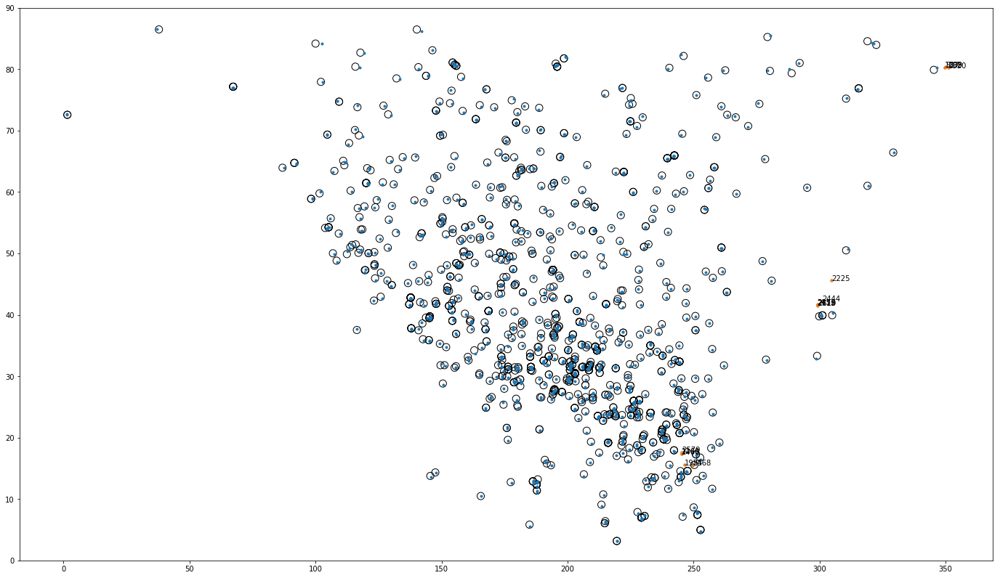

In [124]:
thresh = .5
radius = .7

# for thresh in [.1,.5,1,2,4,7,10]:

base_coord = SkyCoord(ra=(base.ra*u.degree).values, dec=(base.decl*u.degree).values)

vlssr_coord = SkyCoord(ra=(vlssr[vlssr.Sp > thresh]._RAJ2000*u.degree).values,
                       dec=(vlssr[vlssr.Sp > thresh]._DEJ2000*u.degree).values)

# tgss_coord = SkyCoord(ra=(tgss[tgss.Sp > thresh]._RAJ2000*u.degree).values,
#                        dec=(tgss[tgss.Sp > thresh]._DEJ2000*u.degree).values)


idx, d2d, d3d = base_coord.match_to_catalog_sky(vlssr_coord) 



plt.figure(figsize=(24,14))

plt.plot(base.ra,base.decl,".")

plt.scatter(vlssr[vlssr.Sp > thresh].iloc[idx[d2d.deg < radius]]._RAJ2000, 
            vlssr[vlssr.Sp > thresh].iloc[idx[d2d.deg < radius]]._DEJ2000,
            s=100,facecolor='none', edgecolor="k")

plt.plot(base[d2d.deg > radius].ra,base[d2d.deg > radius].decl,".", c="C1")

for i in range(len(base[d2d.deg > radius])):
    plt.annotate(s=base[d2d.deg > radius].index.values[i],
                 xy=(base[d2d.deg > radius].ra.values[i],base[d2d.deg > radius].decl.values[i]),
                 xycoords="data")


plt.ylim([0,90])
print thresh, len(idx[d2d.deg < radius])
# base[d2d.deg > radius]

1000.0 1066


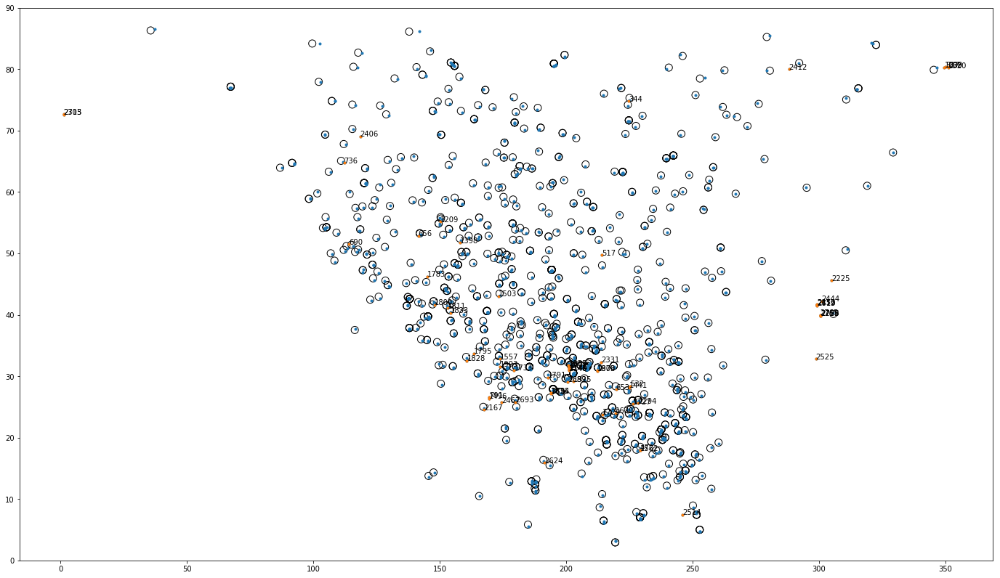

In [118]:
thresh = 1*1000. # TGSS flux is in mJy
radius = .5

# for thresh in [.1,.5,1,2,4,7,10]:

base_coord = SkyCoord(ra=(base.ra*u.degree).values, dec=(base.decl*u.degree).values)

tgss_coord = SkyCoord(ra=(tgss[tgss.Total_flux > thresh].RA*u.degree).values,
                       dec=(tgss[tgss.Total_flux > thresh].DEC*u.degree).values)


idx, d2d, d3d = base_coord.match_to_catalog_sky(tgss_coord) 



plt.figure(figsize=(24,14))

plt.plot(base.ra,base.decl,".", c="C0")

plt.scatter(tgss[tgss.Total_flux > thresh].iloc[idx[d2d.deg < radius]].RA, 
            tgss[tgss.Total_flux > thresh].iloc[idx[d2d.deg < radius]].DEC,
            s=100,facecolor='none', edgecolor="k")

plt.ylim([0,90])
print thresh, len(idx[d2d.deg < radius])
# base[d2d.deg > radius]

plt.plot(base[d2d.deg > radius].ra,base[d2d.deg > radius].decl,".", c="C1")

for i in range(len(base[d2d.deg > radius])):
    plt.annotate(s=base[d2d.deg > radius].index.values[i],
                 xy=(base[d2d.deg > radius].ra.values[i],base[d2d.deg > radius].decl.values[i]),
                 xycoords="data")
    
# plt.xlim([169,171])

In [98]:
thresh = 1000
radius = 1.

n_assoc = []

for thresh in np.logspace(2,5,100):

    base_coord = SkyCoord(ra=(base.ra*u.degree).values, dec=(base.decl*u.degree).values)

    tgss_coord = SkyCoord(ra=(tgss[tgss.Total_flux > thresh].RA*u.degree).values,
                           dec=(tgss[tgss.Total_flux > thresh].DEC*u.degree).values)

    idx, d2d, d3d = base_coord.match_to_catalog_sky(tgss_coord) 



#     plt.figure(figsize=(24,14))

#     plt.plot(base.ra,base.decl,".")
#     plt.scatter(tgss[tgss.Total_flux > thresh].iloc[idx[d2d.deg < radius]].RA, 
#                 tgss[tgss.Total_flux > thresh].iloc[idx[d2d.deg < radius]].DEC,
#                 s=100,facecolor='none', edgecolor="k")

#     plt.ylim([0,90])
#     print thresh, len(idx[d2d.deg < radius])
#     base[d2d.deg > radius]
    n_assoc.append(len(idx[d2d.deg < radius]))

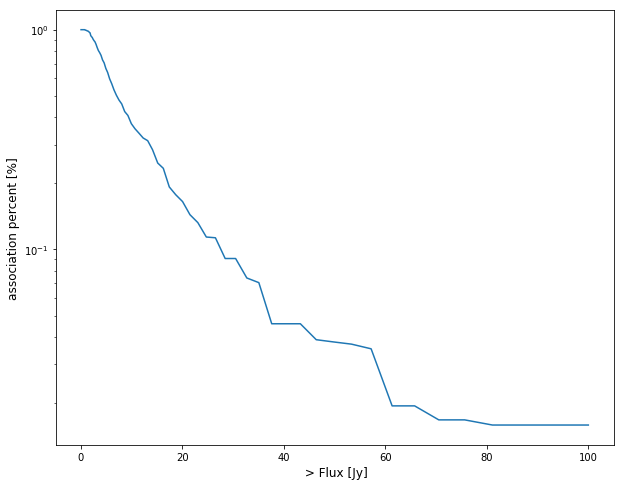

In [100]:
plt.figure(figsize=(10,8))
plt.plot(np.logspace(2,5,100)/1000,np.array(n_assoc)/1133. )
plt.xlabel(" > Flux [Jy]")
plt.ylabel("association percent [%]")
plt.yscale("log")

In [58]:
target_ra = 0.26
target_decl = 64
target_radius = 1.5

base[(base.ra > target_ra-target_radius) & (base.ra < target_ra+target_radius) & \
(base.decl > target_decl-target_radius) & (base.decl < target_decl+target_radius)]

,band,decl,decl_err,eta_int,extract_type,f_datapoints,f_int,f_int_err,freq_eff,ra,ra_err,tau_time,v_int,xtrsrc
runcatid,,,,,,,,,,,,,,


In [16]:
coord = SkyCoord("05:34:00 +41:45:00",unit=(u.hourangle, u.deg))

target_ra = coord.ra.deg
target_decl = coord.dec.deg
target_radius = 0.5

vlssr[(vlssr._RAJ2000 > target_ra-target_radius) & (vlssr._RAJ2000 < target_ra+target_radius) & \
(vlssr._DEJ2000 > target_decl-target_radius) & (vlssr._DEJ2000 < target_decl+target_radius)]

,_RAJ2000,_DEJ2000,RAJ2000,DEJ2000,Sp,e_Sp,MajAx,MinAx,PA,Rrms,Rpk,RFlx,Field,VLSS,img,SED
23414,83.48692,42.18322,05 33 56.86,+42 10 59.6,1.17,0.07,0.02,0.02,-0.97,0.07,0.16,0.01,0536+450,1,img,SED


<Container object of 3 artists>

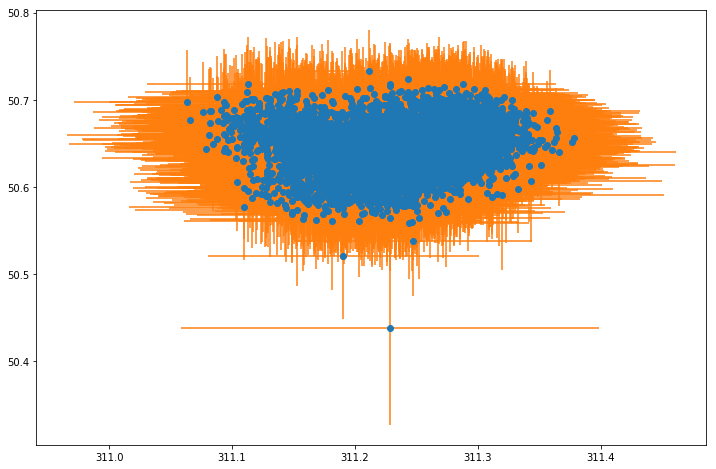

In [17]:
_id = 4

plt.figure(figsize=(12,8))
plt.errorbar(data[data.runcatid ==_id].ra,
             data[data.runcatid == _id].decl,
             xerr=data[data.runcatid == _id].ra_err,
             yerr=data[data.runcatid == _id].decl_err,
             fmt="o",color="C0",ecolor="C1")


In [18]:
coord = SkyCoord("05:34:00 +41:45:00",unit=(u.hourangle, u.deg))

target_ra = coord.ra.deg
target_decl = coord.dec.deg
target_radius = 0.25

tgss[(tgss.RA > target_ra-target_radius) & (tgss.RA < target_ra+target_radius) & \
(tgss.DEC > target_decl-target_radius) & (tgss.DEC < target_decl+target_radius)]

,Source_name,RA,E_RA,DEC,E_DEC,Total_flux,E_Total_flux,Peak_flux,E_Peak_flux,Maj,E_Maj,Min,E_Min,PA,E_PA,RMS_noise,Source_code,Mosaic_name
168051,TGSSADR J053445.3+415925,83.68882,2.0,41.99055,2.0,79.9,9.1,74.2,7.8,26.1,0.9,25.8,0.9,-41.3,90.0,2.5,S,R17D60
168054,TGSSADR J053333.0+413717,83.38771,2.1,41.62166,2.0,100.7,11.0,69.1,7.5,33.9,1.5,26.9,1.0,80.4,8.8,2.7,S,R17D60
168055,TGSSADR J053330.9+413940,83.37887,2.7,41.66129,2.3,60.9,7.3,30.7,4.2,43.0,4.5,28.8,2.3,69.3,12.5,2.7,S,R17D60
178702,TGSSADR J053458.1+414354,83.74223,2.2,41.73191,2.2,37.2,5.9,34.2,4.3,28.1,2.4,24.2,1.8,-68.9,22.4,2.6,S,R18D59


In [76]:
re_tgss.to_csv("TGSS_reduced.csv",index=False)

In [15]:
target_ra = 197
target_decl = 27
target_radius = 1

base[(base.ra > target_ra-target_radius) & (base.ra < target_ra+target_radius) & \
(base.decl > target_decl-target_radius) & (base.decl < target_decl+target_radius)]

,band,decl,decl_err,eta_int,extract_type,f_datapoints,f_int,f_int_err,freq_eff,ra,ra_err,tau_time,v_int,xtrsrc
runcatid,,,,,,,,,,,,,,
198,23.503377,27.228565,0.177119,1.079321,0.431509,3295.283600,20.358464,6.558337,6.005963e+07,197.935946,0.188564,0.923958,24.367764,9.249788e+05
1709,23.504886,27.139579,0.190991,4.833753,0.392834,1151.859935,26.088819,7.028453,6.005312e+07,197.938984,0.217366,0.770901,0.577119,1.741908e+06
1867,23.505753,27.157072,0.193757,5.485388,0.385906,1043.638063,26.741488,7.122937,6.004984e+07,197.945389,0.221466,0.746165,0.575325,1.798975e+06
2322,23.512773,27.167021,0.312491,2.310325,0.618069,402.011838,16.872005,6.720426,6.002733e+07,197.934664,0.372267,1.009346,0.619098,2.126846e+06


In [ ]:
1260, 1985, 2460,2579

In [16]:
higher = SkyCoord(ra=np.array(data.ra, dtype=float)*u.degree,
                  dec=np.array(data.decl, dtype=float)*u.degree)

In [30]:
higher = SkyCoord(ra=(data[data.band == 1].ra*u.degree).values, dec=(data[data.band == 1].decl*u.degree).values)
lower = SkyCoord(ra=(data[data.band == 2].ra*u.degree).values, dec=(data[data.band == 2].decl*u.degree).values)

idx, d2d, d3d = lower.match_to_catalog_sky(higher)

In [62]:
trans_data

,detection_thresh,f_int,newsource_type,rms_max,rms_min,runcat
77,5.0,19.768934,0,18.743736,1.856205,218
78,5.0,19.327459,0,18.743736,1.856205,217
79,5.0,20.998830,0,18.743736,1.856205,216
80,5.0,77.739692,0,18.743736,1.856205,215
81,5.0,21.667495,0,22.866646,2.369417,222
82,5.0,24.460962,0,22.866646,2.369417,221
83,5.0,20.162994,0,22.866646,2.369417,220
84,5.0,19.622287,0,22.866646,2.369417,219
85,5.0,17.231162,0,18.205269,1.733188,225
86,5.0,25.159211,0,18.205269,1.733188,224


In [9]:
plt.errorbar(source_df.taustart_ts[source_df.band == i].values,source_df.f_int[source_df.band == i].values, 
                 yerr = source_df.f_int_err[source_df.band == i].values)


NameError: name 'i' is not defined

In [90]:
reduced = reduced.drop(reduced.index[np.logical_or((reduced.set_index("taustart_ts").index.month != 2), \
                           (reduced.set_index("taustart_ts").index.hour == 14))])

In [81]:
source_df.taustart_ts[(source_df.freq_eff < 60000000) & (source_df.extract_type == 0)].values

array(['2017-02-25T04:00:06.000000000+0000',
       '2017-02-25T04:00:06.000000000+0000',
       '2017-02-25T04:00:12.000000000+0000', ...,
       '2017-02-25T05:08:57.000000000+0000',
       '2017-02-25T14:07:20.000000000+0000',
       '2017-02-25T14:07:20.000000000+0000'], dtype='datetime64[ns]')

In [118]:
source_df

,band,decl,decl_err,det_sigma,eta_int,extract_type,f_datapoints,f_int,f_int_err,f_peak,f_peak_err,freq_eff,ra,ra_err,runcatid,tau_time,taustart_ts,v_int,xtrsrc
taustart_ts,,,,,,,,,,,,,,,,,,,
2017-02-26 12:55:00,23,40.344115,0.147164,5.050652,0.000000,0,1,23.532531,8.270748,22.563585,4.578504,58320312.0,72.063029,0.157355,3734,1.0,2017-02-26 12:55:00,0.000000,2755979
2017-02-26 12:55:14,23,40.297089,0.130599,5.740515,0.017566,0,2,25.039191,7.798857,24.229498,4.357069,58320312.0,72.147261,0.139349,3734,1.0,2017-02-26 12:55:14,0.043868,2760543
2017-02-26 12:55:23,23,40.392418,0.146069,5.034935,0.089628,0,3,20.640072,7.212151,19.800037,3.994468,58320312.0,72.099467,0.156447,3734,1.0,2017-02-26 12:55:23,0.096904,2763562
2017-02-26 12:55:28,23,40.274940,0.128712,5.678616,0.060819,0,4,22.455052,6.886939,21.750980,3.851504,58320312.0,72.237526,0.137221,3734,1.0,2017-02-26 12:55:28,0.080778,2765204
2017-02-26 12:55:31,23,40.375863,0.146980,5.065071,0.052935,0,5,24.380653,8.558366,23.379235,4.738220,58320312.0,72.217338,0.157334,3734,1.0,2017-02-26 12:55:31,0.074611,2766080
2017-02-26 13:06:10,23,39.874975,0.137814,5.016570,0.044336,0,6,22.203944,7.639258,21.327850,4.236503,58333332.0,71.899100,0.147504,3734,1.0,2017-02-26 13:06:10,0.069540,2991759
2017-02-26 13:06:18,23,39.849722,0.125686,5.271283,0.037145,0,7,23.171427,7.272230,22.410643,4.060771,58333332.0,71.887242,0.134589,3734,1.0,2017-02-26 13:06:18,0.063466,2994229
2017-02-26 13:06:19,23,39.821830,0.123845,5.461285,0.049403,0,8,25.930552,8.025682,25.102551,4.485671,58333332.0,71.820299,0.132763,3734,1.0,2017-02-26 13:06:19,0.072284,2994469
2017-02-26 13:06:25,23,39.922440,0.129041,5.177474,0.043651,0,9,23.754436,7.671200,22.928663,4.275005,58300780.0,71.847472,0.138465,3734,1.0,2017-02-26 13:06:25,0.067676,2996429


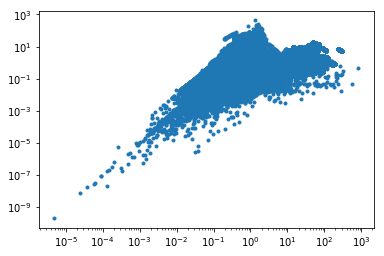

In [97]:
plt.plot(data.v_int, data.eta_int,".")
plt.xscale("log")
plt.yscale("log")

In [209]:
plt.plot(source_df.f_int[source_df.freq_eff > 60000000].values/ source_df.f_int[source_df.freq_eff < 60000000].values, ".")

ValueError: operands could not be broadcast together with shapes (3810,) (3754,) 

(736385.099988426, 736385.1054282407)

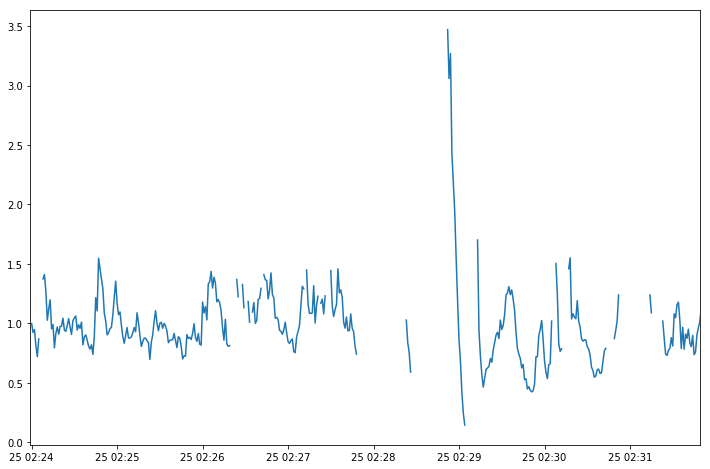

In [224]:
plt.figure(figsize=(12,8))
plt.plot(source_df[source_df.freq_eff > 60000000].set_index("taustart_ts").f_int/source_df[source_df.freq_eff < 60000000].set_index("taustart_ts").f_int)
plt.xlim([source_df.taustart_ts[source_df.freq_eff > 60000000].values[-623],
         source_df.taustart_ts[source_df.freq_eff > 60000000].values[-223]])

In [179]:
data = data.drop(data.index[data.f)int == np.max(data.taustart_ts)])

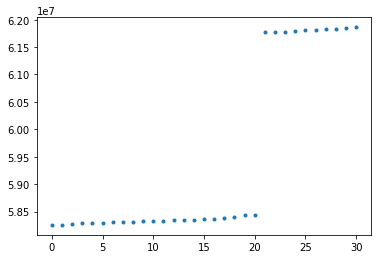

In [132]:
plt.plot(np.unique(data.freq_eff), ".")

data = data.drop(data.index[np.abs(data.f_int) > 10e6])

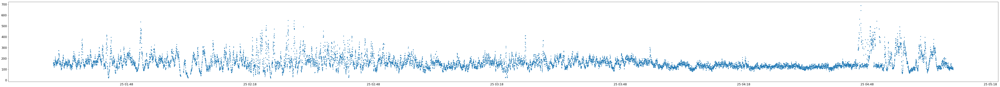

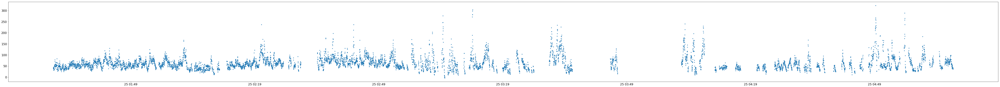

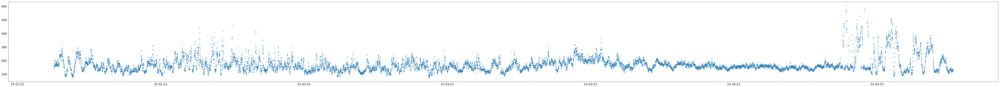

In [57]:
# source_df = retrieve_source(data, 81)

plt.figure(figsize=(96,8))
source_df = retrieve_source(data, 11)
plt.plot(source_df.taustart_ts,source_df.f_int, ".")
plt.figure(figsize=(96,8))
source_df = retrieve_source(data, 81)
plt.plot(source_df.taustart_ts,source_df.f_int, ".")
plt.figure(figsize=(96,8))
source_df = retrieve_source(data, 531)
plt.plot(source_df.taustart_ts,source_df.f_int, ".")
# plt.yscale("log")


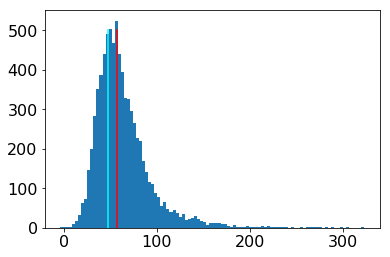

In [29]:
plt.hist(source_df.f_int, bins=100)
plt.plot([np.median(source_df.f_int),np.median(source_df.f_int)], [0,500], c="r", label=round(np.median(source_df.f_int),2))
plt.plot([47.69,47.69],[0,500],c="cyan")

In [103]:
data[data.runcatid == 1].wm_ra.iloc[0], data[data.runcatid == 1].wm_decl.iloc[0]

(247.186254743988, 39.399400295862399)

In [108]:
p1 = SkyCoord(ra=(data[data.runcatid == 1].wm_ra.iloc[0]*u.degree),
                  dec=(data[data.runcatid == 1].wm_decl.iloc[0]*u.degree))
lower

<SkyCoord (ICRS): (ra, dec) in deg
    [(  2.47228349e+02,  39.36173231), (  2.47229999e+02,  39.38646435),
     (  2.47059419e+02,  39.41649621), ...,
     (  2.13972986e+02,  29.16307307), (  2.14041150e+02,  29.13051157),
     (  2.14106122e+02,  29.15144207)]>

In [112]:
data[data.band == 2][p1.separation(lower) < 1*u.degree]

,band,dataset,decl,decl_err,eta_int,extract_type,f_datapoints,f_int,f_int_err,freq_eff,ra,ra_err,runcatid,tau_time,taustart_ts,v_int,wm_decl,wm_ra,xtrsrc
976110,2,1,39.361732,0.094313,6.916444,0,8338,27.719405,7.801233,58300780.0,247.228349,0.125698,1436,1.0,2017-02-25 03:52:01,-3774.611363,39.389354,247.185655,679637
976111,2,1,39.386464,0.063497,5.280496,0,12652,41.296534,7.394331,58398436.0,247.229999,0.080372,1436,1.0,2017-02-25 05:04:25,293.025540,39.389354,247.185655,990833
976112,2,1,39.416496,0.087824,7.619593,0,1146,30.625091,8.697310,58300780.0,247.059419,0.124342,1436,1.0,2017-02-25 01:49:22,33.849953,39.389354,247.185655,90336
976113,2,1,39.507698,0.064061,7.276207,0,7482,45.161754,8.799439,58300780.0,247.159158,0.087084,1436,1.0,2017-02-25 03:37:39,-3569.042293,39.389354,247.185655,626095
976114,2,1,39.336266,0.063424,6.921881,0,8317,45.964468,8.697977,58300780.0,247.266272,0.084522,1436,1.0,2017-02-25 03:51:40,-3769.754660,39.389354,247.185655,678338
976115,2,1,39.396776,0.058862,5.290685,0,12621,44.288620,7.351955,58398436.0,247.246765,0.074535,1436,1.0,2017-02-25 05:03:54,292.667199,39.389354,247.185655,988856
976116,2,1,39.387400,0.069417,5.208353,0,12862,42.100772,8.233360,58346356.0,247.303457,0.087777,1436,1.0,2017-02-25 05:07:57,295.441337,39.389354,247.185655,1004344
976117,2,1,39.435415,0.029826,7.440287,0,3534,67.814379,7.070802,58320312.0,247.106497,0.046193,1436,1.0,2017-02-25 02:29:57,-2433.358354,39.389354,247.185655,294611
976118,2,1,39.459537,0.044953,8.036622,0,2502,43.147697,7.063492,58346356.0,247.121276,0.072149,1436,1.0,2017-02-25 02:12:38,-2043.132334,39.389354,247.185655,203992
976119,2,1,39.331745,0.041637,7.824147,0,6463,83.686397,10.868318,58300780.0,247.180481,0.057871,1436,1.0,2017-02-25 03:20:28,-3310.543269,39.389354,247.185655,552465


In [14]:
reduced_low = data[data.band == 23].groupby("runcatid").mean()
reduced_hi = data[data.band == 24].groupby("runcatid").mean()

In [10]:
%matplotlib inline

plt.figure(figsize=(24,20))

plt.scatter(reduced[reduced.band == 23].groupby("runcatid").first().wm_ra, 
            reduced[reduced.band == 23].groupby("runcatid").first().wm_decl,
            facecolors='none', edgecolors='r',
           s=15)

plt.scatter(reduced[reduced.band == 24].groupby("runcatid").first().wm_ra, 
            reduced[reduced.band == 24].groupby("runcatid").first().wm_decl,
            c="black",
           s=5)

NameError: name 'reduced' is not defined

In [59]:
len(np.unique(reduced.runcatid))

1051

In [40]:
band1 = SkyCoord(ra=(reduced[reduced.band == 1].wm_ra*u.degree).values,
                dec=(reduced[reduced.band == 1].wm_decl*u.degree).values)

band2 = SkyCoord(ra=(reduced[reduced.band == 2].wm_ra*u.degree).values,
                dec=(reduced[reduced.band == 2].wm_decl*u.degree).values)


In [37]:
for i in band1:
    for j in band2:
        if j.lower.match_to_catalog_sky(higher)

<SkyCoord (ICRS): (ra, dec) in deg
    [( 247.18625474,  39.3994003 ), ( 230.18456511,  20.04971211),
     ( 260.93923596,  50.83740648), ..., ( 289.99997387,  74.42867236),
     ( 269.84725218,  46.03556422), ( 287.26150892,  26.98088046)]>

In [43]:
idx1, sep1, d3d1 = band1.match_to_catalog_sky(band2)

In [44]:
idx2, sep2, d3d2 = band2.match_to_catalog_sky(band1)

<IPython.core.display.Javascript object>


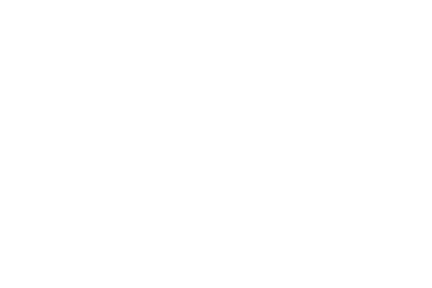

<IPython.core.display.Javascript object>


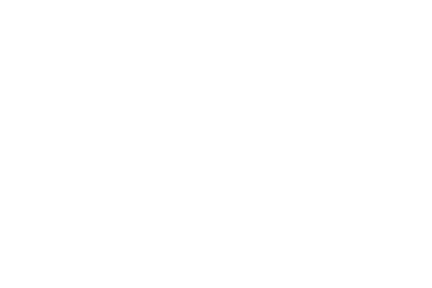

In [40]:
hist = plt.hist(reduced.f_int, bins=100,log=True)


In [39]:
reduced[reduced.band == 2].iloc[6].ra


237.29583399571379

In [55]:
i = 5

print idx1[i],idx2[i]

6 67


In [53]:
np.unique(data.runcatid, return_index=True )[1]

array([      0,     466,   21318, ..., 6322090, 6322122, 6322186])

In [54]:
reduced = data.iloc[np.unique(data.runcatid, return_index=True )[1]]

In [100]:
data[data.runcatid == 160]

,band,dataset,decl,decl_err,eta_int,extract_type,f_datapoints,f_int,f_int_err,freq_eff,ra,ra_err,runcatid,tau_time,taustart_ts,v_int,wm_decl,wm_ra,xtrsrc
0,23,2,13.575972,0.138752,0.089614,0,61,20.308833,6.762343,61816408.0,145.892648,0.136471,160,1.0,2017-02-25 01:36:14,0.095596,13.618078,145.809975,63288
1,24,2,13.669865,0.125002,0.212004,0,129,18.024957,5.416340,58300780.0,145.859241,0.123152,160,1.0,2017-02-25 01:36:15,0.137115,13.618078,145.809975,63422
2,24,2,13.647891,0.135330,0.216239,0,130,16.950349,5.514295,58300780.0,145.809621,0.133401,160,1.0,2017-02-25 01:36:18,0.138354,13.618078,145.809975,63919
3,24,2,13.556093,0.123966,0.215958,0,131,19.282390,5.735331,58300780.0,145.832763,0.121991,160,1.0,2017-02-25 01:36:20,0.138394,13.618078,145.809975,64241
4,24,2,13.636268,0.143943,0.220440,0,132,16.547213,5.724116,58300780.0,145.862893,0.141815,160,1.0,2017-02-25 01:36:21,0.139827,13.618078,145.809975,64408
5,24,2,13.603691,0.141609,0.228766,0,133,15.543767,5.286593,58320312.0,145.863313,0.139449,160,1.0,2017-02-25 01:36:22,0.141916,13.618078,145.809975,64574
6,23,2,13.629798,0.133267,0.088303,0,62,20.418181,6.534866,61816408.0,145.969921,0.131111,160,1.0,2017-02-25 01:36:23,0.095036,13.618078,145.809975,64780
7,24,2,13.704397,0.125308,0.228254,0,134,19.244757,5.802303,58300780.0,145.837659,0.123610,160,1.0,2017-02-25 01:36:25,0.141913,13.618078,145.809975,65028
8,24,2,13.570758,0.116621,0.226675,0,135,22.371377,6.260916,58300780.0,145.864566,0.114778,160,1.0,2017-02-25 01:36:28,0.141372,13.618078,145.809975,65462
9,24,2,13.602535,0.097502,0.224997,0,136,21.500435,5.031826,58300780.0,145.881201,0.095967,160,1.0,2017-02-25 01:36:29,0.140879,13.618078,145.809975,65618


In [80]:
np.array([data[data.runcatid == 2681].extract_type == 0], dtype=bool) and  np.array([data[data.runcatid == 2681].band == 23], dtype=bool)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [152]:
(np.array([True, False, True, False]) * np.array([True, True, False, False])) * \
(np.array([True, False, True, False]) * np.array([True, True, False, False]))

array([ True, False, False, False], dtype=bool)

In [31]:
(data[(data.runcatid == run_index) & (data.extract_type == 0)].sort_values(by="taustart_ts")) * \
     (data[(data.runcatid == run_index) & (data.band == 23)].sort_values(by="taustart_ts"))

TypeError: ufunc multiply cannot use operands with types dtype('<M8[ns]') and dtype('<M8[ns]')

In [53]:

run_index = 1561
len(data[(data.runcatid == run_index) & \
     (data.band == 23) & \
     (data.extract_type == 0)].set_index("taustart_ts").index.\
intersection(data[(data.runcatid == run_index) & \
     (data.band == 24) & \
     (data.extract_type == 0)].set_index("taustart_ts").index )) > 0

False

In [39]:
np.array([True,True,True,True]) * np.array([False, True, False, True])

array([False,  True, False,  True], dtype=bool)

In [18]:
run_index = 170
(((data[data.runcatid == run_index].extract_type == 0) * \
        (data[data.runcatid == run_index].band == 24)) * \
        ((data[data.runcatid == run_index].extract_type == 0) * \
         (data[data.runcatid == run_index].band == 23))).any()

False

In [22]:
run_index = 170

((data[data.runcatid == run_index].sort_values(by="taustart_ts").extract_type == 0) * \
        (data[data.runcatid == run_index].sort_values(by="taustart_ts").band == 24)) * \
        ((data[data.runcatid == run_index].sort_values(by="taustart_ts").extract_type == 0) * \
         (data[data.runcatid == run_index].sort_values(by="taustart_ts").band == 23))

xtrsrc
8912       False
8950       False
8998       False
9033       False
9114       False
9149       False
9236       False
9304       False
9366       False
9397       False
9547       False
9509       False
9651       False
9680       False
9797       False
9833       False
9950       False
9983       False
10091      False
10130      False
10232      False
10269      False
10493      False
10376      False
10529      False
10565      False
10672      False
10714      False
10817      False
10853      False
           ...  
1393538    False
1394067    False
1398526    False
1398894    False
1399101    False
1401376    False
1402212    False
1402339    False
1402480    False
1402640    False
1402669    False
1403067    False
1403205    False
1403378    False
1403972    False
1404294    False
1404441    False
1404948    False
1406376    False
1406989    False
1408492    False
1409804    False
1409988    False
1410164    False
1410808    False
1412845    False
1424650    False
1465307

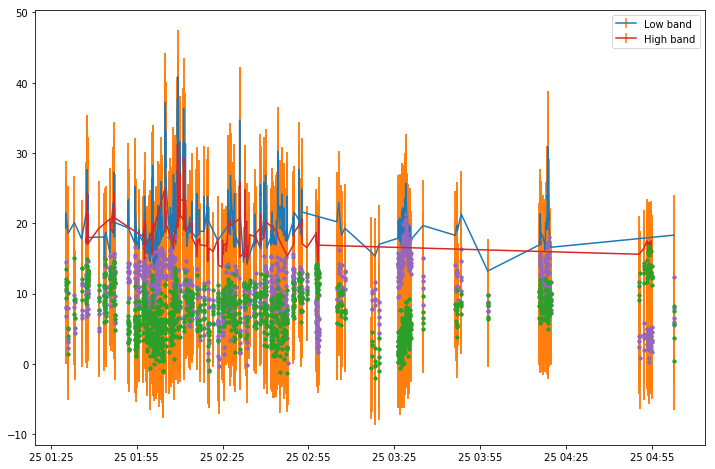

In [46]:

# run_index = 197 #np.unique(reduced.runcatid)[653]

# source_df = retrieve_source(reduced, run_index)

plt.figure(figsize=(12,8))
plt.errorbar(source_df.taustart_ts[(source_df.freq_eff < 60000000) & (source_df.extract_type == 0)].values,
             source_df.f_int[(source_df.freq_eff < 60000000) & (source_df.extract_type == 0)].values, 
             yerr = source_df.f_int_err[(source_df.freq_eff < 60000000) & (source_df.extract_type == 0)].values,
             fmt="-", color="C0",ecolor="C1", label="Low band")

plt.errorbar(source_df.taustart_ts[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values,
             source_df.f_int[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values, 
             yerr = source_df.f_int_err[(source_df.freq_eff < 60000000) & (source_df.extract_type == 1 )].values,
             fmt=".", color="C4",ecolor="C1")

# plt.ylim([0,80])

# plt.figure(figsize=(24,8))
plt.errorbar(source_df.taustart_ts[(source_df.freq_eff > 60000000) & (source_df.extract_type == 0 )].values,
             source_df.f_int[(source_df.freq_eff > 60000000) & (source_df.extract_type == 0 )].values, 
             yerr = source_df.f_int_err[(source_df.freq_eff > 60000000) & (source_df.extract_type == 0 )].values,
             fmt="-",color="C3", ecolor="C1", label="High band")

plt.errorbar(source_df.taustart_ts[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values,
             source_df.f_int[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values, 
             yerr = source_df.f_int_err[(source_df.freq_eff > 60000000) & (source_df.extract_type == 1 )].values,
             fmt=".", color="C2",ecolor="C1")


# plt.xlim([source_df.taustart_ts[source_df.freq_eff > 60000000].values[0],
#          source_df.taustart_ts[source_df.freq_eff > 60000000].values[100]])

plt.legend()

In [40]:
source_df.taustart_ts[(source_df.freq_eff > 60000000) & (source_df.extract_type == 0 )]

taustart_ts
2017-02-25 04:15:43   2017-02-25 04:15:43
2017-02-25 02:15:59   2017-02-25 02:15:59
2017-02-25 04:52:14   2017-02-25 04:52:14
2017-02-25 02:15:59   2017-02-25 02:15:59
2017-02-25 04:50:42   2017-02-25 04:50:42
2017-02-25 01:54:32   2017-02-25 01:54:32
2017-02-25 04:53:53   2017-02-25 04:53:53
2017-02-25 02:16:00   2017-02-25 02:16:00
2017-02-25 04:18:36   2017-02-25 04:18:36
2017-02-25 01:54:33   2017-02-25 01:54:33
2017-02-25 04:17:40   2017-02-25 04:17:40
2017-02-25 02:16:00   2017-02-25 02:16:00
2017-02-25 04:53:47   2017-02-25 04:53:47
2017-02-25 01:54:33   2017-02-25 01:54:33
2017-02-25 05:02:48   2017-02-25 05:02:48
2017-02-25 02:16:01   2017-02-25 02:16:01
2017-02-25 04:18:25   2017-02-25 04:18:25
2017-02-25 02:16:01   2017-02-25 02:16:01
2017-02-25 04:16:04   2017-02-25 04:16:04
2017-02-25 01:54:34   2017-02-25 01:54:34
2017-02-25 04:18:49   2017-02-25 04:18:49
2017-02-25 03:27:58   2017-02-25 03:27:58
2017-02-25 04:18:54   2017-02-25 04:18:54
2017-02-25 02:16:02   

,band,dataset,decl,decl_err,eta_int,extract_type,f_datapoints,f_int,f_int_err,freq_eff,ra,ra_err,runcatid,tau_time,taustart_ts,v_int,wm_decl,wm_ra,xtrsrc
taustart_ts,,,,,,,,,,,,,,,,,,,
2017-02-25 04:15:43,24,2,60.184518,0.117217,0.970439,0,1644,16.942081,5.934042,58300780.0,206.045852,0.238206,217,1.0,2017-02-25 04:15:43,34.239576,60.072959,205.707171,1764355
2017-02-25 02:15:59,24,2,60.189377,0.109216,0.976201,0,763,21.108213,6.657799,58398436.0,205.600902,0.218915,217,1.0,2017-02-25 02:15:59,23.323211,60.072959,205.707171,462330
2017-02-25 04:52:14,23,2,60.072732,0.145265,0.727423,1,1678,13.536558,6.211568,61816408.0,205.705709,0.301601,217,1.0,2017-02-25 04:52:14,0.633137,60.072959,205.707171,2171089
2017-02-25 02:15:59,23,2,60.163040,0.116613,0.936915,0,723,17.022175,5.733531,61816408.0,205.634044,0.233579,217,1.0,2017-02-25 02:15:59,0.685107,60.072959,205.707171,462379
2017-02-25 04:50:42,24,2,60.072685,0.866656,0.952313,1,1763,2.464056,6.742832,58300780.0,205.705582,1.787640,217,1.0,2017-02-25 04:50:42,35.457295,60.072959,205.707171,2152885
2017-02-25 01:54:32,23,2,60.143863,0.276368,0.759603,1,183,6.509938,5.274109,61816408.0,205.660286,0.557379,217,1.0,2017-02-25 01:54:32,0.465687,60.072959,205.707171,242036
2017-02-25 04:53:53,24,2,60.072795,0.455001,0.971630,1,1781,4.716781,6.807601,58300780.0,205.706083,0.943827,217,1.0,2017-02-25 04:53:53,35.637879,60.072959,205.707171,2186330
2017-02-25 02:16:00,24,2,60.134786,0.107244,0.975756,0,764,21.229441,6.575918,58346356.0,205.614178,0.214633,217,1.0,2017-02-25 02:16:00,23.338497,60.072959,205.707171,462532
2017-02-25 04:18:36,23,2,60.080518,0.280749,0.741611,1,1636,8.842390,7.458837,61816408.0,205.704998,0.569546,217,1.0,2017-02-25 04:18:36,0.641464,60.072959,205.707171,1801049


In [81]:
target_ra = 280
target_decl = 80
radius = 5.

base[(base.ra > target_ra-radius) & (base.ra < target_ra+radius) & \
    (base.decl > target_decl-radius) & (base.decl < target_decl+radius)]

,band,dataset,decl,decl_err,eta_int,extract_type,f_datapoints,f_int,f_int_err,freq_eff,ra,ra_err,tau_time,v_int,wm_decl,wm_ra
runcatid,,,,,,,,,,,,,,,,


In [31]:
source_df

,band,dataset,decl,decl_err,eta_int,extract_type,f_datapoints,f_int,f_int_err,freq_eff,ra,ra_err,runcatid,tau_time,taustart_ts,v_int,wm_decl,wm_ra,xtrsrc
1315540,24,2,60.184518,0.117217,0.970439,0,1644,16.942081,5.934042,58300780.0,206.045852,0.238206,217,1.0,2017-02-25 04:15:43,34.239576,60.072959,205.707171,1764355
1315541,24,2,60.189377,0.109216,0.976201,0,763,21.108213,6.657799,58398436.0,205.600902,0.218915,217,1.0,2017-02-25 02:15:59,23.323211,60.072959,205.707171,462330
1315542,23,2,60.072732,0.145265,0.727423,1,1678,13.536558,6.211568,61816408.0,205.705709,0.301601,217,1.0,2017-02-25 04:52:14,0.633137,60.072959,205.707171,2171089
1315543,23,2,60.163040,0.116613,0.936915,0,723,17.022175,5.733531,61816408.0,205.634044,0.233579,217,1.0,2017-02-25 02:15:59,0.685107,60.072959,205.707171,462379
1315544,24,2,60.072685,0.866656,0.952313,1,1763,2.464056,6.742832,58300780.0,205.705582,1.787640,217,1.0,2017-02-25 04:50:42,35.457295,60.072959,205.707171,2152885
1315545,23,2,60.143863,0.276368,0.759603,1,183,6.509938,5.274109,61816408.0,205.660286,0.557379,217,1.0,2017-02-25 01:54:32,0.465687,60.072959,205.707171,242036
1315546,24,2,60.072795,0.455001,0.971630,1,1781,4.716781,6.807601,58300780.0,205.706083,0.943827,217,1.0,2017-02-25 04:53:53,35.637879,60.072959,205.707171,2186330
1315547,24,2,60.134786,0.107244,0.975756,0,764,21.229441,6.575918,58346356.0,205.614178,0.214633,217,1.0,2017-02-25 02:16:00,23.338497,60.072959,205.707171,462532
1315548,23,2,60.080518,0.280749,0.741611,1,1636,8.842390,7.458837,61816408.0,205.704998,0.569546,217,1.0,2017-02-25 04:18:36,0.641464,60.072959,205.707171,1801049
1315549,24,2,60.143863,0.194085,0.689747,1,194,12.256567,6.973042,58346356.0,205.660286,0.391273,217,1.0,2017-02-25 01:54:33,0.399574,60.072959,205.707171,242155


In [ ]:
item = 909

plt.figure(figsize=(24,10))
plt.plot(data[(data.runcatid == multi_detections[item]) & (data.band == 23) & (data.extract_type == 0)].taustart_ts, 
         data[(data.runcatid == multi_detections[item]) & (data.band == 23) & (data.extract_type == 0)].f_int, ".", c="C0")

plt.plot(data[(data.runcatid == multi_detections[item]) & (data.band == 23) & (data.extract_type == 1)].taustart_ts, 
         data[(data.runcatid == multi_detections[item]) & (data.band == 23) & (data.extract_type == 1)].f_int, "+", c="C0")


plt.plot(data[(data.runcatid == multi_detections[item]) & (data.band == 24) & (data.extract_type == 0)].taustart_ts, 
         data[(data.runcatid == multi_detections[item]) & (data.band == 24) & (data.extract_type == 0)].f_int, ".", c="C1")
plt.plot(data[(data.runcatid == multi_detections[item]) & (data.band == 24) & (data.extract_type == 1)].taustart_ts, 
         data[(data.runcatid == multi_detections[item]) & (data.band == 24) & (data.extract_type == 1)].f_int, "+", c="C1")



In [197]:
unique_xtc = np.unique(data.xtrsrc)

In [206]:
data[data.xtrsrc == unique_xtc[200503]].sort_values(by="taustart_ts")

,band,dataset,decl,decl_err,eta_int,extract_type,f_datapoints,f_int,f_int_err,freq_eff,ra,ra_err,runcatid,tau_time,taustart_ts,v_int,wm_decl,wm_ra,xtrsrc
2916306,23,2,27.706732,0.154095,0.110877,1,264,16.395195,6.606272,61816408.0,194.915122,0.157955,689,1.0,2017-02-25 01:51:17,0.130101,27.645818,194.860155,209377
2931199,23,2,27.706732,0.154095,0.110877,1,264,16.395195,6.606272,61816408.0,194.915122,0.157955,689,1.0,2017-02-25 01:51:17,0.130101,27.645818,194.860155,209377


In [73]:
data = data.drop(data.index[(data.set_index("taustart_ts").index.month != 2)])

In [187]:
run_index

1569

In [181]:
data[data.runcatid == run_index].taustart_ts

4977206   2017-02-25 03:26:23
4977207   2017-02-25 03:26:22
4977208   2017-02-25 03:26:19
4977209   2017-02-25 03:26:18
4977210   2017-02-25 03:02:00
4977211   2017-02-25 03:46:41
4977212   2017-02-25 03:26:16
4977213   2017-02-25 02:57:41
4977214   2017-02-25 02:57:42
4977215   2017-02-25 02:57:42
4977216   2017-02-25 02:57:43
4977217   2017-02-25 02:57:44
4977218   2017-02-25 02:57:45
4977219   2017-02-25 02:57:45
4977220   2017-02-25 02:57:46
4977221   2017-02-25 02:57:46
4977222   2017-02-25 02:57:47
4977223   2017-02-25 02:57:47
4977224   2017-02-25 02:57:49
4977225   2017-02-25 02:57:49
4977226   2017-02-25 02:57:50
4977227   2017-02-25 02:57:50
4977228   2017-02-25 02:57:51
4977229   2017-02-25 02:57:51
4977230   2017-02-25 02:57:52
4977231   2017-02-25 02:57:53
4977232   2017-02-25 02:57:54
4977233   2017-02-25 03:26:14
4977234   2017-02-25 03:26:14
4977235   2017-02-25 03:26:13
                  ...        
4977518   2017-02-25 03:26:11
4977519   2017-02-25 03:26:12
4977520   

In [151]:
import pymc3 as pm
from scipy.stats import norm

from scipy import linspace
from scipy import pi,sqrt,exp
from scipy.special import erf

ImportError: No module named pymc3

In [14]:
def pdf(x):
    return 1/sqrt(2*pi) * exp(-x**2/2)

def cdf(x):
    return (1 + erf(x/sqrt(2))) / 2

def skewnorm(x,e=0,w=1,a=0):
    t = (x-e) / w
    return 2 / w * pdf(t) * cdf(a*t)


def delta(shape):
    return (shape/pm.math.sqrt(1.0+shape**2.))


def muz(shape):
    return pm.math.sqrt(2./np.pi)*delta(shape) 

def skewness(shape):
    return (4.- np.pi)/2. * ((delta(shape)*pm.math.sqrt(2./np.pi))**3.)/(1.0-(2.0*delta(shape)**2.)/np.pi)**(3./2.)

def sigmaz(shape):
    return np.sqrt(1.-muz(shape)**2.)


def skew_mode(shape):
    return pm.math.sqrt(2.0/np.pi)*delta(shape) - \
        skewness(shape) * pm.math.sqrt(1.0 - (pm.math.sqrt(2.0/np.pi)*delta(shape))**2 )/2.0 - \
        (pm.math.sgn(shape) / 2.0) *( pm.math.exp (-(2.0*np.pi)/pm.math.abs_(shape)))


def sk_mode(loc,scale,shape):
    return loc + skew_mode(shape) * scale

In [16]:
clip(y)

array([42.68142886, 42.51972232, 38.70979262, ..., 35.47012601,
       41.77455876, 36.93949109])

INFO:pymc3:Auto-assigning NUTS sampler...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc3:NUTS: [skew, scale, loc]
INFO:pymc3:The number of effective samples is smaller than 25% for some parameters.


,mean,sd,mc_error,hpd_2.5,hpd_97.5,n_eff,Rhat
loc,35.433360,0.440867,0.018959,34.589949,36.384471,469.119336,1.006555
skew,2.636579,0.115440,0.005002,2.388821,2.853105,450.054766,1.004931
scale,31.439282,0.424156,0.017394,30.641602,32.325266,507.586074,1.005495
mode,51.116786,0.471849,0.019782,50.122851,52.004535,499.785639,1.005358


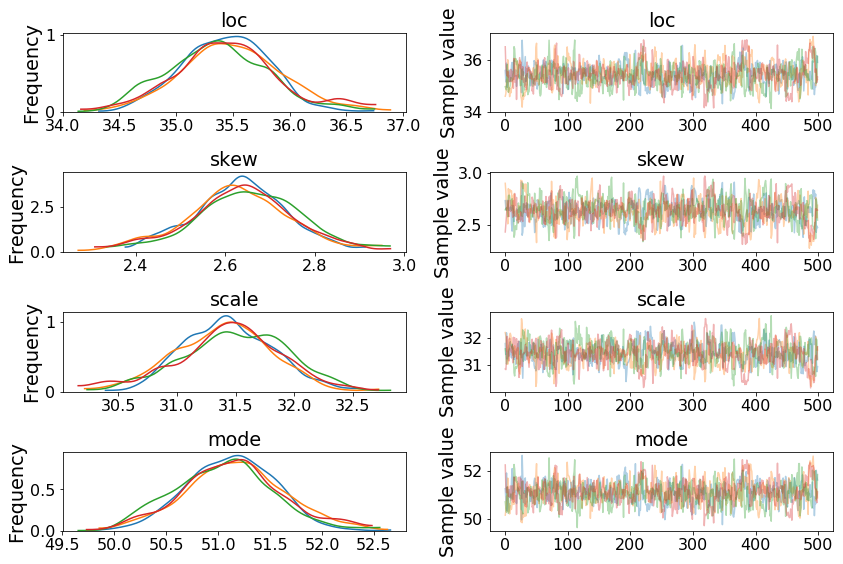

In [45]:
def pdf(x):
    return 1/sqrt(2*pi) * exp(-x**2/2)

def cdf(x):
    return (1 + erf(x/sqrt(2))) / 2

def skewnorm(x,e=0,w=1,a=0):
    t = (x-e) / w
    return 2 / w * pdf(t) * cdf(a*t)


def delta(shape):
    return (shape/pm.math.sqrt(1.0+shape**2.))


def muz(shape):
    return pm.math.sqrt(2./np.pi)*delta(shape) 

def skewness(shape):
    return (4.- np.pi)/2. * ((delta(shape)*pm.math.sqrt(2./np.pi))**3.)/(1.0-(2.0*delta(shape)**2.)/np.pi)**(3./2.)

def sigmaz(shape):
    return np.sqrt(1.-muz(shape)**2.)


def skew_mode(shape):
    return pm.math.sqrt(2.0/np.pi)*delta(shape) - \
        skewness(shape) * pm.math.sqrt(1.0 - (pm.math.sqrt(2.0/np.pi)*delta(shape))**2 )/2.0 - \
        (pm.math.sgn(shape) / 2.0) *( pm.math.exp (-(2.0*np.pi)/pm.math.abs_(shape)))


def sk_mode(loc,scale,shape):
    return loc + skew_mode(shape) * scale

def fit_lightcurve(y):
    with pm.Model() as model:

        (mu, sigma) = norm.fit(y)

        loc = pm.Normal("loc",mu, 20)
        scale = pm.HalfNormal("scale", sigma)
        skew = pm.Normal("skew", 0, 5)
        mode = pm.Deterministic("mode",sk_mode(loc,scale,skew))
        _y = pm.SkewNormal("y_dist",mu=loc, sd=scale,alpha=skew, observed=y)
        trace = pm.sample(draws=500)

    return pm.summary(trace)[pm.summary(trace).index == "mode"]["mean"].values[0]
    pm.traceplot(trace)
    pm.summary(trace)

In [46]:
print(pm.summary(trace)[pm.summary(trace).index == "mode"]["mean"].values,
     pm.summary(trace)[pm.summary(trace).index == "mode"]["sd"].values)

mode = pm.summary(trace)[pm.summary(trace).index == "mode"]["mean"].values[0]
mode_err = pm.summary(trace)[pm.summary(trace).index == "mode"]["sd"].values[0]

(array([51.11678577]), array([0.47184948]))


(3.9940775772527175, 129.75120716974604)

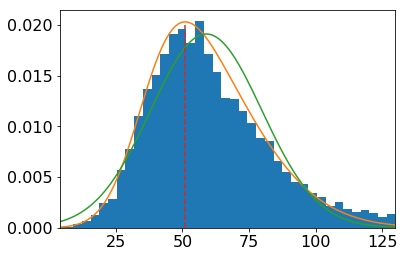

In [47]:
Loc = pm.summary(trace)[pm.summary(trace).index == "loc"]["mean"].values[0]
Scale = pm.summary(trace)[pm.summary(trace).index == "scale"]["mean"].values[0]
Skew = pm.summary(trace)[pm.summary(trace).index == "skew"]["mean"].values[0]

x_pos = np.linspace(Loc-3*Scale,Loc+5*Scale,200)
x = plt.hist(source_df.f_int.values, bins=100, normed=True)
plt.plot(x_pos, skewnorm(x_pos,Loc,Scale,Skew))
plt.plot(x_pos, skewnorm(x_pos,mu,sigma,0))
plt.plot([mode,mode],[0,.02],"--")
plt.xlim([Loc-1*Scale,Loc+3*Scale])

In [37]:
print(pm.summary(trace)[pm.summary(trace).index == "rand_mode"]["mean"].values)

[]


In [73]:
print(mode -mode_err, mode+mode_err)
print(47.69-0.12,47.69+0.12)

(46.25070557887192, 47.261367389876305)
(47.57, 47.809999999999995)


Text(0.5,0,u'TIme UTC [HH:MM]')

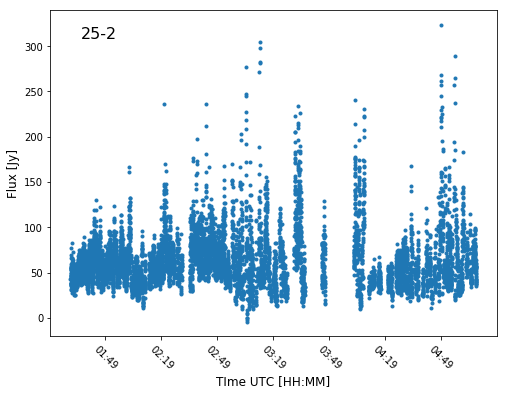

In [90]:
import matplotlib.dates as mdates
plt.figure(figsize=(8,6))
ax = plt.subplot(111)
ax.annotate("{}-{}".format(pd.DatetimeIndex(source_df["taustart_ts"].values).day[0],
                            pd.DatetimeIndex(source_df["taustart_ts"].values).month[0]),
                            xy=(0.15,0.95), xycoords='axes fraction',
                            horizontalalignment='right', verticalalignment='top',fontsize=16)

ax.plot(source_df.taustart_ts, source_df.f_int, ".")
myFmt = mdates.DateFormatter('%H:%M')
plt.xticks(rotation=-45)
ax.xaxis.set_major_formatter(myFmt)
plt.ylabel("Flux [Jy]")
plt.xlabel("TIme UTC [HH:MM]")

In [8]:
len(vlssr)

92965

In [12]:
len(np.unique(data.runcatid))

356

In [14]:
data.to_csv("/home/kuiack/tr_20181101_alldata.csv",index=False)